In [1]:
import os
import glob
import pylab as pl

from caiman.source_extraction.cnmf.cnmf import load_CNMF


/home/julianarhee/anaconda2/envs/caiman/lib/python3.7/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.decomposition.incremental_pca module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.decomposition. Anything that cannot be imported from sklearn.decomposition is now part of the private API.
  warnings.warn(message, FutureWarning)
/home/julianarhee/anaconda2/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/julianarhee/anaconda2/envs/caiman/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy,

In [176]:
import h5py
import re
import json
import traceback 
import copy
import itertools
import time

import numpy as np
import pandas as pd
import seaborn as sns
import caiman as cm

from scipy.stats import stats
import matplotlib.patches as patches   

def atoi(text):
    return int(text) if text.isdigit() else text

def natural_keys(text):
    return [ atoi(c) for c in re.split('(\d+)', text) ]


def label_figure(fig, fig_id):
    fig.text(0, 1, fig_id, ha='left', va='top', fontsize=10)
    

In [ ]:
def get_roiid_from_traceid(animalid, session, fov, run_type=None, traceid='traces001', rootdir='/n/coxfs01/2p-data'):
    
    if run_type is not None:
        if int(session) < 20190511 and run_type == 'gratings':
            a_traceid_dict = glob.glob(os.path.join(rootdir, animalid, session, fov, '*run*', 'traces', 'traceids*.json'))[0]
        else:
            a_traceid_dict = glob.glob(os.path.join(rootdir, animalid, session, fov, '*%s*' % run_type, 'traces', 'traceids*.json'))[0]
    else:
        a_traceid_dict = glob.glob(os.path.join(rootdir, animalid, session, fov, '*run*', 'traces', 'traceids*.json'))[0]
    with open(a_traceid_dict, 'r') as f:
        tracedict = json.load(f)
    
    tid = tracedict[traceid]
    roiid = tid['PARAMS']['roi_id']
    
    return roiid


In [3]:
%matplotlib notebook

# Select 1 dataset experiment

In [7]:
rootdir = '/n/coxfs01/2p-data'
animalid = 'JC084' #'JC084'
session = '20190522' #'20190522' #'20190505_JC083'
session_dir = os.path.join(rootdir, animalid, session)

fov = 'FOV1_zoom2p0x'
experiment = 'gratings' #'retino_run2'
traceid = 'traces001' #'rois001' # If seeded, else None

roiid = get_roiid_from_traceid(animalid, session, fov, run_type=experiment, traceid=traceid)


dataid = '|'.join([animalid, session, fov, exp])

print("*** Dataset: %s ***" % dataid)

*** Dataset: JC084|20190522|FOV1_zoom2p0x|gratings ***


# Load CaImAn-extracted traces

In [77]:
caiman_results_dir = os.path.join(session_dir, fov, 'caiman_results', experiment)
found_results_files = glob.glob(os.path.join(caiman_results_dir, 'seeded_%s-%s_results.hdf5' % (experiment, roiid)))
found_results_files

['/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seeded_gratings-rois001_results.hdf5']

In [10]:
results_fpath = found_results_files[0]

print("...loading %s" % results_fpath)
cnm = load_CNMF(results_fpath, n_processes=2)
cnm.estimates.A.shape

...loading /n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seeded_gratings-rois001_results.hdf5


(262144, 260)

In [81]:
os.path.split(results_fpath)[-1].split('_results.hdf5')

['seeded_gratings-rois001', '']

In [83]:
caimanid = os.path.split(results_fpath)[-1].split('_results.hdf5')[0]
caimanid

'seeded_gratings-rois001'

In [44]:

def get_frame_info(run_dir):
    si_info = {}

    run = os.path.split(run_dir)[-1]
    runinfo_path = os.path.join(run_dir, '%s.json' % run)
    with open(runinfo_path, 'r') as fr:
        runinfo = json.load(fr)
    nfiles = runinfo['ntiffs']
    file_names = sorted(['File%03d' % int(f+1) for f in range(nfiles)], key=natural_keys)

    # Get frame_idxs -- these are FRAME indices in the current .tif file, i.e.,
    # removed flyback frames and discard frames at the top and bottom of the
    # volume should not be included in the indices...
    frame_idxs = runinfo['frame_idxs']
    if len(frame_idxs) > 0:
        print("Found %i frames from flyback correction." % len(frame_idxs))
    else:
        frame_idxs = np.arange(0, runinfo['nvolumes'] * len(runinfo['slices']))

    ntiffs = runinfo['ntiffs']
    file_names = sorted(['File%03d' % int(f+1) for f in range(ntiffs)], key=natural_keys)
    volumerate = runinfo['volume_rate']
    framerate = runinfo['frame_rate']
    nvolumes = runinfo['nvolumes']
    nslices = int(len(runinfo['slices']))
    nchannels = runinfo['nchannels']
    nslices_full = int(round(runinfo['frame_rate']/runinfo['volume_rate']))
    nframes_per_file = nslices_full * nvolumes

    # =============================================================================
    # Get VOLUME indices to assign frame numbers to volumes:
    # =============================================================================
    vol_idxs_file = np.empty((nvolumes*nslices_full,))
    vcounter = 0
    for v in range(nvolumes):
        vol_idxs_file[vcounter:vcounter+nslices_full] = np.ones((nslices_full, )) * v
        vcounter += nslices_full
    vol_idxs_file = [int(v) for v in vol_idxs_file]
    vol_idxs = []
    vol_idxs.extend(np.array(vol_idxs_file) + nvolumes*tiffnum for tiffnum in range(nfiles))
    vol_idxs = np.array(sorted(np.concatenate(vol_idxs).ravel()))

    si_info['nslices_full'] = nslices_full
    si_info['nframes_per_file'] = nframes_per_file
    si_info['vol_idxs'] = vol_idxs
    si_info['vol_idxs_file'] = np.array(vol_idxs_file)

    si_info['volumerate'] = volumerate
    si_info['framerate'] = framerate
    si_info['nslices'] = nslices
    si_info['nchannels'] = nchannels
    si_info['ntiffs'] = ntiffs
    si_info['nvolumes'] = nvolumes
    all_frames_tsecs = runinfo['frame_tstamps_sec']
    if nchannels==2:
        all_frames_tsecs = np.array(all_frames_tsecs[0::2])
    si_info['frames_tsec'] = all_frames_tsecs #runinfo['frame_tstamps_sec']

    return si_info



In [48]:

def frames_to_trials(curr_rundir, trials_in_block, file_ix, frame_shift=0,
                     frame_ixs=None, verbose=False):

    '''
    Adapted for CaImAn from pipeline.python.paradigm.trial_alignment.frames_to_trials()
    This is the frame-trial alignment function used by aggregate_experiment_runs()
    
    '''
    parsed_frames_fpath = glob.glob(os.path.join(curr_rundir, 'paradigm', 'parsed_frames_*.hdf5'))[0]
    
    si = get_frame_info(curr_rundir)
    all_frames_tsecs = np.array(si['frames_tsec']) # Corrected frame tstamps (single-channel)
    if verbose:
        print("N tsecs:", len(all_frames_tsecs))
    vol_ixs = si['vol_idxs'] # Volume indices to assign frame numbers to volumes (across all tifs)
    vol_ixs_tif = si['vol_idxs_file']

    try:
        parsed_frames = h5py.File(parsed_frames_fpath, 'r')

        # Get trial list across all tif files
        trial_list = sorted(parsed_frames.keys(), key=natural_keys)
        if file_ix==0:
            print("... getting ixs for %i of %i total trials across all .tif files." % (len(trials_in_block), len(trial_list)))

        # Check if frame indices are indexed relative to full run (all .tif files) or within-tif (i.e., a "block")
        block_indexed = all([all(parsed_frames[t]['frames_in_run'][:] == parsed_frames[t]['frames_in_file'][:])\
                             for t in trial_list]) is False

        # Calculate trial epochs in frames (assumes all trials have same structure)
        min_frame_interval = 1
        nframes_pre = int(round(parsed_frames['trial00001']['frames_in_run'].attrs['baseline_dur_sec'] * si['volumerate']))
        nframes_post = int(round(parsed_frames['trial00001']['frames_in_run'].attrs['iti_dur_sec'] * si['volumerate']))
        nframes_on = int(round(parsed_frames['trial00001']['frames_in_run'].attrs['stim_dur_sec'] * si['volumerate']))
        nframes_per_trial = nframes_pre + nframes_on + nframes_post 
    
        # Get all frame indices for trial epochs (if there are overlapping frame indices, there will be repeats)    
        all_frames_in_trials = np.hstack([np.array(parsed_frames[t]['frames_in_file']) \
                                   for t in trials_in_block])
        if verbose:
            print("*first frame: %i" % all_frames_in_trials[0])

        if verbose:
            print("... N frames to align:", len(all_frames_in_trials))
            print("... N unique frames:", len(np.unique(all_frames_in_trials)))
        stim_onset_idxs = np.array([parsed_frames[t]['frames_in_file'].attrs['stim_on_idx'] \
                                    for t in trials_in_block])
    
        # Adjust frame indices to match within-file, rather than across-files, indices
        if block_indexed is False:
            all_frames_in_trials = all_frames_in_trials - len(all_frames_tsecs)*file_ix - frame_shift  
            if all_frames_in_trials[-1] >= len(all_frames_tsecs):
                print("... File: %i (has %i frames)" % (file_ix, len(all_frames_tsecs)))
                print("... asking for %i extra frames..." % (all_frames_in_trials[-1] - len(all_frames_tsecs)))
            stim_onset_idxs = stim_onset_idxs - len(all_frames_tsecs)*file_ix - frame_shift 
        if verbose:
            print("... Last frame to align: %i (N frames total, %i)" % (all_frames_in_trials[-1], len(all_frames_tsecs)))
    
        stim_onset_idxs_adjusted = vol_ixs_tif[stim_onset_idxs]
        stim_onset_idxs = copy.copy(stim_onset_idxs_adjusted)
        varying_stim_dur=False
        trial_frames_to_vols = dict((t, []) for t in trials_in_block)
        for t in trials_in_block: 
            frames_to_vols = parsed_frames[t]['frames_in_file'][:] 
            frames_to_vols = frames_to_vols - len(all_frames_tsecs)*file_ix - frame_shift  
            actual_frames_in_trial = [i for i in frames_to_vols if i < len(vol_ixs_tif)]
            #trial_vol_ixs = np.empty(frames_to_vols.shape, dtype=int)
            trial_vol_ixs = np.ones(frames_to_vols.shape, dtype=int)*-100 #np.nan
            trial_vol_ixs[0:len(actual_frames_in_trial)] = vol_ixs_tif[actual_frames_in_trial]
            if varying_stim_dur is False:
                trial_vol_ixs = trial_vol_ixs[0:nframes_per_trial]
            trial_frames_to_vols[t] = np.array(trial_vol_ixs)

    except Exception as e:
        traceback.print_exc()
    finally:
        parsed_frames.close()
            
    #%
    # Convert frame-reference to volume-reference. Only select first frame for each volume.
    # Only relevant for multi-plane. Don't take unique values, since stim period of trial N 
    # can be ITI of trial N-1
    actual_frames = np.array([i for i in all_frames_in_trials if i < len(vol_ixs_tif)])
    frames_in_trials = vol_ixs_tif[actual_frames]
    
    # Turn frame_tsecs into RELATIVE tstamps (to stim onset):
    # ------------------------------------------------
    first_plane_tstamps = all_frames_tsecs[np.array(frame_ixs)]
    trial_tstamps = first_plane_tstamps[frames_in_trials[0:len(actual_frames)]] #all_frames_tsecs[frames_in_trials] #indices]  

    # Check whether we are asking for more frames than there are unique, and pad array if so
    if len(trial_tstamps) < len(all_frames_in_trials): #len(frames_in_trials):
        print("... padding trial tstamps array... (should be %i)" % len(all_frames_in_trials))
        trial_tstamps = np.pad(trial_tstamps, (0, len(all_frames_in_trials)-len(trial_tstamps)),\
                               mode='constant', constant_values=-100) #np.nan)
        frames_in_trials = np.pad(frames_in_trials, (0, len(all_frames_in_trials)-len(frames_in_trials)),\
                                  mode='constant', constant_values=-100) #np.nan)

    # All trials have the same structure:
    reformat_tstamps = False
    if verbose:
        print("N frames per trial:", nframes_per_trial)
        print("N tstamps:", len(trial_tstamps))
        print("N trials in block:", len(trials_in_block))
    try: 
        tsec_mat = np.reshape(trial_tstamps, (len(trials_in_block), nframes_per_trial))
        # Subtract stim_on tstamp from each frame of each trial to get relative tstamp:
        tsec_mat -= np.tile(all_frames_tsecs[stim_onset_idxs].T, (tsec_mat.shape[1], 1)).T
        
    except Exception as e: #ValueError:
        traceback.print_exc()

    # Double check trial alignment
    x, y = np.where(tsec_mat==0)
    assert len(list(set(y)))==1, "Incorrect stim onset alignment: %s" % str(list(set(y)))
    relative_tsecs = np.reshape(tsec_mat, (len(trials_in_block)*nframes_per_trial, ))

    # Convert frames_in_file to volume idxs:
    trial_frames_to_vols = pd.DataFrame(trial_frames_to_vols)
    trial_frames_to_vols = trial_frames_to_vols.replace(-100, np.nan)

    return trial_frames_to_vols, relative_tsecs


In [46]:
def reformat_morph_values(sdf):
    #sdf = sdf.assign(ix=[int(i.split('config')[-1]) for i in sdf.index]).sort_values('ix')
    control_ixs = sdf[sdf['morphlevel']==-1].index.tolist()
    sizevals = np.array([round(s, 1) for s in sdf['size'].unique() if s not in ['None', None] and not np.isnan(s)] )
    sdf.loc[sdf.morphlevel==-1, 'size'] = pd.Series(sizevals, index=control_ixs)
    sdf['size'] = [round(s, 1) for s in sdf['size'].values]
    #sdf = sdf.assign(ix=[int(i.split('config')[-1]) for i in sdf.index]).sort_values('ix')
    
    return sdf


# Load manual data

In [18]:
traceid = 'traces001'

In [19]:
manualdir = glob.glob(os.path.join(rootdir, animalid, session, fov, 'combined_%s_static' % exp,
                     'traces', '%s*' % traceid, 'data_arrays'))[0]

dset = np.load(os.path.join(manualdir, 'np_subtracted.npz'), encoding='latin1', allow_pickle=True)
manual = pd.DataFrame(dset['data'][:])
print(manual.shape)

(138880, 260)


#### Stimulus configs + plottting params

In [21]:
print(experiment)
sdf = pd.DataFrame(dset['sconfigs'][()]).T
sdf = sdf.assign(ix=[int(i.split('config')[-1]) for i in sdf.index]).sort_values('ix')
if experiment=='blobs':
    sdf = reformat_morph_values(sdf)
#sdf

gratings


In [22]:
if exp=='blobs':
    plot_params = {'hue': None,
                   'rows': 'size',
                   'cols': 'morphlevel'}
else:
    plot_params = {'hue': 'sf',
                   'rows': ['size', 'speed'],
                   'cols': 'ori'}
    

In [23]:
all_plot_params=[]
for p in plot_params.values():
    if isinstance(p, list):
        all_plot_params.extend(p)
    else:
        all_plot_params.append(p)


['sf', 'size', 'speed', 'ori']

In [24]:
combined_params = ['_'.join(v) for k, v in plot_params.items() if isinstance(v, list)]
for p in combined_params:
    sdf[p] = ['_'.join([str(c) for c in list(combo[0])]) for combo in list(zip(sdf[p.split('_')].values))]
sdf.head()

,direction,luminance,stimtype,xpos,ypos,aspect,ori,position,speed,sf,size,ix,size_speed
config001,0,None,gratings,0,0,1,0,"(0, 0)",10,0.1,200,1,200.0_10
config002,0,None,gratings,0,0,1,0,"(0, 0)",20,0.1,200,2,200.0_20
config003,0,None,gratings,0,0,1,0,"(0, 0)",10,0.5,200,3,200.0_10
config004,0,None,gratings,0,0,1,0,"(0, 0)",20,0.5,200,4,200.0_20
config005,0,None,gratings,20,-8,1,0,"(20, -8)",10,0.1,20,5,20.0_10


#### Frame labels (update combined params for plotting)

In [28]:
ylabel = 'trace'
palette = 'colorblind' 

In [372]:
# Get original labels data
labels = pd.DataFrame(dset['labels_data'], columns=dset['labels_columns'])
labels.columns = [x.decode("utf-8") for x in labels.columns]

# Create copy of labels data to create placeholders for combined params / updated param info
labels_c = labels.copy()
for p in plot_params.values():
    if p is None:
        continue
    if isinstance(p, list):
        for pp in p:
            labels_c[pp] = [sdf[pp][cfg] for cfg in labels['config']]
    else:
        labels_c[p] = [sdf[p][cfg] for cfg in labels['config']]
                        
# Combine string params
for k, v in plot_params.items():
    if isinstance(v, list):
        plot_params[k] = '_'.join(v)

if plot_params['hue'] is None:
    palette = 'k'
    
print(plot_params)

{'hue': 'sf', 'rows': 'size_speed', 'cols': 'ori'}


# Get parsed frame indices

In [36]:
# Get run, tif num, and file path for extracted raw arrays
run_dirs = sorted(glob.glob(os.path.join(rootdir, animalid, session, fov, '*%s_*' % exp,
                                         'traces', '%s*' % traceid, 'files')), key=natural_keys)

rawfns = [(run_ix, file_ix, file_name) for run_ix, run_dir in enumerate(sorted(run_dirs, key=natural_keys))
          for file_ix, file_name in enumerate(sorted(glob.glob(os.path.join(run_dir, '*.hdf5')), key=natural_keys))]
print("Found raw tif arrays for %i files (across %i runs)" % (len(rawfns), len(run_dirs)))



Found raw tif arrays for 31 files (across 4 runs)


In [54]:
frames_by_file = {}
for total_ix, (run_ix, file_ix, fpath) in enumerate(rawfns):
    
    # Get frame indices from raw fns (already extracted from manual into hdf5)
    rfile = h5py.File(fpath, 'r')
    fdata = rfile['Slice01']
    frames_to_select = pd.DataFrame(fdata['frames_indices'][:])
    frame_ixs = np.array(frames_to_select[0].values) 

    # Get MW info
    curr_rundir = run_dirs[run_ix].split('/traces')[0]
    mw_fpath = glob.glob(os.path.join(curr_rundir, 'paradigm', 'trials_*.json'))[0]
    with open(mw_fpath, 'r') as f:
        mwinfo = json.load(f)
    trials_in_block = sorted([t for t, mdict in mwinfo.items() \
                              if mdict['block_idx']==file_ix and mdict['stimuli']['type'] != 'blank'], key=natural_keys)
    frame_shift = 0 if 'block_frame_offset' not in mwinfo[trials_in_block[0]].keys() else mwinfo[trials_in_block[0]]['block_frame_offset']

    # Get frame indices for each trial across all runs
    print("Run %i (File %i) - %s" % (int(run_ix+1), int(file_ix+1), trials_in_block[0]))
    trial_frames_to_vols, relative_tsecs = frames_to_trials(curr_rundir, trials_in_block, file_ix,     
                                                            frame_shift=frame_shift, frame_ixs=frame_ixs)
    
    frames_by_file[total_ix] = trial_frames_to_vols
    

Run 1 (File 1) - trial00001
... getting ixs for 40 of 320 total trials across all .tif files.
Run 1 (File 2) - trial00041
Run 1 (File 3) - trial00081
Run 1 (File 4) - trial00121
Run 1 (File 5) - trial00161
Run 1 (File 6) - trial00201
Run 1 (File 7) - trial00241
Run 1 (File 8) - trial00281
Run 2 (File 1) - trial00001
... getting ixs for 40 of 280 total trials across all .tif files.
Run 2 (File 2) - trial00041
Run 2 (File 3) - trial00081
Run 2 (File 4) - trial00121
Run 2 (File 5) - trial00161
Run 2 (File 6) - trial00201
Run 2 (File 7) - trial00241
Run 3 (File 1) - trial00001
... getting ixs for 40 of 320 total trials across all .tif files.
Run 3 (File 2) - trial00041
Run 3 (File 3) - trial00081
Run 3 (File 4) - trial00121
Run 3 (File 5) - trial00161
Run 3 (File 6) - trial00201
Run 3 (File 7) - trial00241
Run 3 (File 8) - trial00281
Run 4 (File 1) - trial00001
... getting ixs for 40 of 320 total trials across all .tif files.
Run 4 (File 2) - trial00041
Run 4 (File 3) - trial00081
Run 4 (F

In [55]:
frames_by_file[4]

,trial00161,trial00162,trial00163,trial00164,trial00165,trial00166,trial00167,trial00168,trial00169,trial00170,...,trial00191,trial00192,trial00193,trial00194,trial00195,trial00196,trial00197,trial00198,trial00199,trial00200
0,49,162,275,388,501,614,728,841,954,1067,...,3442,3555,3668,3781,3895,4008,4121,4234,4347,4460
1,50,163,276,389,502,615,729,842,955,1068,...,3443,3556,3669,3782,3896,4009,4122,4235,4348,4461
2,51,164,277,390,503,616,730,843,956,1069,...,3444,3557,3670,3783,3897,4010,4123,4236,4349,4462
3,52,165,278,391,504,617,731,844,957,1070,...,3445,3558,3671,3784,3898,4011,4124,4237,4350,4463
4,53,166,279,392,505,618,732,845,958,1071,...,3446,3559,3672,3785,3899,4012,4125,4238,4351,4464
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,156,269,382,495,608,721,835,948,1061,1174,...,3549,3662,3775,3888,4002,4115,4228,4341,4454,4567
108,157,270,383,496,609,722,836,949,1062,1175,...,3550,3663,3776,3889,4003,4116,4229,4342,4455,4568
109,158,271,384,497,610,723,837,950,1063,1176,...,3551,3664,3777,3890,4004,4117,4230,4343,4456,4569
110,159,272,385,498,611,724,838,951,1064,1177,...,3552,3665,3778,3891,4005,4118,4231,4344,4457,4570


# Get manual and compare vs nmf

In [78]:
outdir = os.path.join(caiman_results_dir, 'compare_manual')
if not os.path.exists(outdir):
    os.makedirs(outdir)
    

## 1. Check spatial footprints to manual ROIs

In [65]:
#### Get memmapping info (motion correction, mmap fil einfo, preprocessing info)
preprocess_fpath = results_fpath.replace('results.hdf5', 'processing-params.json')
with open(preprocess_fpath, 'r') as f:
    preprocess_info = json.load(f)
preprocess_info

mmap_fname = preprocess_info['source']
mmap_prefix = os.path.splitext(os.path.split(mmap_fname)[-1])[0].split('_d1_')[0]
print(mmap_fname)
print(mmap_prefix)

# def get_full_memmap_path(results_dir, framestr='order_C_frames', prefix='Yr'):
#     print("Getting full mmap path for prefix: %s" % prefix)
#     print("-- dir: %s" % results_dir)
#     print(glob.glob(os.path.join(results_dir, 'memmap', '*%s*.mmap'))) 
#     try:
#         fname_new = glob.glob(os.path.join(results_dir, 'memmap', '*%s*_d*%s*_.mmap' % (prefix, framestr)))
#         if len(fname_new) > 1:
#             nframes = max([int(i.split('_')[-2]) for i in fname_new])
#             framestr = '_frames_%i_' % nframes
#             fname_new = glob.glob(os.path.join(results_dir, 'memmap', '*%s*_d*%s*_.mmap' % (prefix, framestr)))[0]
#         else:
#             assert len(fname_new)==1, "Unique fname_new not found: %s" % str(fname_new)
#             fname_new = fname_new[0] 
#         mm_prefix = os.path.splitext(os.path.split(fname_new)[-1])[0].split('_d1_')[0]
#         print("CORRECTED PREFIX: %s" % mm_prefix)
#     except Exception as e:
#         print(e)
#         return None
#     return fname_new, mm_prefix



{'quantileMin': 10,
 'frames_window_sec': 30.0,
 'ds_factor': 1.0,
 'fr': 44.65,
 'frames_window': 1340,
 'source': '/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190522-FOV1_zoom2p0x-gratings-Yr_d1_512_d2_512_d3_1_order_C_frames_142910_.mmap'}

In [68]:

def load_roi_masks(animalid, session, fov, rois=None, rootdir='/n/coxfs01/2p-data'):
    '''
    Loads MANUAL ROIs (e.g., .../ROIs/rois001/masks.hdf5)
    In Python, loaded masks are shape (nrois, d1, d2)
    '''
    masks=None; zimg=None;
    mask_fpath = glob.glob(os.path.join(rootdir, animalid, session, 'ROIs', '%s*' % rois, 'masks.hdf5'))[0]
    try:
        mfile = h5py.File(mask_fpath, 'r')
        fkey = list(mfile.keys())[0]
        masks = mfile[fkey]['masks']['Slice01'][:] #.T

        zimg = mfile[fkey]['zproj_img']['Slice01'][:] #.T
        zimg.shape
    except Exception as e:
        print("error loading masks")
    finally:
        mfile.close()
        
    return masks, zimg

# def reshape_and_binarize_masks(masks):
#     # Binarze and reshape:
#     nrois, d1, d2 = masks.shape
#     Ain = np.reshape(masks, (nrois, d1*d2))
#     Ain[Ain>0] = 1
#     Ain = Ain.astype(bool).T 
    
#     return Ain
# def get_full_memmap_path(results_dir, framestr='order_C_frames', prefix='Yr'):
#     print("Getting full mmap path for prefix: %s" % prefix)
#     print("-- dir: %s" % results_dir)
#     print(glob.glob(os.path.join(results_dir, 'memmap', '*%s*.mmap'))) 
#     try:
#         fname_new = glob.glob(os.path.join(results_dir, 'memmap', '*%s*_d*%s*_.mmap' % (prefix, framestr)))
#         if len(fname_new) > 1:
#             nframes = max([int(i.split('_')[-2]) for i in fname_new])
#             framestr = '_frames_%i_' % nframes
#             fname_new = glob.glob(os.path.join(results_dir, 'memmap', '*%s*_d*%s*_.mmap' % (prefix, framestr)))[0]
#         else:
#             assert len(fname_new)==1, "Unique fname_new not found: %s" % str(fname_new)
#             fname_new = fname_new[0] 
#         mm_prefix = os.path.splitext(os.path.split(fname_new)[-1])[0].split('_d1_')[0]
#         print("CORRECTED PREFIX: %s" % mm_prefix)
#     except Exception as e:
#         print(e)

def reshape_and_binarize_masks(masks):
    # Binarze and reshape:
    nrois, d1, d2 = masks.shape
    #masks2 = np.swapaxes(masks, 1, 2)
    Ain = np.reshape(masks, (nrois, d1*d2))
    Ain[Ain>0] = 1
    Ain = Ain.astype(bool).T 
    
    return Ain



In [71]:
#### Load manual ROIs and format
print("Getting seeds for %s..." % roiid)
masks, zimg = load_roi_masks(animalid, session, fov, rois=roiid)
print(masks.shape)
Ain = reshape_and_binarize_masks(masks)
print(Ain.shape)

Getting seeds for rois001...
(260, 512, 512)
(262144, 260)


In [72]:
##### Reshape NMF ROIs
print("Extracting CNMF from: %s" % mmap_fname)
Yr, dims, T = cm.load_memmap(mmap_fname)


Extracting CNMF from: /n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190522-FOV1_zoom2p0x-gratings-Yr_d1_512_d2_512_d3_1_order_C_frames_142910_.mmap


In [73]:
# Reshape 
masks_seed = np.reshape(Ain, (dims[0], dims[1], nrois), order='F')
#masks_seed = Ain.reshape(512, 512, 260, order='C') #.sum(axis=-1)

masks_nmf = np.reshape(cnm.estimates.A.toarray(), (dims[0], dims[1], nrois), order='F') 

In [79]:
masks_seed.shape, masks_nmf.shape

((512, 512, 260), (512, 512, 260))

#### Plot manual vs. nmf ROIs

In [117]:
from caiman.base.rois import com
from matplotlib.lines import Line2D


<IPython.core.display.Javascript object>


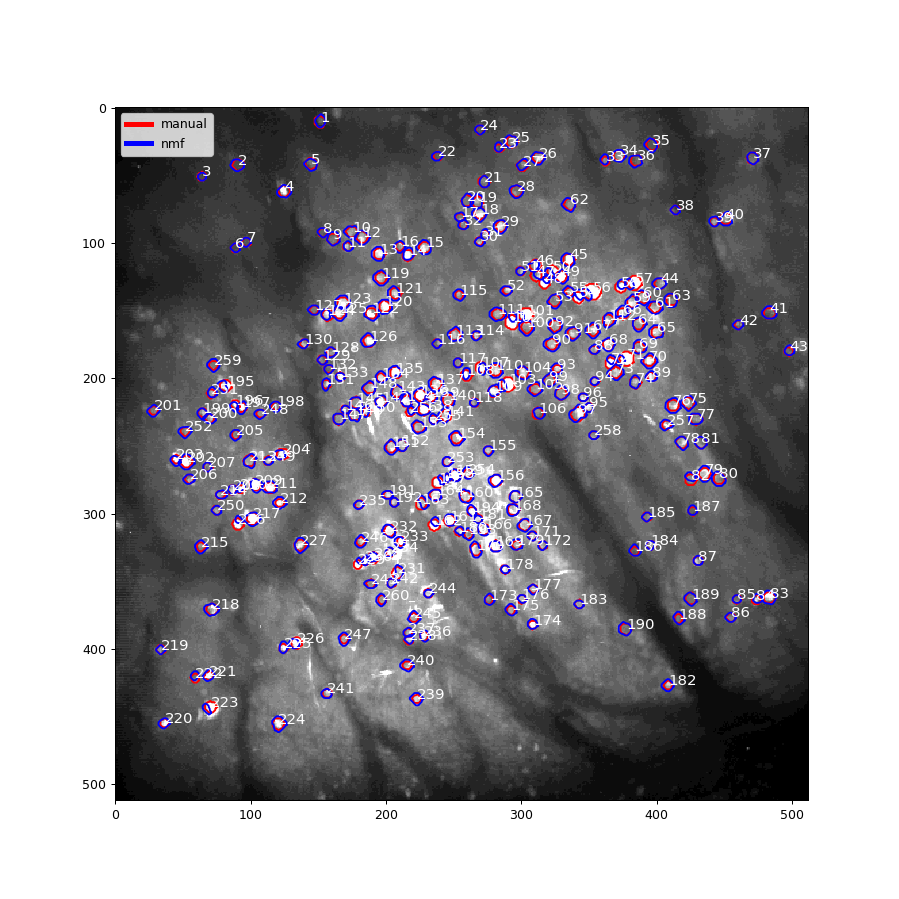

In [120]:
fig, ax = pl.subplots(figsize=(10,10))
cm.utils.visualization.plot_contours(Ain.astype(float), zimg.T, cmap='gray', colors='r', display_numbers=False)
cm.utils.visualization.plot_contours(cnm.estimates.A.toarray(), zimg.T, cmap='gray', colors='b', 
                                     display_numbers=False, max_number=None)
d1, d2 = np.shape(zimg.T)
d, nr = np.shape(cnm.estimates.A.toarray())
max_number = 300
ctrs = com(Ain.astype(float), d1, d2)

ax = pl.gca()
for i in range(np.minimum(nr, max_number)):
    ax.text(ctrs[i, 1], ctrs[i, 0], str(i + 1), color='w', fontsize=12)

custom_lines = [Line2D([0], [0], color='r', lw=4),
                Line2D([0], [0], color='b',lw=4)]
ax.legend(custom_lines, ['manual', 'nmf'])

    
figname = '%s_seeded-vs-nmf' % caimanid
pl.savefig(os.path.join(outdir, '%s.png' % figname))

#### Look at individual ROIs

<IPython.core.display.Javascript object>


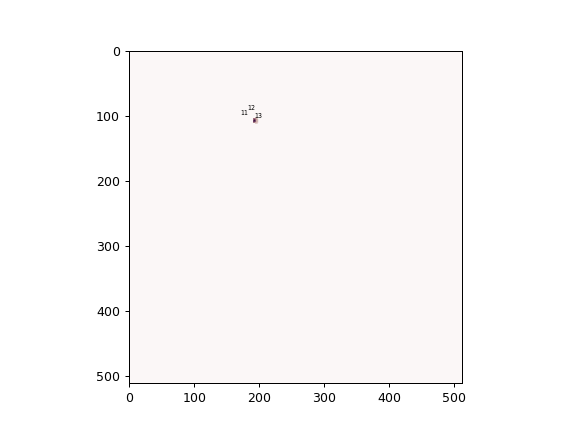

In [125]:
pl.figure()

for ri in [10,11,12]:
    pl.imshow(np.reshape(cnm.estimates.A[:,ri].toarray(), dims, order='F'), alpha=1, cmap='Reds')
    y, x = np.where(np.reshape(cnm.estimates.A[:,ri].toarray(), dims, order='F'))
    pl.text(x[0], y[0], '%i' % (ri+1), fontsize=5)
    pl.imshow(masks_nmf[:, :, 12], alpha=0.5, cmap='Blues')


# 2. Plot psths

#### Annotate trial epochs

In [391]:
stim_on = labels_c['stim_on_frame'].unique()[0]
nframes_on = labels_c['nframes_on'].unique()[0]     
mean_tsecs = labels_c.groupby(['trial'])['tsec'].apply(np.array).mean(axis=0)

In [396]:
trial_counts = labels_c[['config', 'trial']].drop_duplicates().groupby(['config']).count()

In [397]:
stim_start_tsec = 0.0
stim_end_tsec = mean_tsecs[stim_on + int(round(nframes_on))]


#### Plot 1 roi

In [394]:
def get_mean_and_sem_timecourse(rdata, sdf, plot_params, trace_type='dff'):
    
    if trace_type not in rdata.columns:
        print("Requested %s -- not found" % (trace_type))
        trace_type = [c for c in rdata.columns if c not in labels_c.columns][0]
        print("-- averaging %s" % trace_type)

    meandfs = []
    for k, g in rdata.groupby(['config']):
        nreps = len(g['trial'].unique())
        mean_trace = g.groupby(['trial'])[trace_type].apply(np.array).mean(axis=0)
        mean_tsec = g.groupby(['trial'])['tsec'].apply(np.array).mean(axis=0)
        sem_trace = stats.sem(np.vstack(g.groupby(['trial'])[trace_type].apply(np.array)), axis=0)
        mdf = pd.DataFrame({'%s' % trace_type: mean_trace,
                            'tsec': mean_tsec,
                            'sem': sem_trace,
                            'fill_minus': mean_trace - sem_trace,
                            'fill_plus': mean_trace + sem_trace,
                            'config': [k for _ in range(len(mean_trace))],
                            'nreps': [nreps for _ in range(len(mean_trace))]
                           })
        for p in plot_params.values():
            mdf[p] = [round(sdf[p][cfg], 1) if isinstance(sdf[p][cfg], (float)) else sdf[p][cfg] for cfg in mdf['config']]
        meandfs.append(mdf)
    meandfs = pd.concat(meandfs, axis=0)
    
    return meandfs

In [395]:
def add_text(x, huep, **kwargs):
    ax = pl.gca()
    if huep.unique() == 0.1:
        ax.text(0, 1, 'n=%i' % x.unique(), ha='left', va='top',  transform=ax.transAxes, **kwargs)
    else:
        ax.text(0, 0.95, 'n=%i' % x.unique(), ha='left', va='top',  transform=ax.transAxes, **kwargs)
        
def add_stimulus_bar(x, start_val=0, end_val=1, color='k', alpha=0.5, **kwargs):
    ax = pl.gca()
    ymin, ymax = ax.get_ylim()
    ax.add_patch(patches.Rectangle((start_val, ymin), end_val, (ymax-ymin), linewidth=0, 
                                  fill=True, color=color, alpha=alpha))

    #ax.tick_params(axis='x', size=0)
    
def fix_grid_labels(p, trace_type='trace_type'):
    '''
    p is output of sns.FacetGrid
    '''
    for ri in np.arange(0, p.axes.shape[0]):
        for ci in np.arange(0, p.axes.shape[1]):
            if ci==0:
                p.axes[ri, ci].set_ylabel(trace_type)
            else:
                p.axes[ri, ci].set_ylabel('')
            if ri == p.axes.shape[0]-1:
                p.axes[ri, ci].set_xlabel('time (s)')
            else:
                p.axes[ri, ci].set_xlabel('')


In [411]:
# PLOT

def plot_psth_grid(meandfs, plot_params, trace_type='trace_type', palette='colorblind', 
                       stim_start_tsec=0, stim_end_tsec=1):
    
    p = sns.FacetGrid(meandfs, col=plot_params['cols'], row=plot_params['rows'], hue=plot_params['hue'],\
                      sharex=True, sharey=True, palette=palette)


    if len(meandfs[plot_params['rows']].unique()) == 1:
        p.fig.set_figheight(3)
        p.fig.set_figwidth(20)

    if plot_params['hue'] is None:
        p = p.map(pl.fill_between, "tsec", "fill_minus", "fill_plus", alpha=0.5, color='k')
        p = p.map(pl.plot, "tsec", trace_type, lw=1, alpha=1, color='k')
    else:
        p = p.map(pl.fill_between, "tsec", "fill_minus", "fill_plus", alpha=0.5)
        p = (p.map(pl.plot, "tsec", trace_type, lw=1, alpha=1).add_legend())

    p = p.set_titles(col_template="{col_name}", size=12)   
    p.map(add_stimulus_bar, 'ntrials',  start_val=stim_start_tsec, end_val=stim_end_tsec, color='k', alpha=0.1)
    p.map(add_text, 'ntrials', plot_params['hue'])
    pl.subplots_adjust(top=0.9, right=0.9, wspace=0.1, hspace=0.4)
    sns.despine(trim=True) #, bottom=True) 
    fix_grid_labels(p, trace_type=trace_type)

    if 'xpos' in plot_params.values() and 'ypos' in plot_params.values(): 
        pl.subplots_adjust(wspace=0.05, hspace=0.3, top=0.85, bottom=0.1, left=0.05) 
    else:
        pl.subplots_adjust(wspace=0.1, hspace=0.4, top=0.9, right=0.9)

    return p
    


def plot_psth_and_save(rid, meandfs, plot_params, trace_type='trace_type', palette='colorblind', 
                       stim_start_tsec=0, stim_end_tsec=1, fig_id='figureID', dst_dir='/tmp', filetype='svg'):
    
    if not os.path.exists(dst_dir):
        os.makedirs(dst_dir)
        
    p = plot_psth_grid(meandfs, plot_params, trace_type=trace_type, palette=palette, 
                       stim_start_tsec=stim_start_tsec, stim_end_tsec=stim_end_tsec)
    
    p.fig.suptitle('roi %i' % int(rid+1))
    label_figure(p.fig, fig_id)

    figname = 'roi%05d_%s' % (int(rid+1), trace_type)
    pl.savefig(os.path.join(dst_dir, '%s.%s' % (figname, filetype)))
    #print(figname)
    pl.close()

#### Align CaImAn

In [420]:
trace_type = 'deconvolved'

In [421]:
manualdir.split('/data_arrays')[0]

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e'

In [422]:
#psth_dir = os.path.join(manualdir.split('/data_arrays')[0], 'figures', 'psth_caiman_%s' % trace_type)
psth_dir = os.path.join(manualdir.split('/data_arrays')[0], 'figures', 'psth_caiman_%s' % trace_type)

if not os.path.exists(psth_dir):
    os.makedirs(psth_dir)
print(psth_dir)

/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e/figures/psth_caiman_deconvolved


In [427]:
if trace_type == 'denoised':
    extracted_traces = copy.copy(cnm.estimates.C) #+  cnm.estimates.YrA
elif trace_type == 'deconvolved':
    extracted_traces = copy.copy(cnm.estimates.S) #+  cnm.estimates.YrA
elif trace_type == 'dff':
    extracted_traces = copy.copy(cnm.estimates.F_dff)
else:
    print("Unrecognized trace type: %s" % trace_type)
nrois, T = extracted_traces.shape
nfiles = len(frames_by_file.keys())
nframes_per_file = int(T/float(nfiles))
print("%i frames per file (%i files)." % (nframes_per_file, nfiles))
print(extracted_traces.shape)


4610 frames per file (31 files).
(260, 142910)


In [428]:
rid = 12

In [429]:
# Get current roi's time courses
trace_array = extracted_traces[rid, :].reshape(nfiles, nframes_per_file, order='C')
ntifs_total, nframes_per_tif = trace_array.shape

combined_frames = np.hstack(np.array([np.nan if np.isnan(i) else trace_array[fi, int(i)]\
                        for i in np.hstack(ixs.values.T)]) for fi, ixs in sorted(frames_by_file.items(),\
                                                                                 key=lambda x: x[0]))
print("%i tif files (each with %i frames) = %i frames" % (ntifs_total, nframes_per_tif, all_frames.shape[0]))

# Make dataframe for 1 cell
rdata = labels_c.copy()
rdata['%s' % trace_type] = combined_frames #manual[rid]
meandfs = get_mean_and_sem_timecourse(rdata, sdf, plot_params, trace_type='df')
meandfs['ntrials'] = [trial_counts.loc[cfg]['trial'] for cfg in meandfs['config']]


/home/julianarhee/anaconda2/envs/caiman/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  import sys


31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


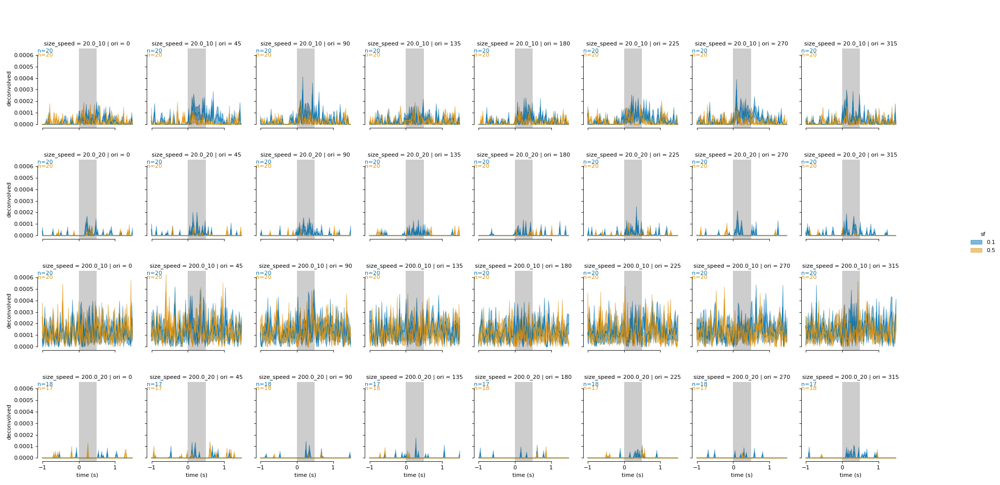

In [430]:
p = plot_psth_grid(meandfs, plot_params, trace_type=trace_type, palette=palette, 
                   stim_start_tsec=stim_start_tsec, stim_end_tsec=stim_end_tsec)


/home/julianarhee/anaconda2/envs/caiman/lib/python3.7/site-packages/ipykernel_launcher.py:9: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  if __name__ == '__main__':


31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


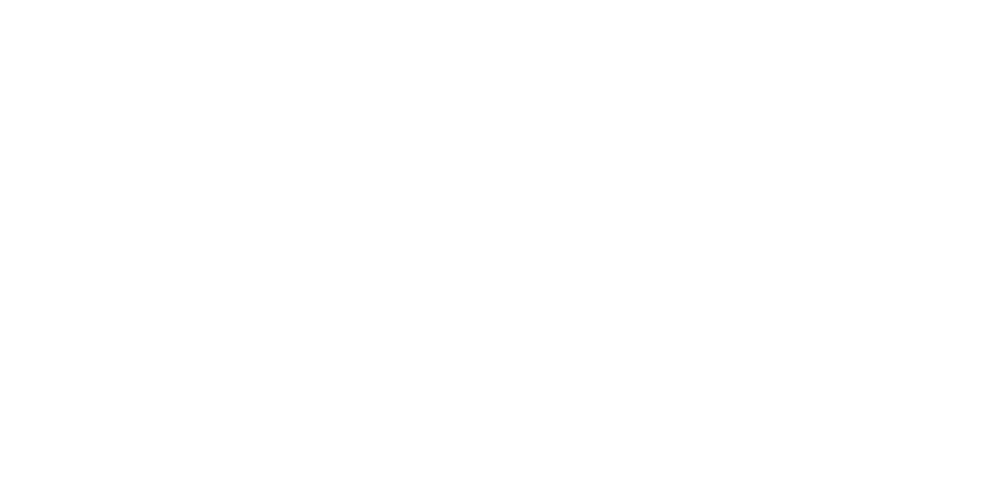

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


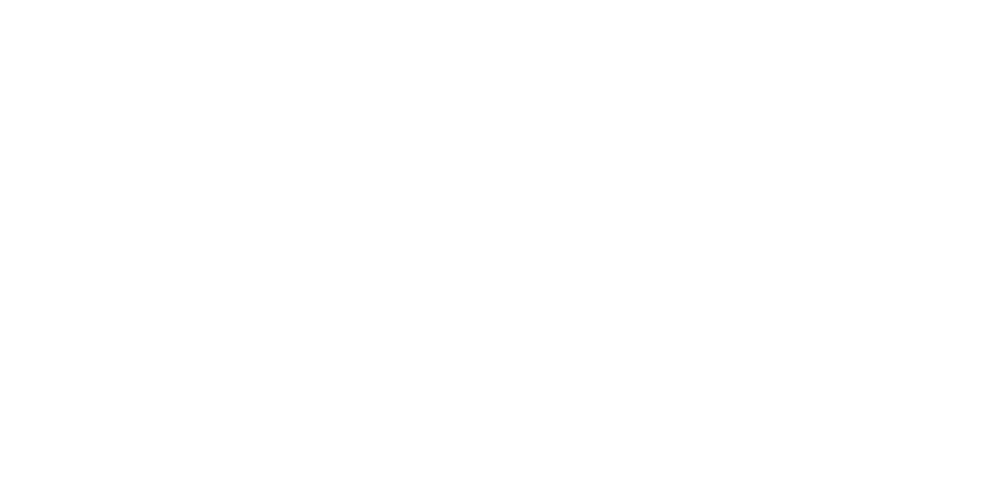

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


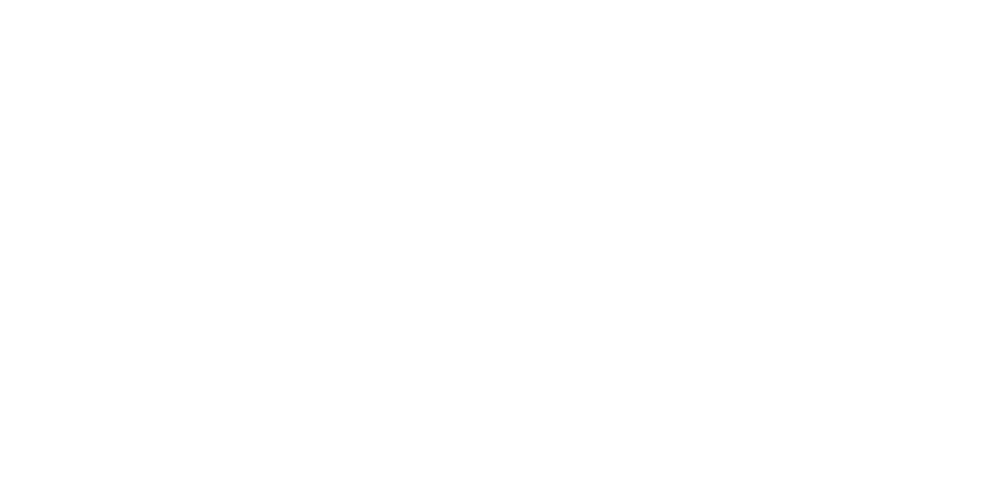

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


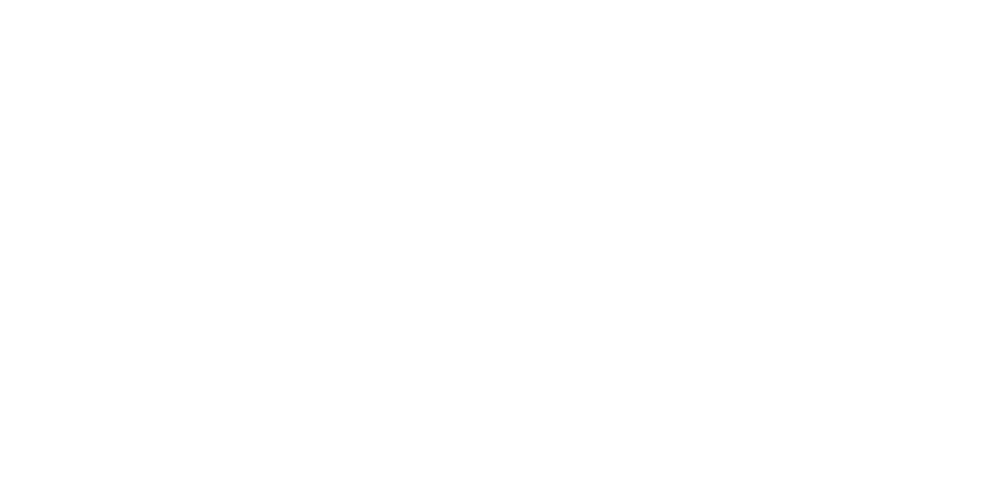

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


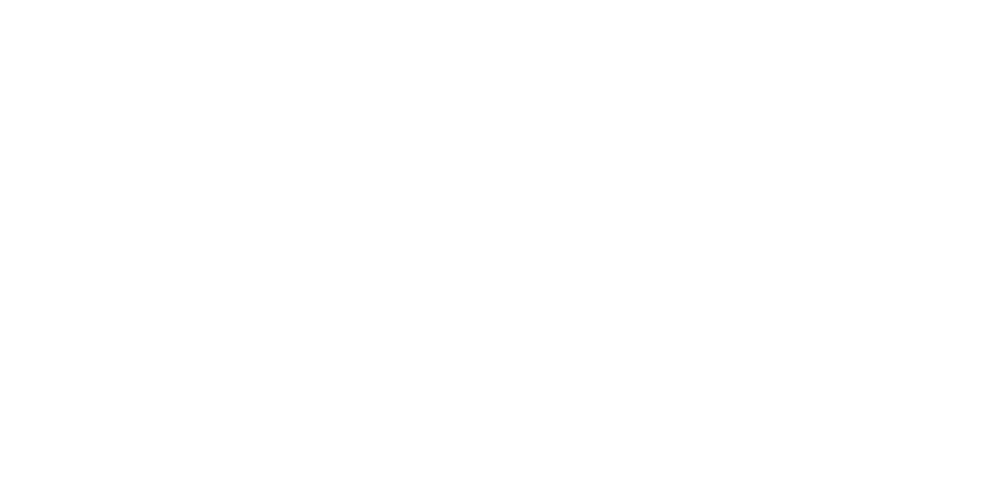

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


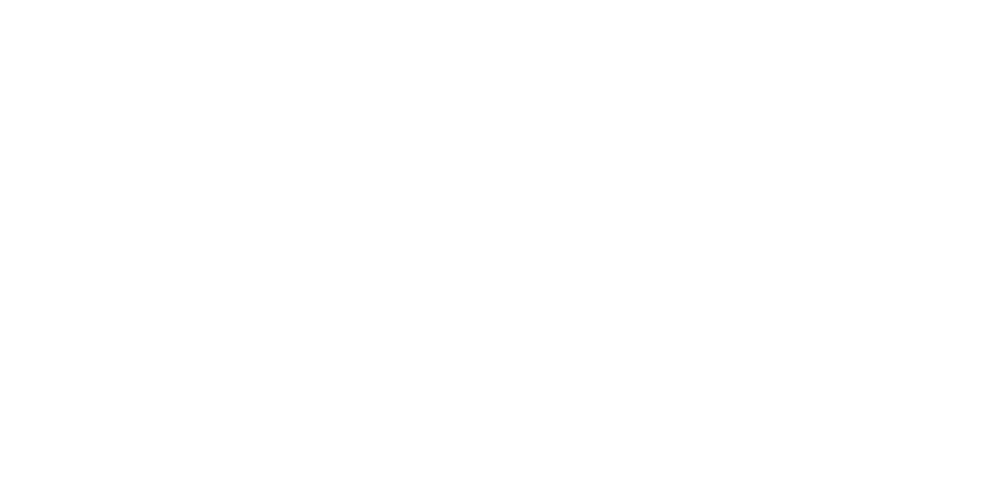

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


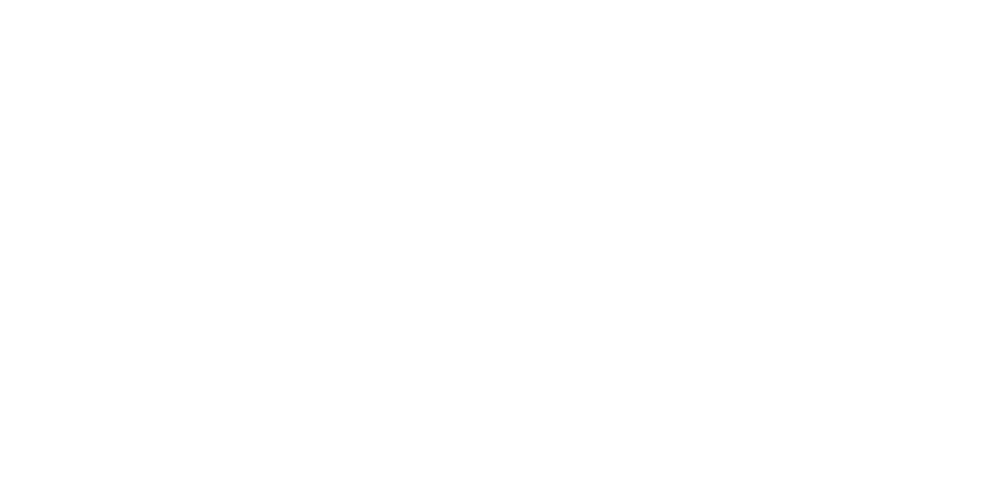

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


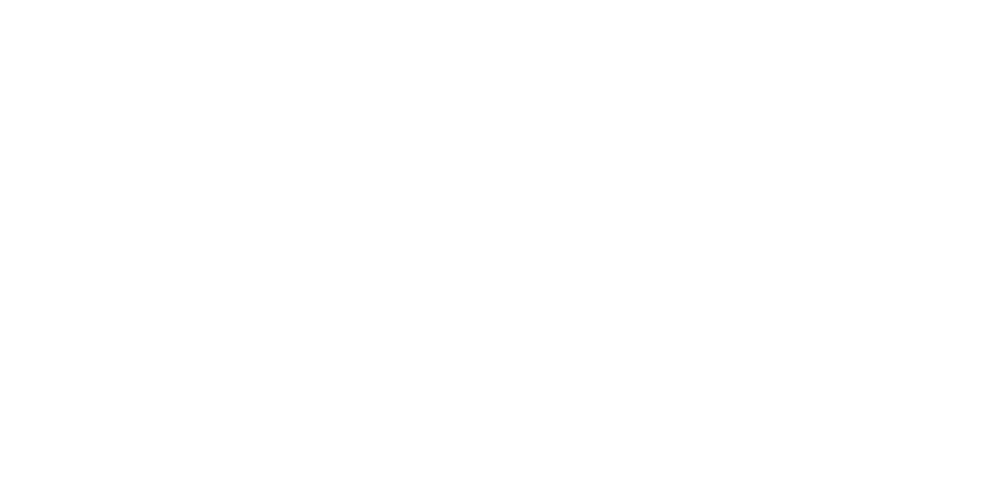

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


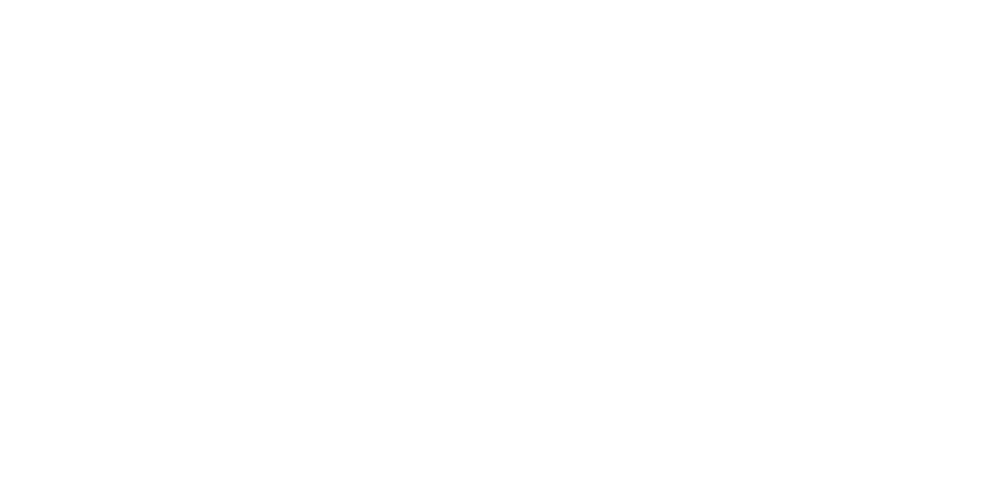

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


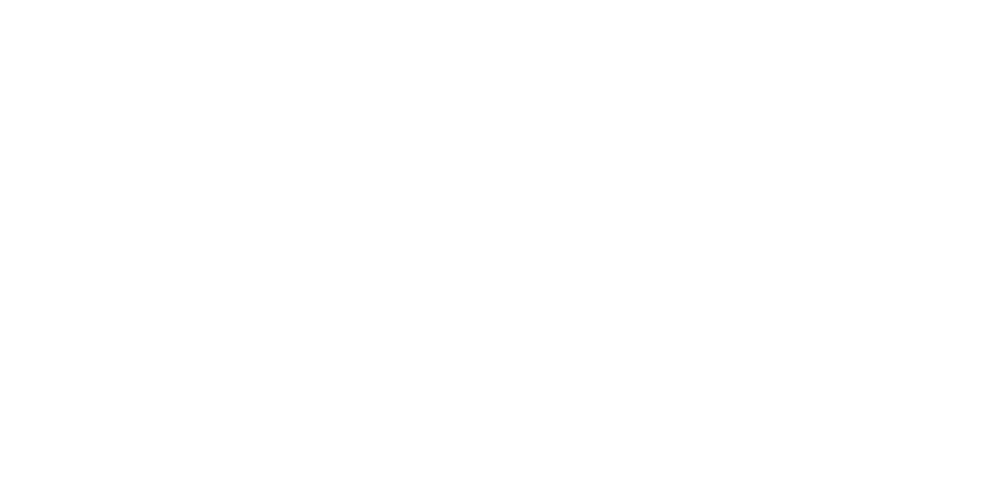

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


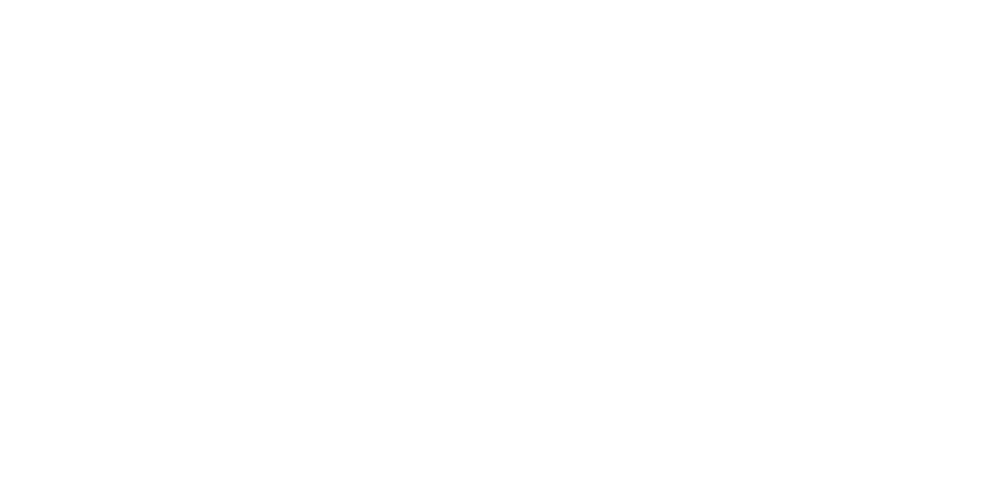

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


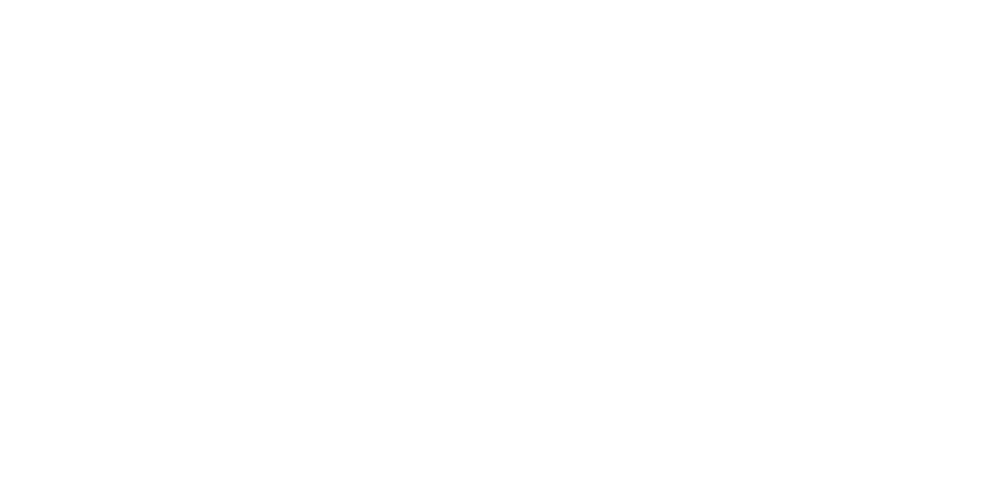

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


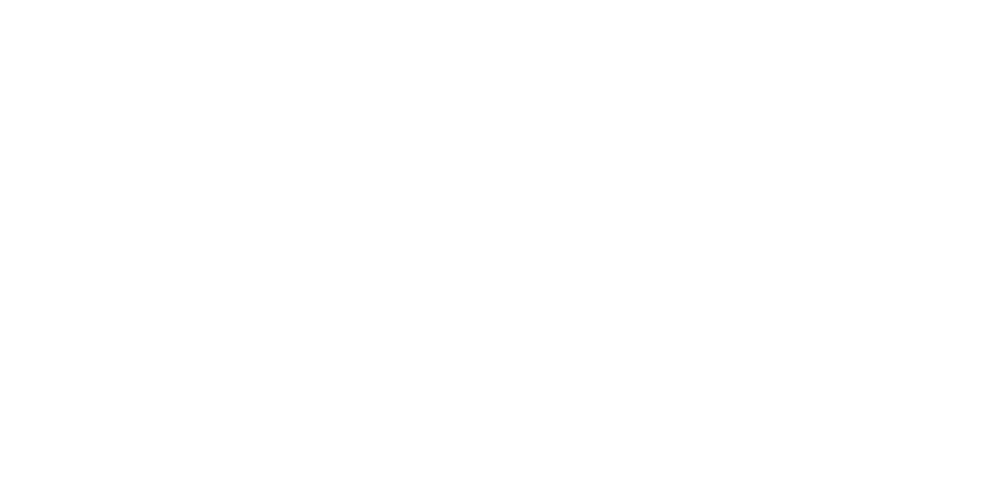

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


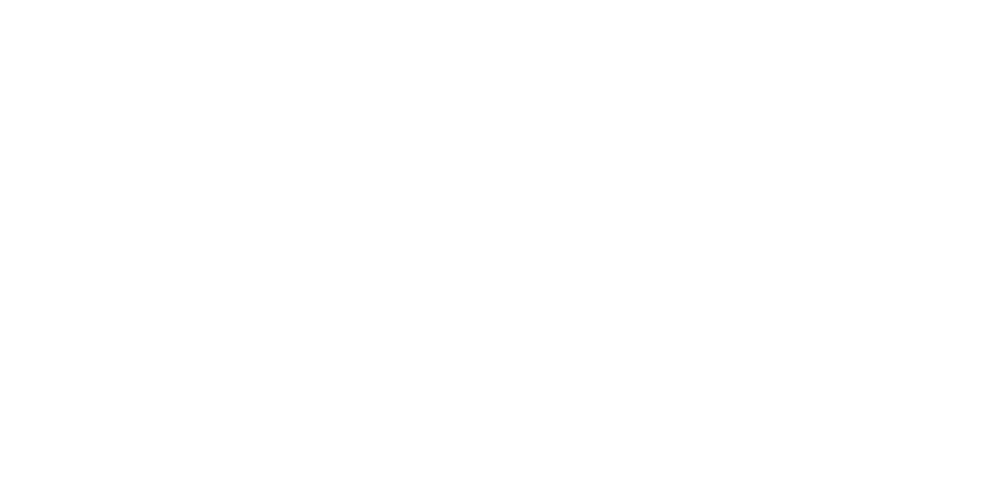

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


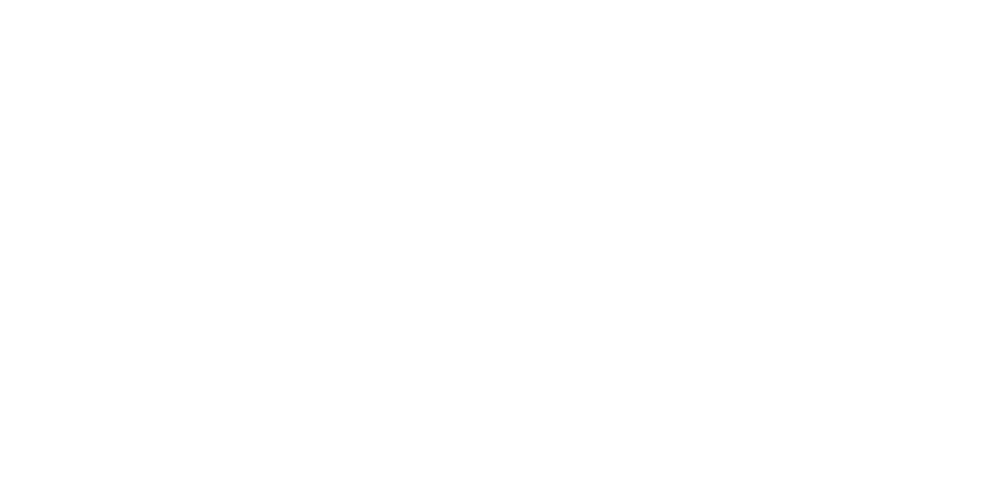

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


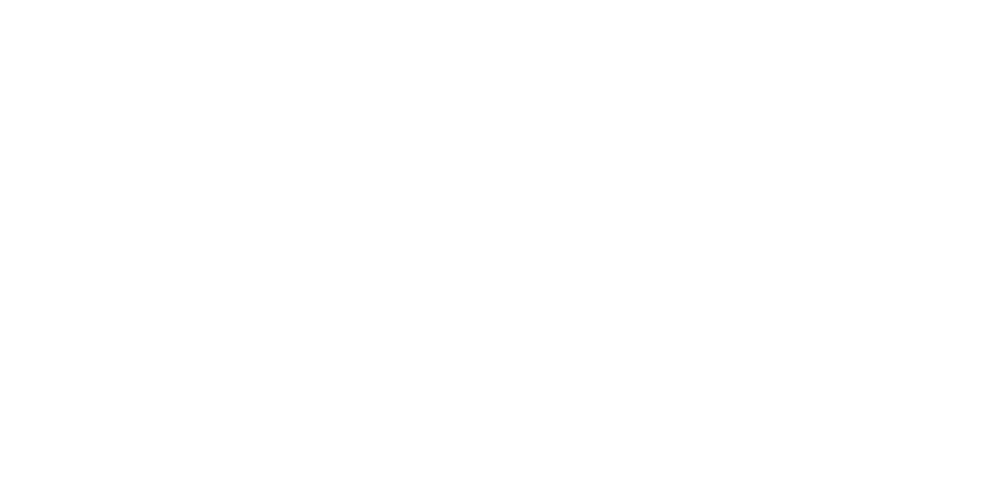

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


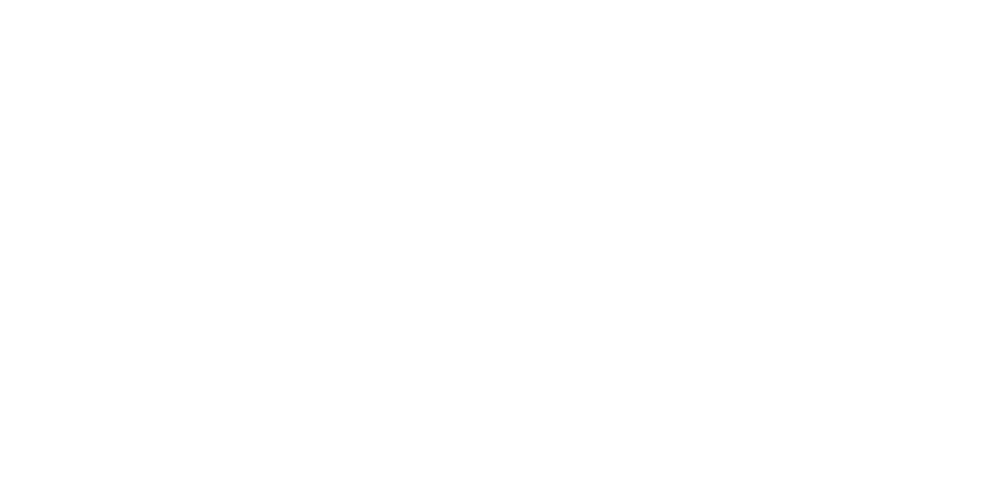

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


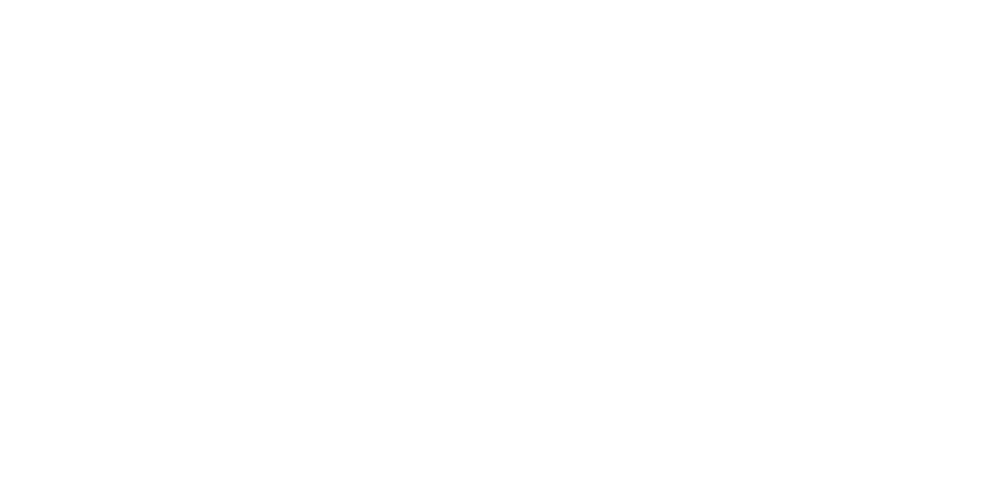

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


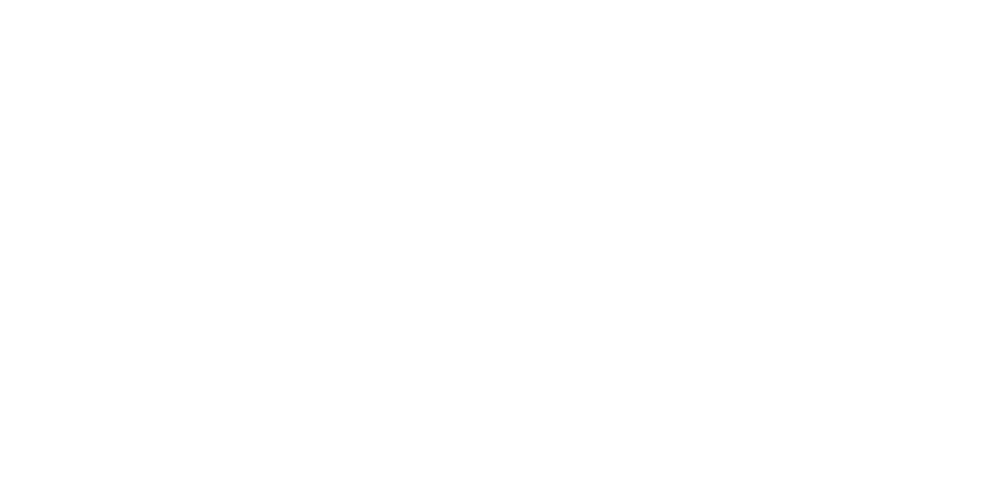

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


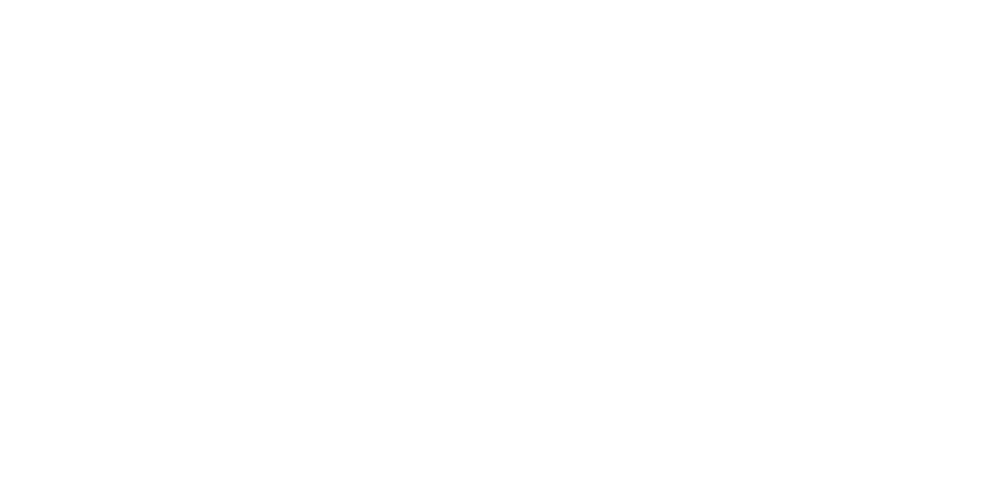

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


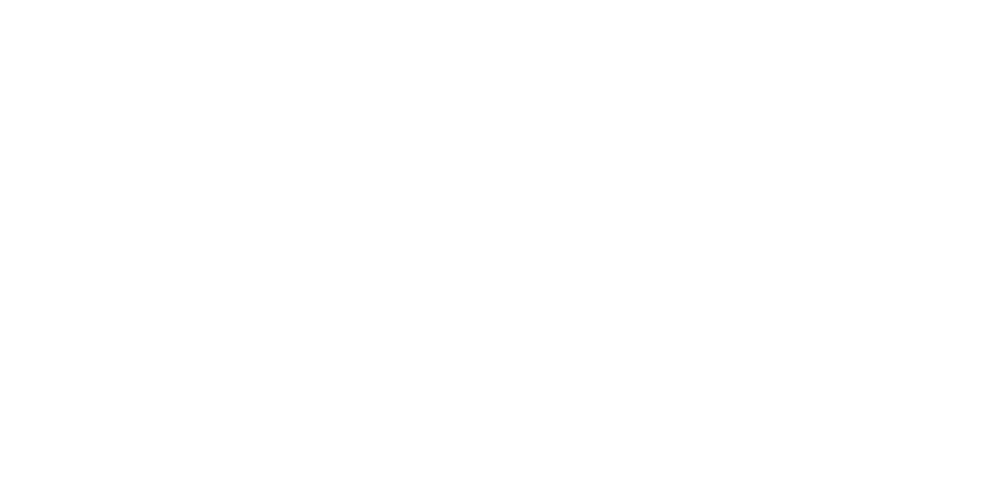

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


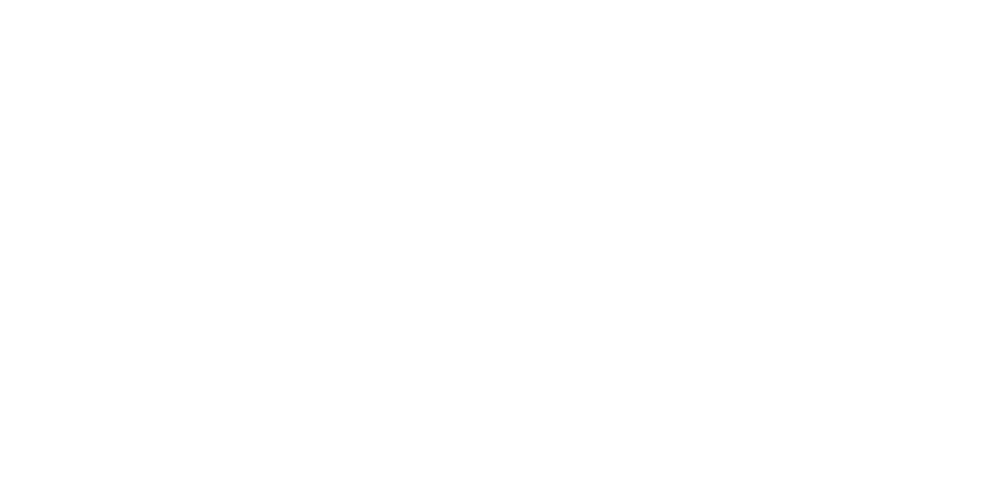

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


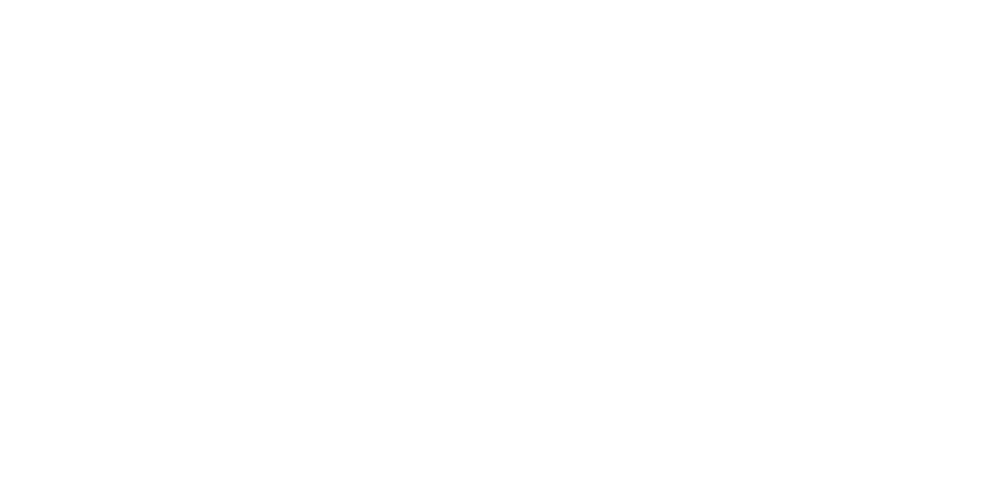

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


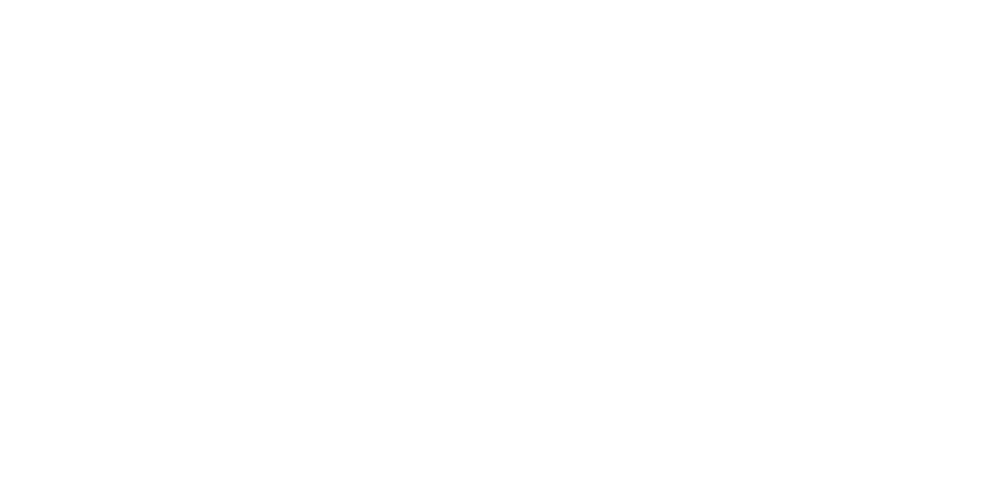

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


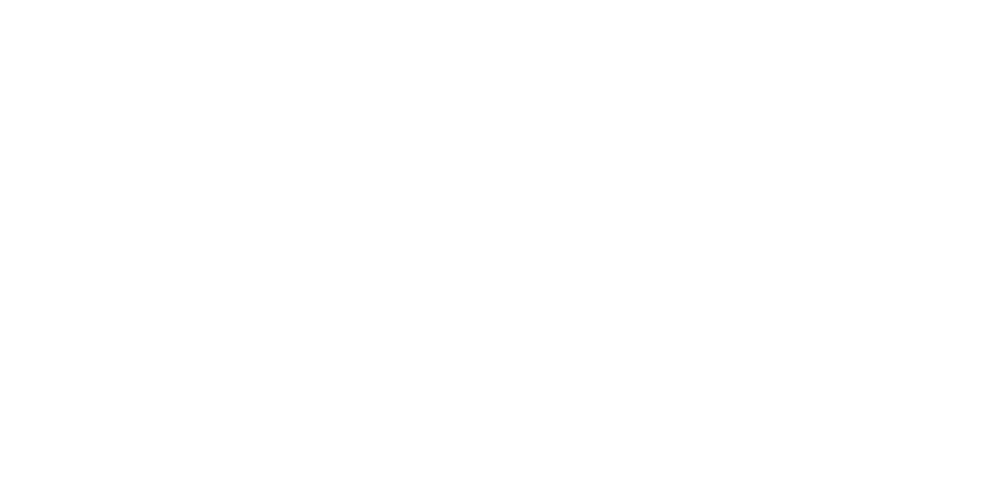

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


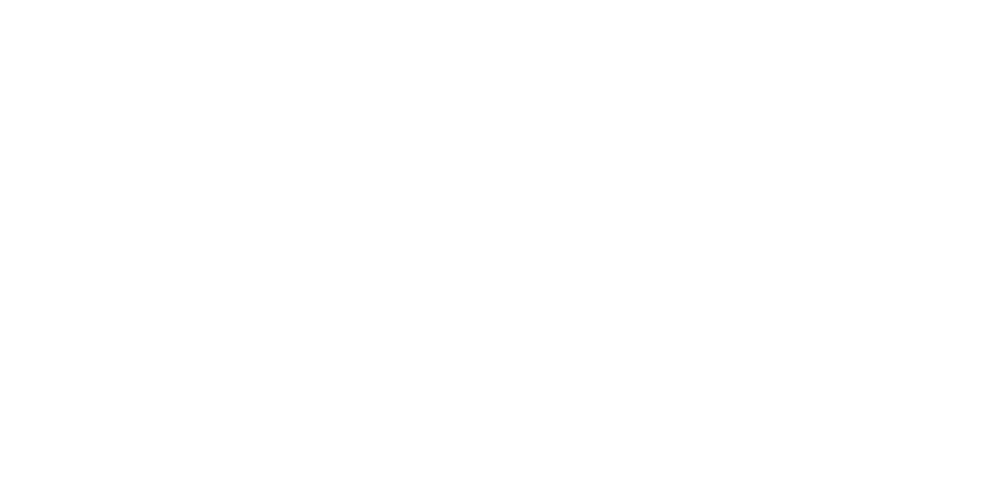

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


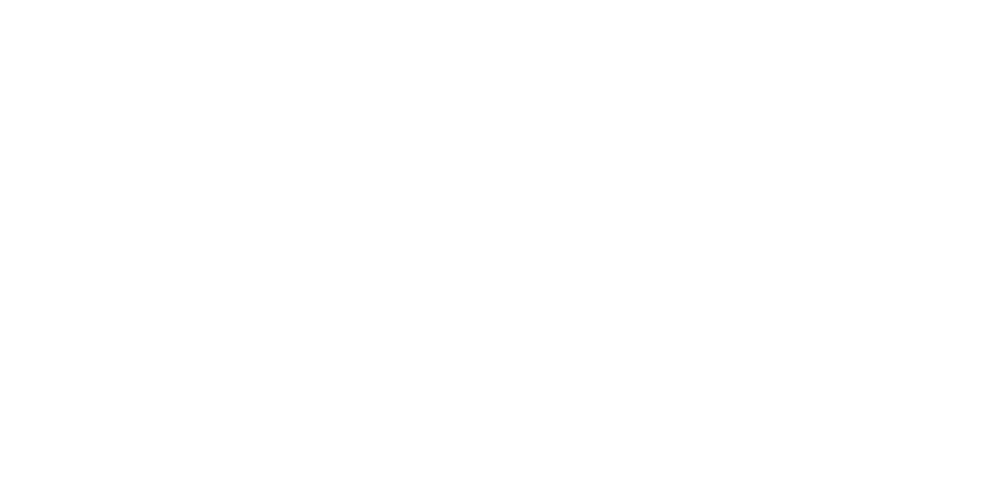

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


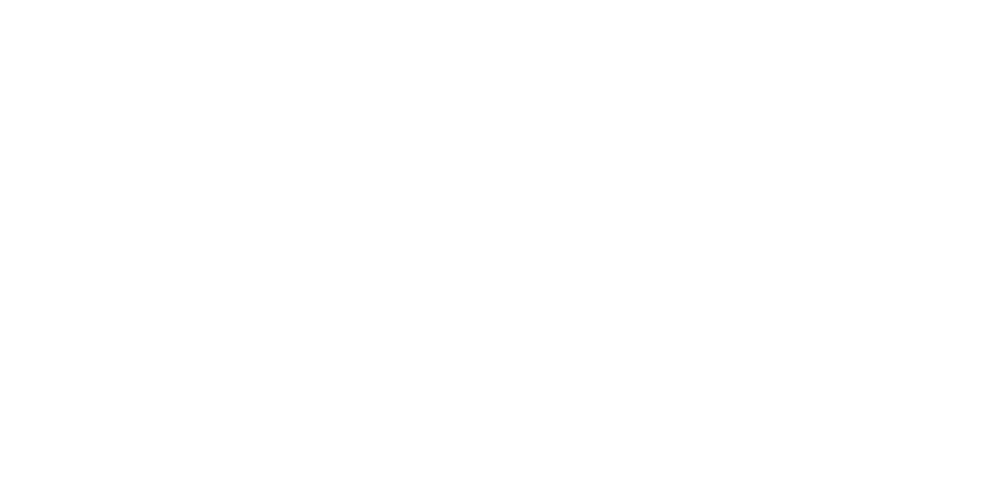

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


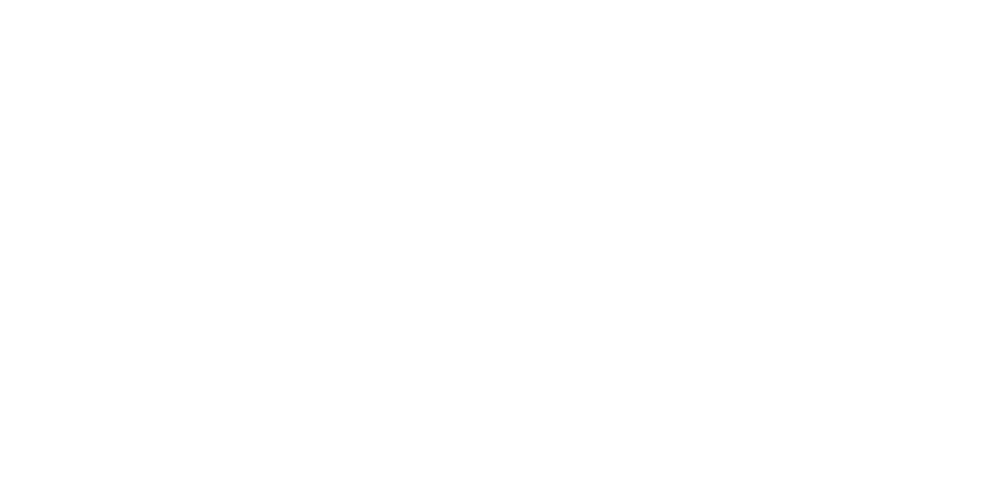

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


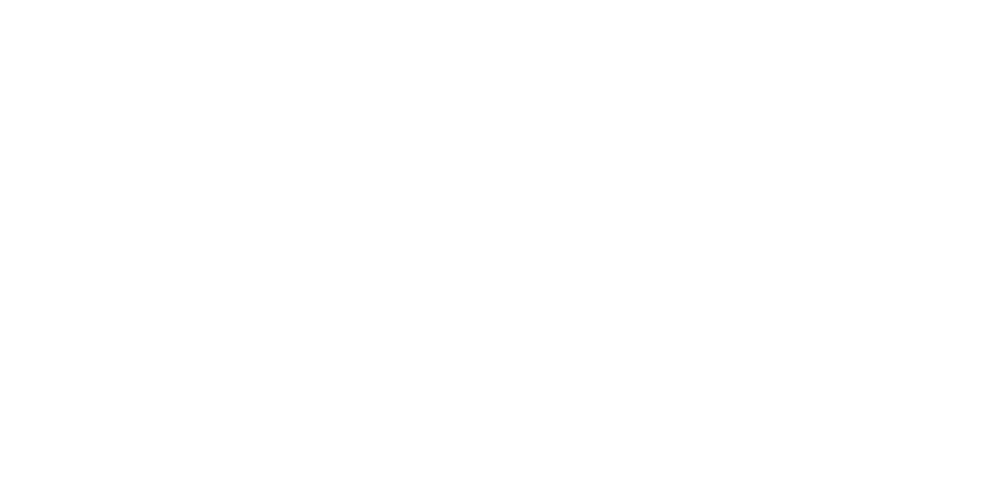

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


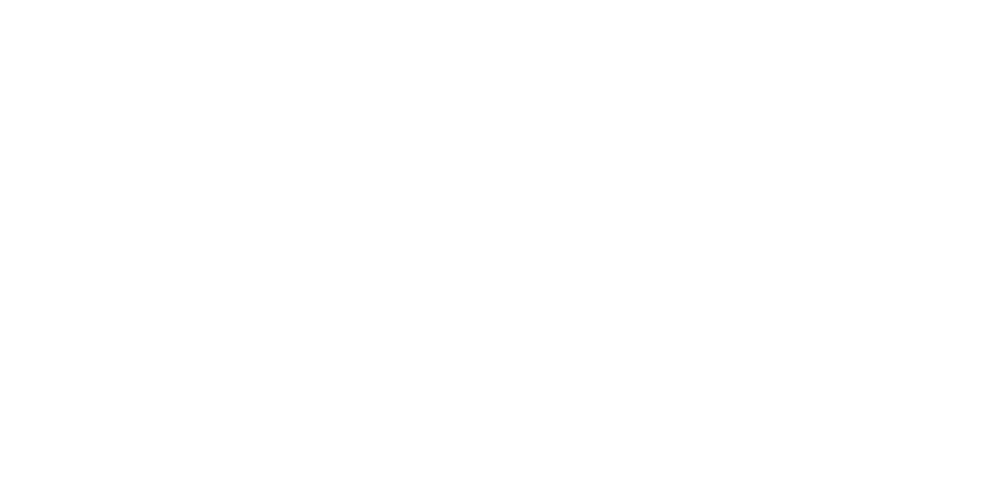

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


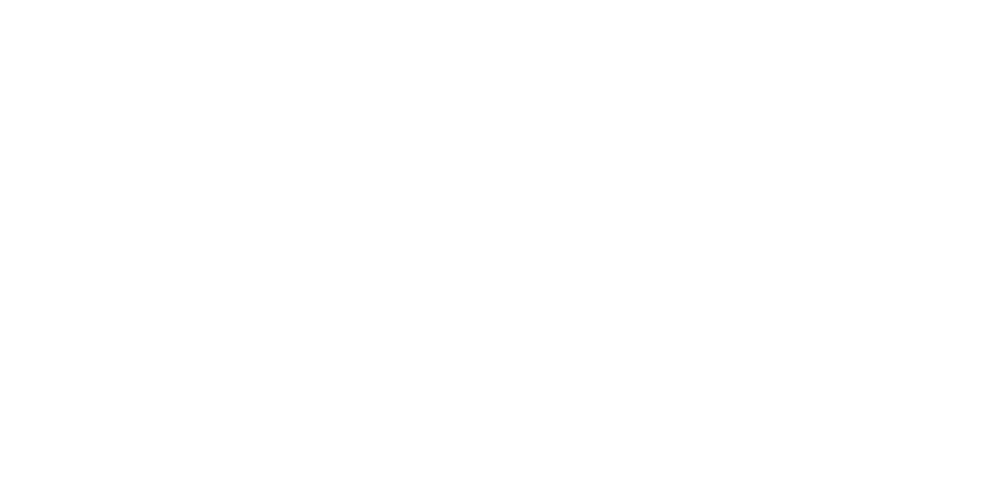

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


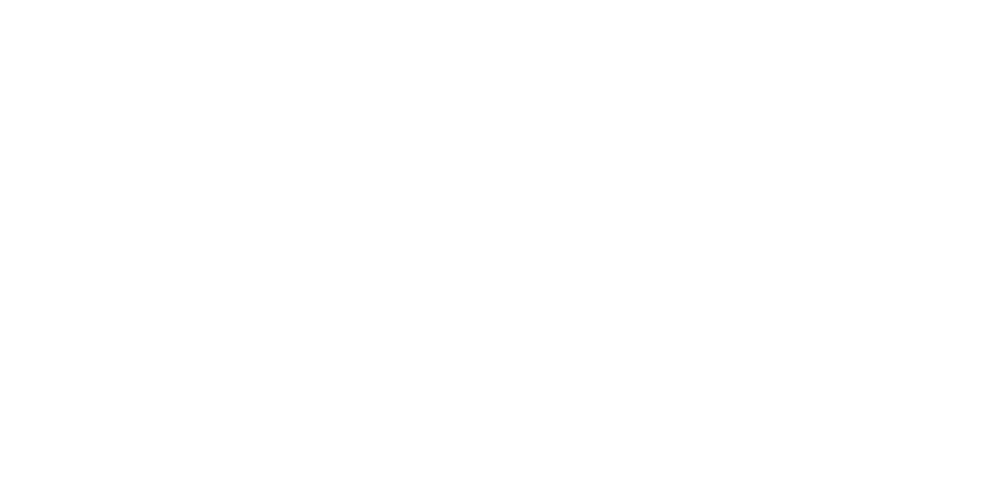

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


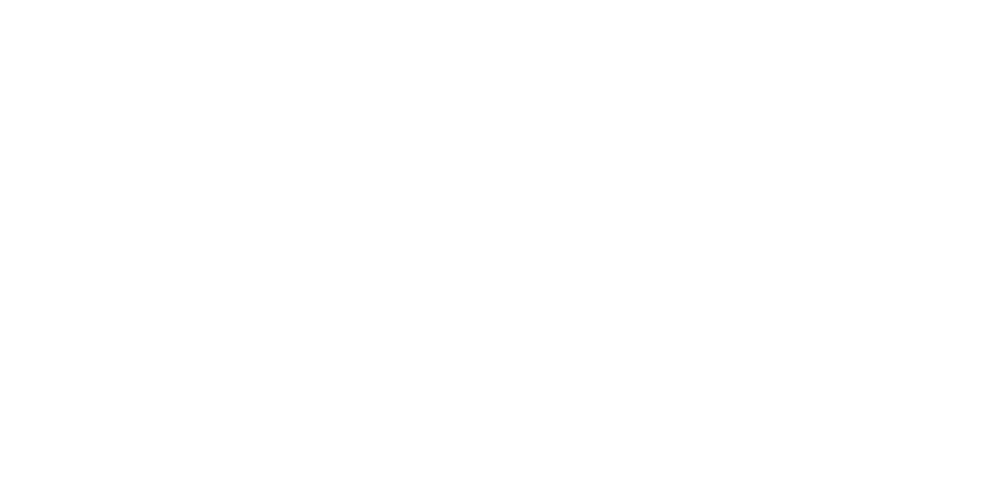

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


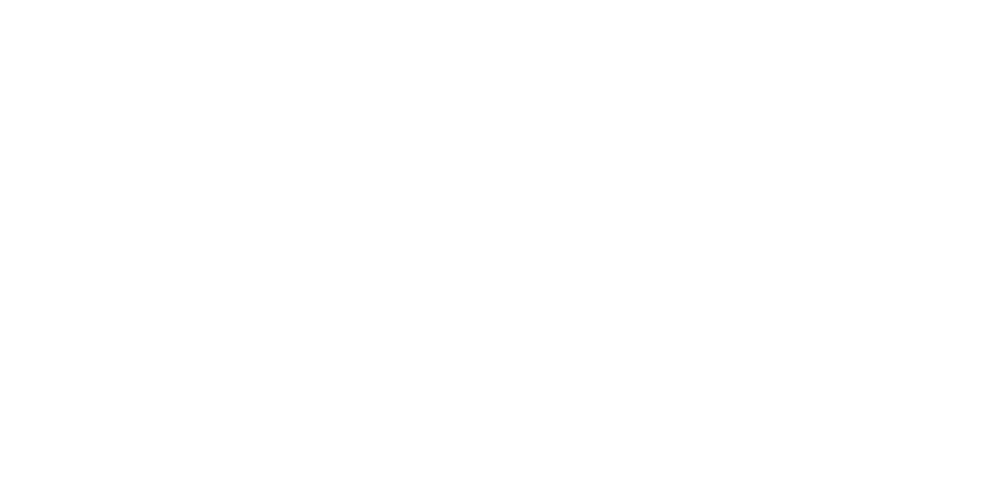

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


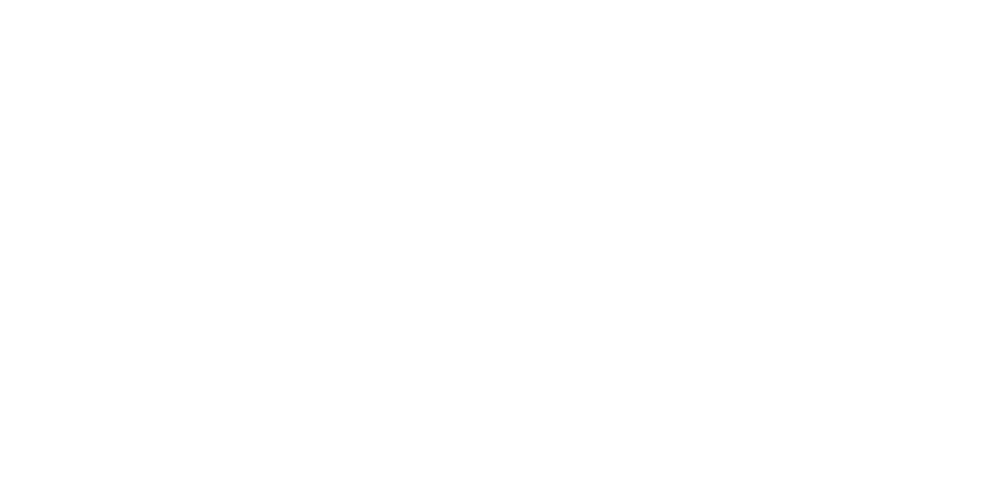

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


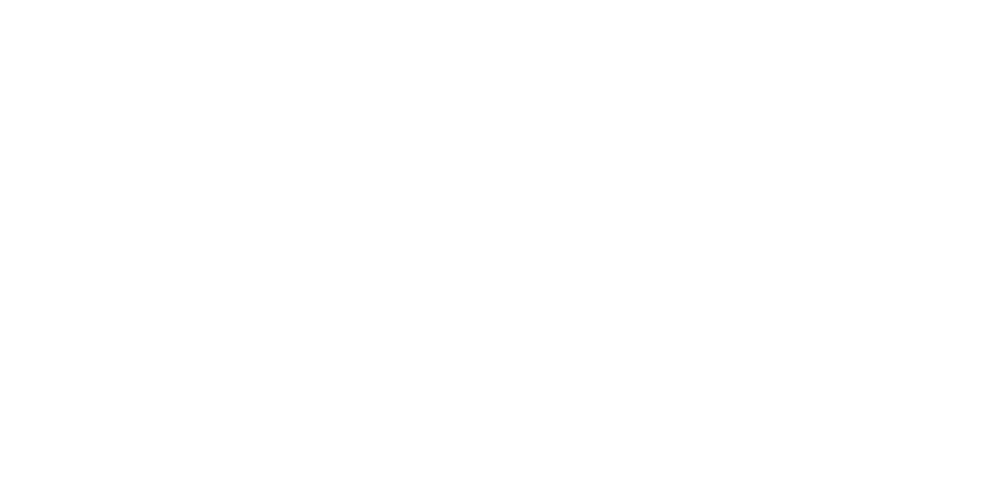

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


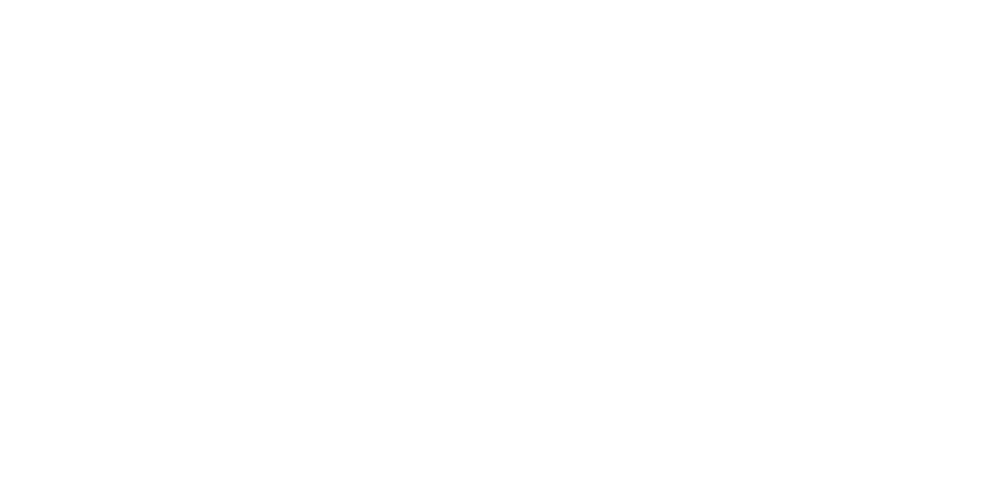

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


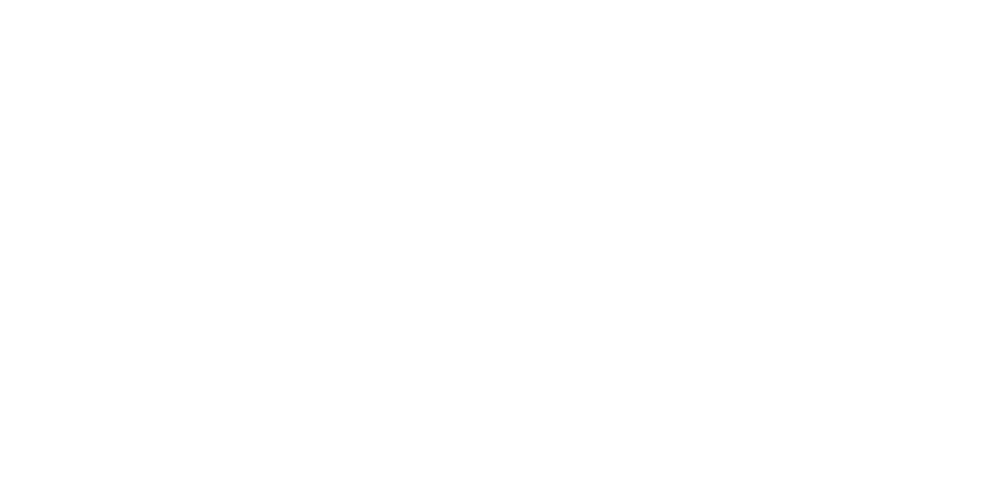

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


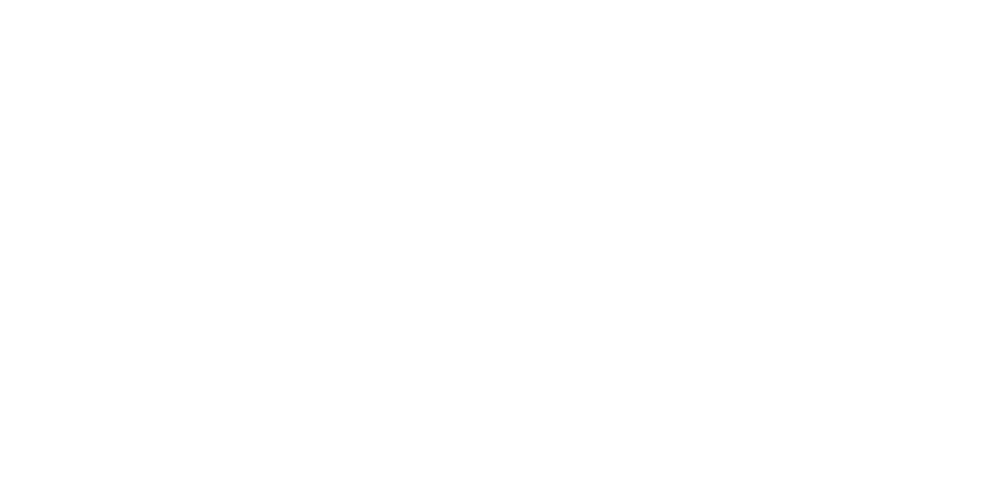

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


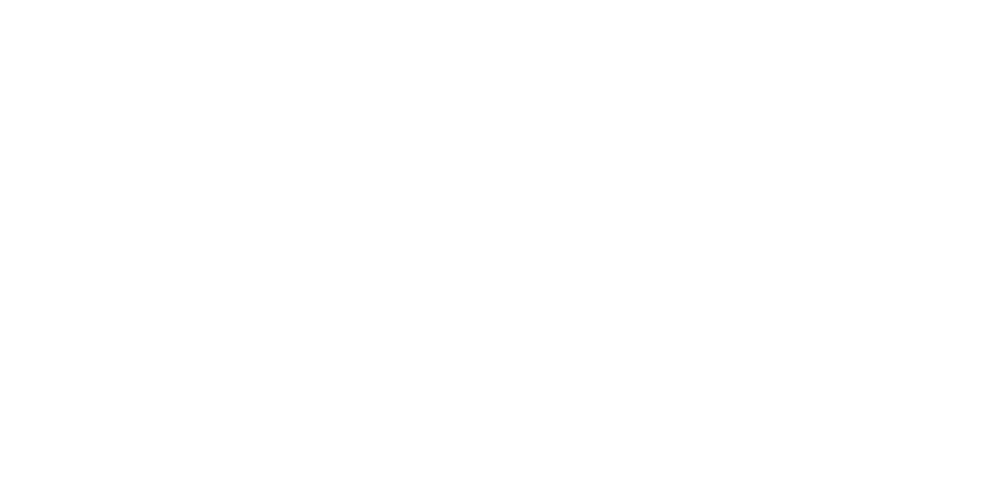

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


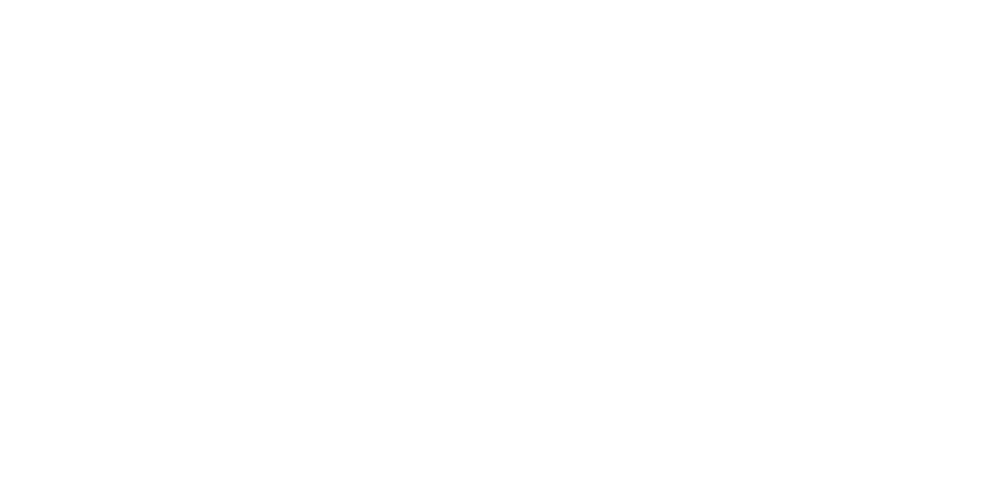

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


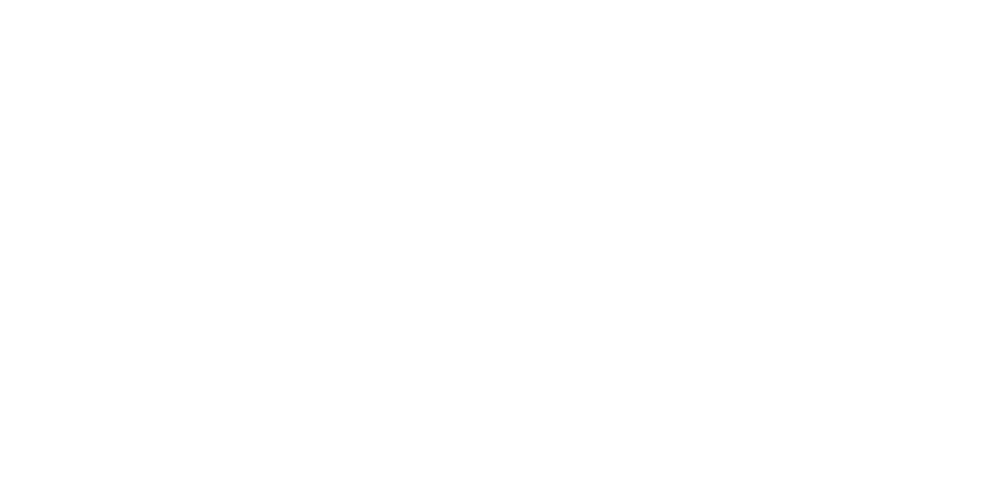

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


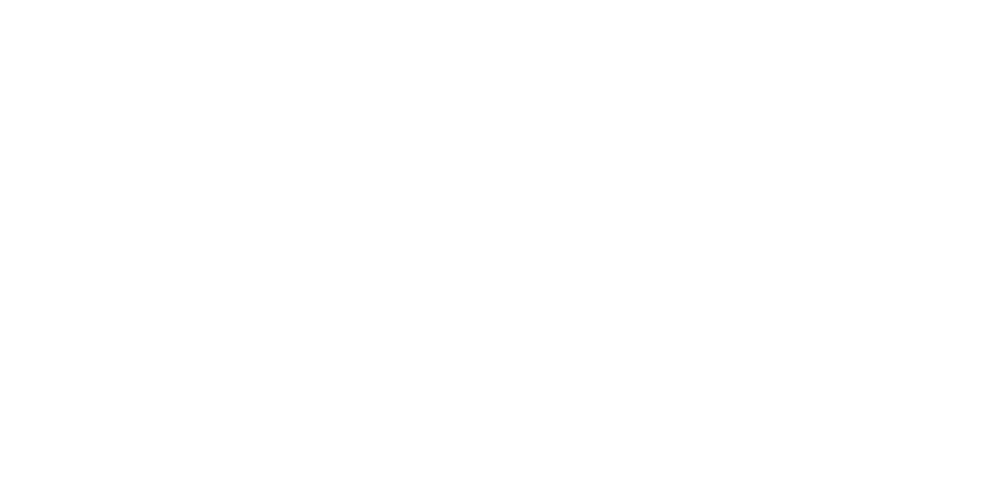

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


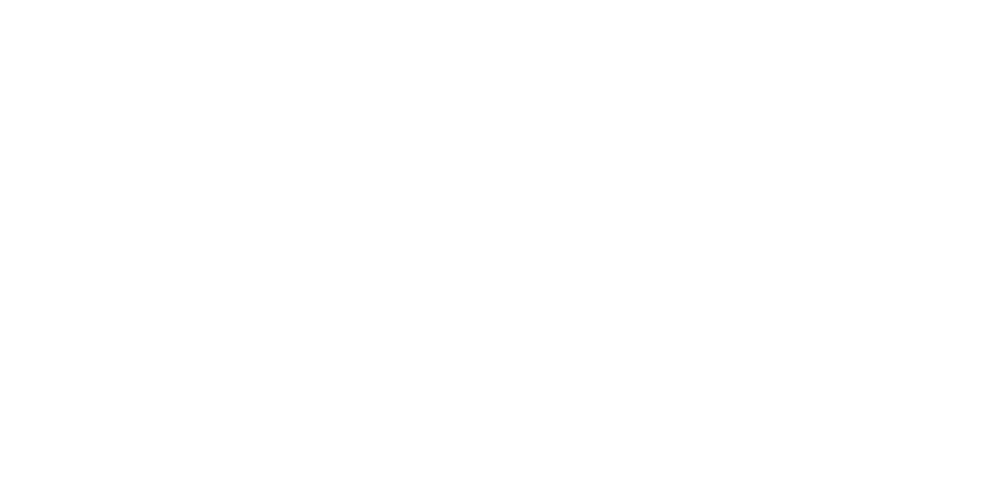

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


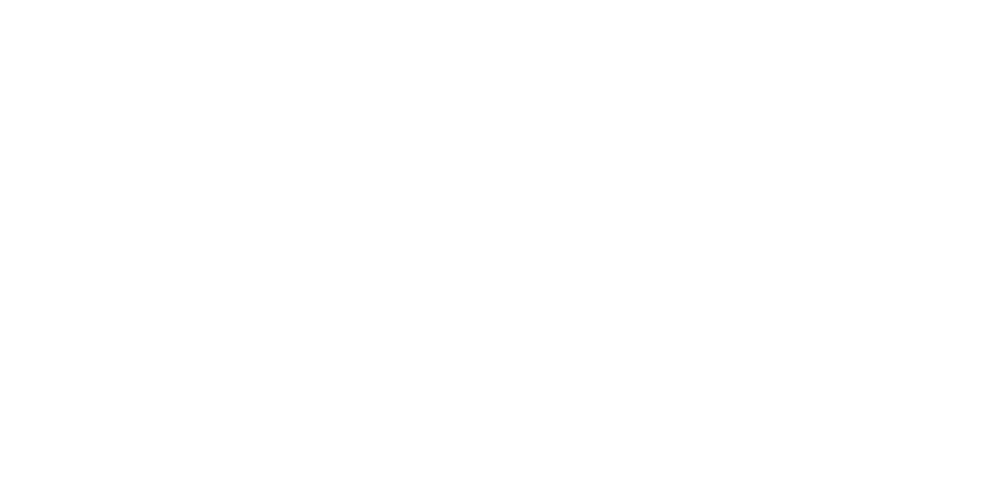

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


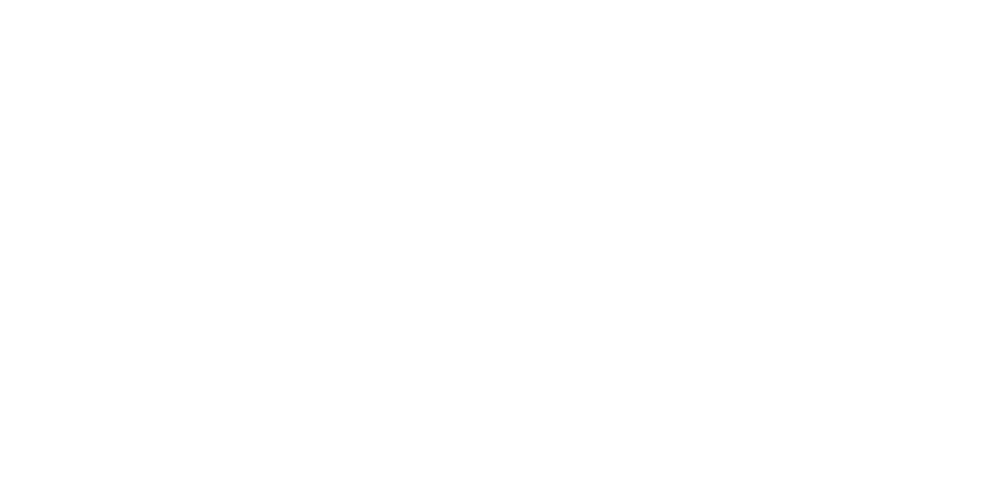

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


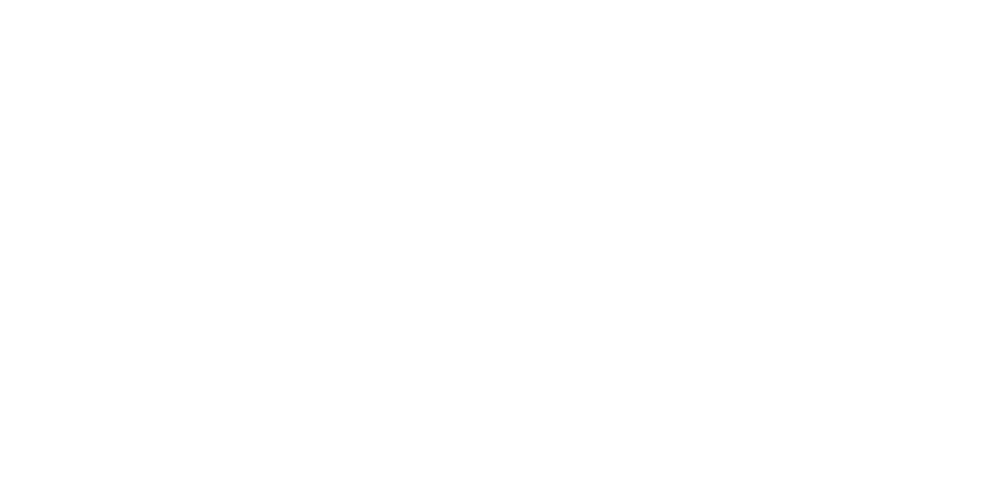

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


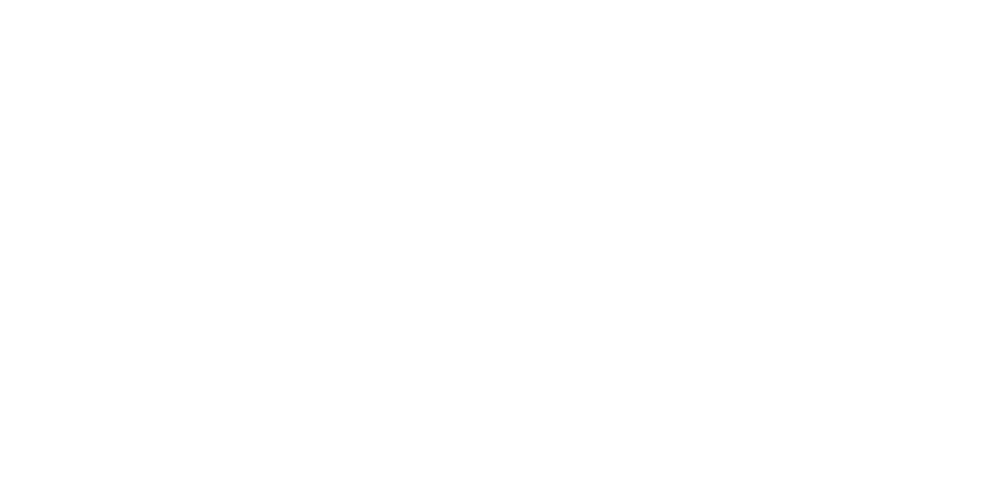

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


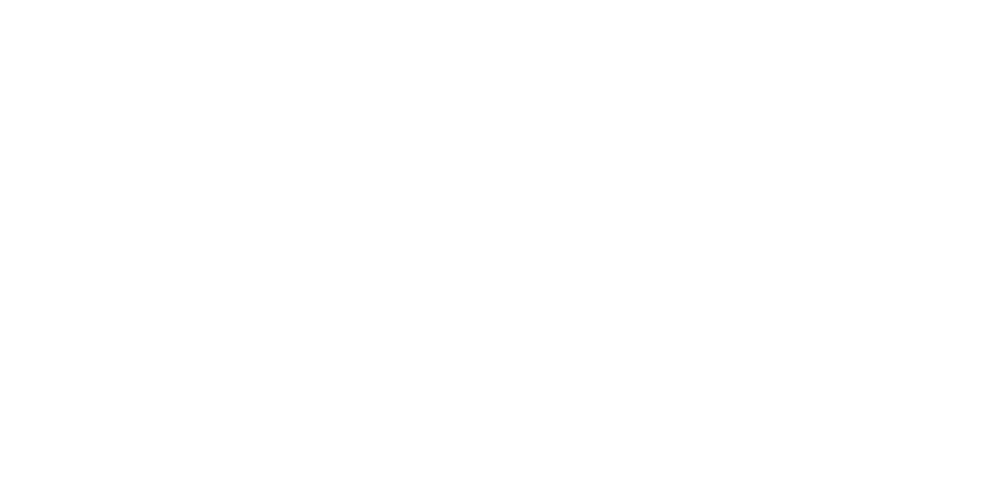

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


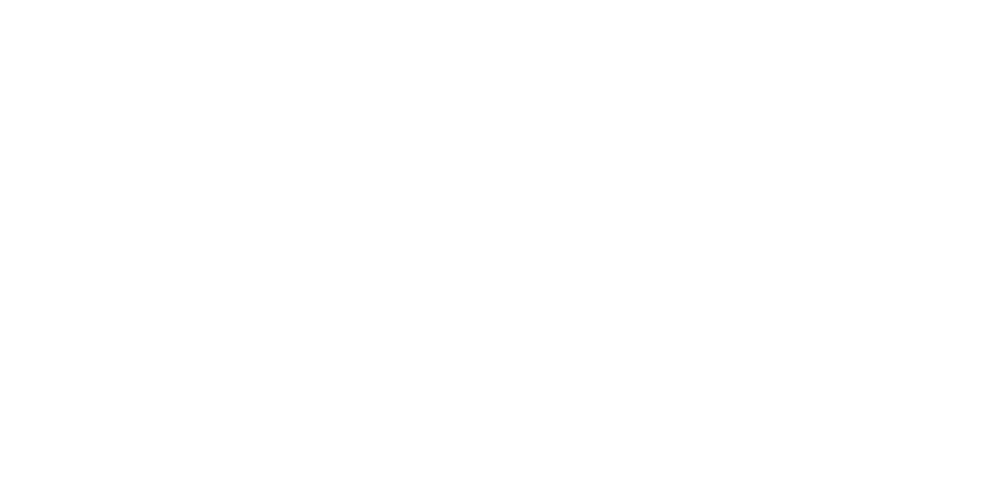

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


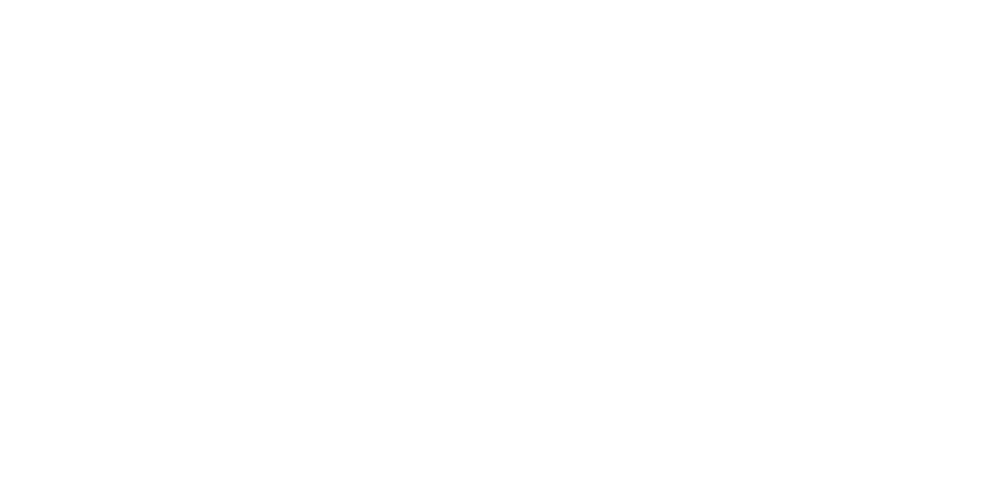

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


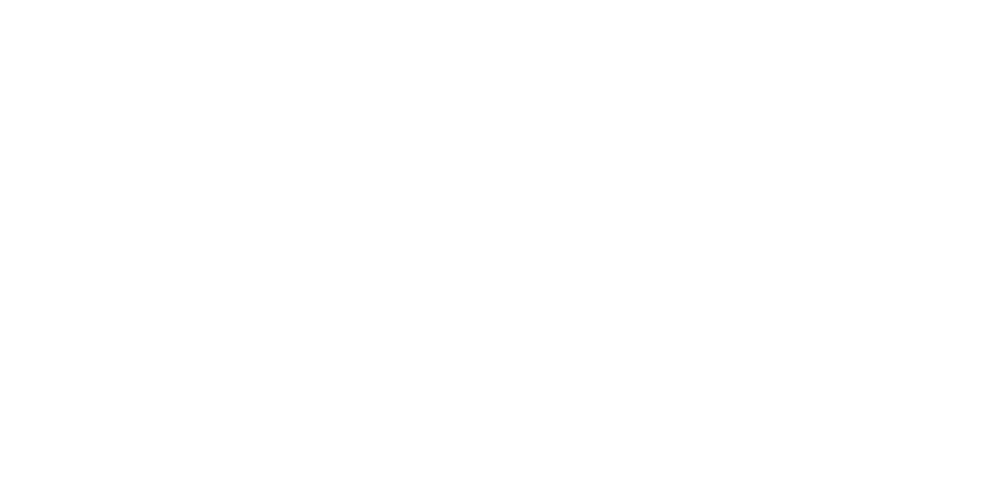

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


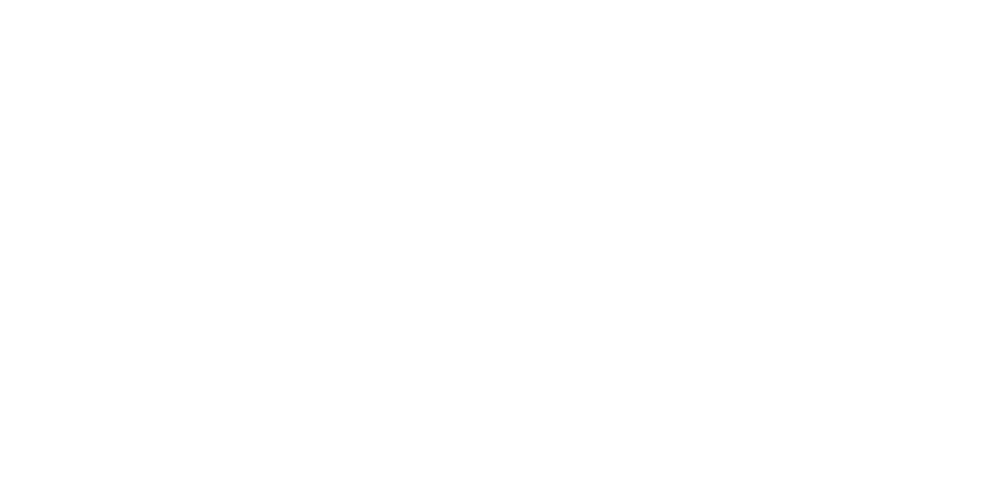

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


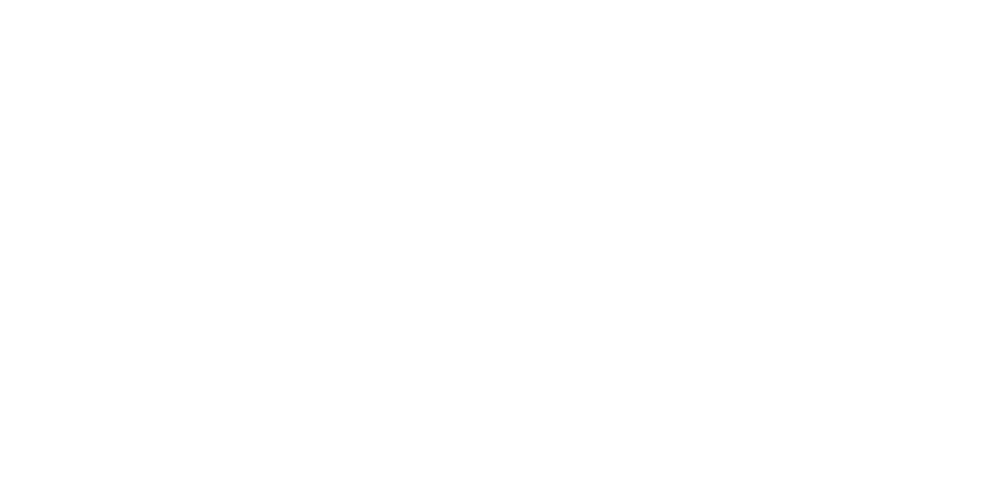

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


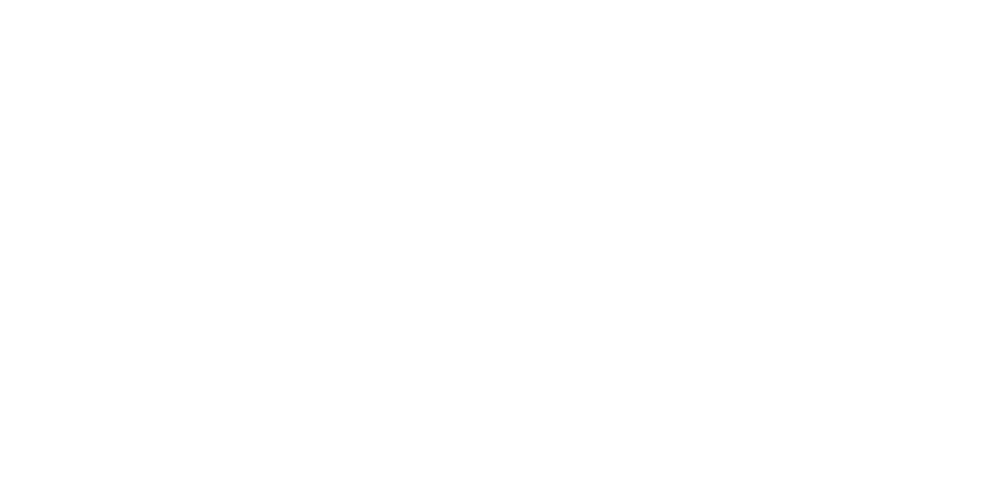

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


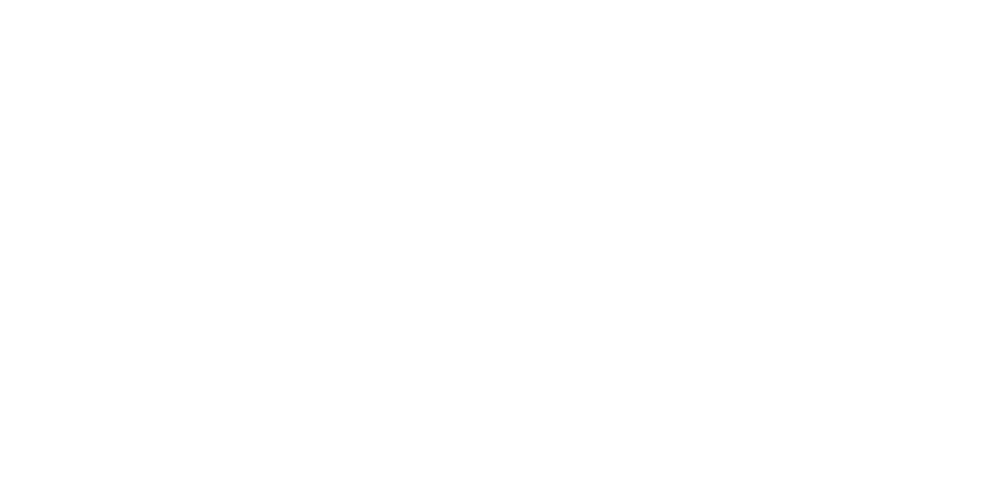

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


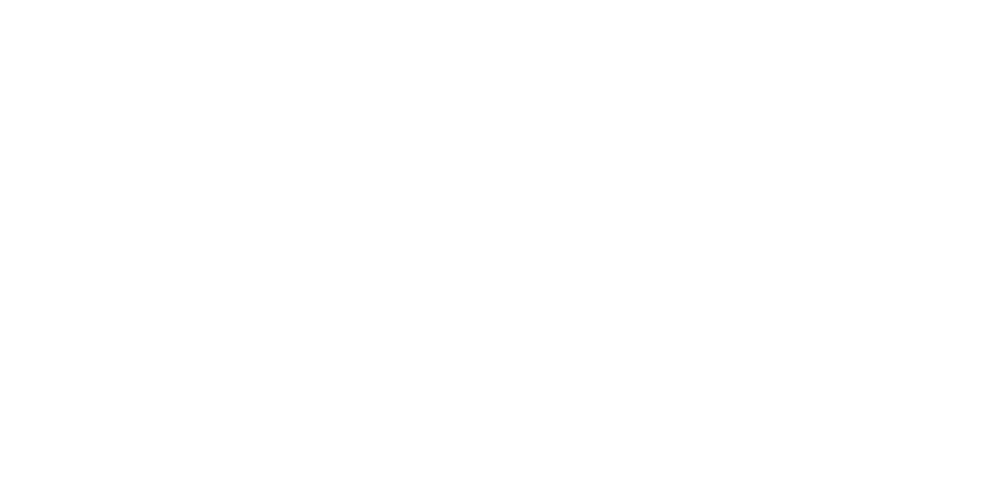

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


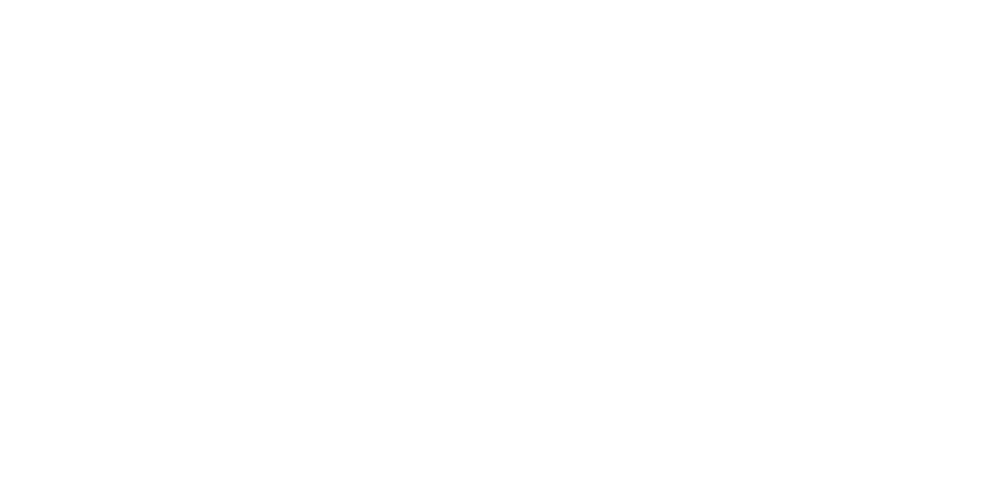

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


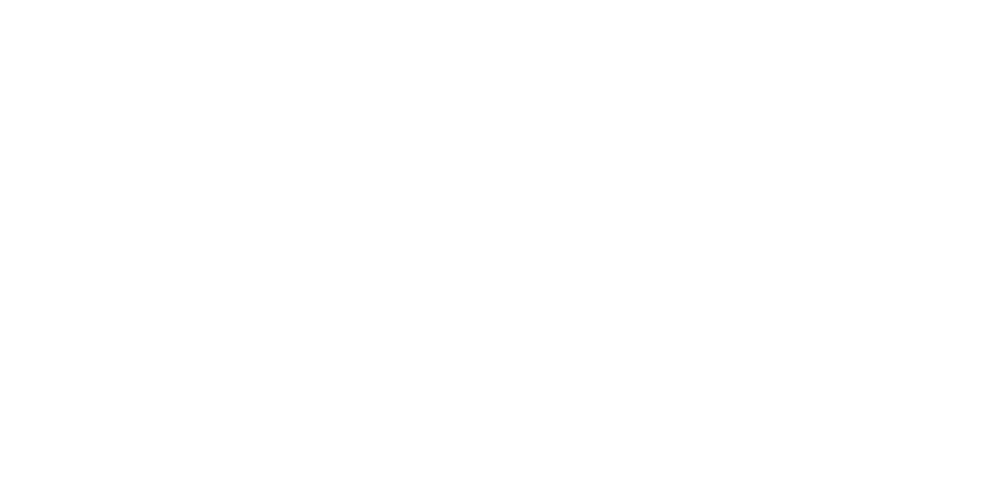

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


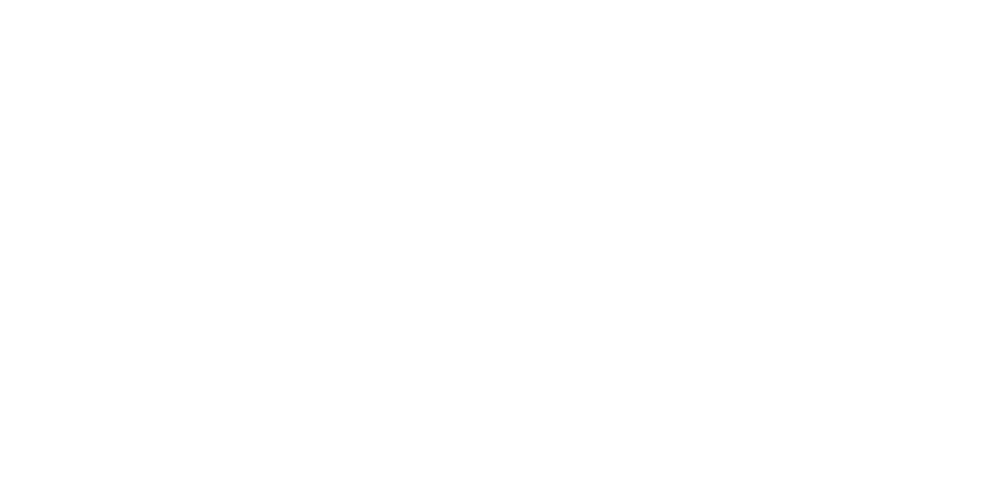

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


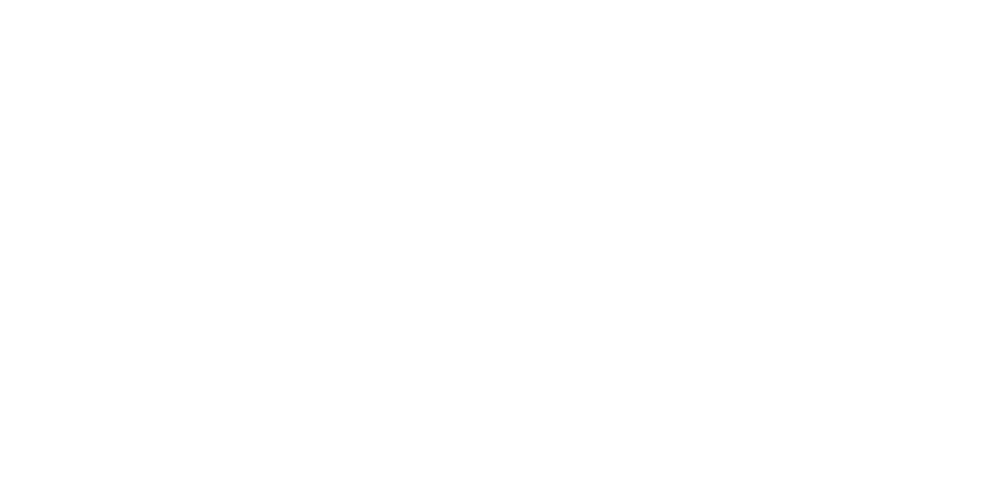

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


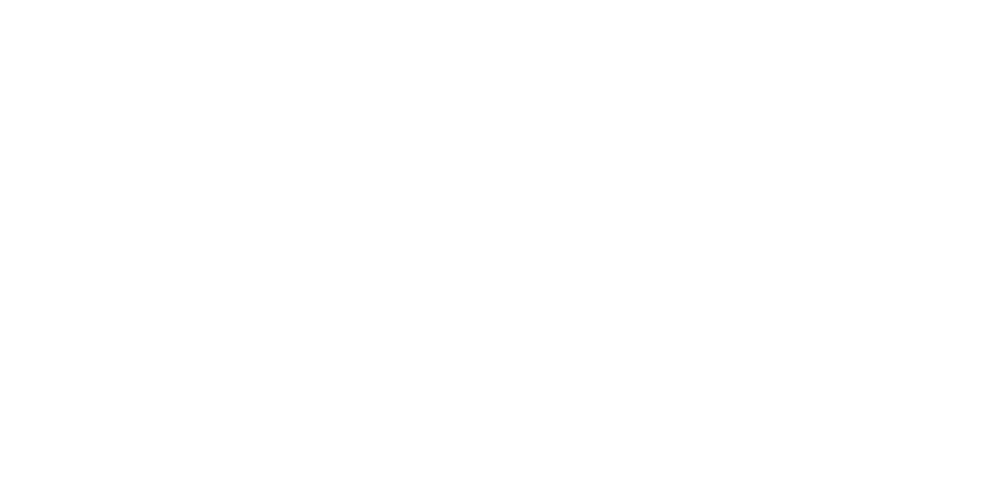

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


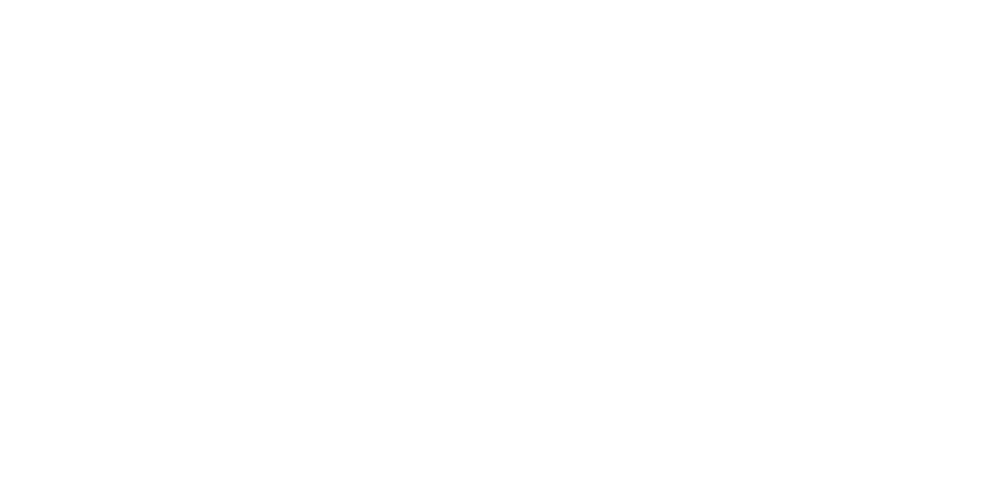

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


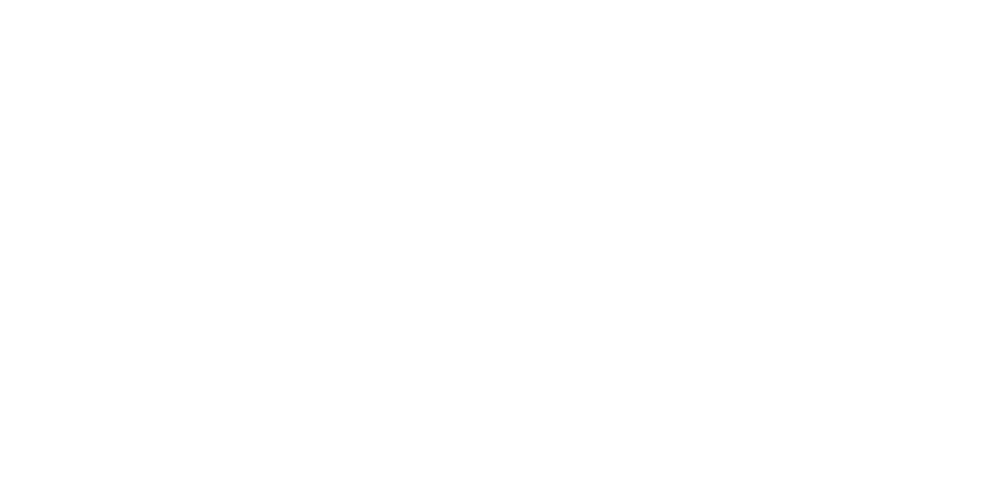

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


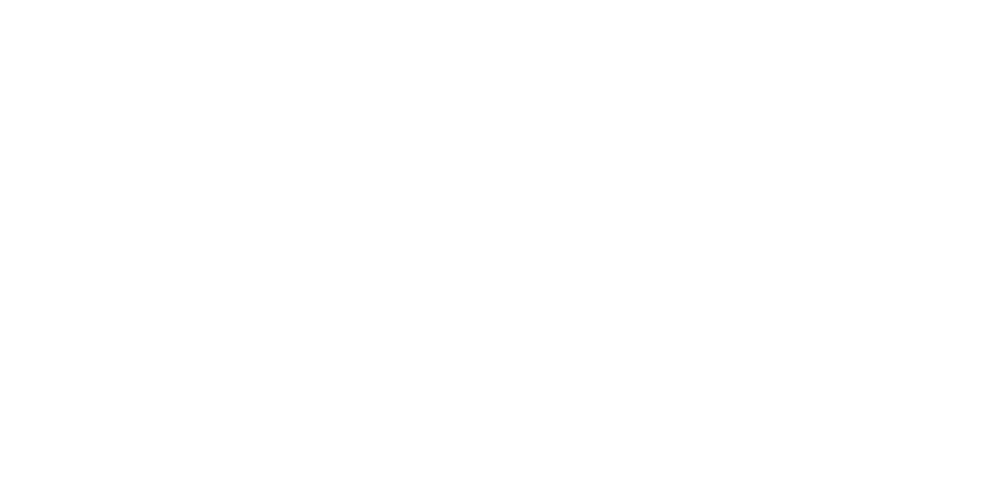

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


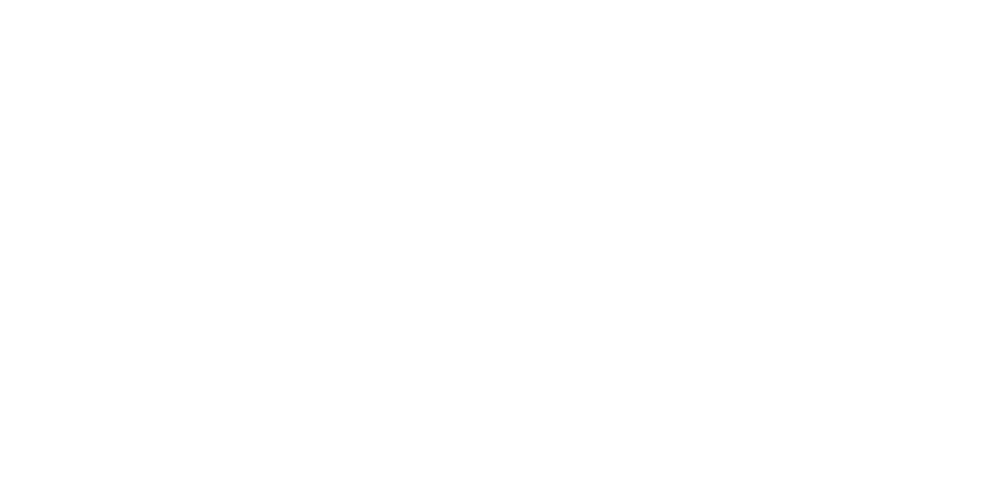

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


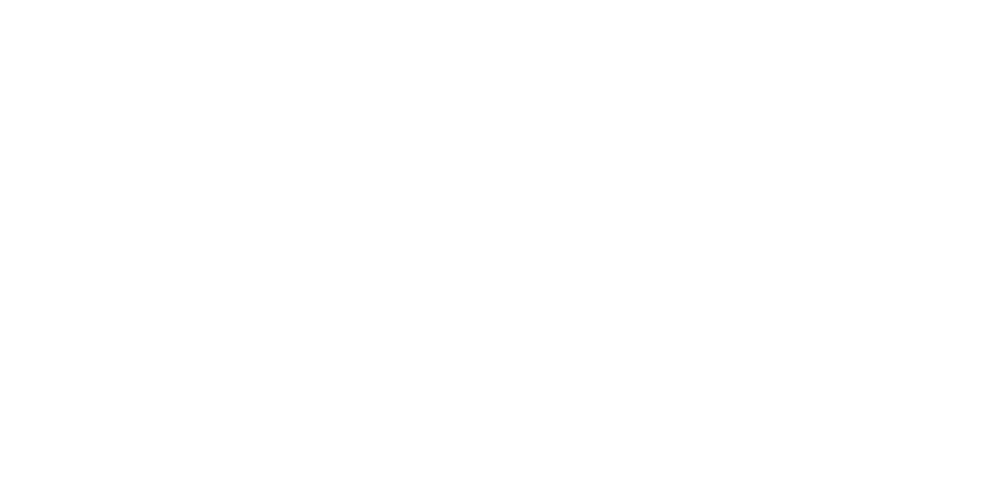

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


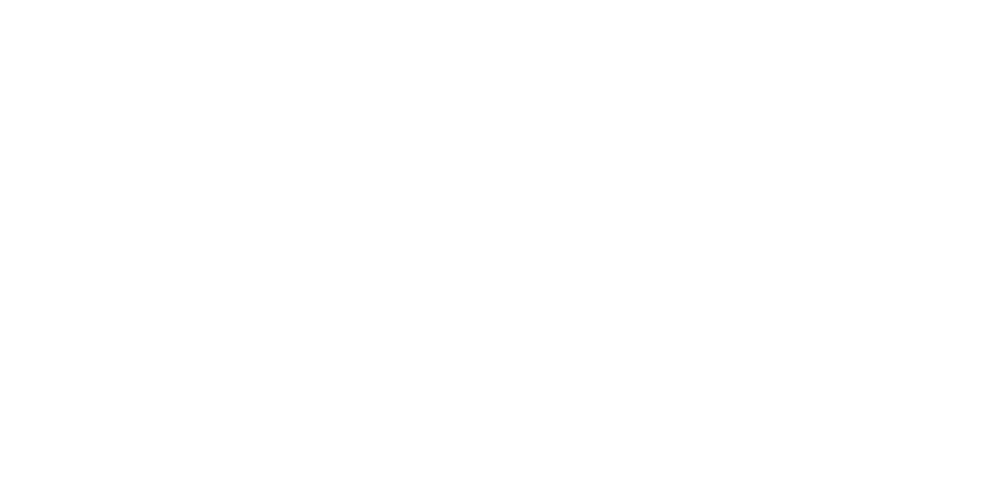

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


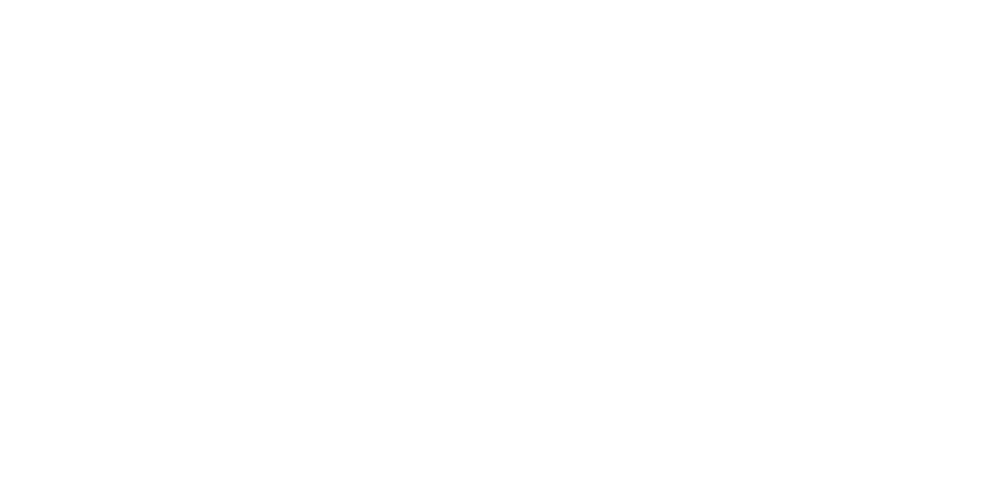

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


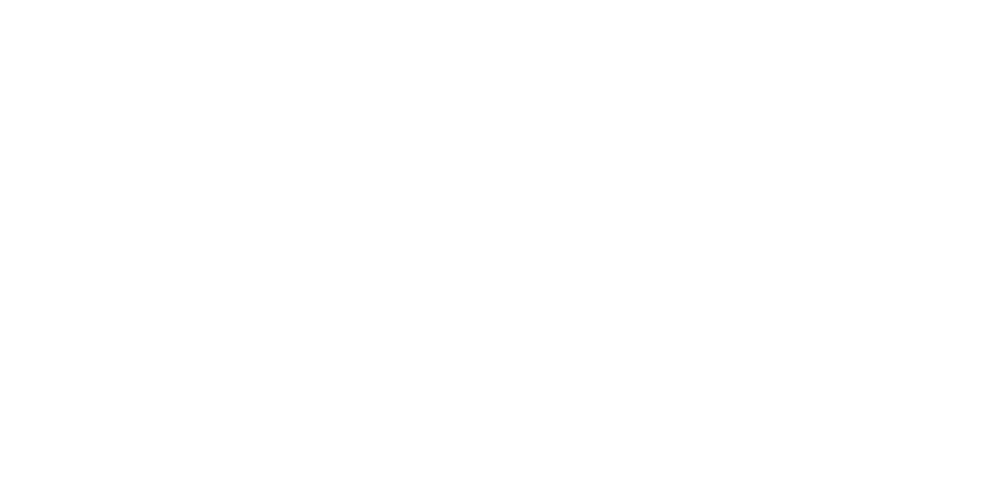

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


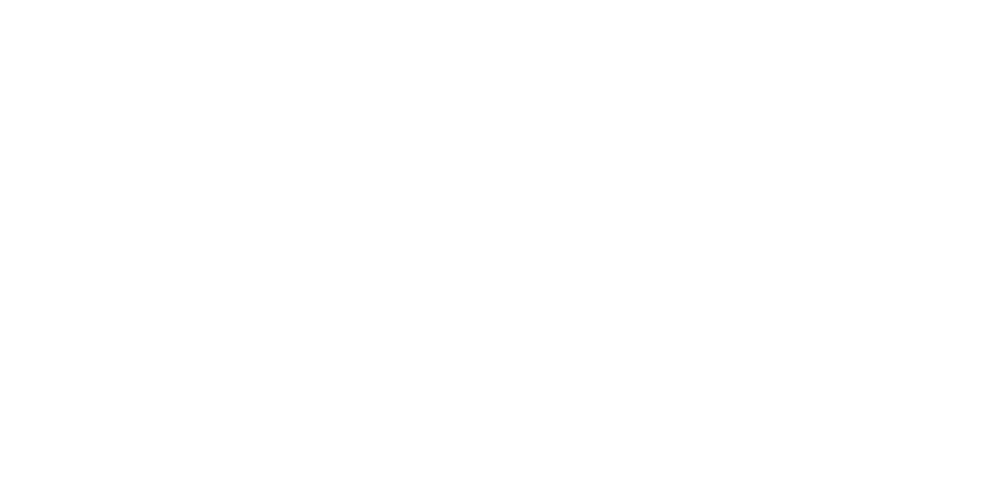

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>


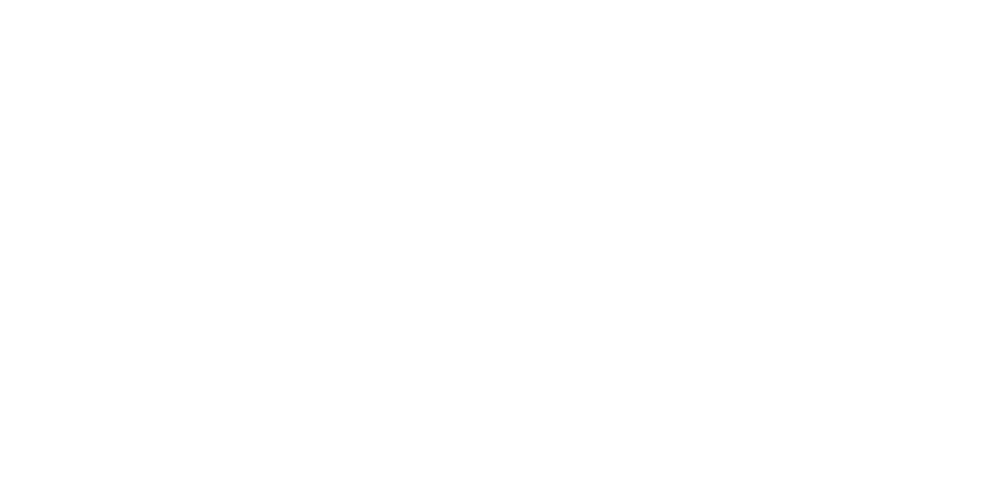

31 tif files (each with 4610 frames) = 138880 frames
Requested df -- not found
-- averaging deconvolved


<IPython.core.display.Javascript object>

In [ ]:
filetype = 'svg'
for rid in range(nrois):
    # Get current roi's time courses
    trace_array = extracted_traces[rid, :].reshape(nfiles, nframes_per_file, order='C')
    ntifs_total, nframes_per_tif = trace_array.shape

    combined_frames = np.hstack(np.array([np.nan if np.isnan(i) else trace_array[fi, int(i)]\
                            for i in np.hstack(ixs.values.T)]) for fi, ixs in sorted(frames_by_file.items(),\
                                                                                     key=lambda x: x[0]))
    print("%i tif files (each with %i frames) = %i frames" % (ntifs_total, nframes_per_tif, all_frames.shape[0]))

    # Make dataframe for 1 cell
    rdata = labels_c.copy()
    rdata['%s' % trace_type] = combined_frames #manual[rid]
    meandfs = get_mean_and_sem_timecourse(rdata, sdf, plot_params, trace_type='df')
    meandfs['ntrials'] = [trial_counts.loc[cfg]['trial'] for cfg in meandfs['config']]

    plot_psth_and_save(rid, meandfs, plot_params, trace_type=trace_type, palette='colorblind', 
                           stim_start_tsec=stim_start_tsec, stim_end_tsec=stim_end_tsec, 
                           fig_id='%s|CAIMAN: %s' % (dataid, caimanid), dst_dir=psth_dir, filetype=filetype)



In [408]:
psth_dir

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e/figures/psth_caiman_dff'

# Plot all rois

In [162]:
psth_dir

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_55a5cc_traces001_7eef99_traces001_809b80_traces001_fbc03e/figures/psth_caiman_dff'

In [163]:
nrois

260

/n/coxfs01/2p-pipeline/envs/caiman/lib/python3.7/site-packages/seaborn/axisgrid.py:230: UserWarning: The `size` paramter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


<IPython.core.display.Javascript object>


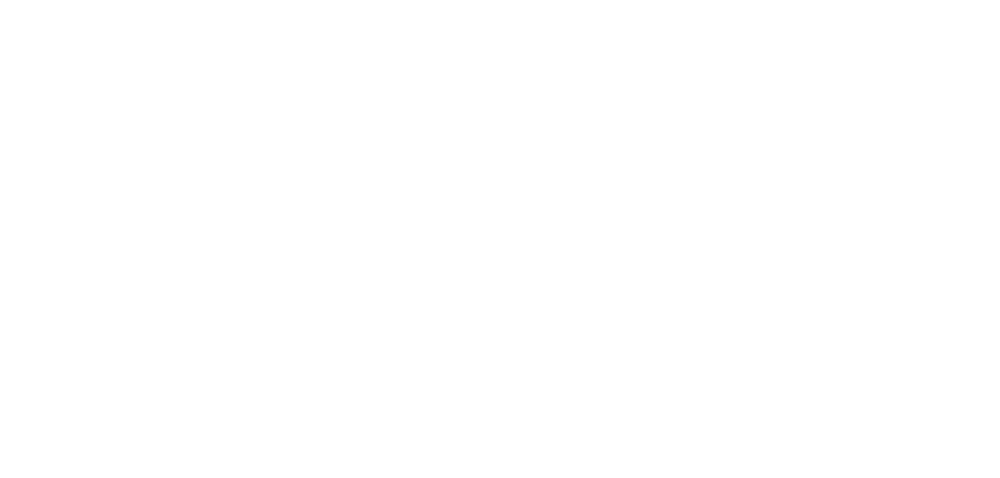

roi1_dff.png


<IPython.core.display.Javascript object>


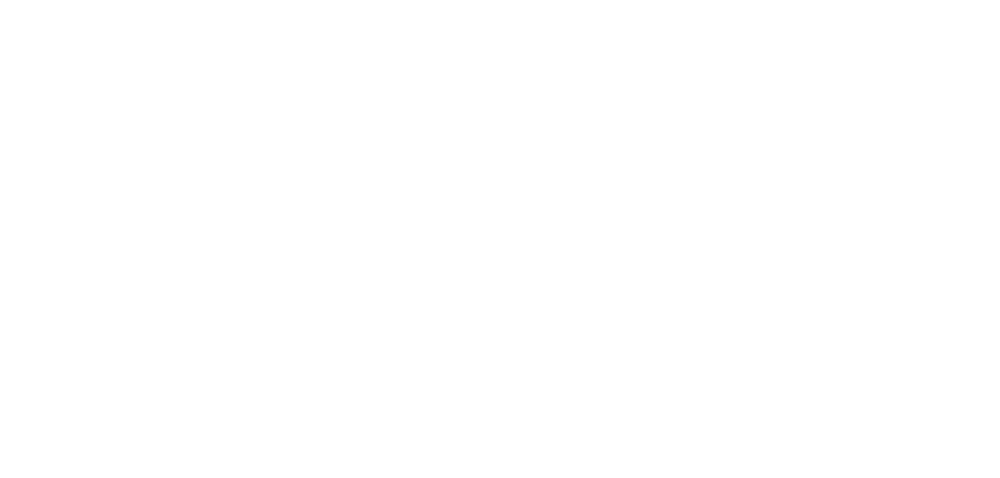

roi2_dff.png


<IPython.core.display.Javascript object>


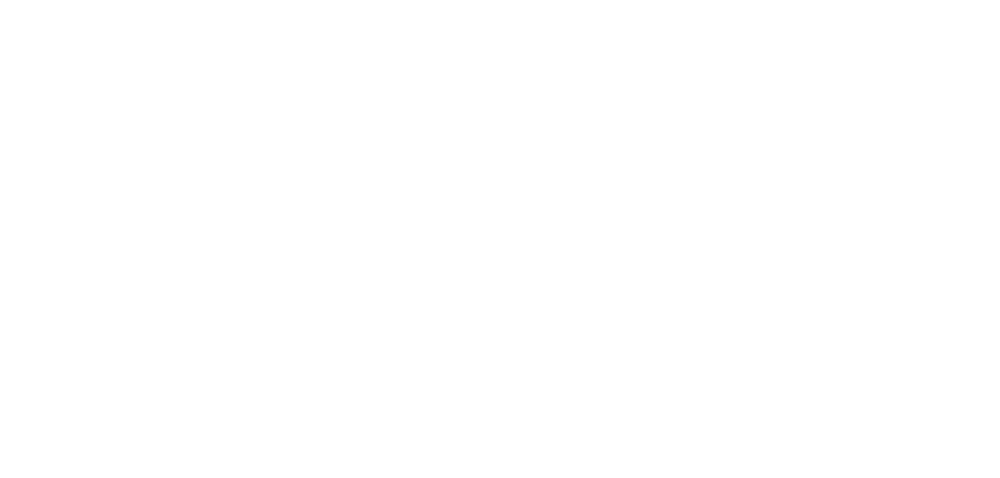

roi3_dff.png


<IPython.core.display.Javascript object>


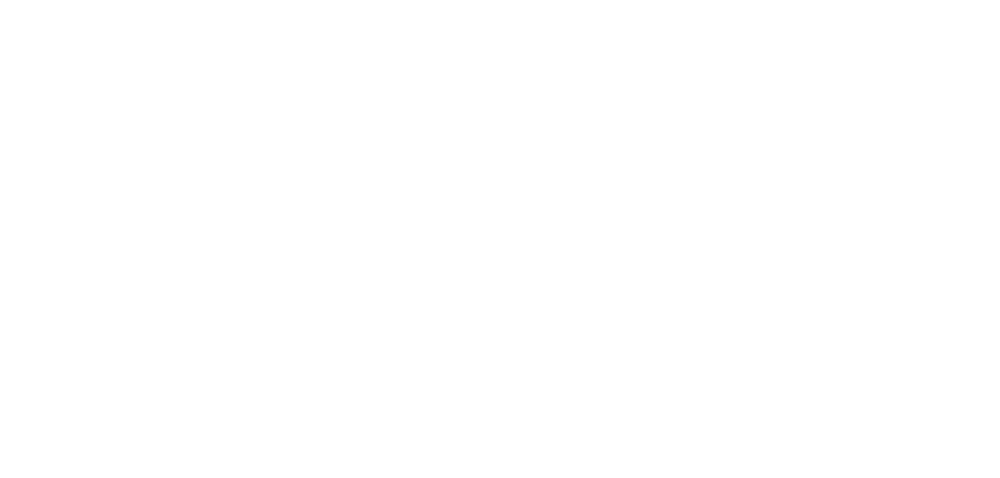

roi4_dff.png


<IPython.core.display.Javascript object>


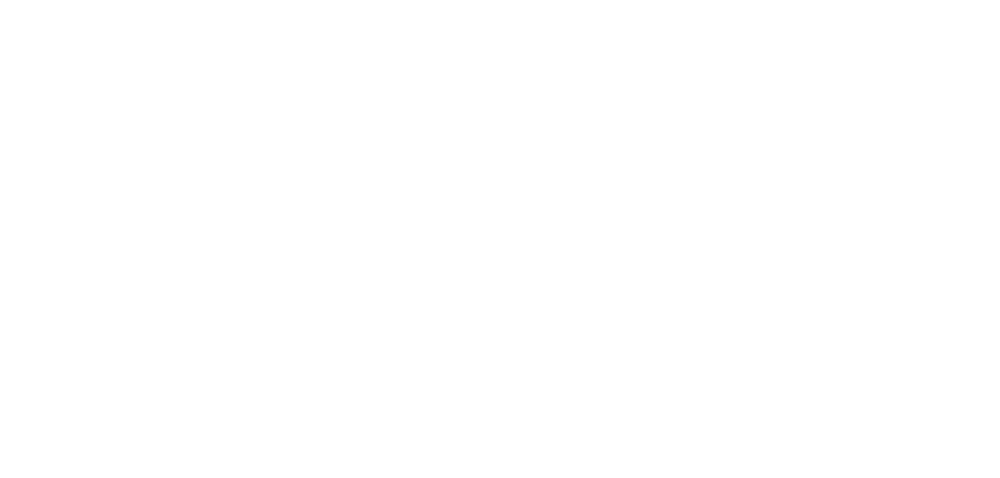

roi5_dff.png


<IPython.core.display.Javascript object>


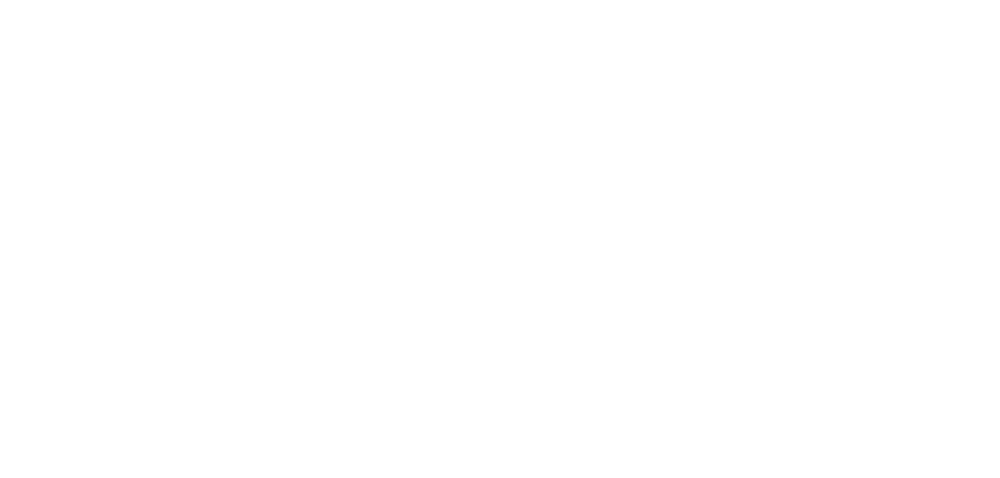

roi6_dff.png


<IPython.core.display.Javascript object>


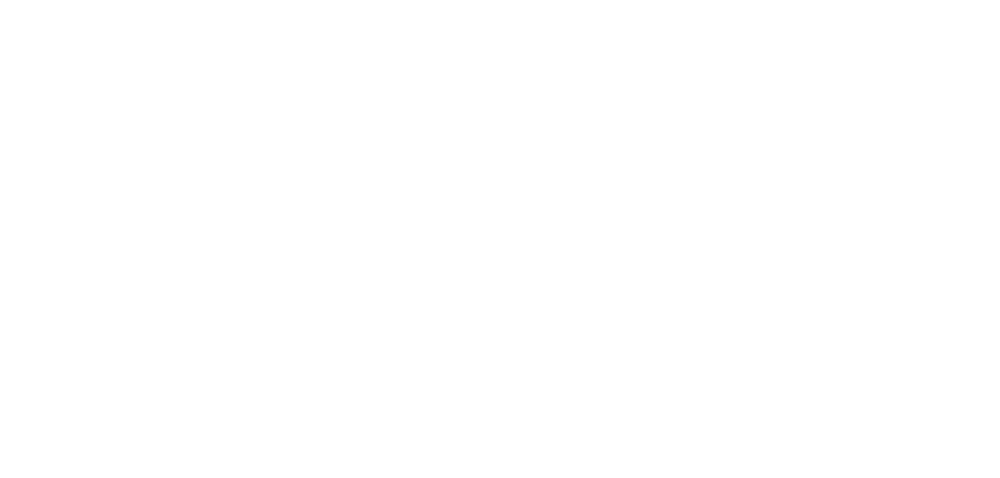

roi7_dff.png


<IPython.core.display.Javascript object>


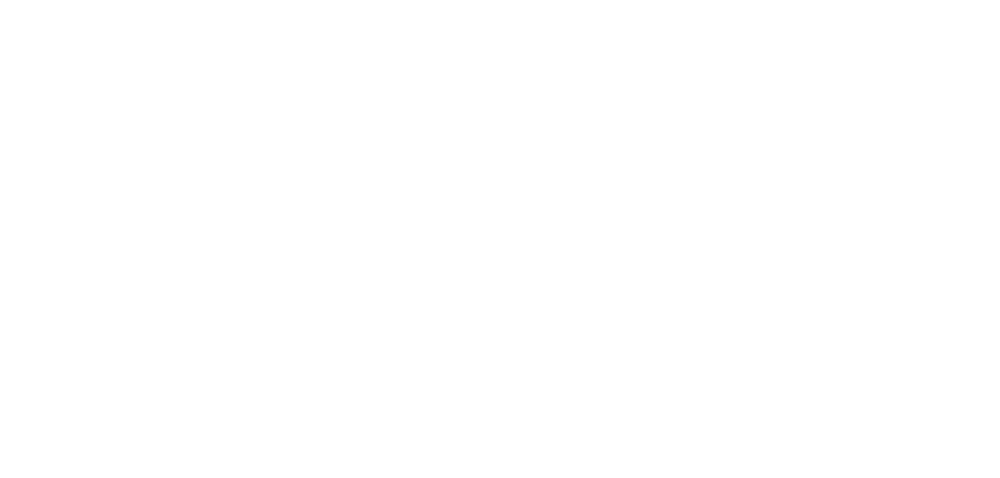

roi8_dff.png


<IPython.core.display.Javascript object>


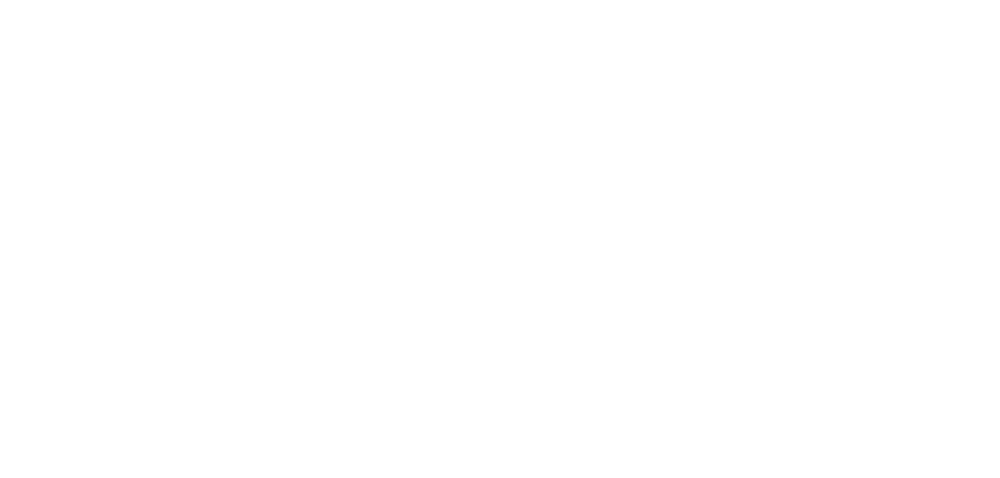

roi9_dff.png


<IPython.core.display.Javascript object>


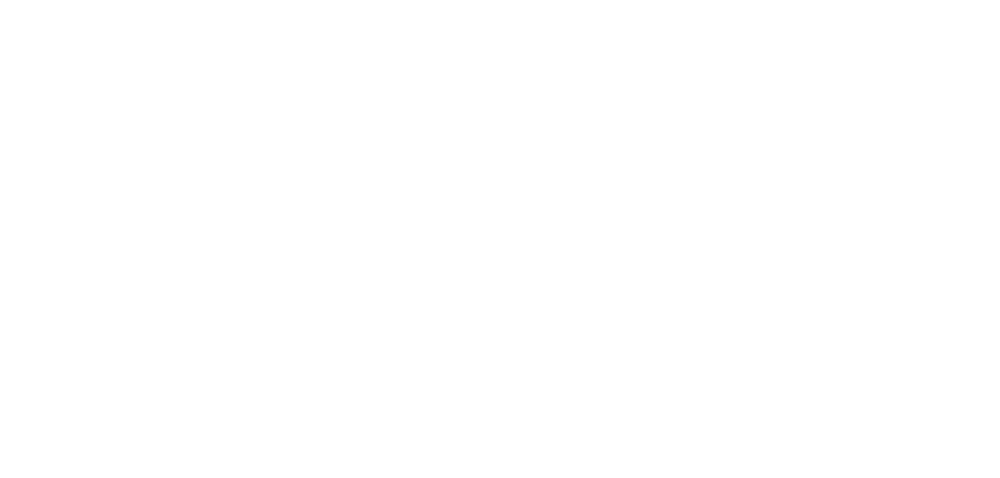

roi10_dff.png


<IPython.core.display.Javascript object>


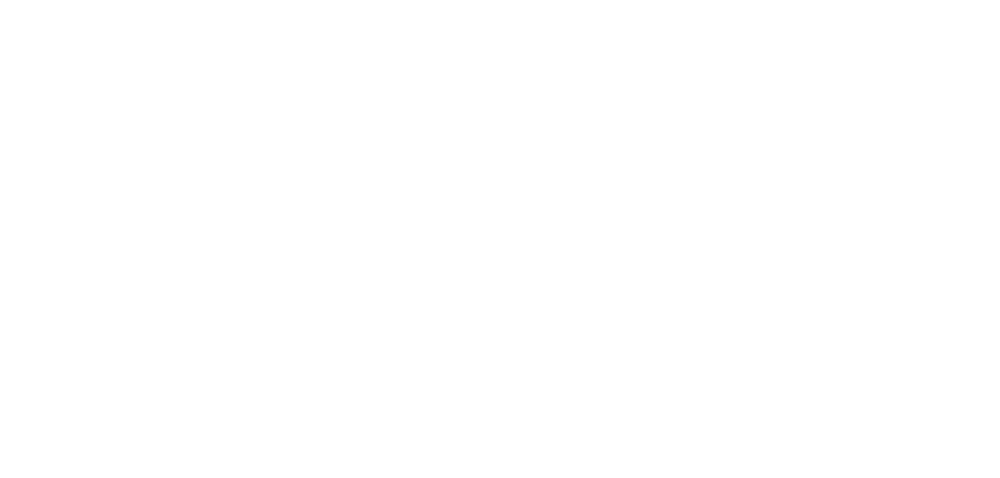

roi11_dff.png


<IPython.core.display.Javascript object>


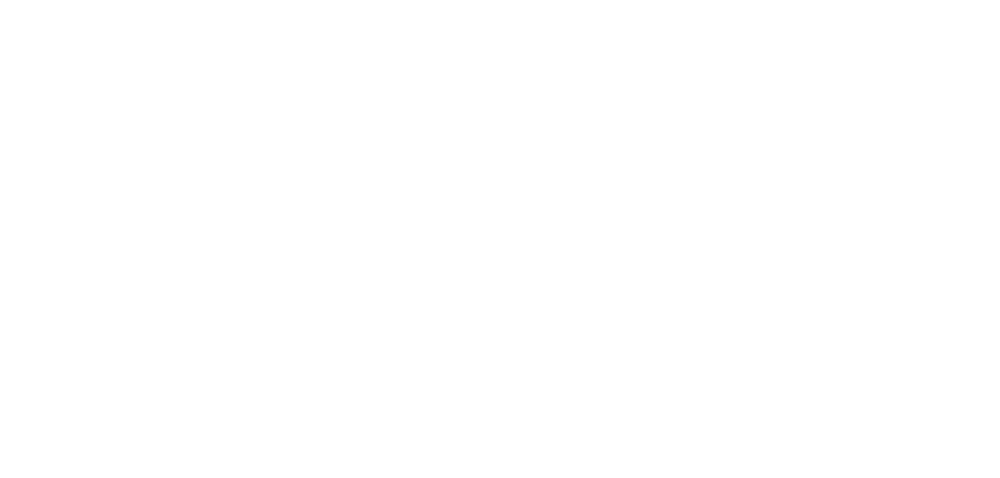

roi12_dff.png


<IPython.core.display.Javascript object>


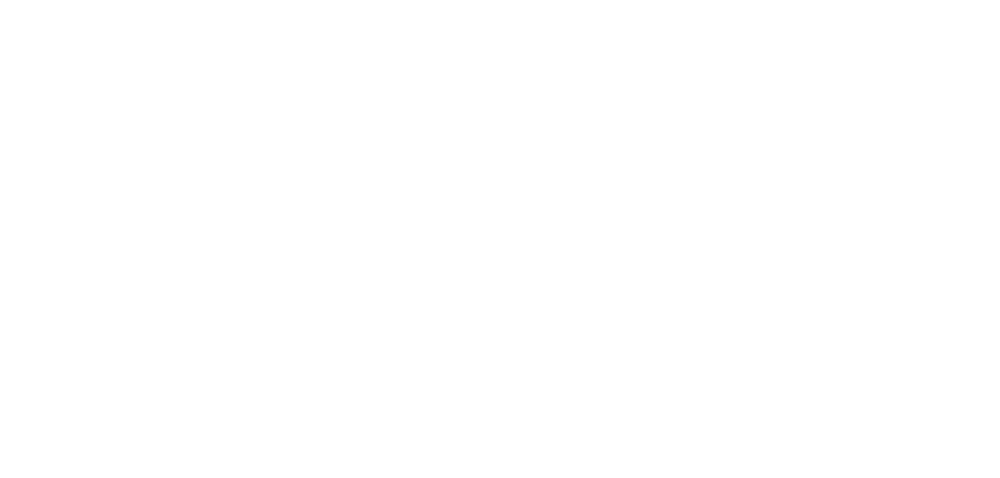

roi13_dff.png


<IPython.core.display.Javascript object>


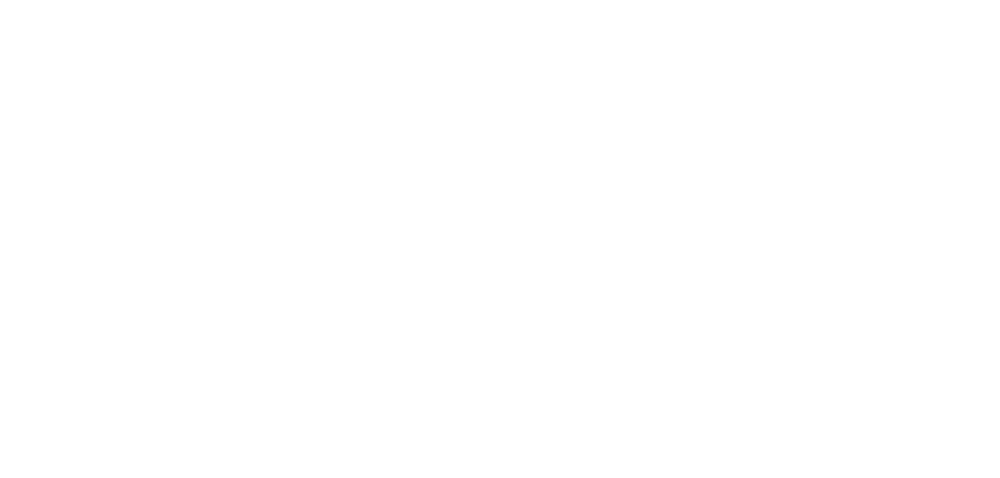

roi14_dff.png


<IPython.core.display.Javascript object>


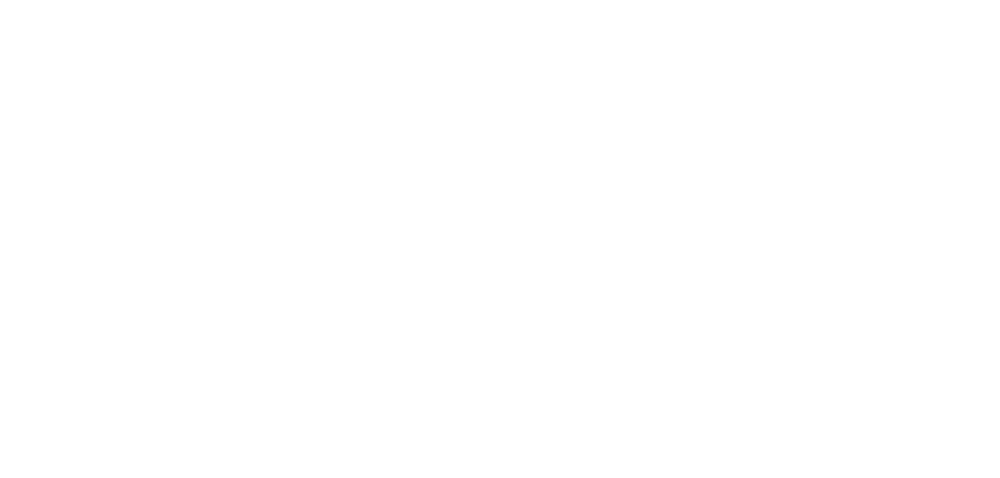

roi15_dff.png


<IPython.core.display.Javascript object>


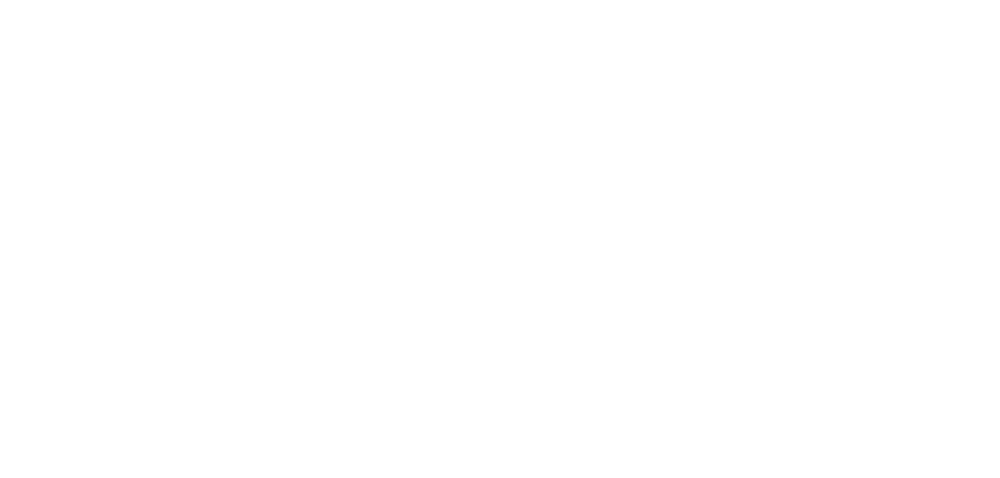

roi16_dff.png


<IPython.core.display.Javascript object>


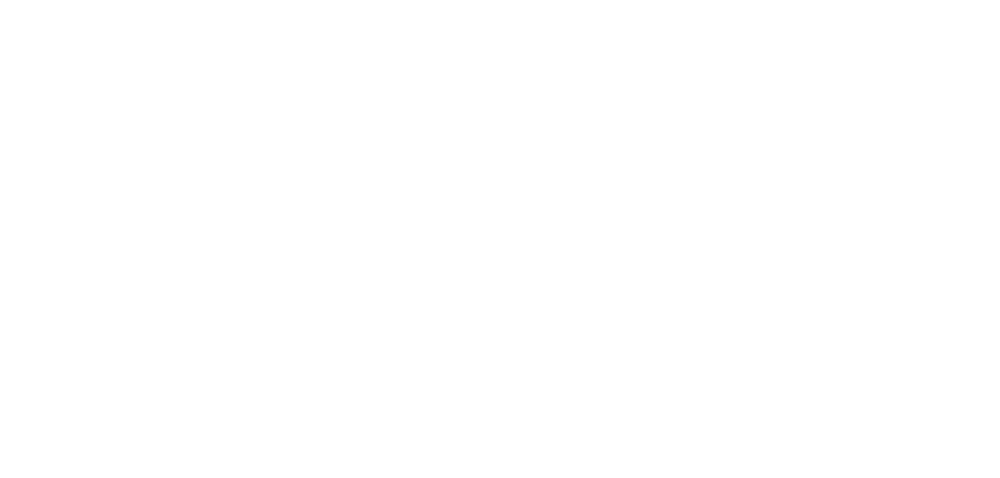

roi17_dff.png


<IPython.core.display.Javascript object>


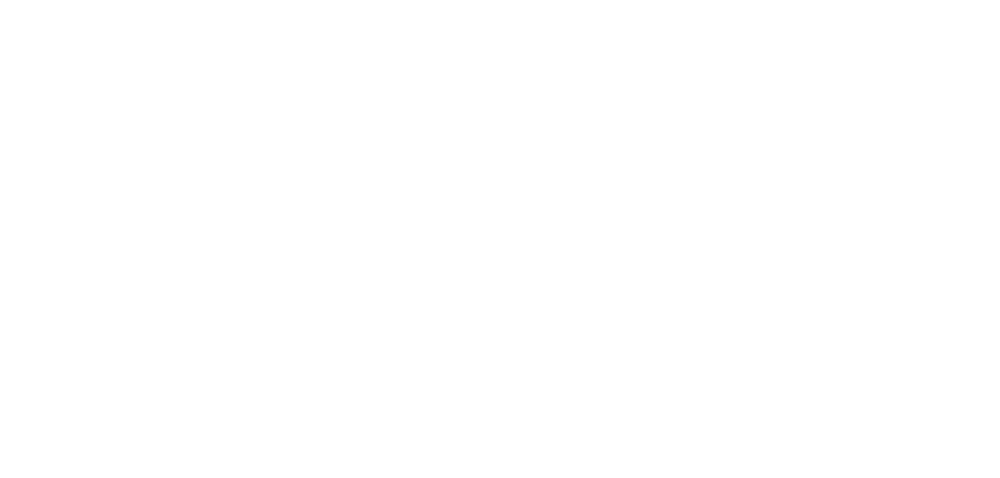

roi18_dff.png


<IPython.core.display.Javascript object>


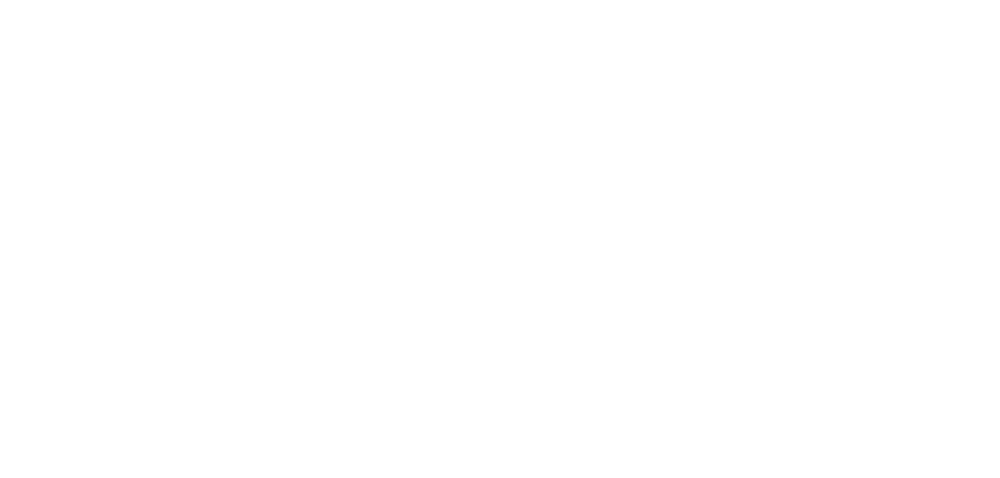

roi19_dff.png


<IPython.core.display.Javascript object>


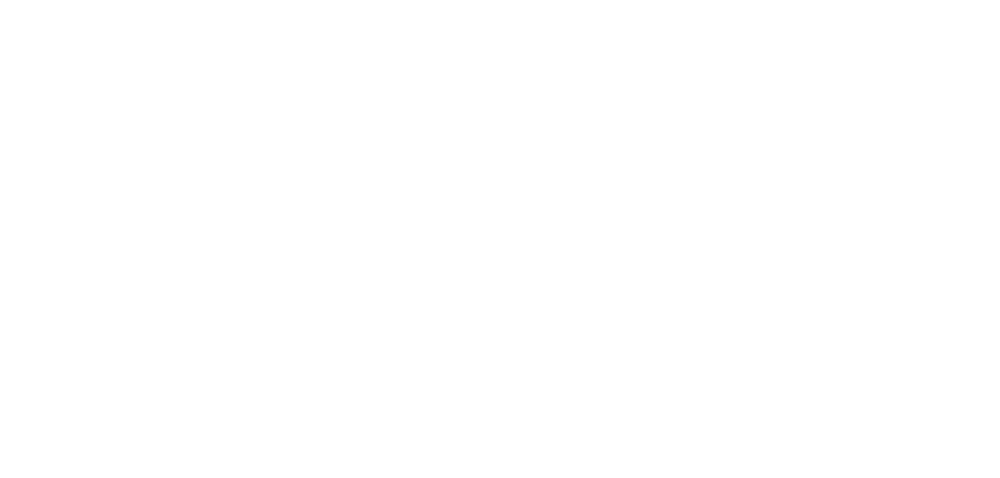

roi20_dff.png


<IPython.core.display.Javascript object>


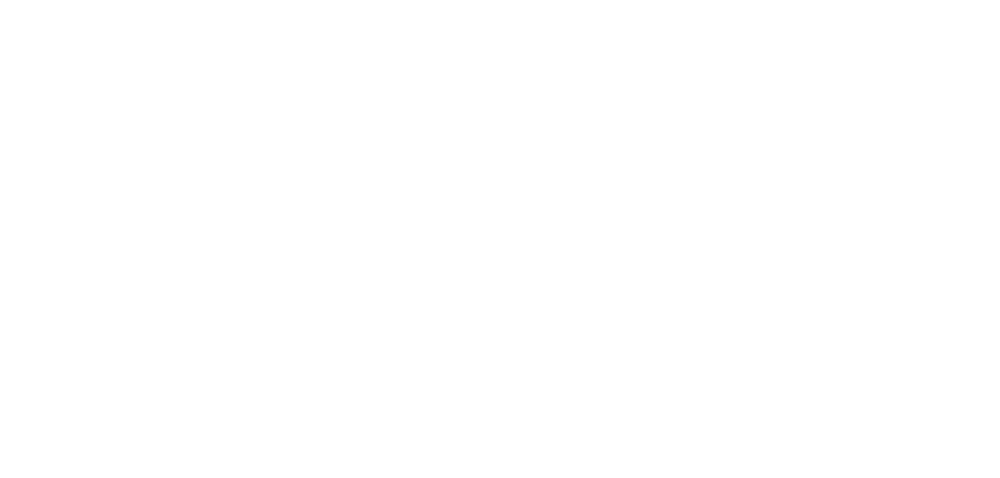

roi21_dff.png


<IPython.core.display.Javascript object>


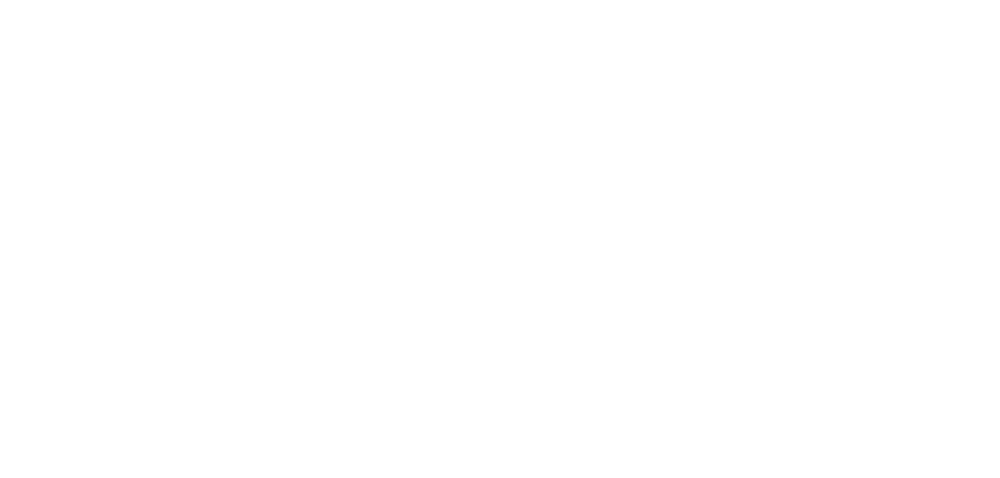

roi22_dff.png


<IPython.core.display.Javascript object>


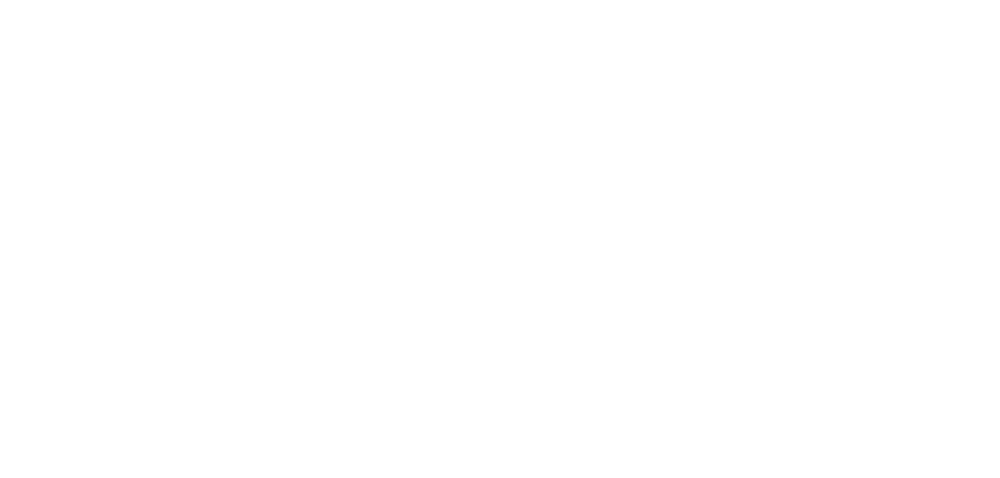

roi23_dff.png


<IPython.core.display.Javascript object>


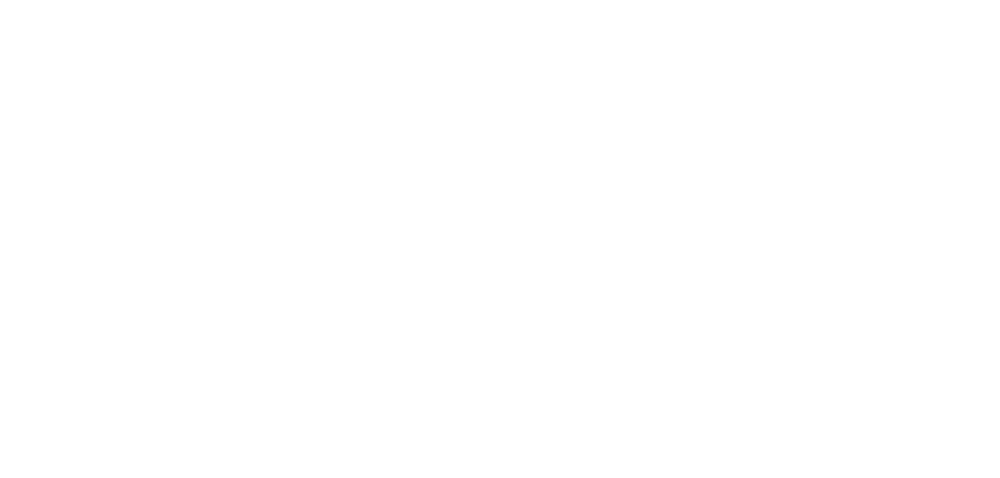

roi24_dff.png


<IPython.core.display.Javascript object>


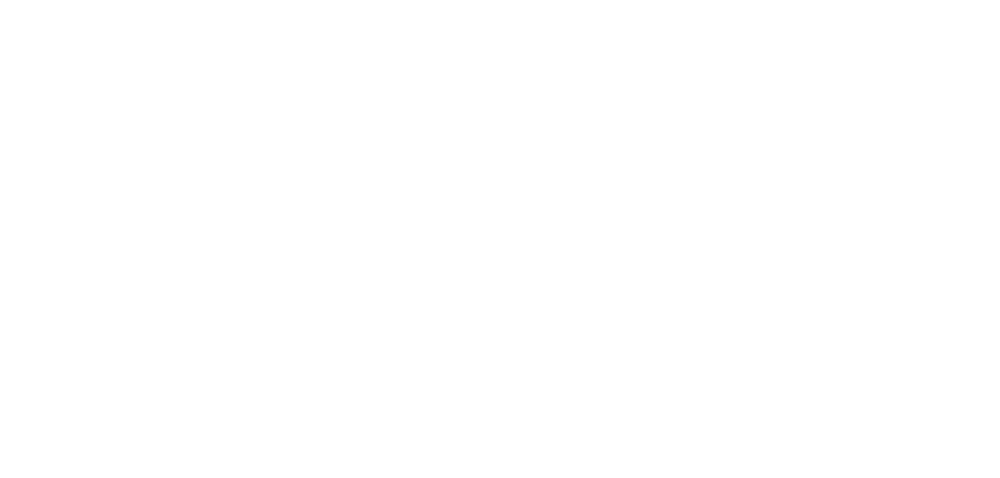

roi25_dff.png


<IPython.core.display.Javascript object>


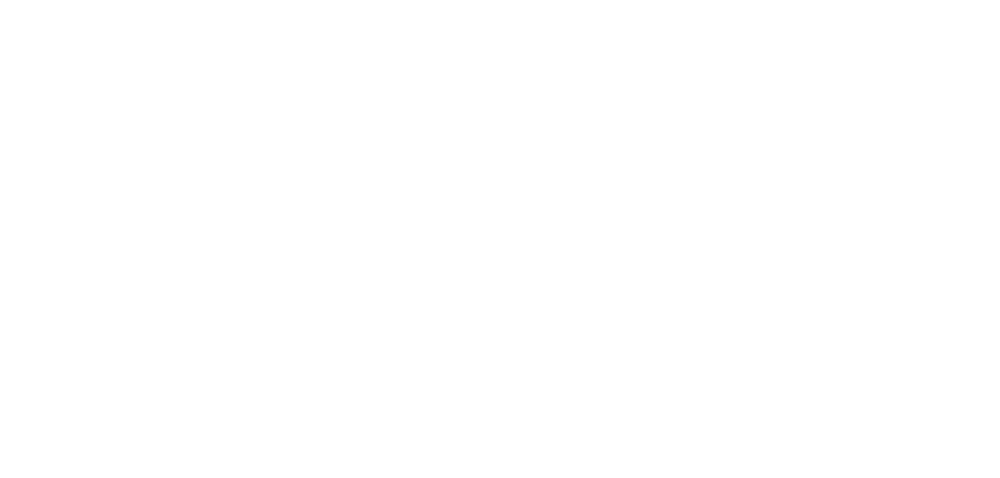

roi26_dff.png


<IPython.core.display.Javascript object>


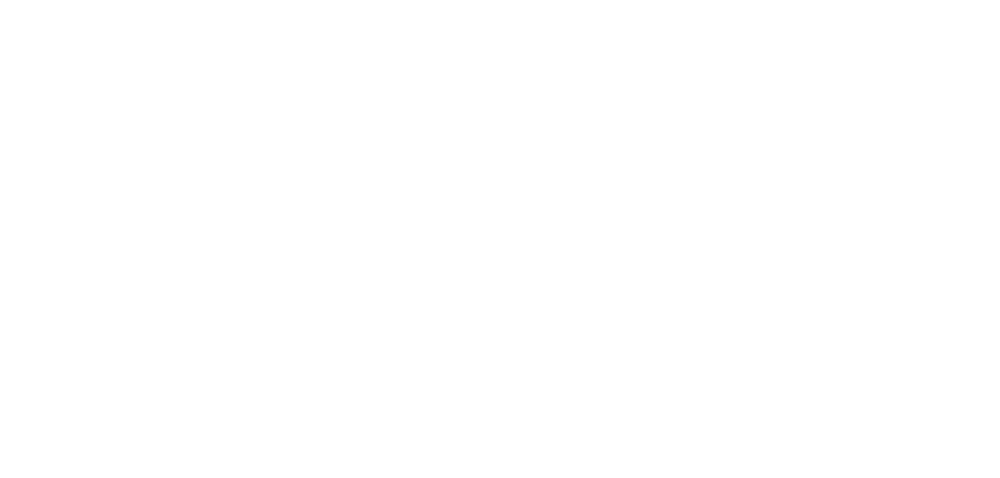

roi27_dff.png


<IPython.core.display.Javascript object>


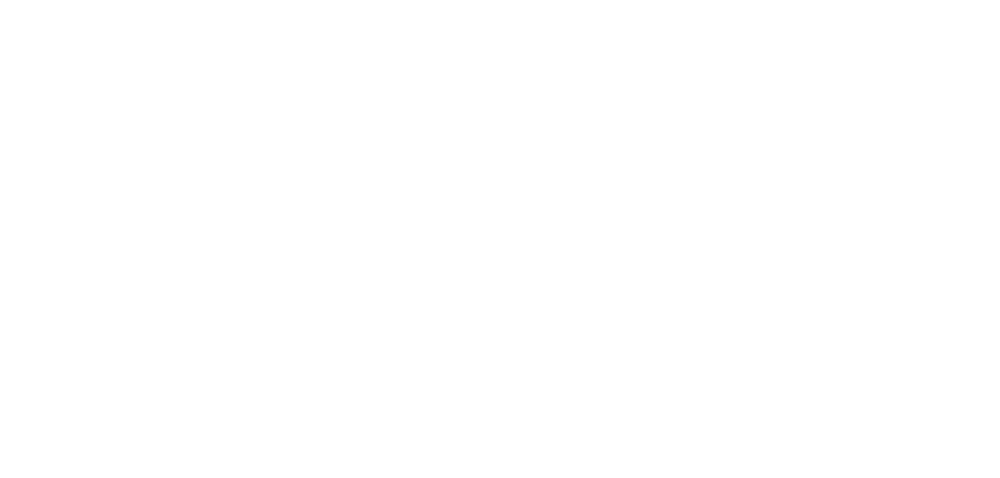

roi28_dff.png


<IPython.core.display.Javascript object>


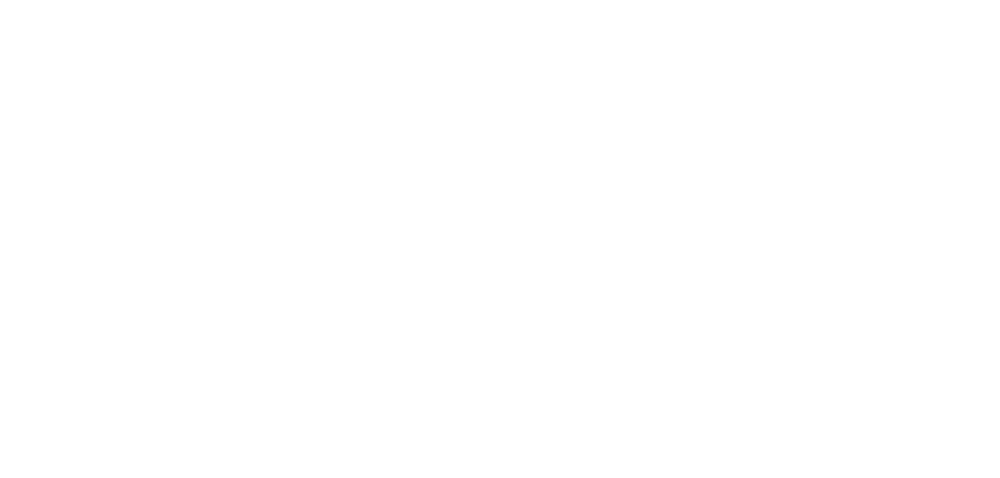

roi29_dff.png


<IPython.core.display.Javascript object>


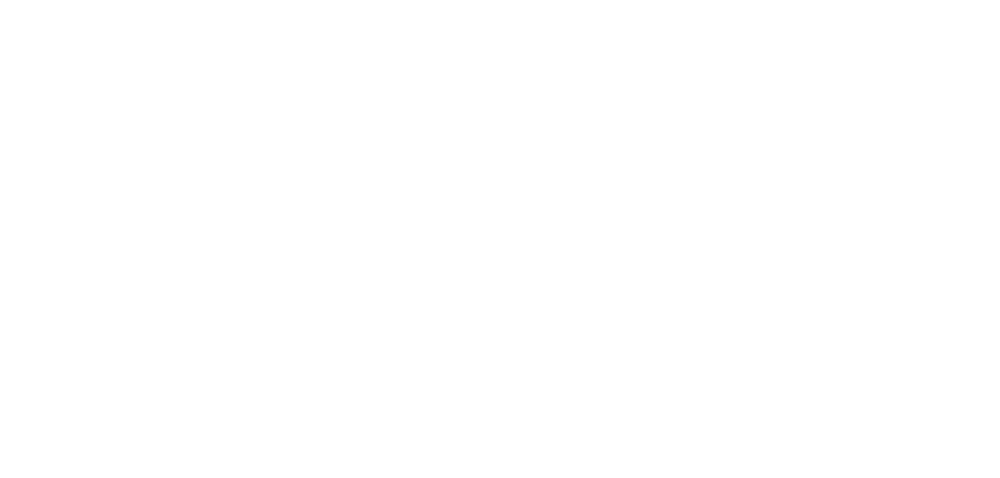

roi30_dff.png


<IPython.core.display.Javascript object>


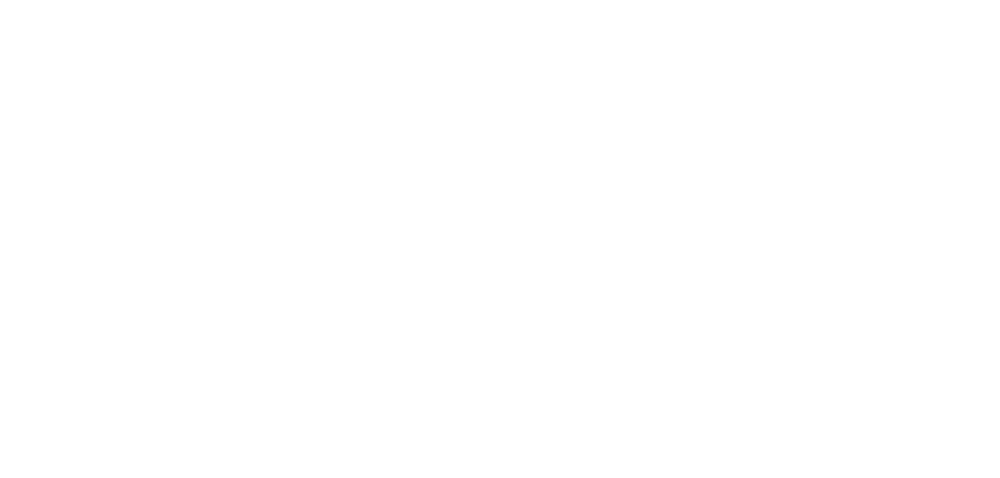

roi31_dff.png


<IPython.core.display.Javascript object>


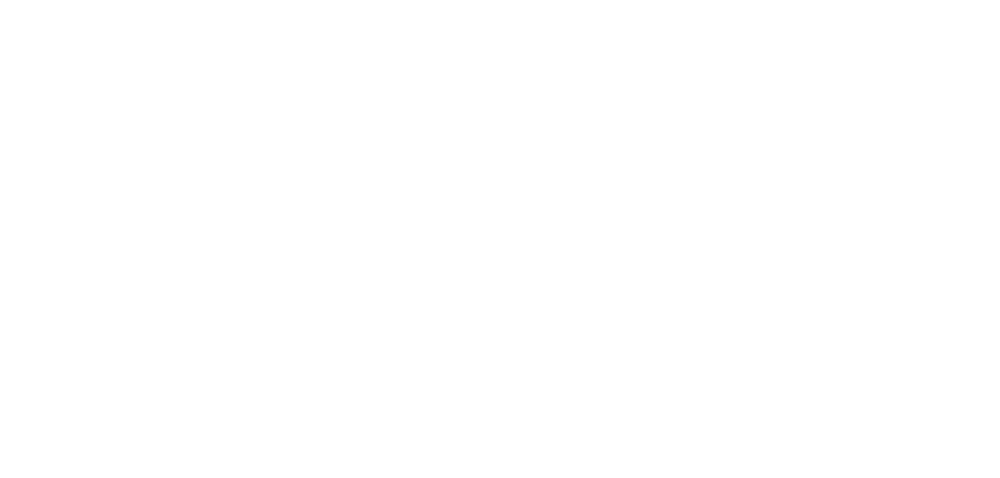

roi32_dff.png


<IPython.core.display.Javascript object>


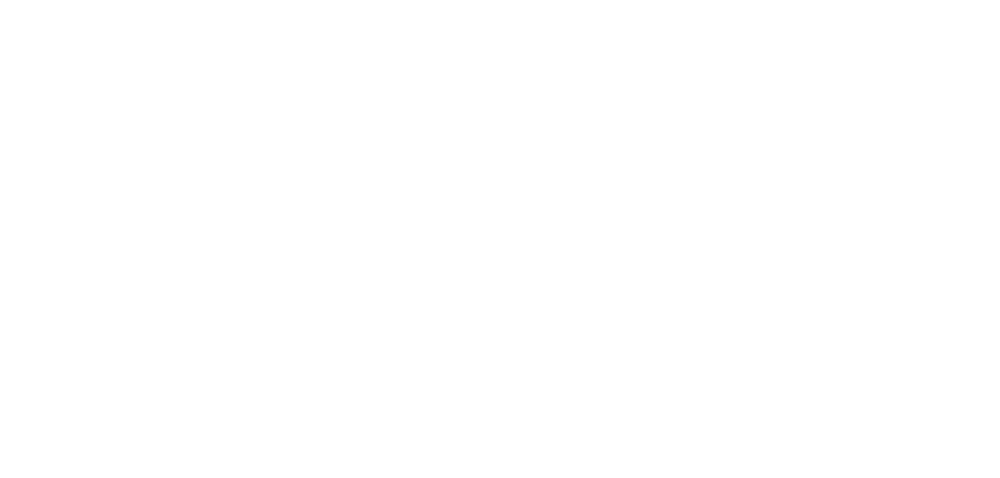

roi33_dff.png


<IPython.core.display.Javascript object>


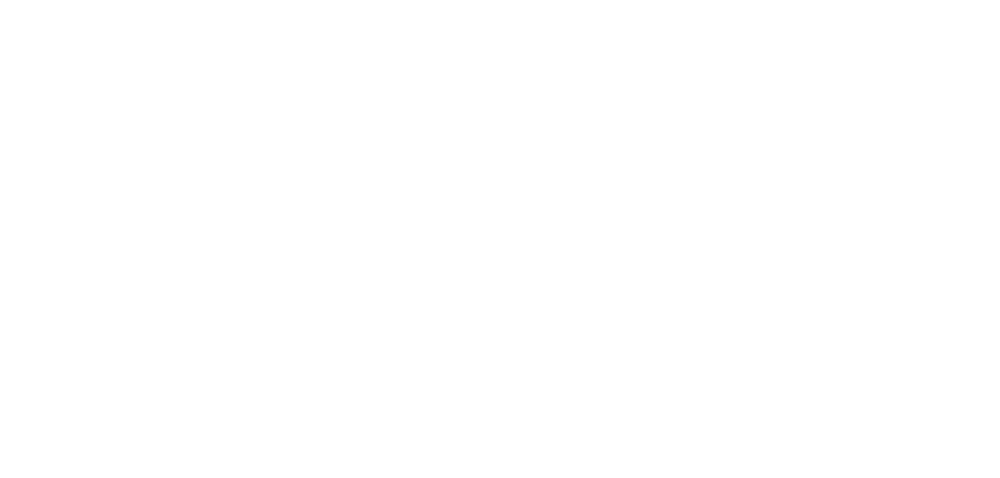

roi34_dff.png


<IPython.core.display.Javascript object>


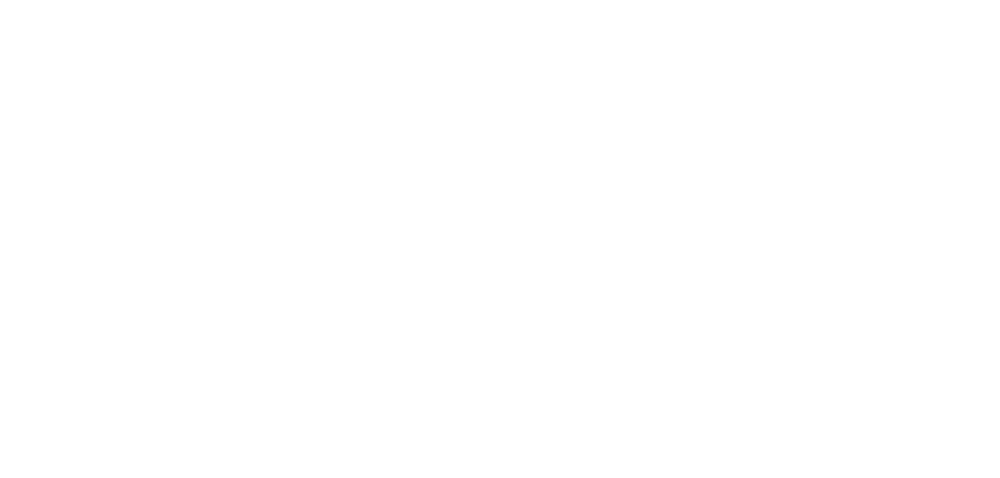

roi35_dff.png


<IPython.core.display.Javascript object>


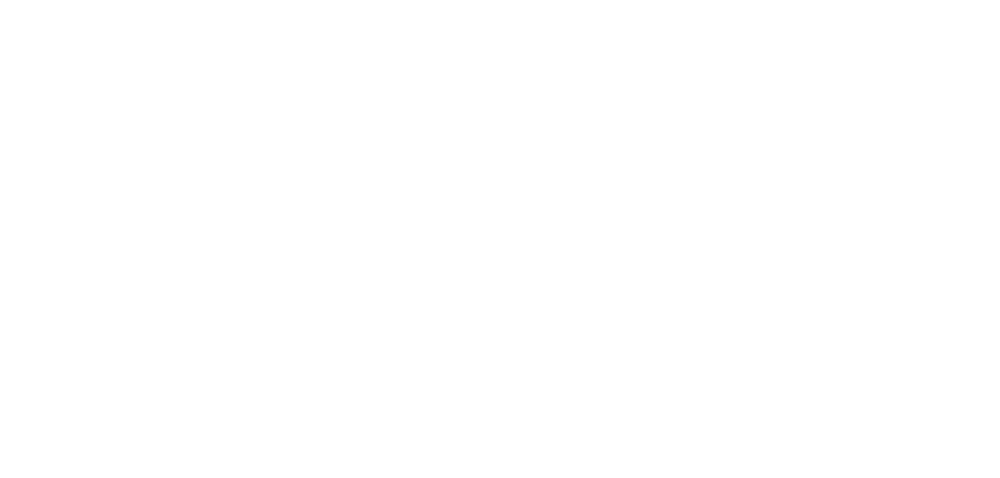

roi36_dff.png


<IPython.core.display.Javascript object>


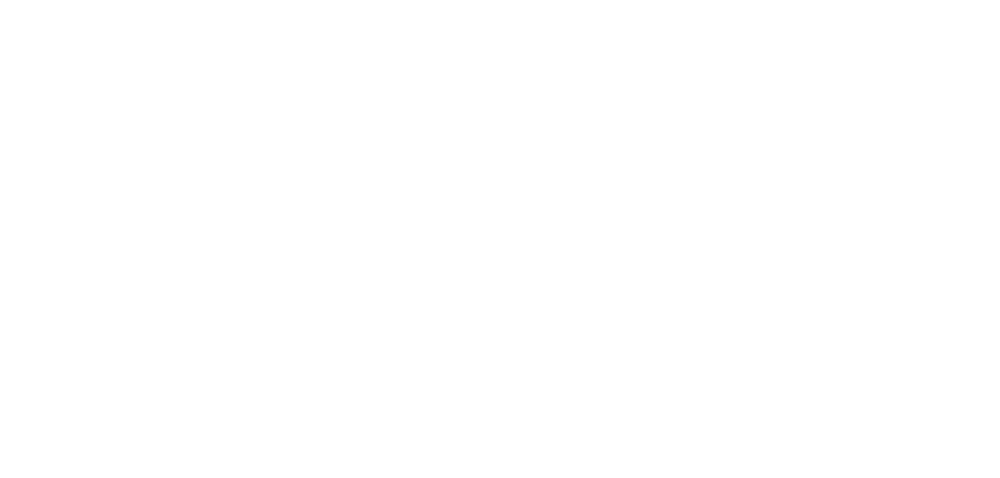

roi37_dff.png


<IPython.core.display.Javascript object>


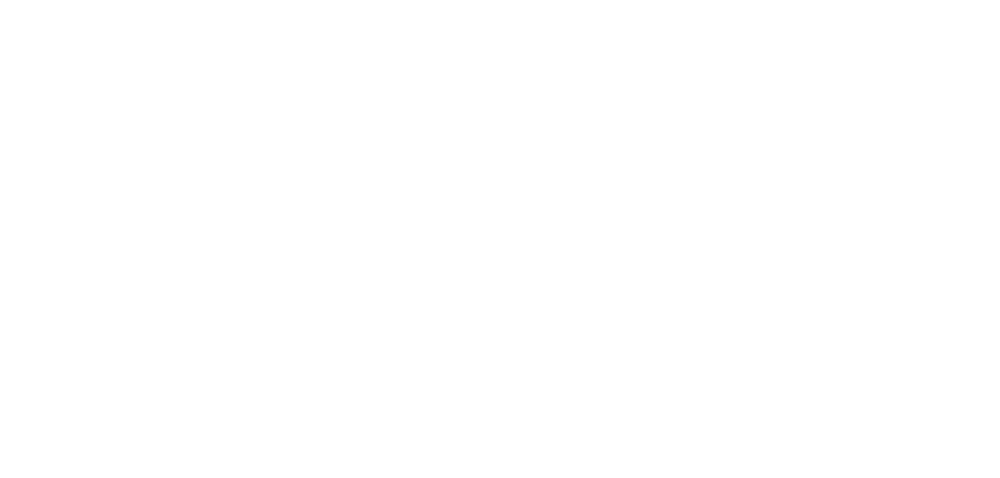

roi38_dff.png


<IPython.core.display.Javascript object>


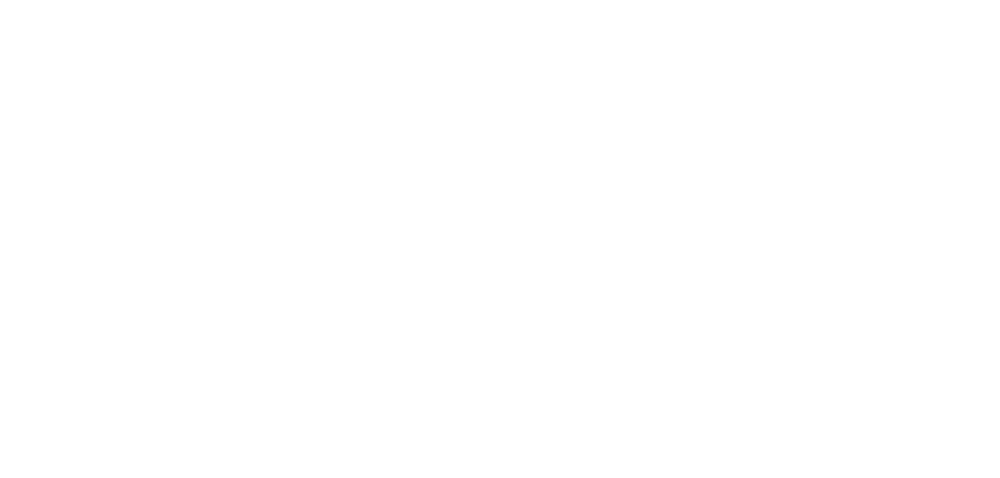

roi39_dff.png


<IPython.core.display.Javascript object>


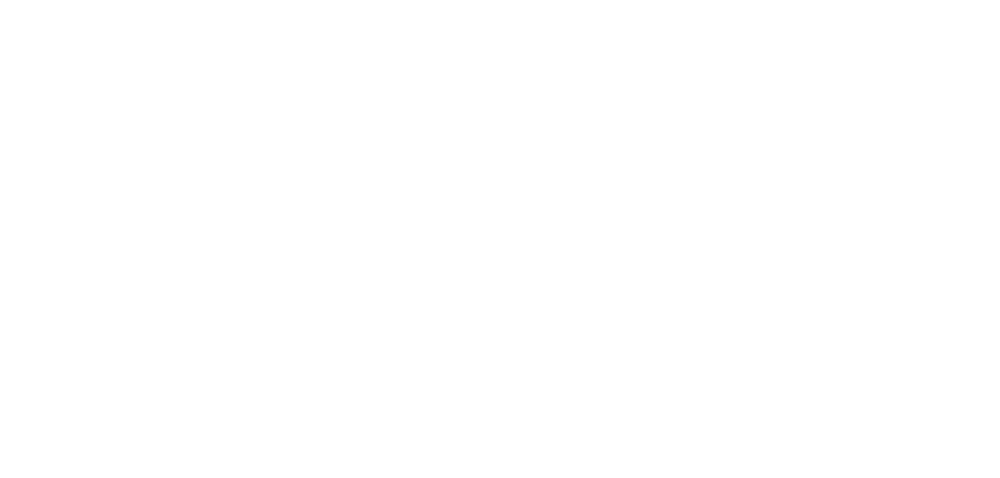

roi40_dff.png


<IPython.core.display.Javascript object>


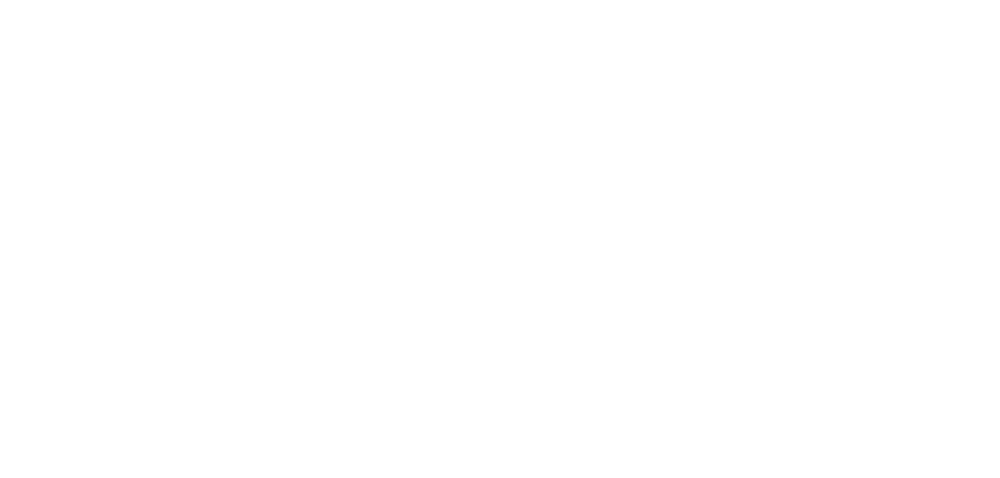

roi41_dff.png


<IPython.core.display.Javascript object>


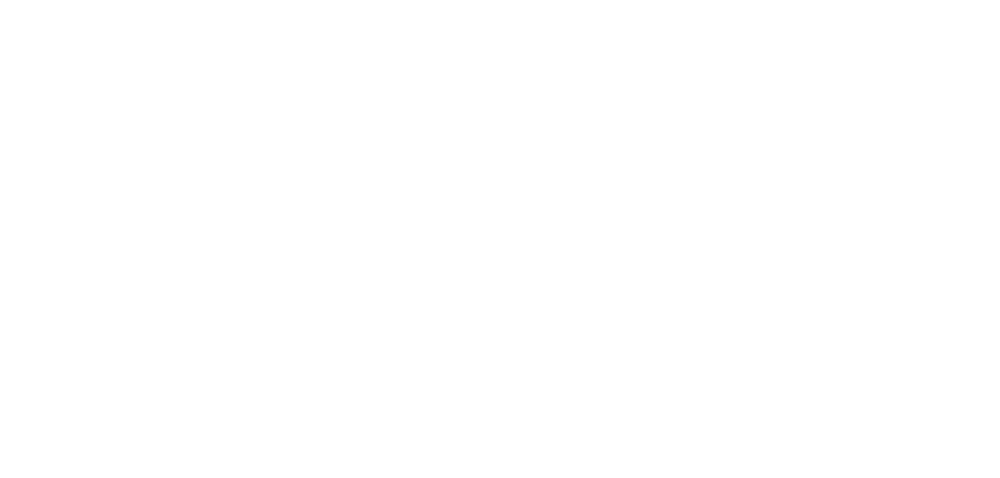

roi42_dff.png


<IPython.core.display.Javascript object>


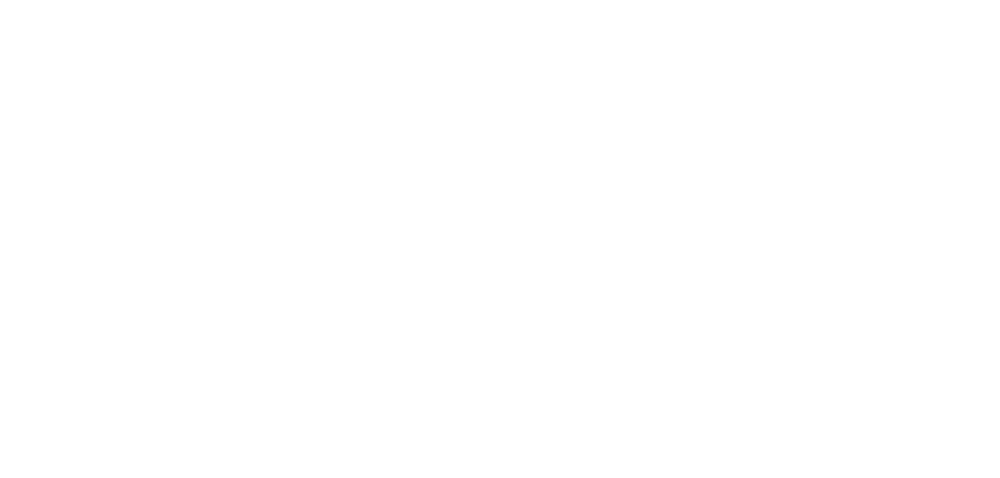

roi43_dff.png


<IPython.core.display.Javascript object>


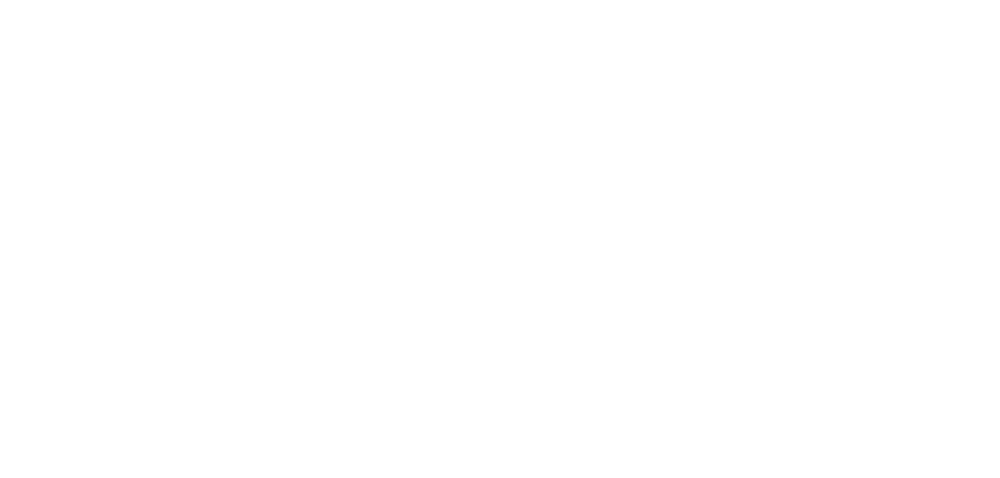

roi44_dff.png


<IPython.core.display.Javascript object>


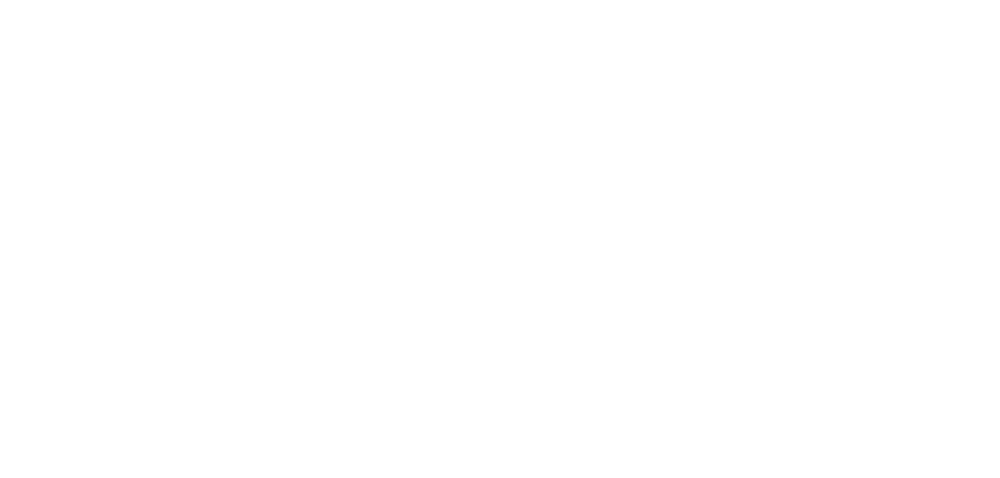

roi45_dff.png


<IPython.core.display.Javascript object>


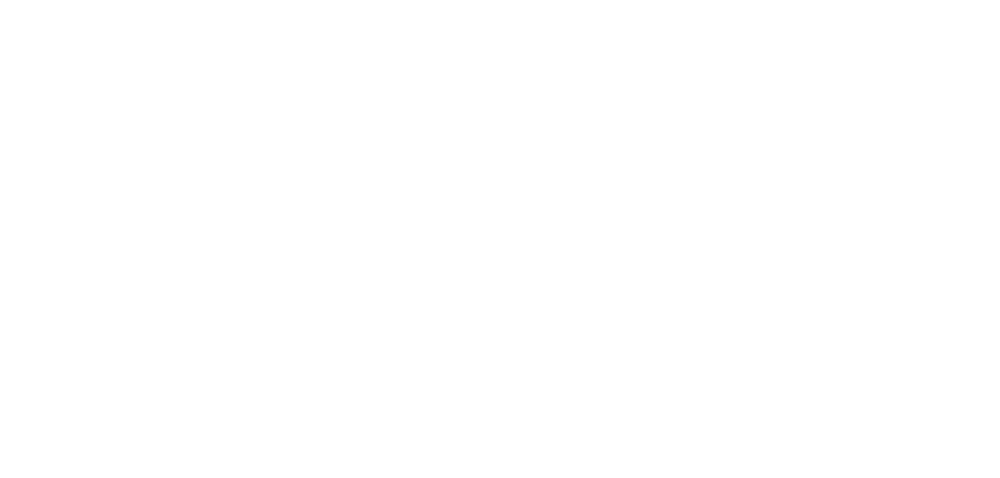

roi46_dff.png


<IPython.core.display.Javascript object>


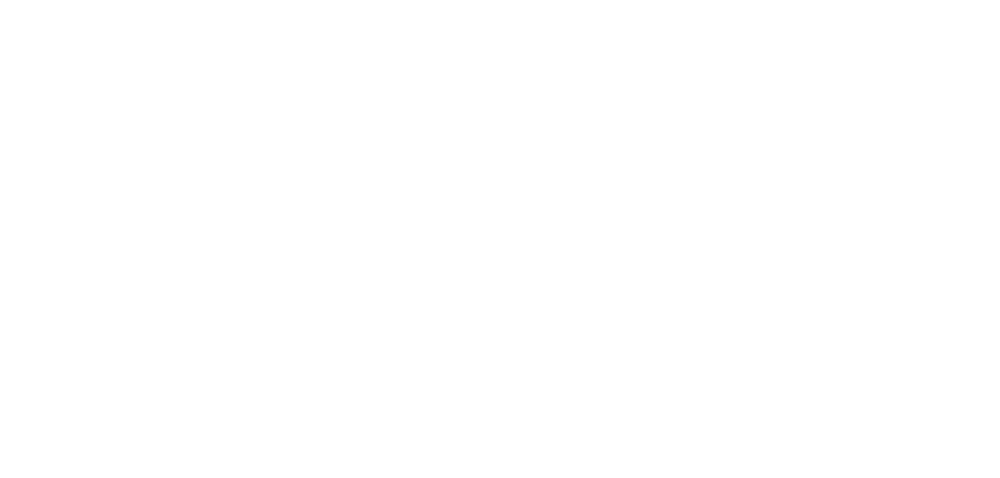

roi47_dff.png


<IPython.core.display.Javascript object>


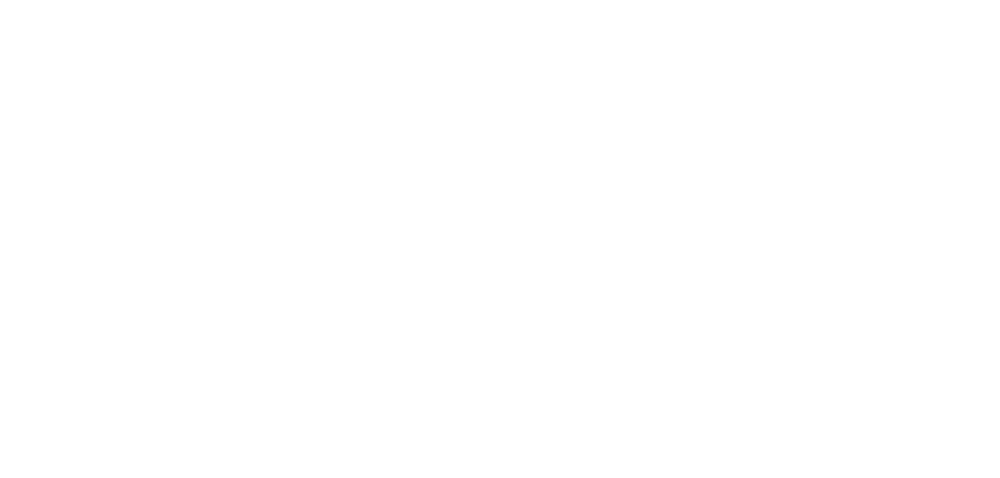

roi48_dff.png


<IPython.core.display.Javascript object>


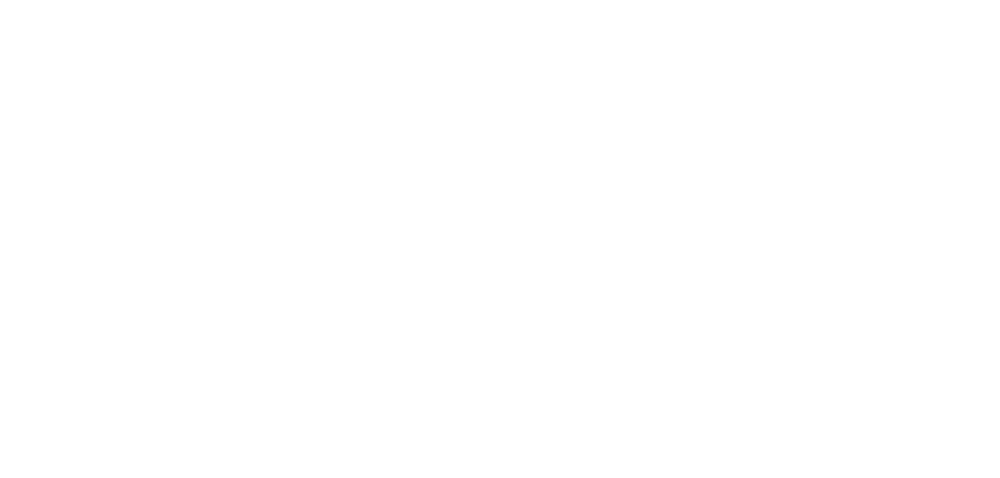

roi49_dff.png


<IPython.core.display.Javascript object>


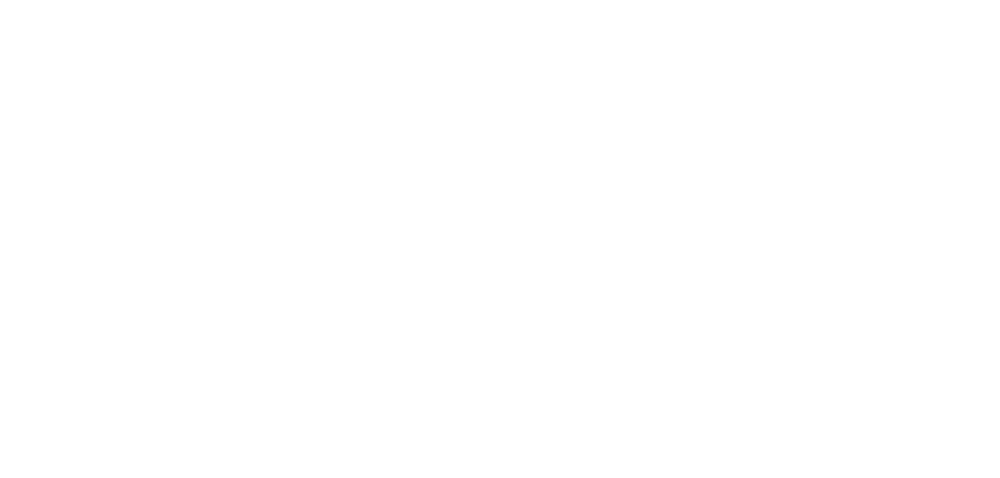

roi50_dff.png


<IPython.core.display.Javascript object>


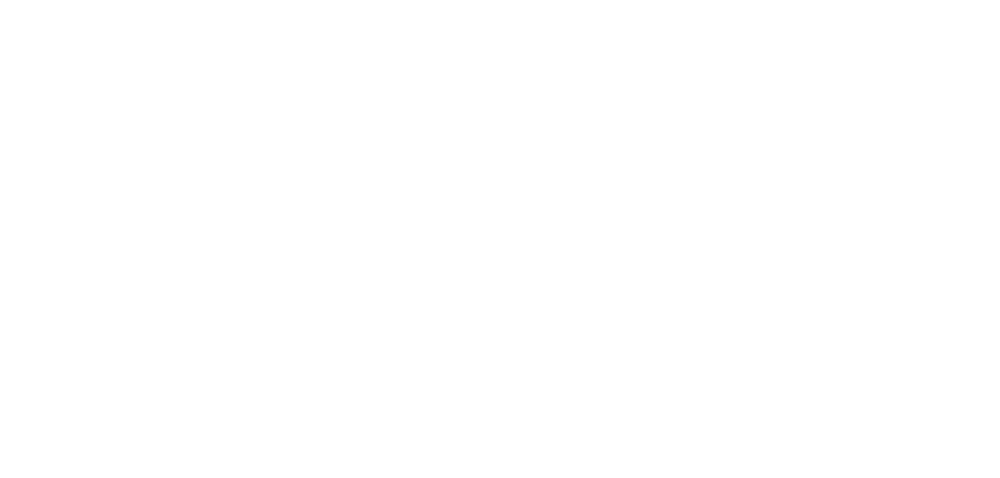

roi51_dff.png


<IPython.core.display.Javascript object>


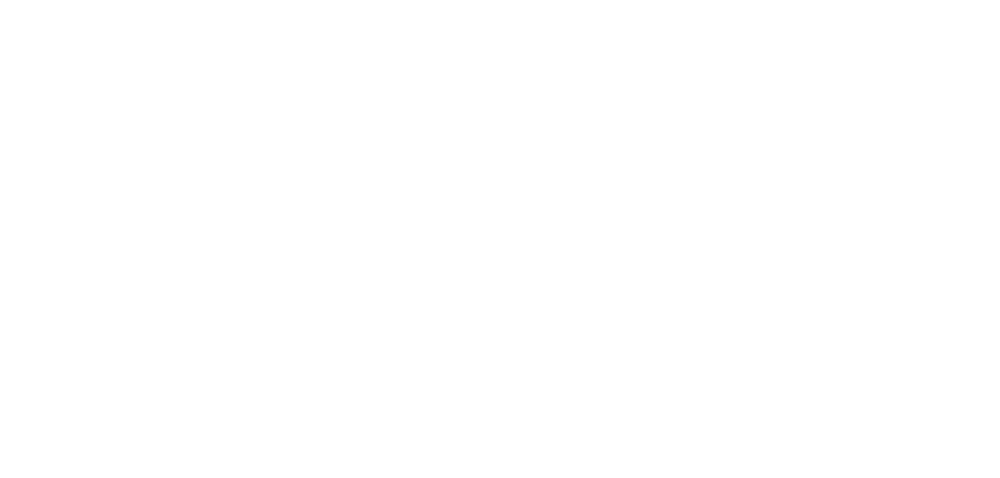

roi52_dff.png


<IPython.core.display.Javascript object>


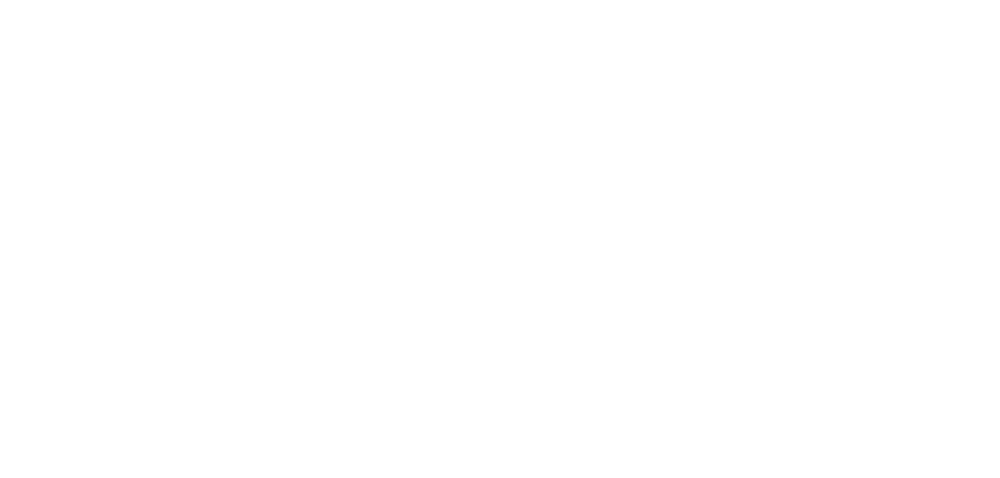

roi53_dff.png


<IPython.core.display.Javascript object>


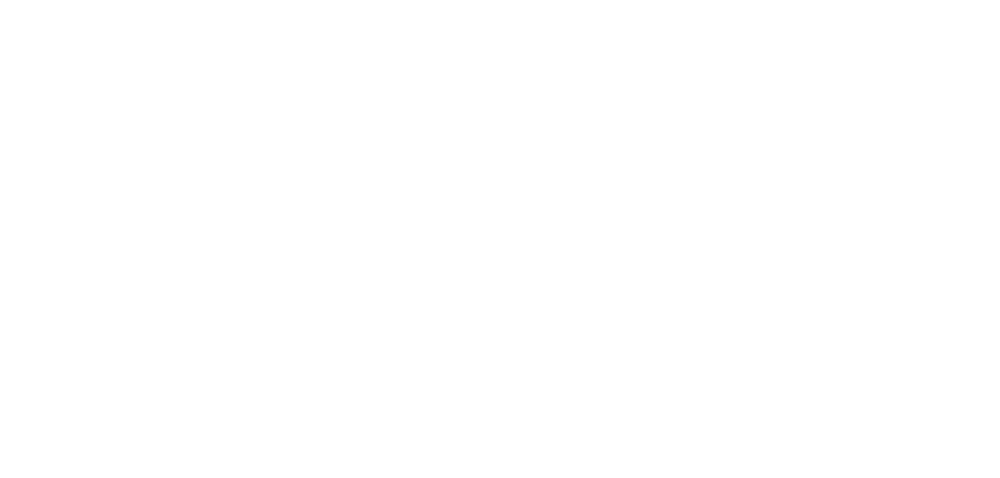

roi54_dff.png


<IPython.core.display.Javascript object>


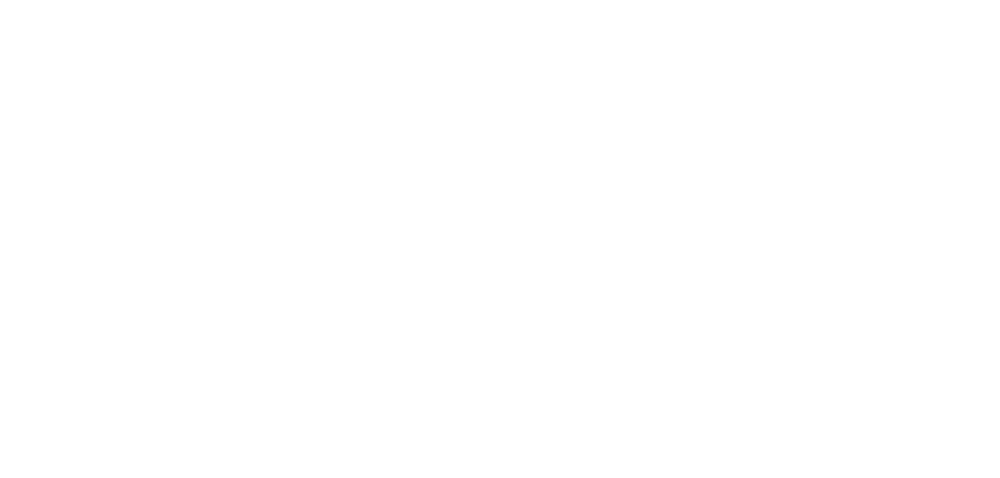

roi55_dff.png


<IPython.core.display.Javascript object>


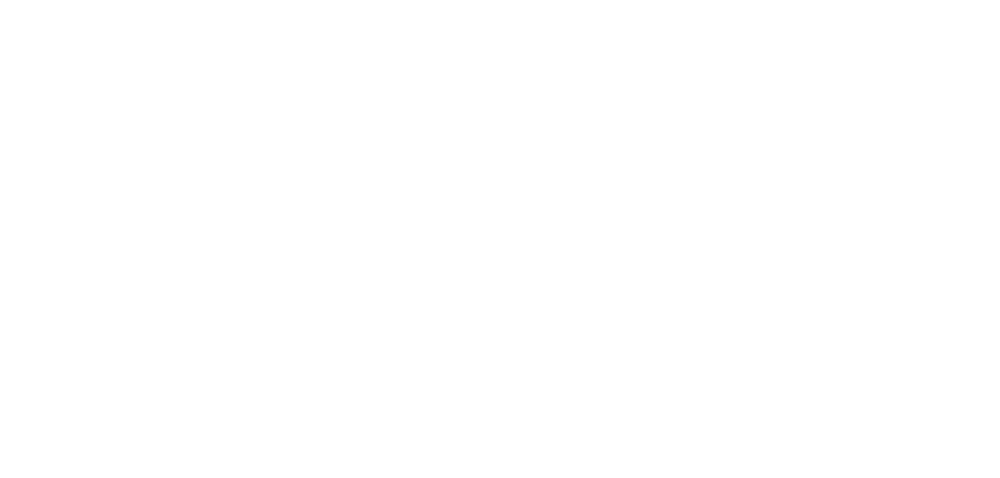

roi56_dff.png


<IPython.core.display.Javascript object>


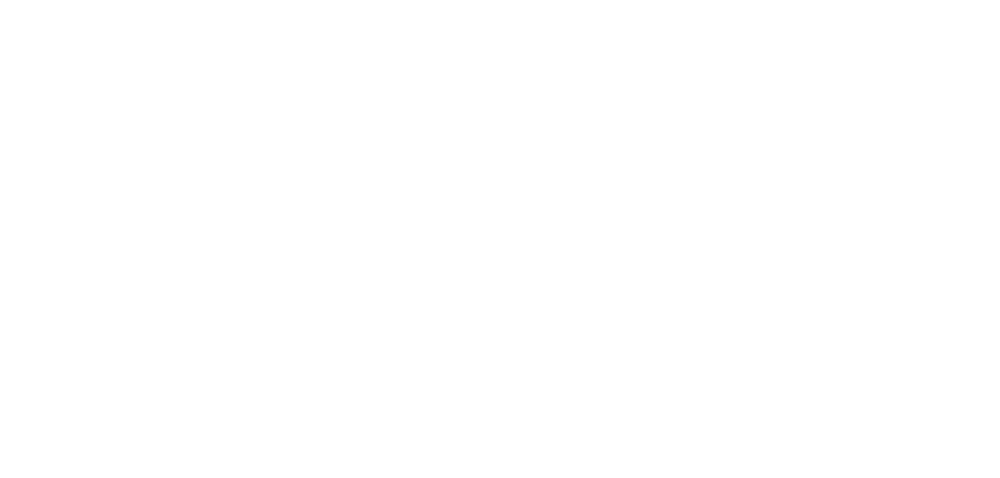

roi57_dff.png


<IPython.core.display.Javascript object>


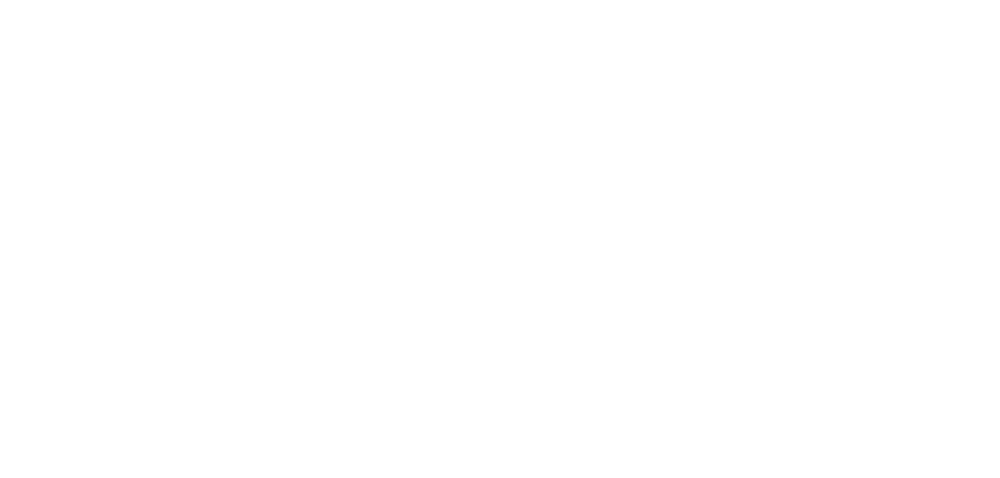

roi58_dff.png


<IPython.core.display.Javascript object>


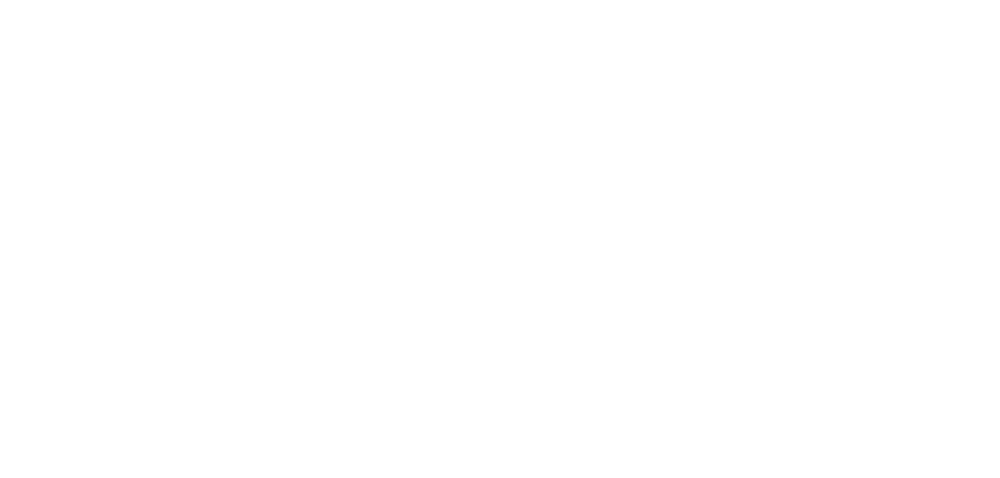

roi59_dff.png


<IPython.core.display.Javascript object>


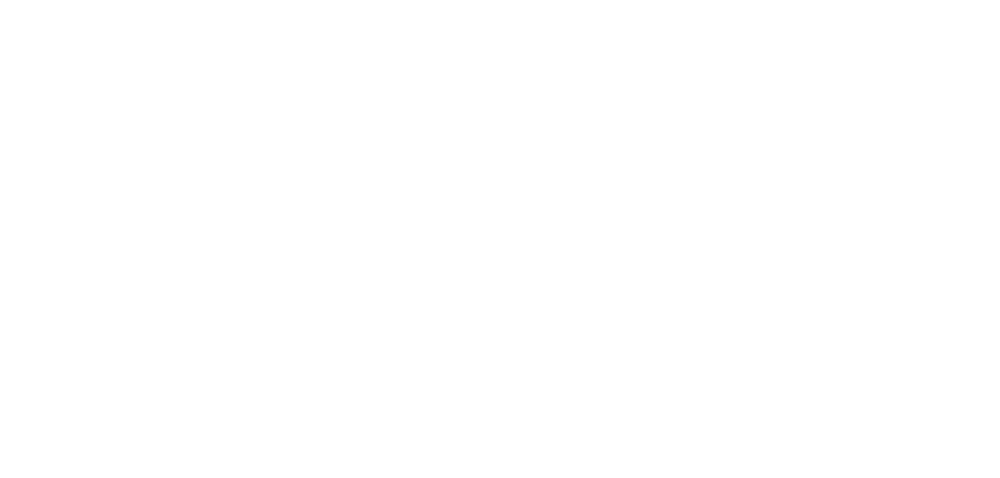

roi60_dff.png


<IPython.core.display.Javascript object>


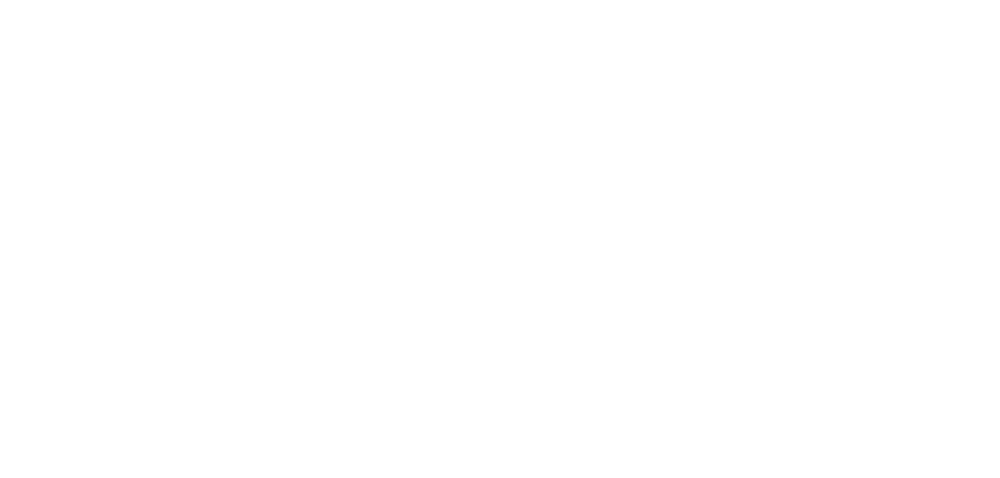

roi61_dff.png


<IPython.core.display.Javascript object>


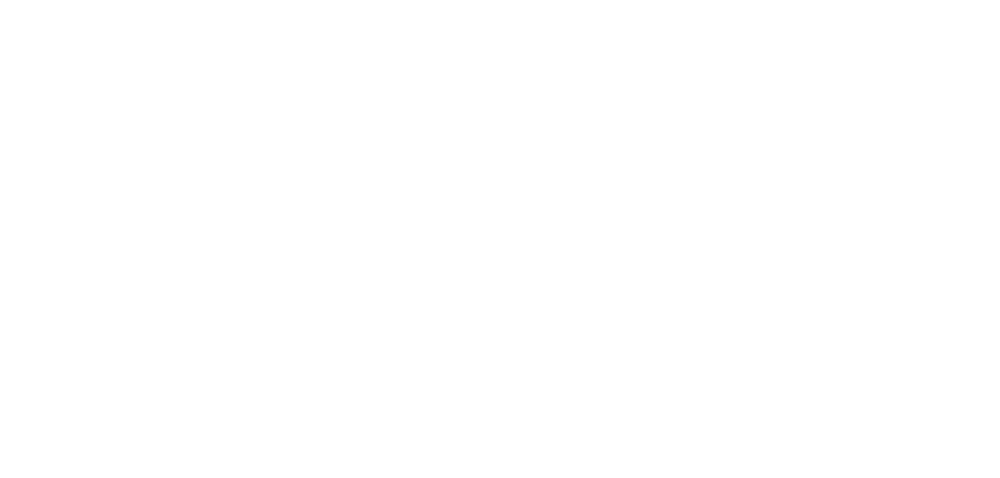

roi62_dff.png


<IPython.core.display.Javascript object>


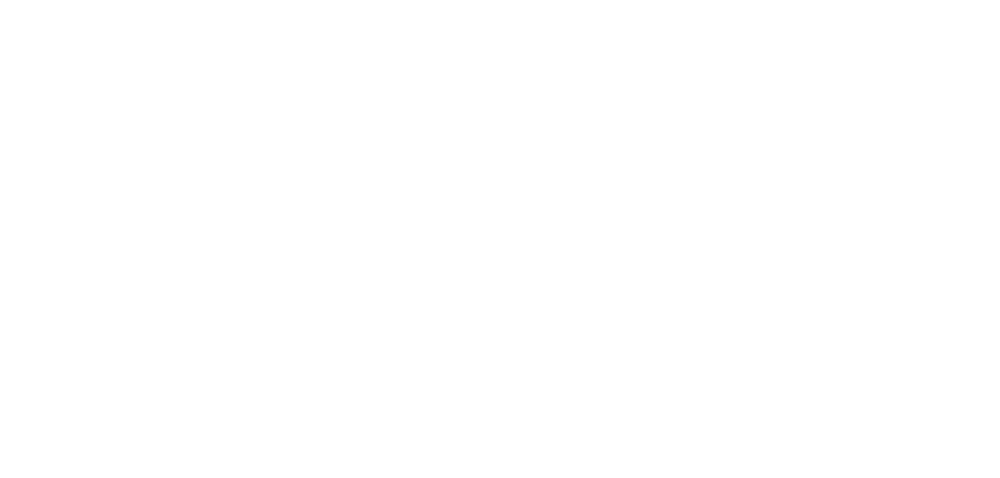

roi63_dff.png


<IPython.core.display.Javascript object>


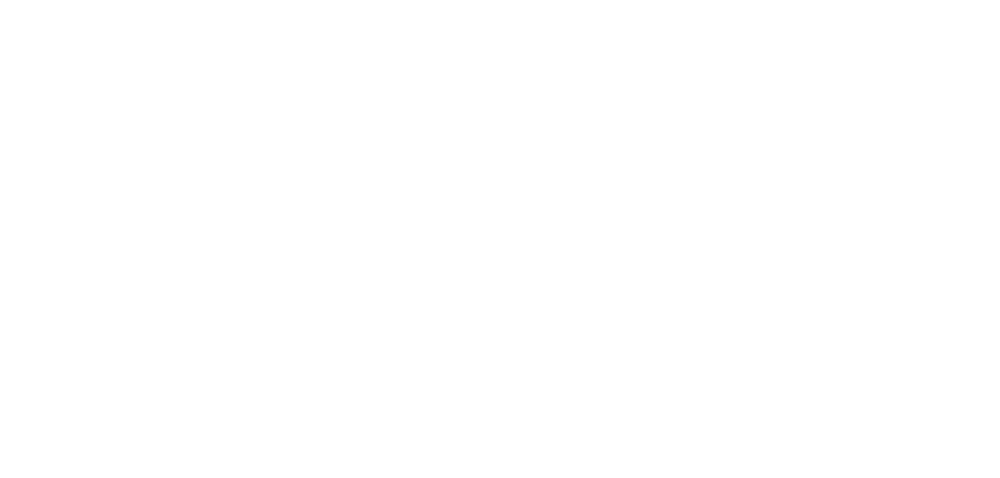

roi64_dff.png


<IPython.core.display.Javascript object>


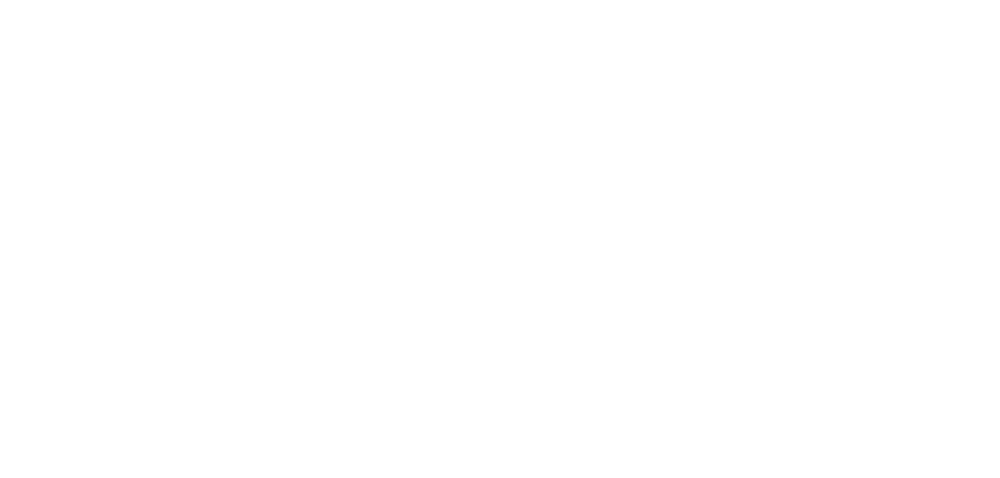

roi65_dff.png


<IPython.core.display.Javascript object>


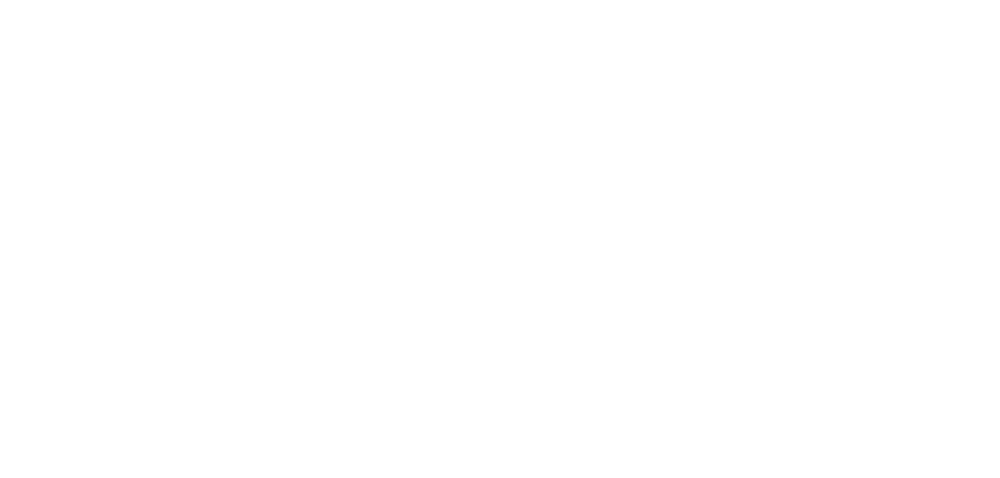

roi66_dff.png


<IPython.core.display.Javascript object>


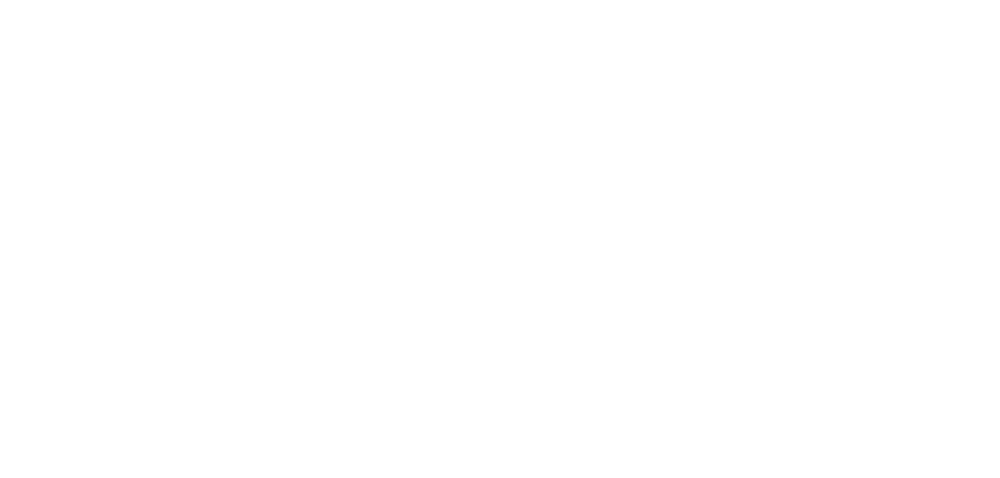

roi67_dff.png


<IPython.core.display.Javascript object>


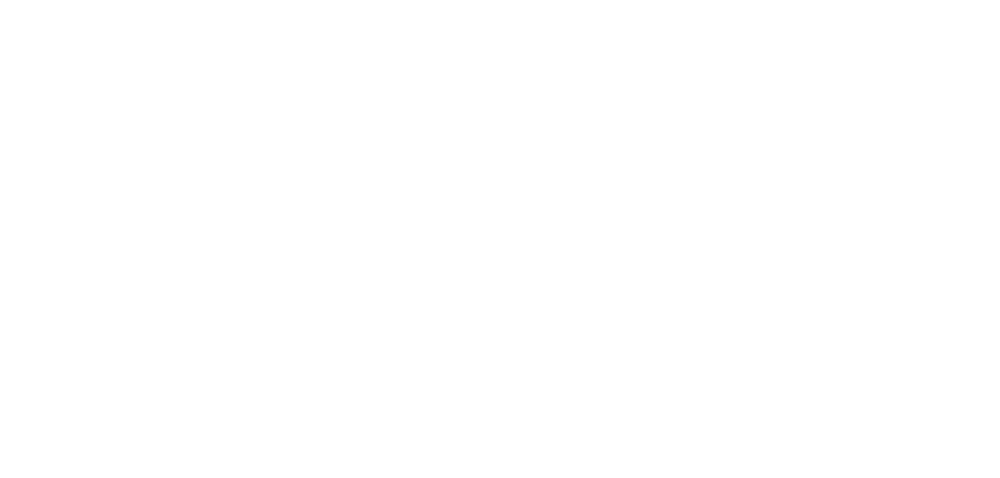

roi68_dff.png


<IPython.core.display.Javascript object>


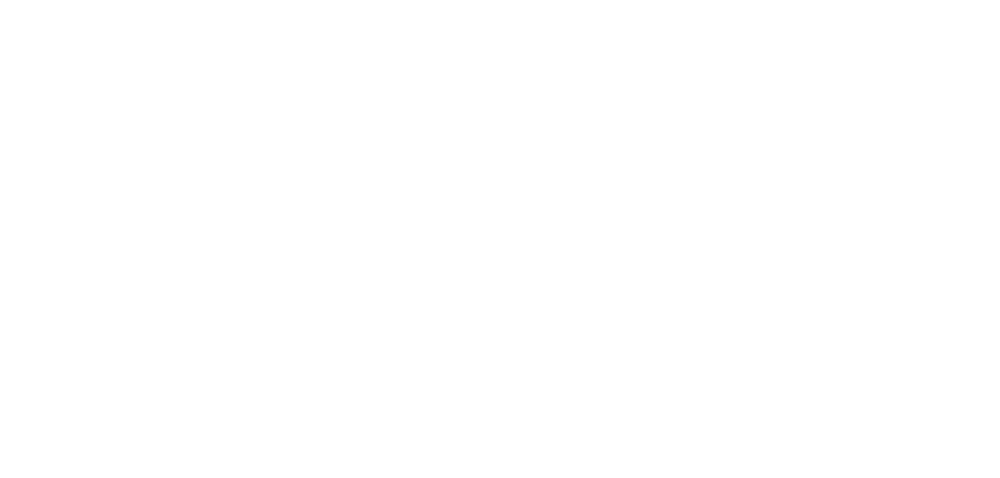

roi69_dff.png


<IPython.core.display.Javascript object>


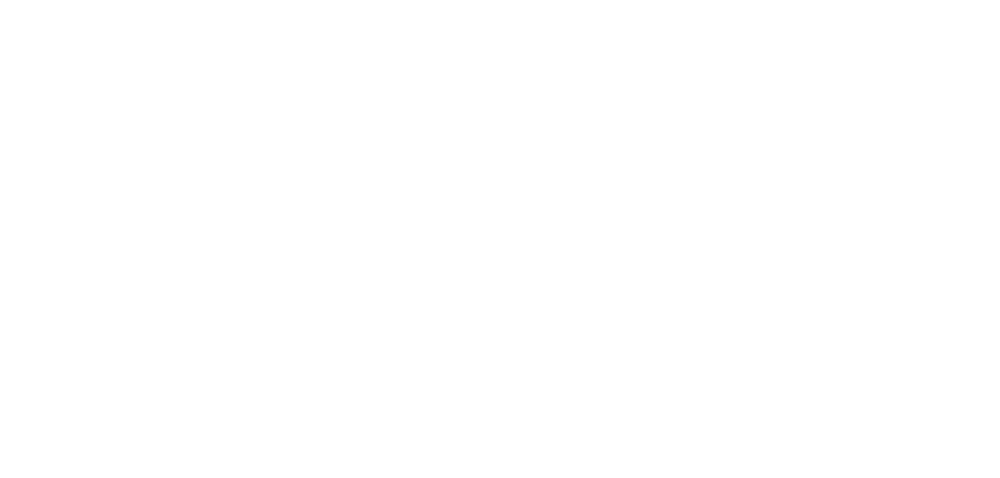

roi70_dff.png


<IPython.core.display.Javascript object>


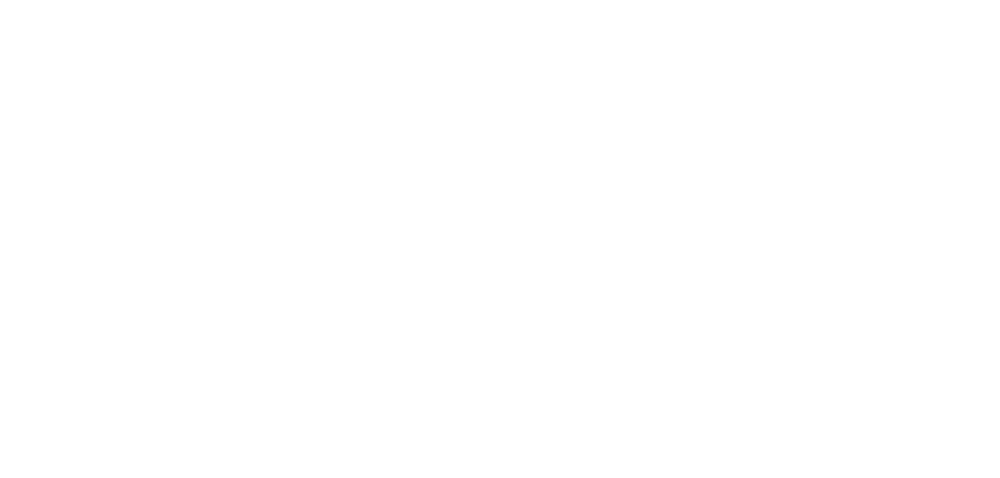

roi71_dff.png


<IPython.core.display.Javascript object>


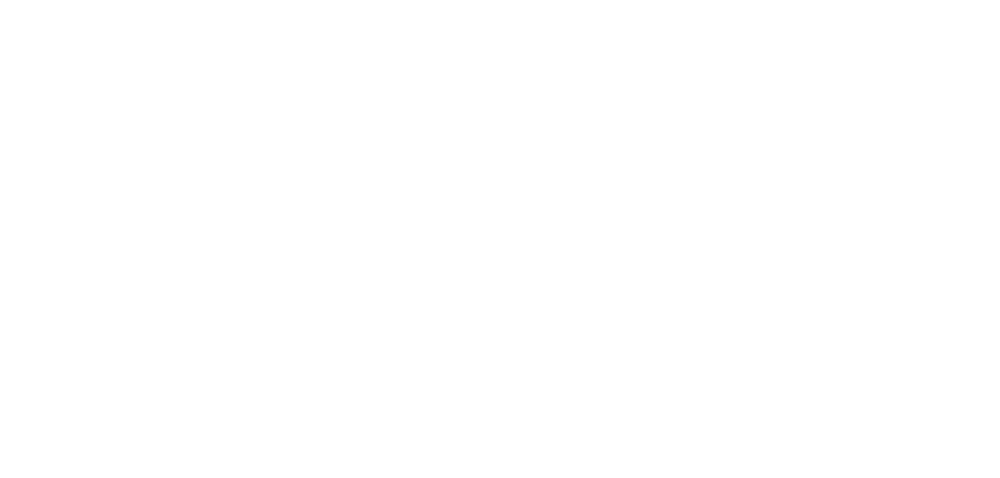

roi72_dff.png


<IPython.core.display.Javascript object>


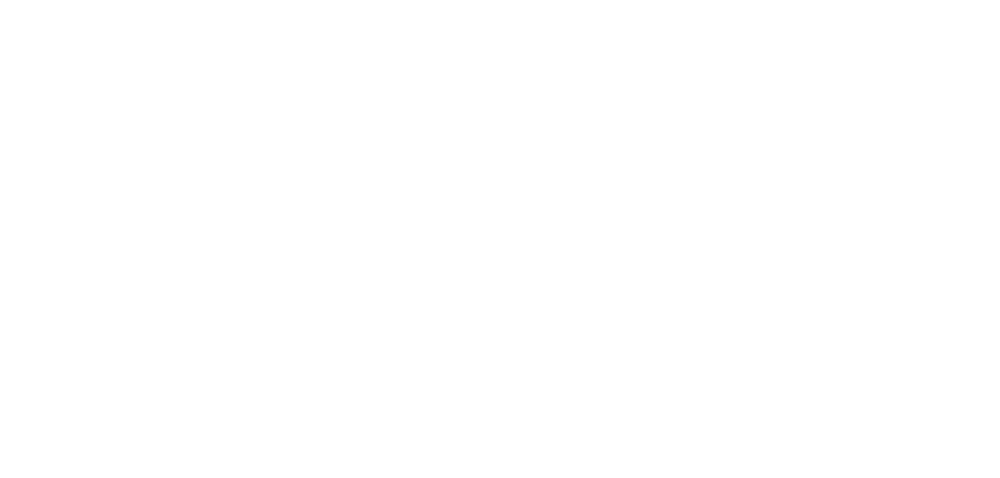

roi73_dff.png


<IPython.core.display.Javascript object>


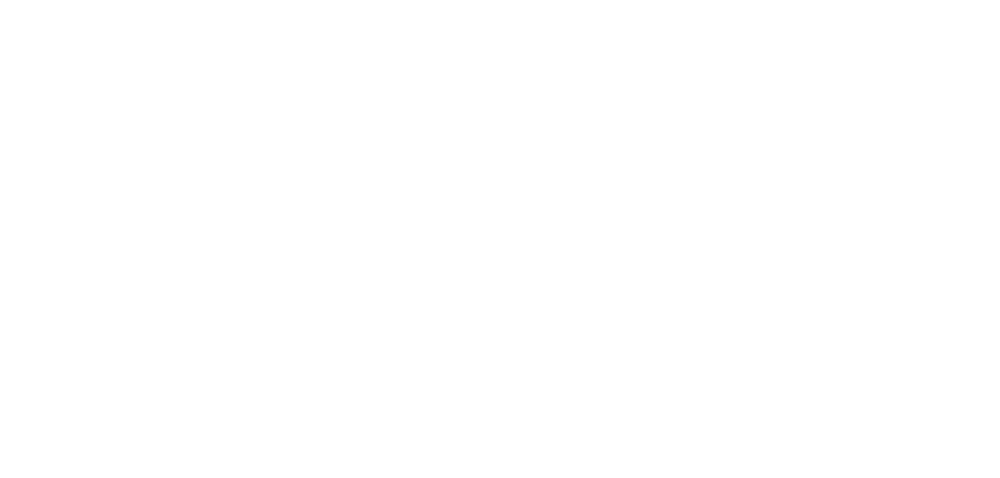

roi74_dff.png


<IPython.core.display.Javascript object>


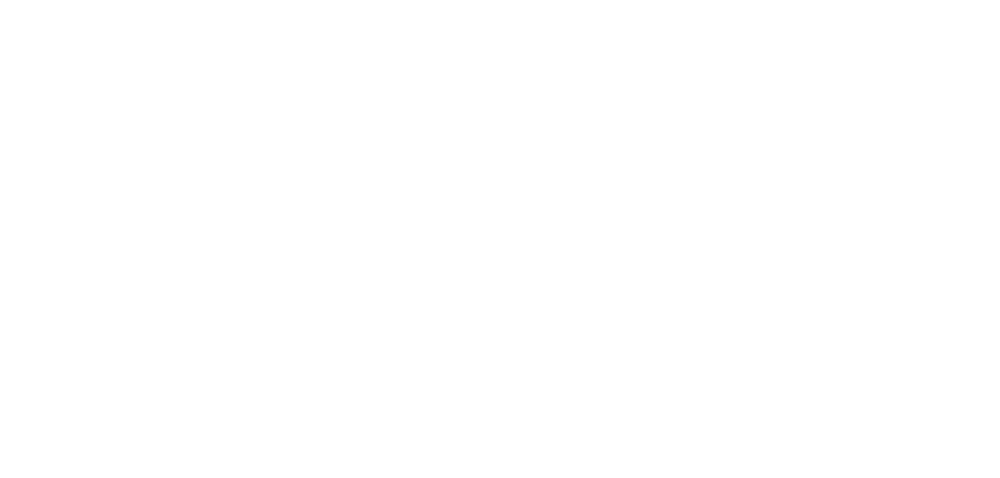

roi75_dff.png


<IPython.core.display.Javascript object>


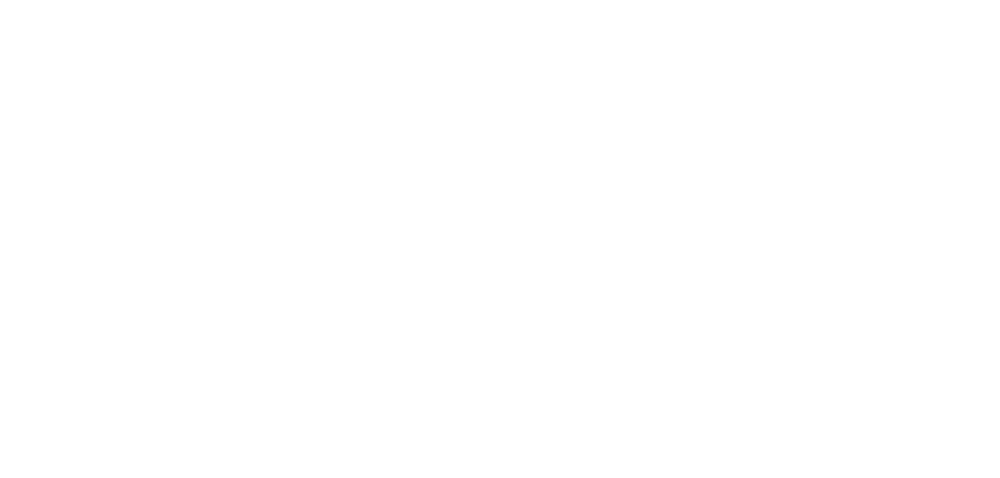

roi76_dff.png


<IPython.core.display.Javascript object>


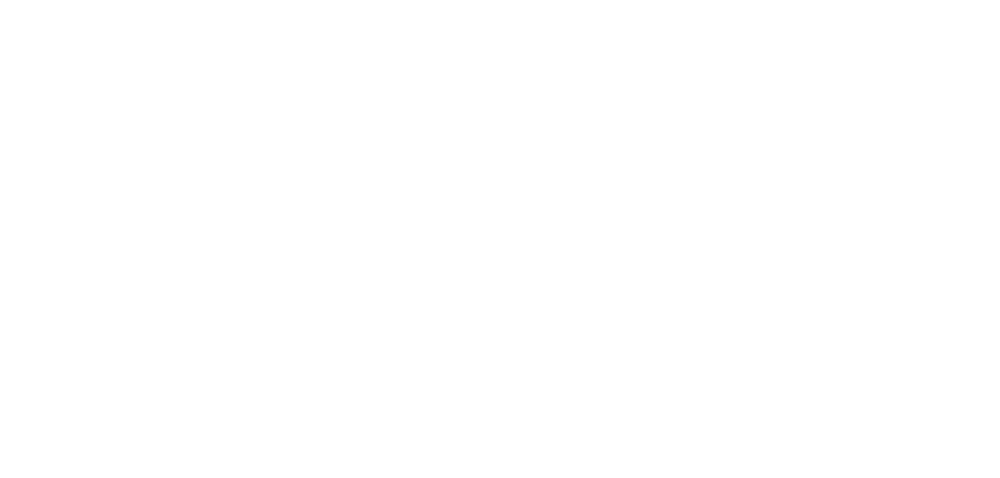

roi77_dff.png


<IPython.core.display.Javascript object>


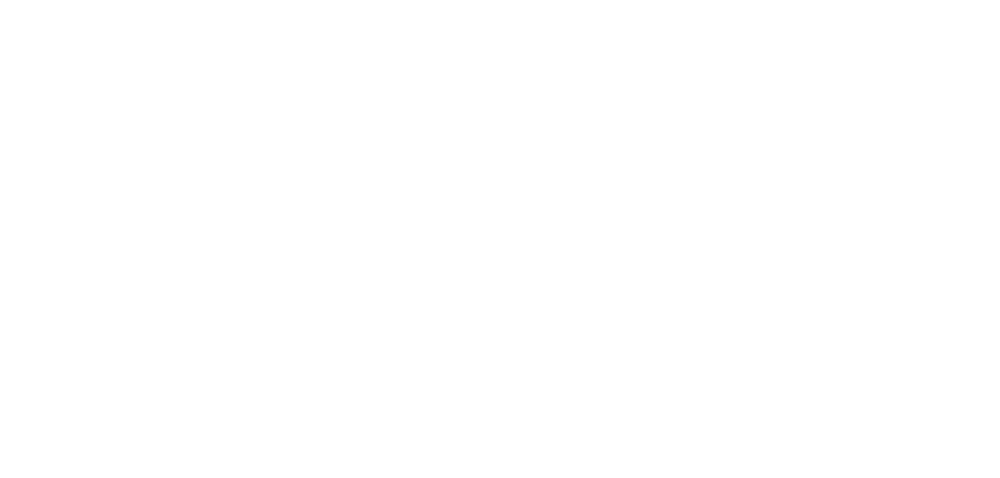

roi78_dff.png


<IPython.core.display.Javascript object>


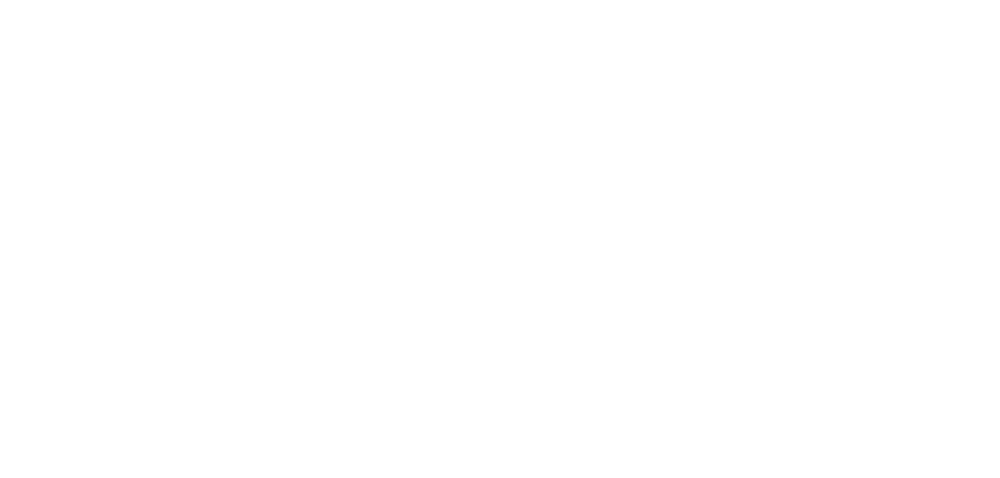

roi79_dff.png


<IPython.core.display.Javascript object>


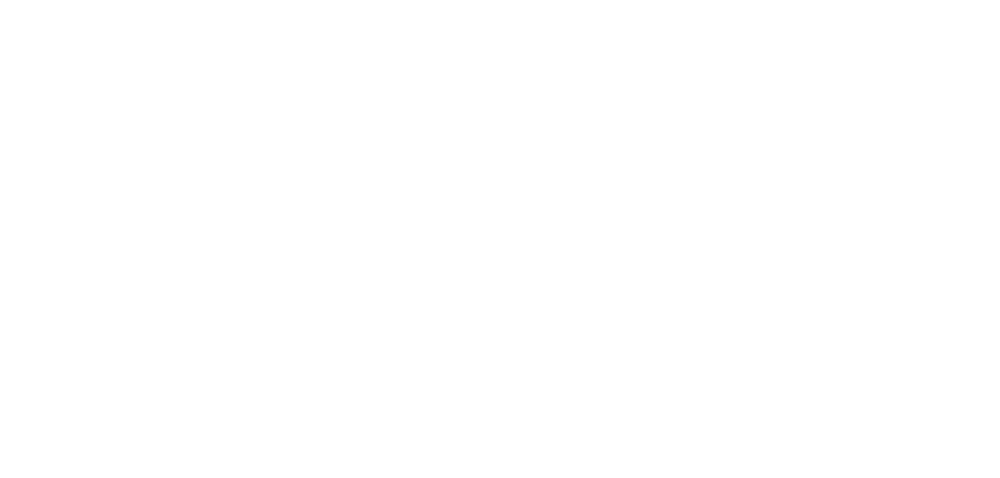

roi80_dff.png


<IPython.core.display.Javascript object>


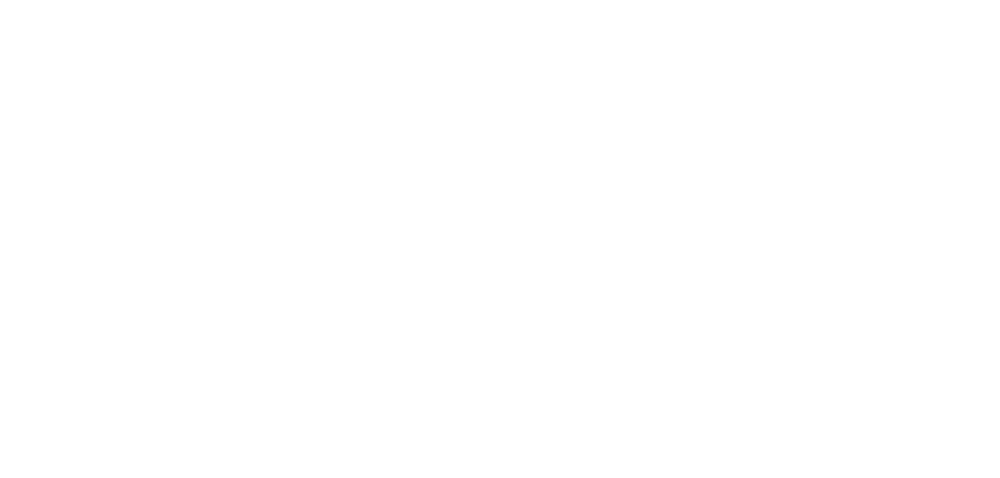

roi81_dff.png


<IPython.core.display.Javascript object>


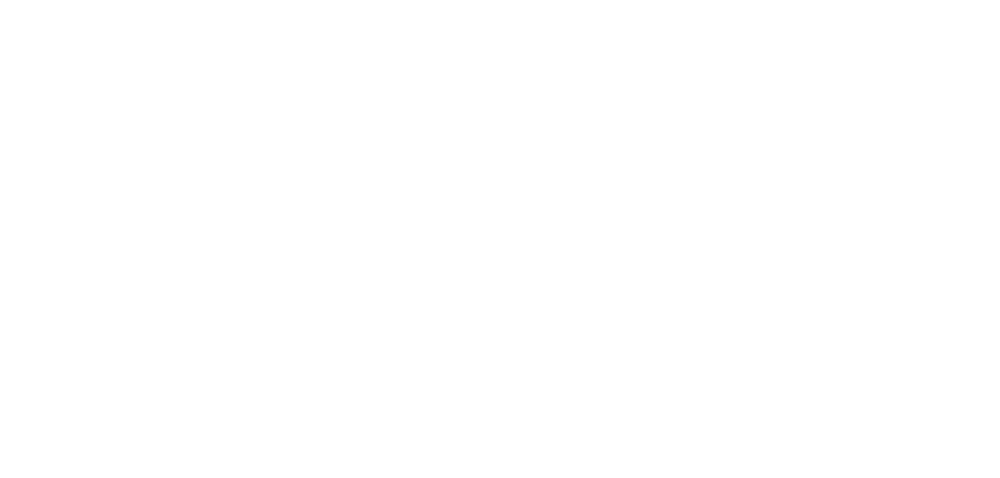

roi82_dff.png


<IPython.core.display.Javascript object>


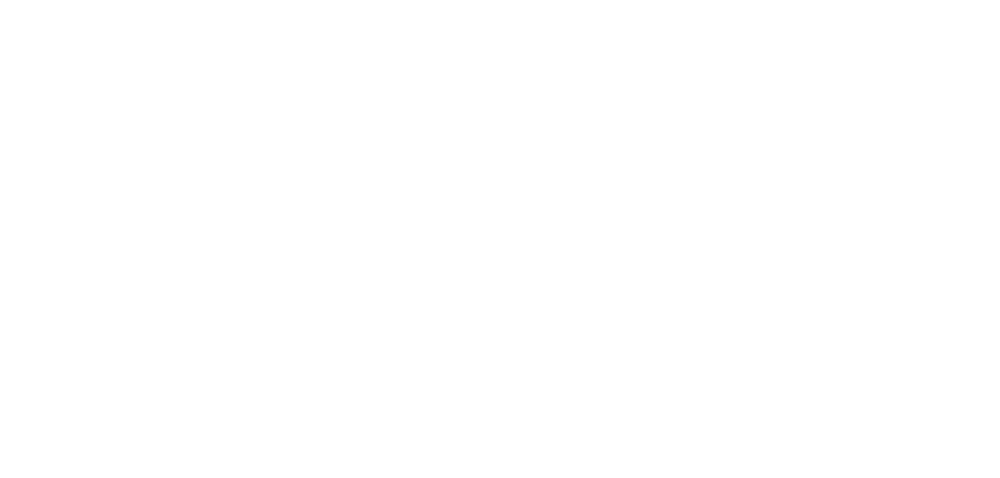

roi83_dff.png


<IPython.core.display.Javascript object>


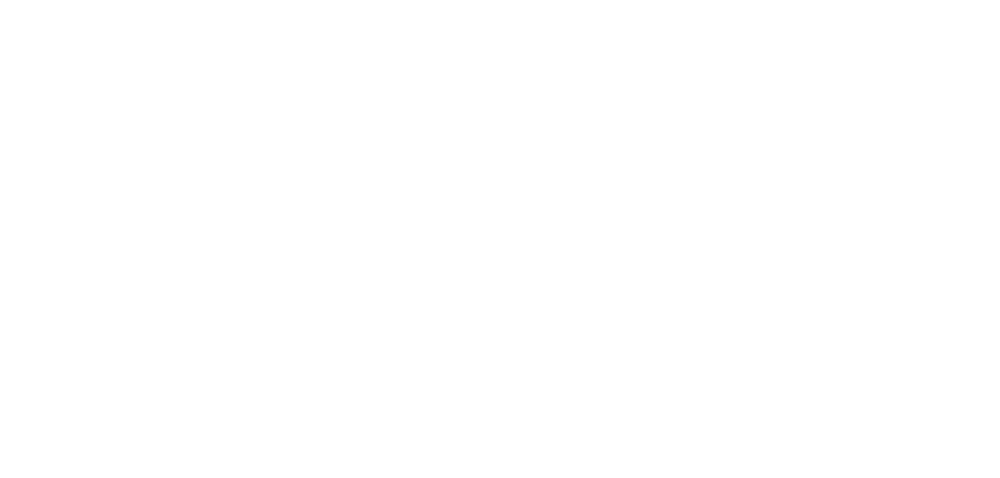

roi84_dff.png


<IPython.core.display.Javascript object>


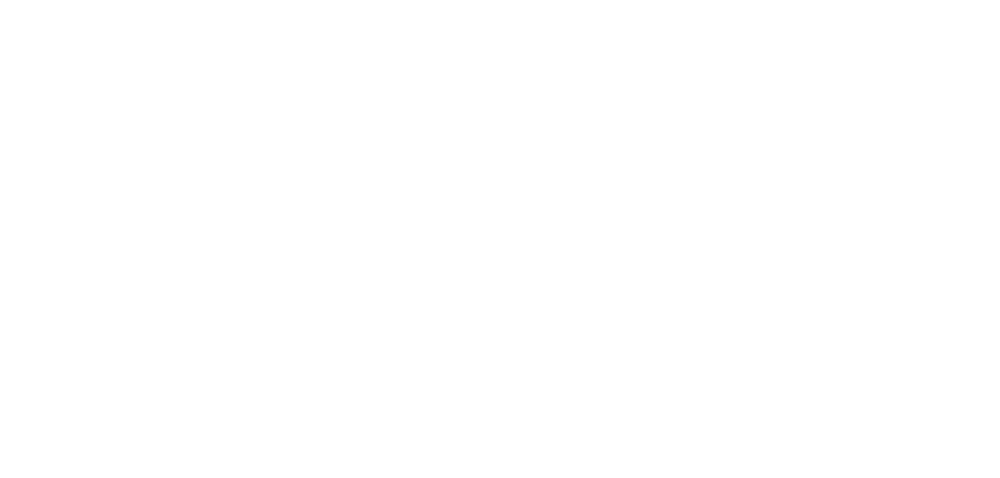

roi85_dff.png


<IPython.core.display.Javascript object>


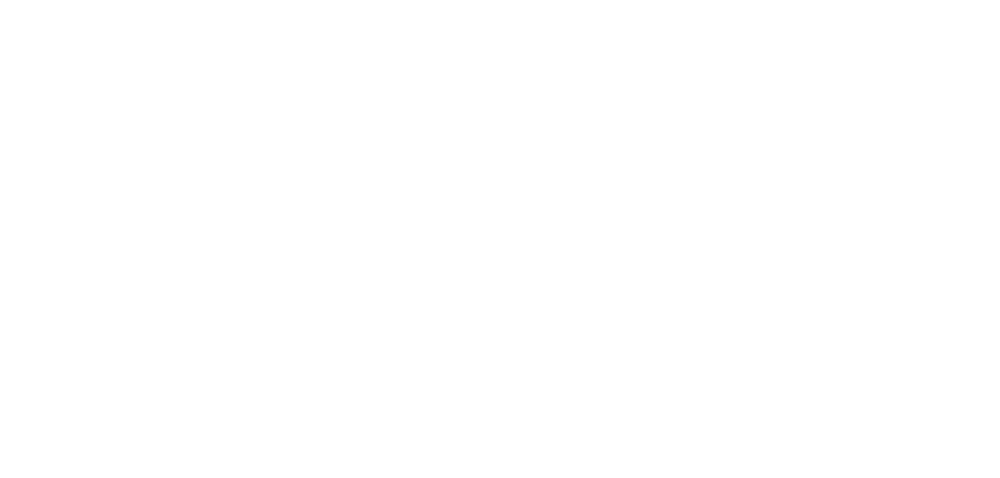

roi86_dff.png


<IPython.core.display.Javascript object>


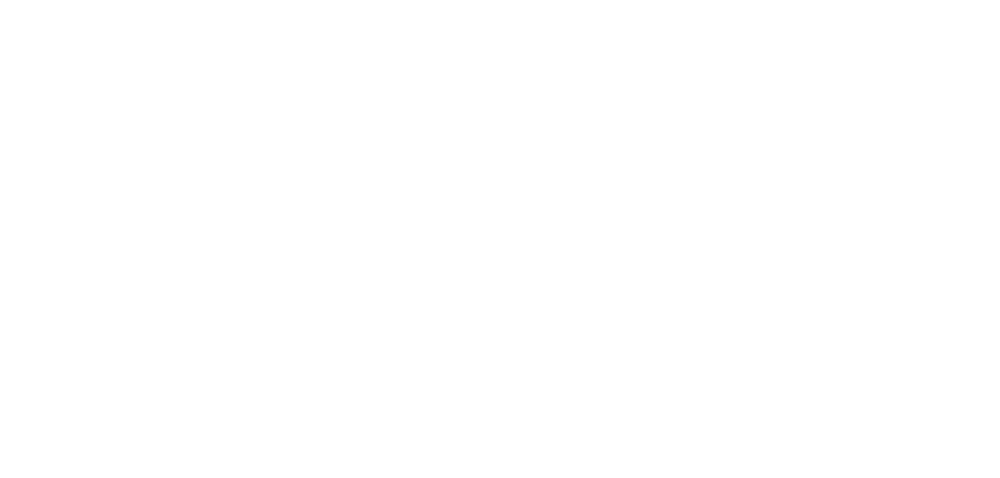

roi87_dff.png


<IPython.core.display.Javascript object>


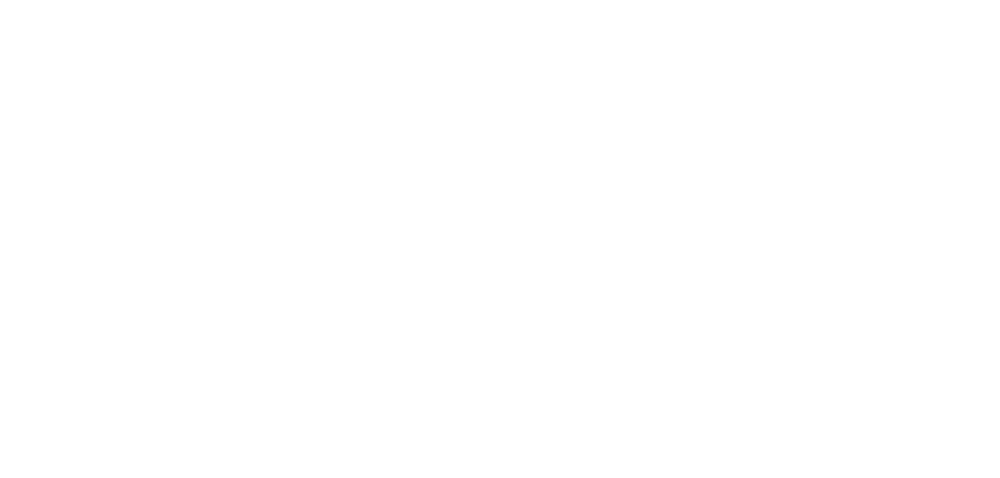

roi88_dff.png


<IPython.core.display.Javascript object>


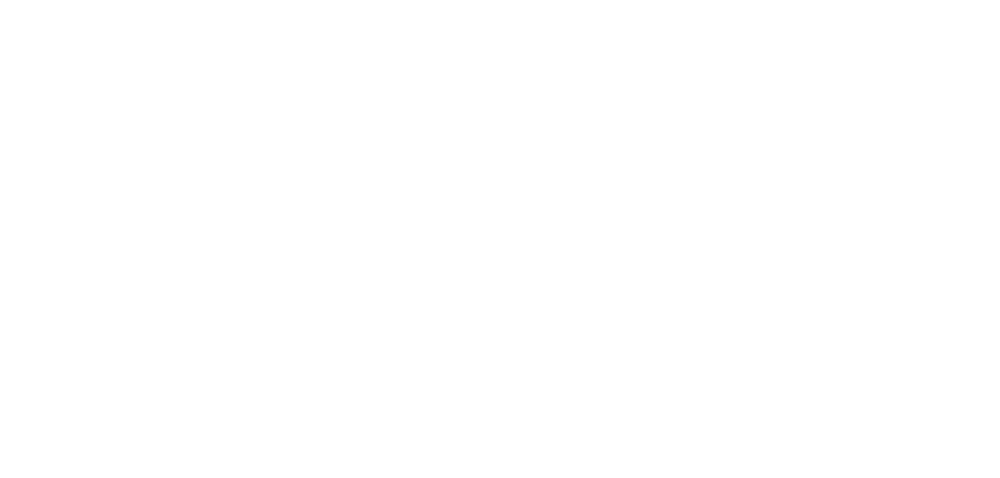

roi89_dff.png


<IPython.core.display.Javascript object>


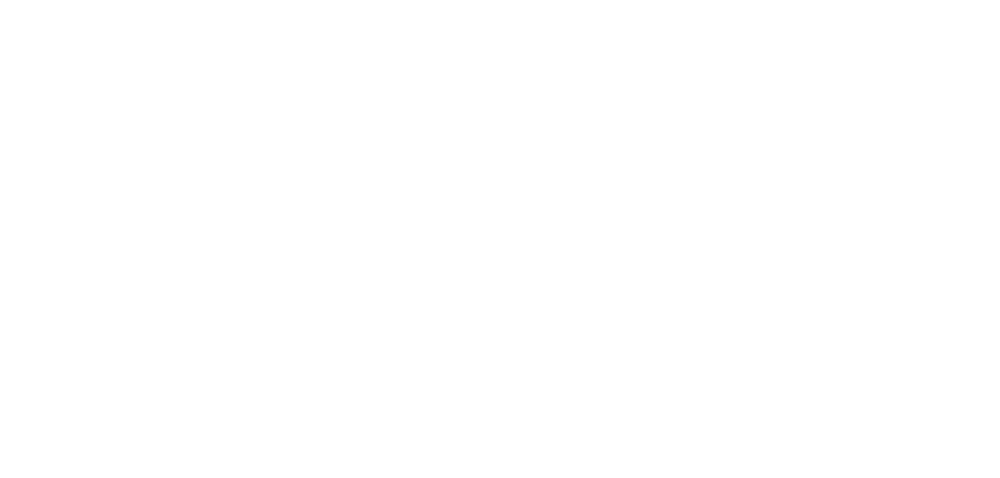

roi90_dff.png


<IPython.core.display.Javascript object>


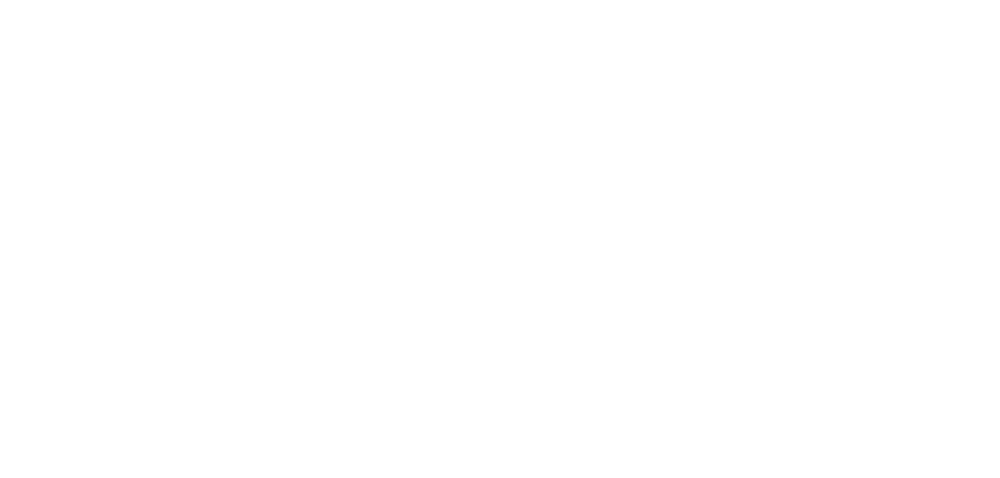

roi91_dff.png


<IPython.core.display.Javascript object>


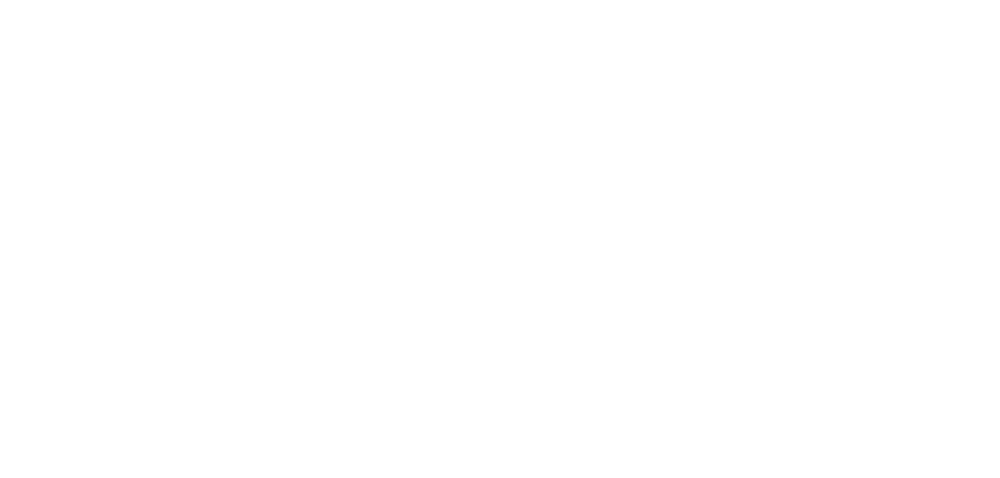

roi92_dff.png


<IPython.core.display.Javascript object>


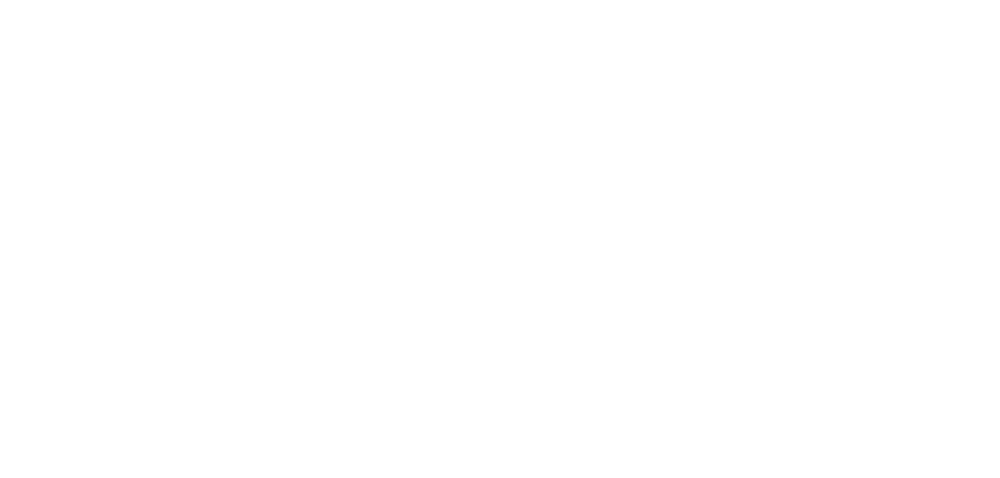

roi93_dff.png


<IPython.core.display.Javascript object>


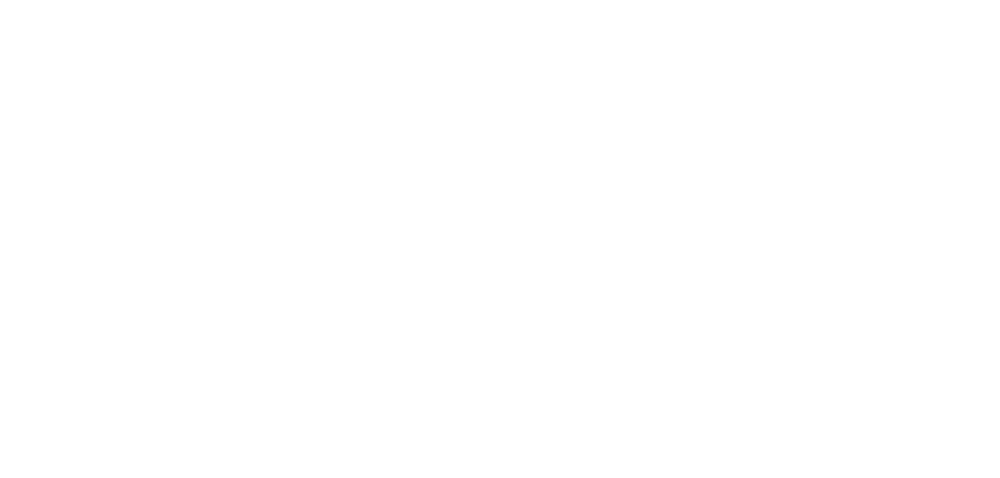

roi94_dff.png


<IPython.core.display.Javascript object>


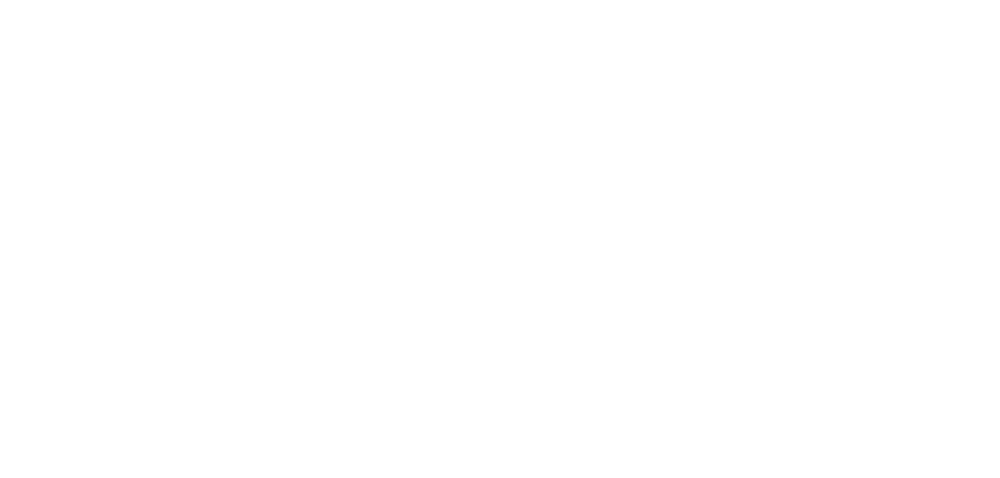

roi95_dff.png


<IPython.core.display.Javascript object>


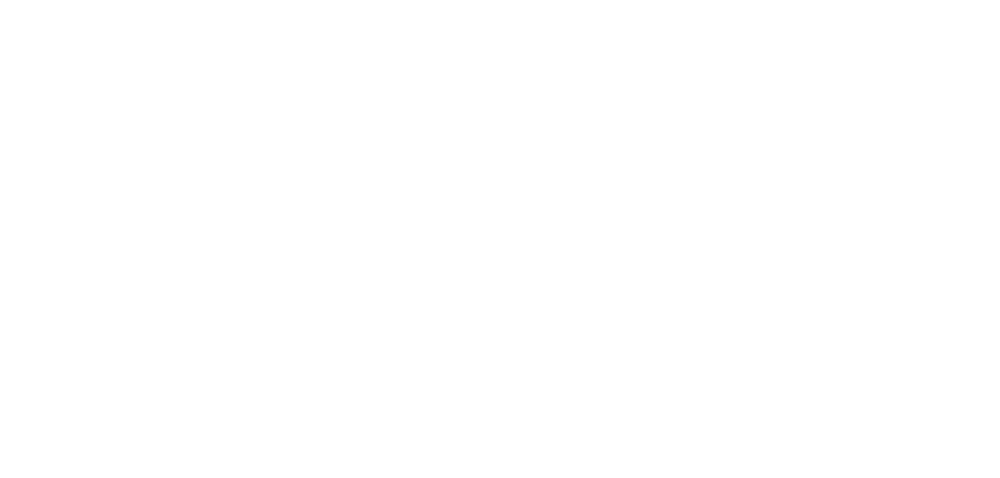

roi96_dff.png


<IPython.core.display.Javascript object>


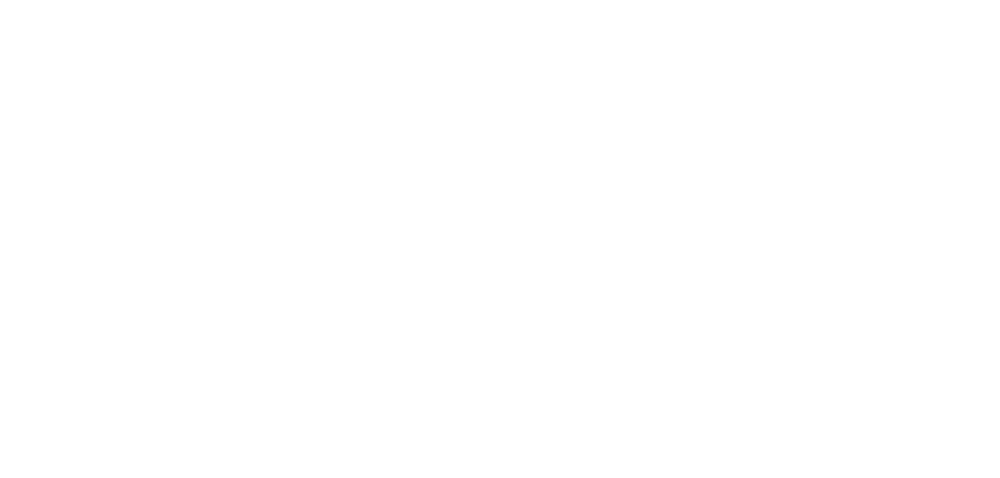

roi97_dff.png


<IPython.core.display.Javascript object>


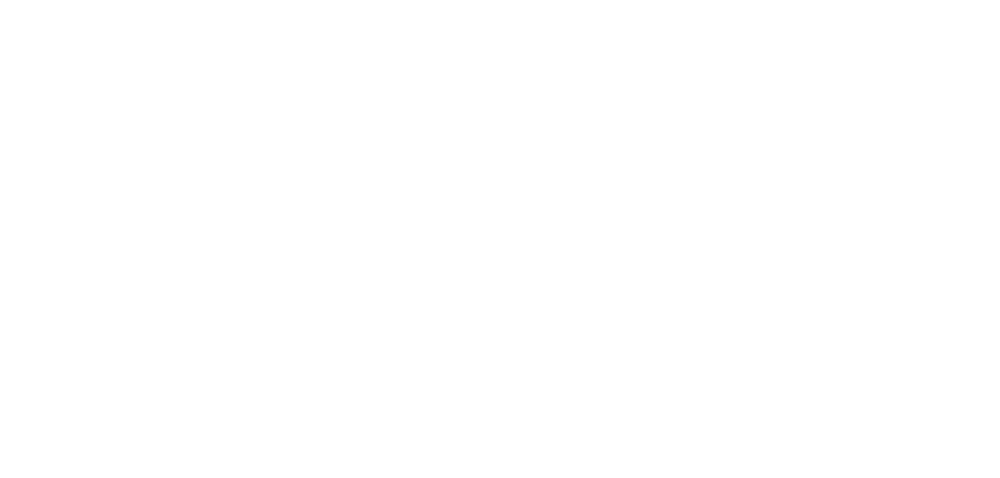

roi98_dff.png


<IPython.core.display.Javascript object>


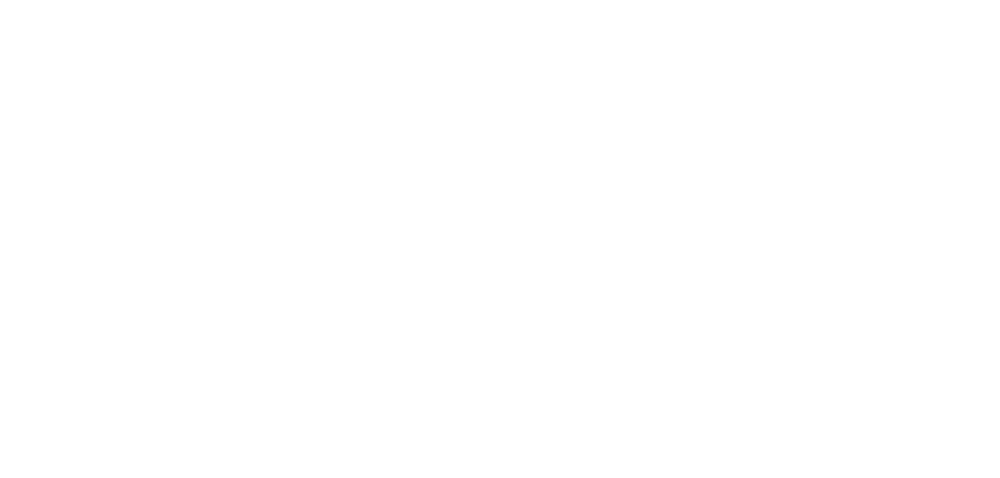

roi99_dff.png


<IPython.core.display.Javascript object>


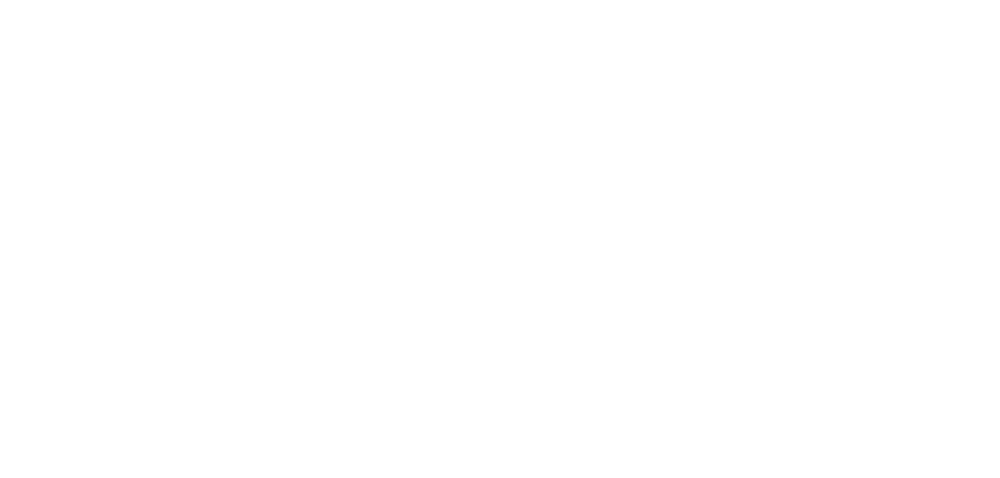

roi100_dff.png


<IPython.core.display.Javascript object>


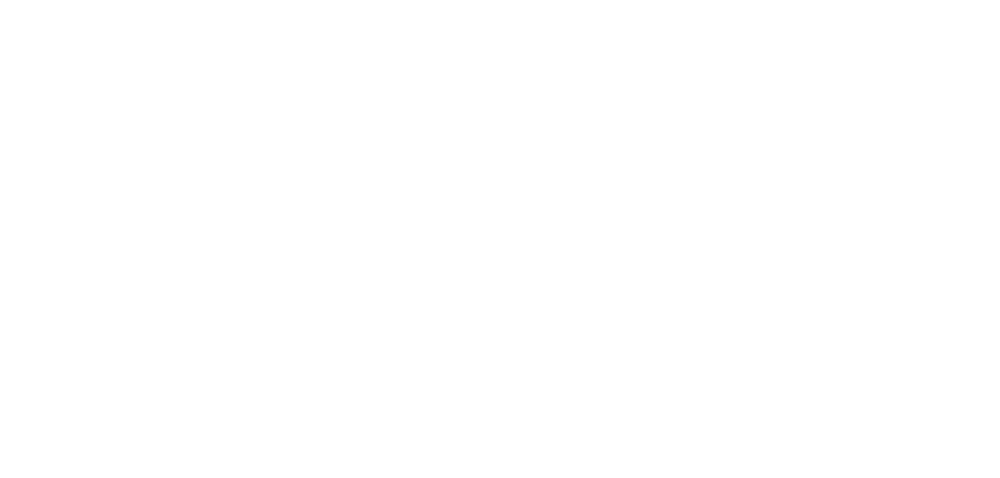

roi101_dff.png


<IPython.core.display.Javascript object>


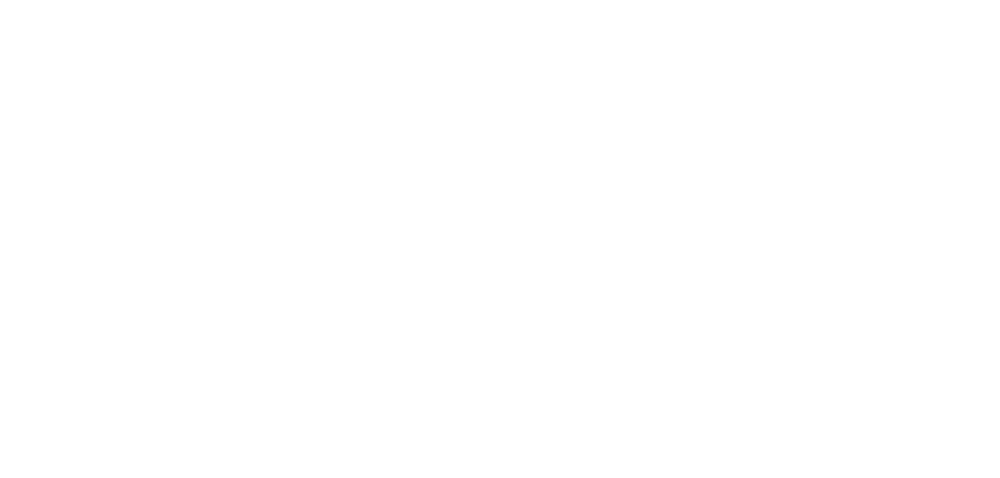

roi102_dff.png


<IPython.core.display.Javascript object>


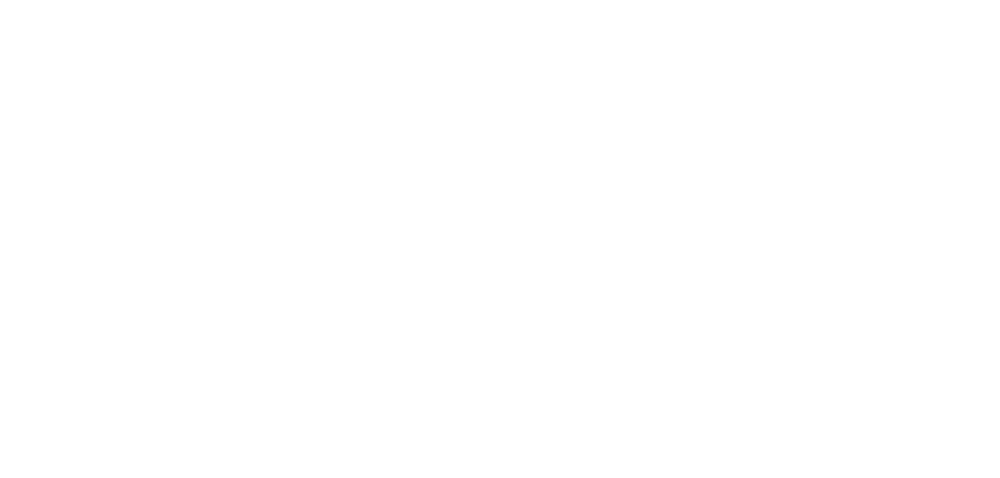

roi103_dff.png


<IPython.core.display.Javascript object>


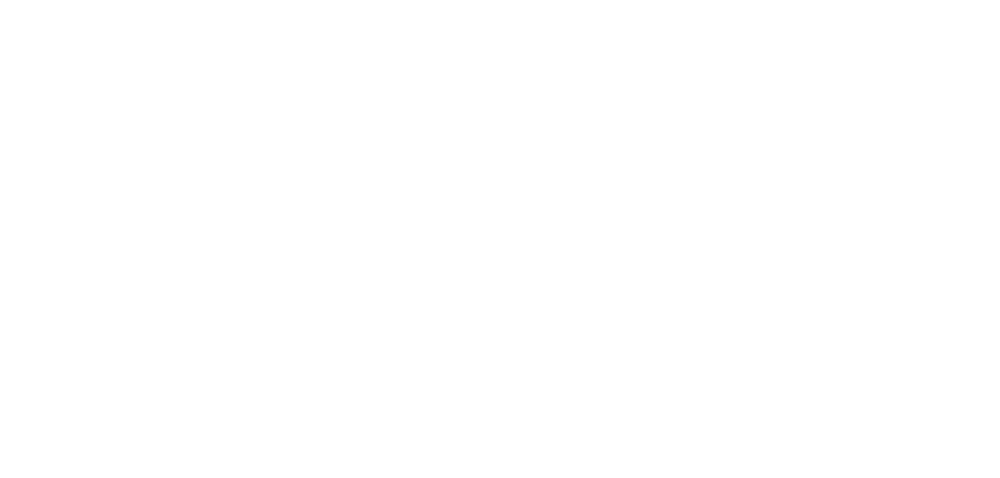

roi104_dff.png


<IPython.core.display.Javascript object>


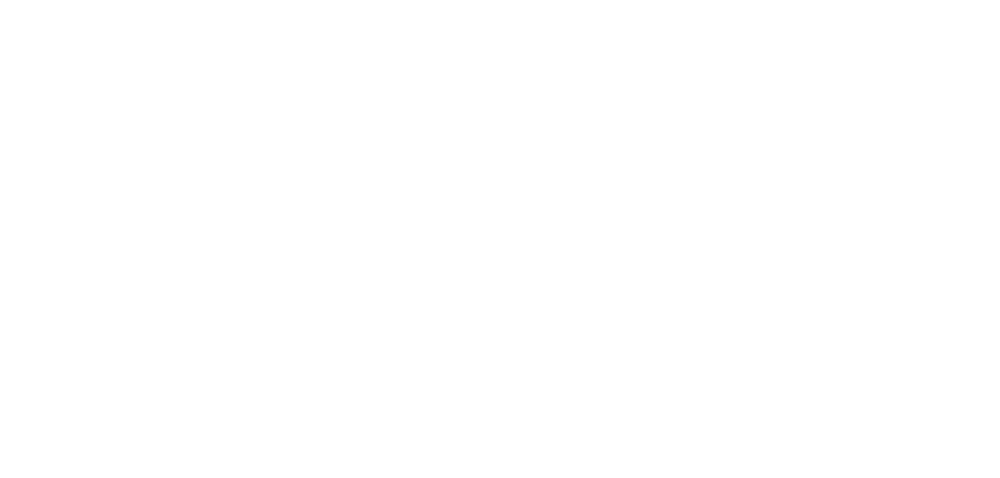

roi105_dff.png


<IPython.core.display.Javascript object>


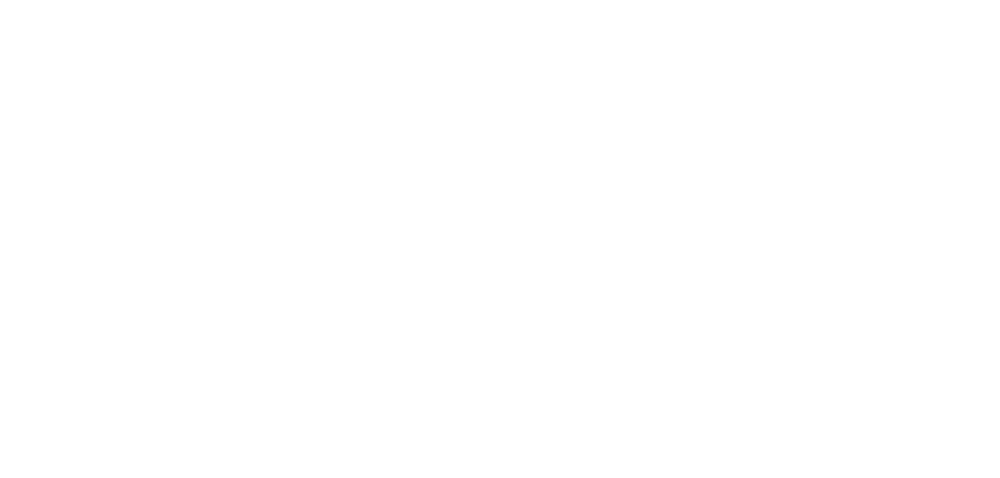

roi106_dff.png


<IPython.core.display.Javascript object>


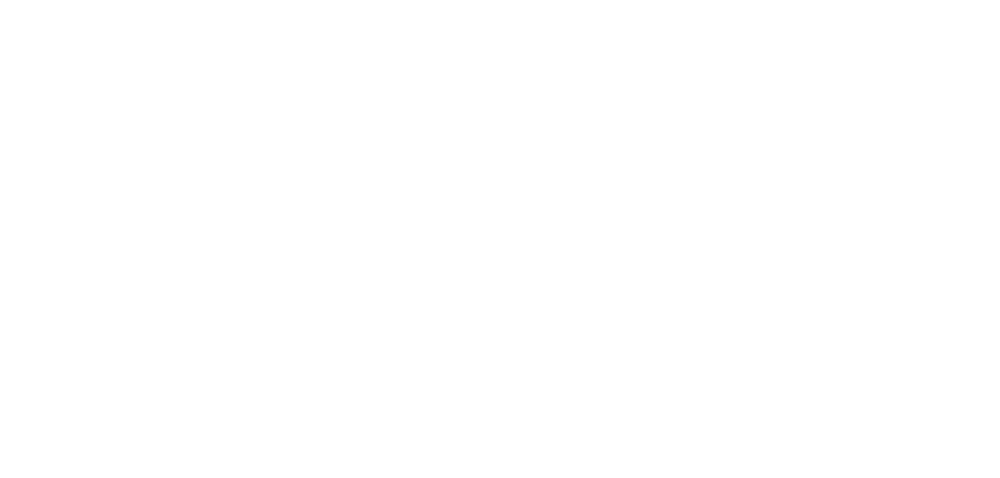

roi107_dff.png


<IPython.core.display.Javascript object>


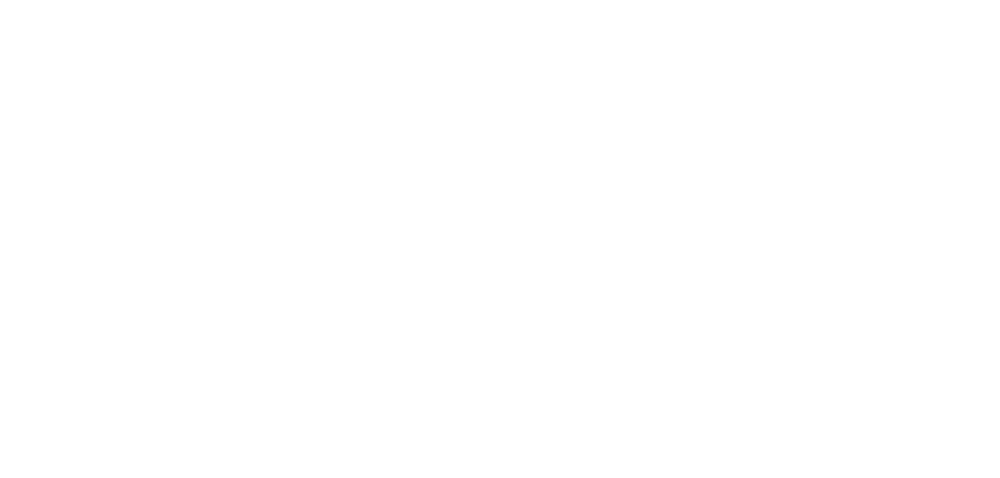

roi108_dff.png


<IPython.core.display.Javascript object>


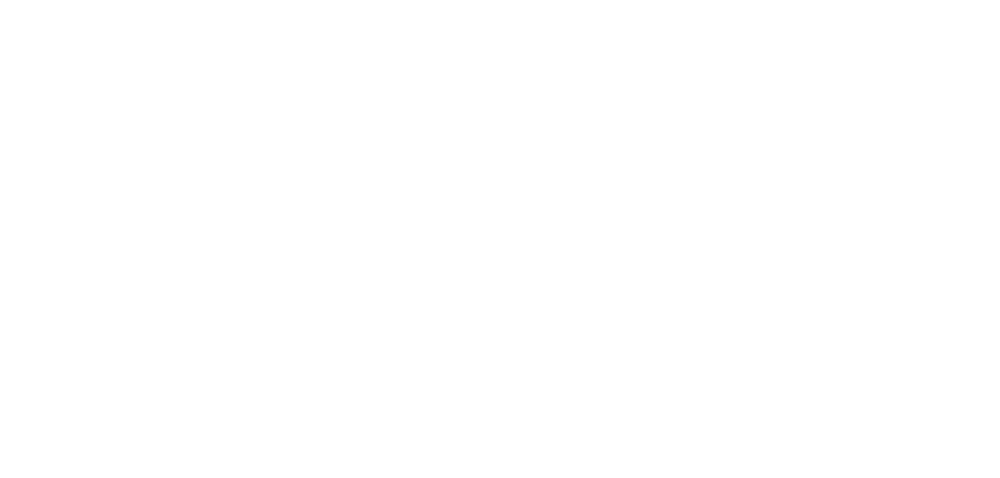

roi109_dff.png


<IPython.core.display.Javascript object>


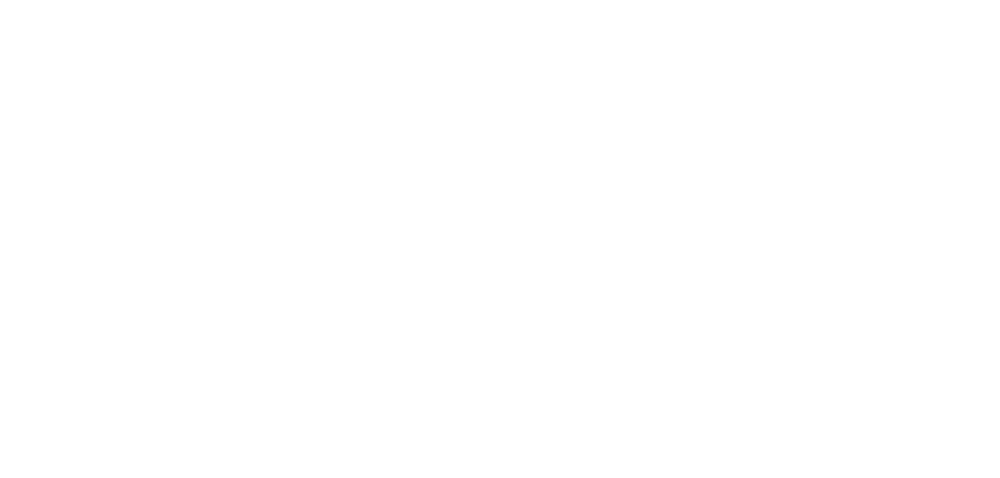

roi110_dff.png


<IPython.core.display.Javascript object>


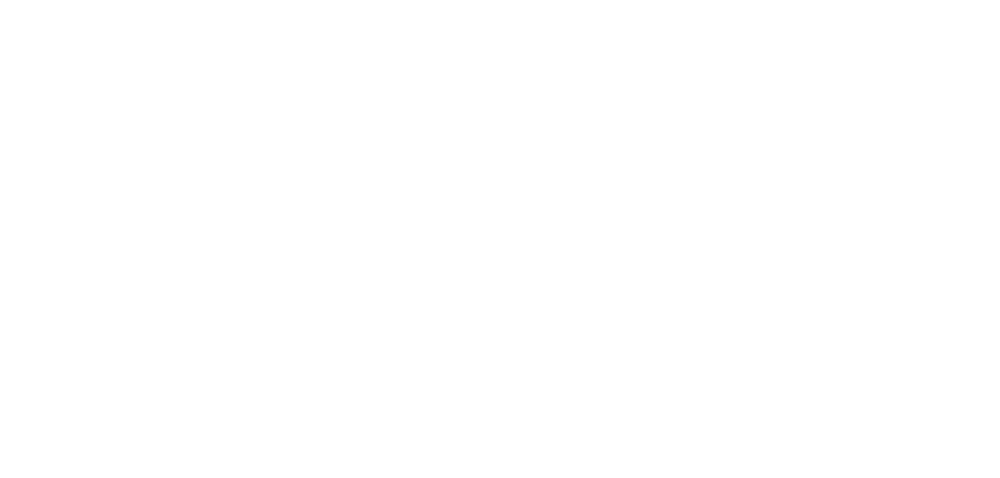

roi111_dff.png


<IPython.core.display.Javascript object>


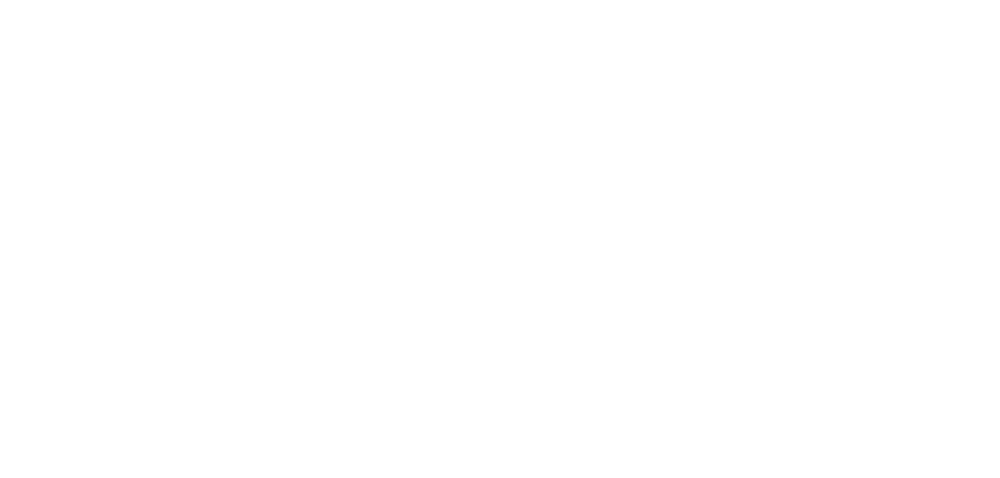

roi112_dff.png


<IPython.core.display.Javascript object>


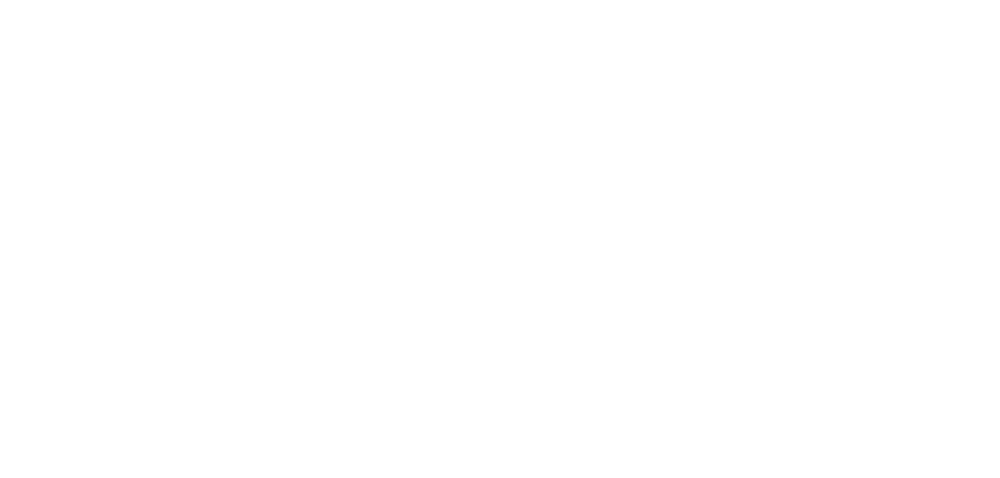

roi113_dff.png


<IPython.core.display.Javascript object>


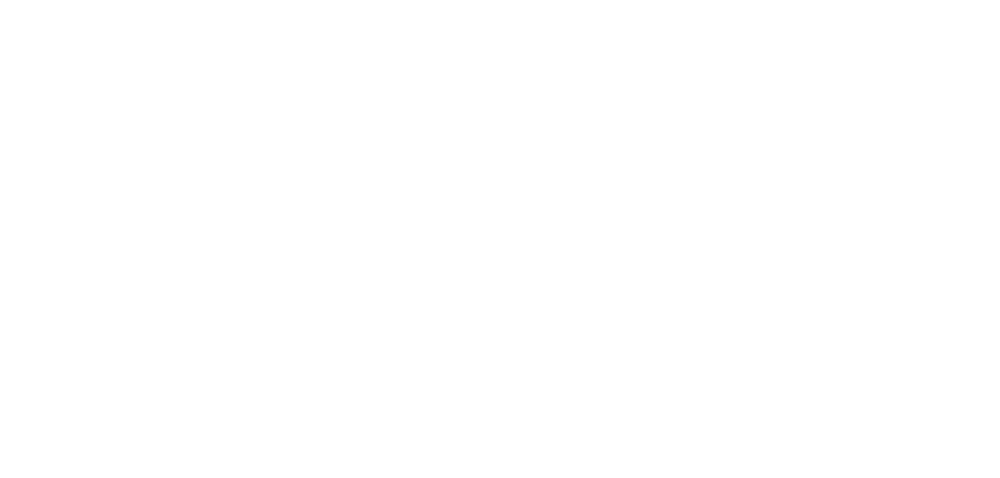

roi114_dff.png


<IPython.core.display.Javascript object>


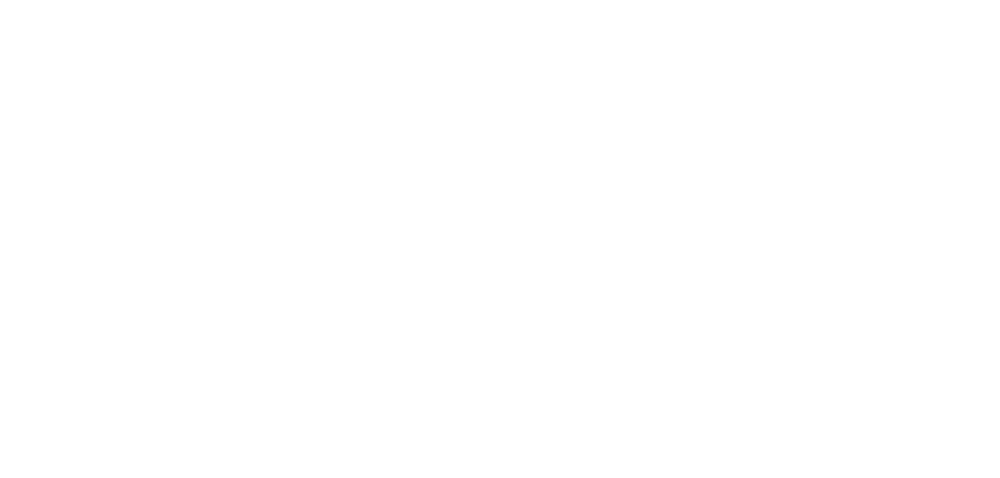

roi115_dff.png


<IPython.core.display.Javascript object>


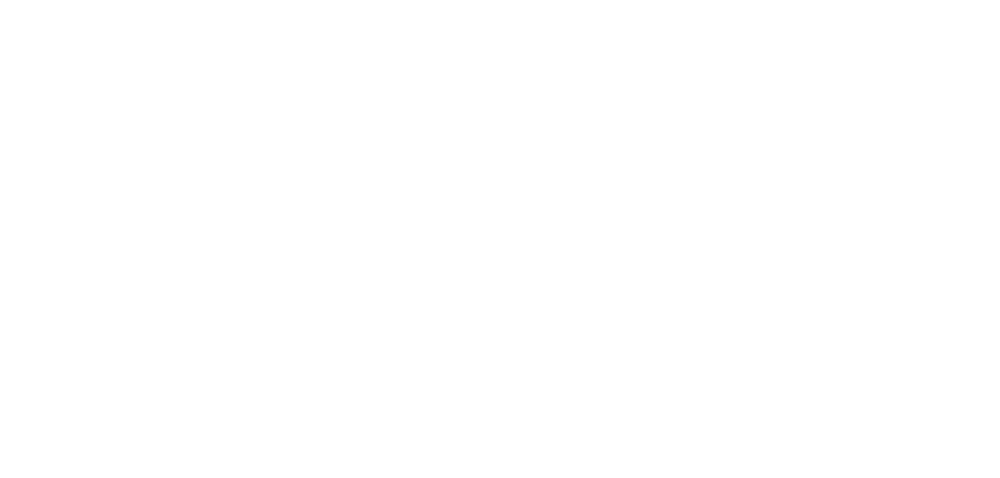

roi116_dff.png


<IPython.core.display.Javascript object>


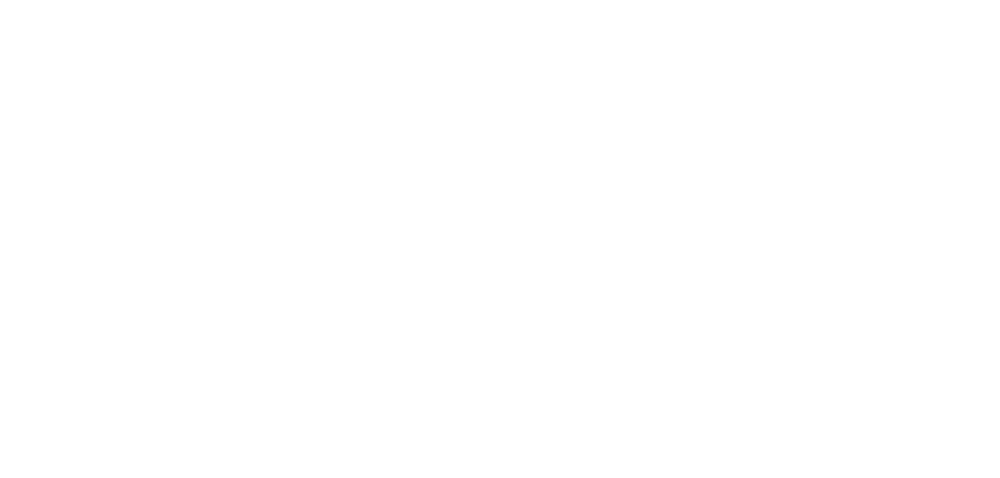

roi117_dff.png


<IPython.core.display.Javascript object>


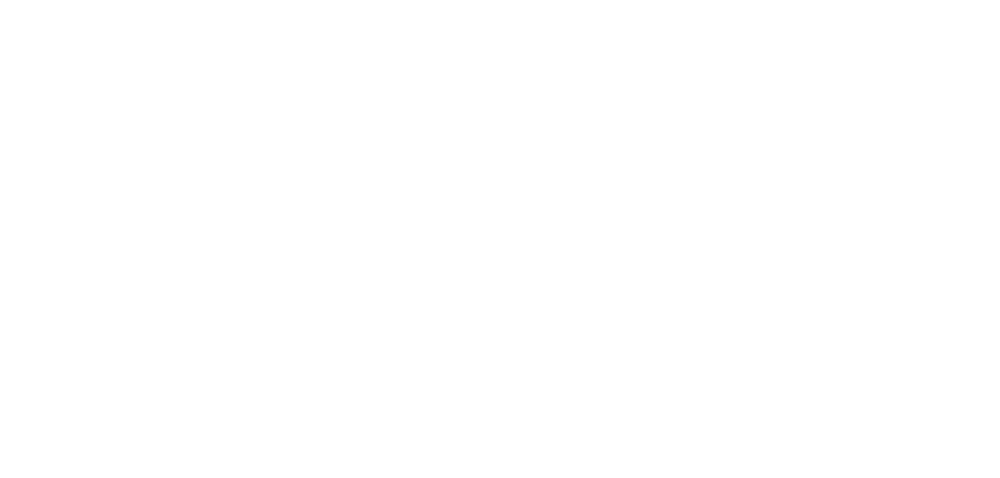

roi118_dff.png


<IPython.core.display.Javascript object>


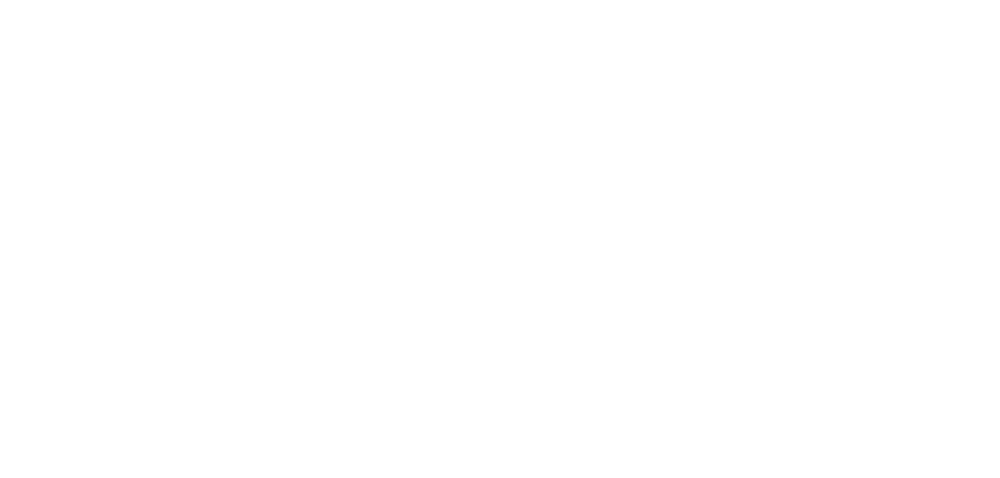

roi119_dff.png


<IPython.core.display.Javascript object>


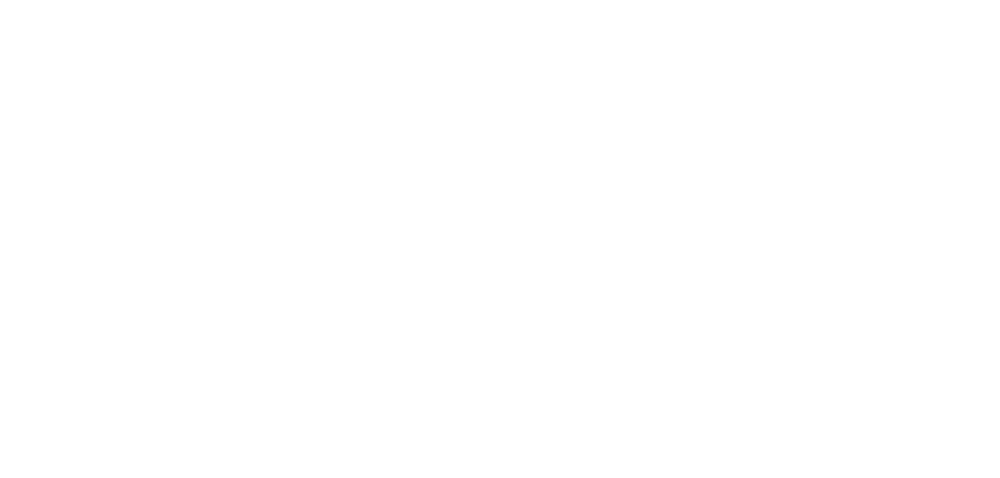

roi120_dff.png


<IPython.core.display.Javascript object>


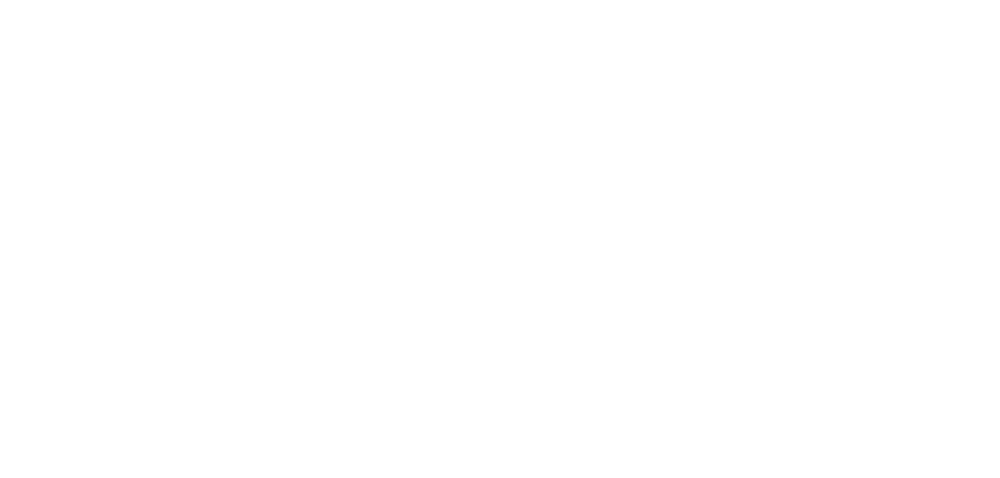

roi121_dff.png


<IPython.core.display.Javascript object>


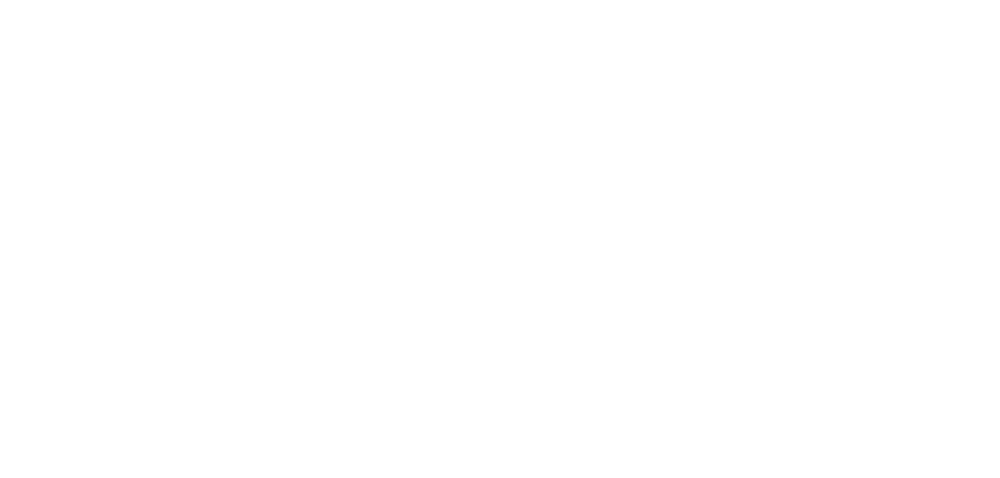

roi122_dff.png


<IPython.core.display.Javascript object>


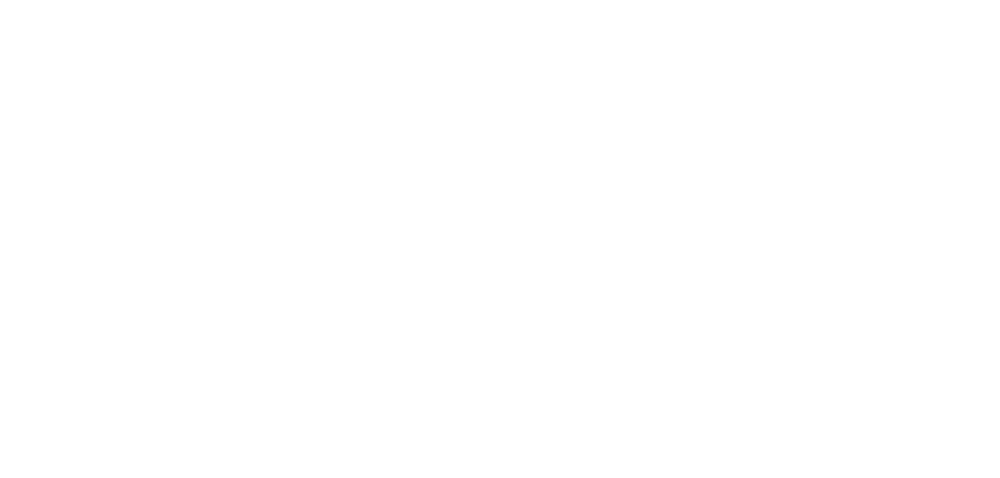

roi123_dff.png


<IPython.core.display.Javascript object>


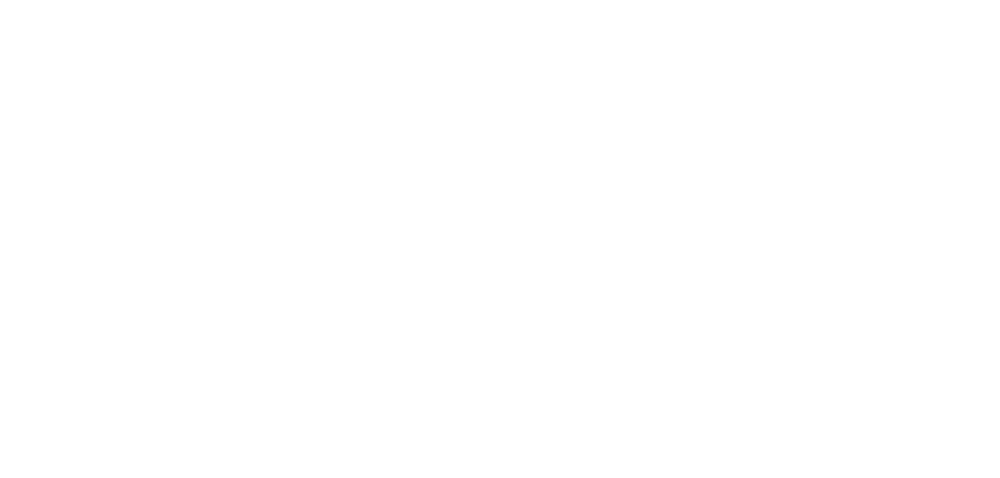

roi124_dff.png


<IPython.core.display.Javascript object>


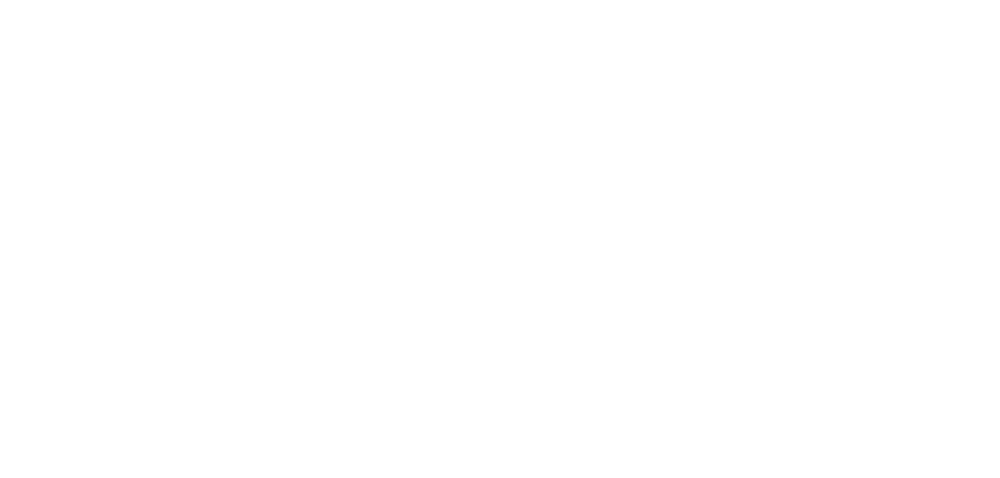

roi125_dff.png


<IPython.core.display.Javascript object>


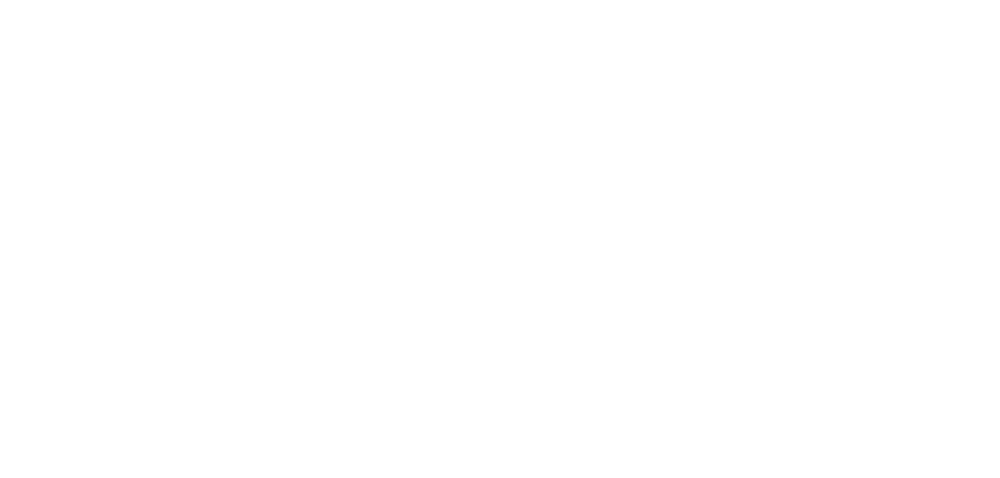

roi126_dff.png


<IPython.core.display.Javascript object>


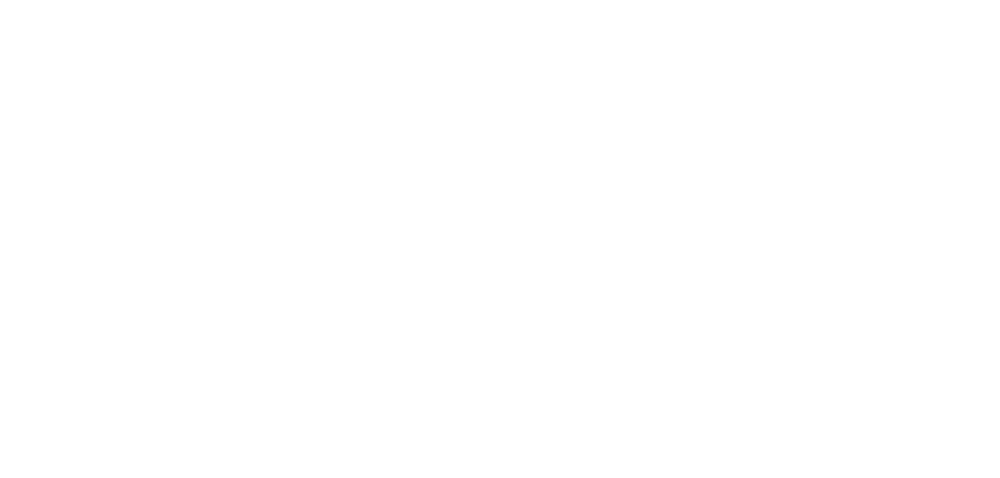

roi127_dff.png


<IPython.core.display.Javascript object>


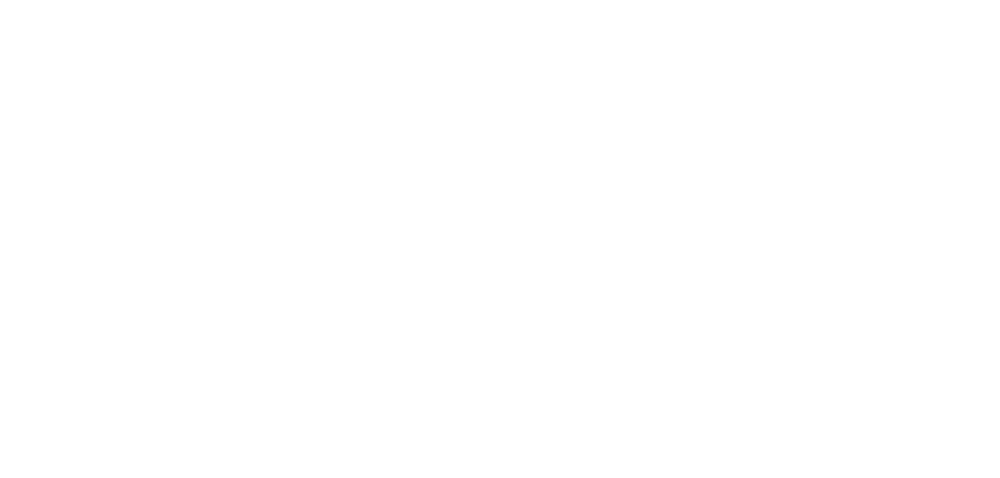

roi128_dff.png


<IPython.core.display.Javascript object>


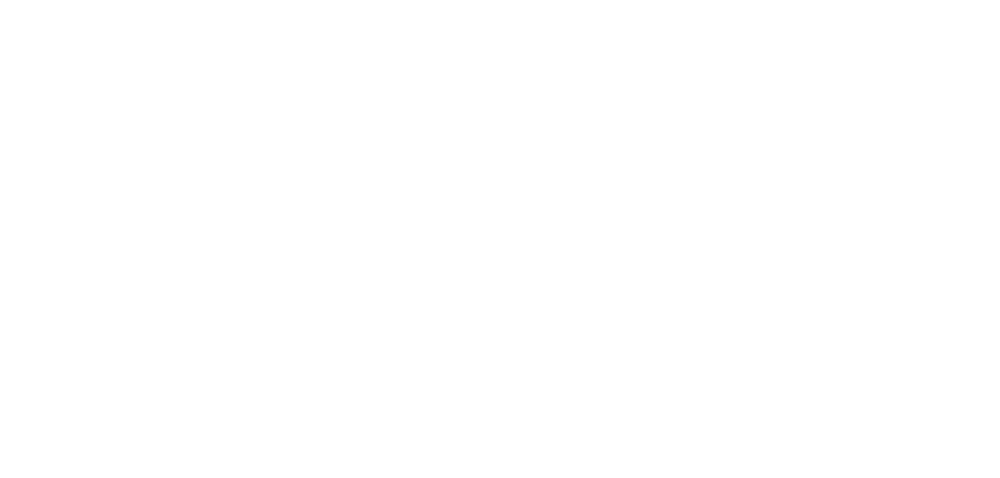

roi129_dff.png


<IPython.core.display.Javascript object>


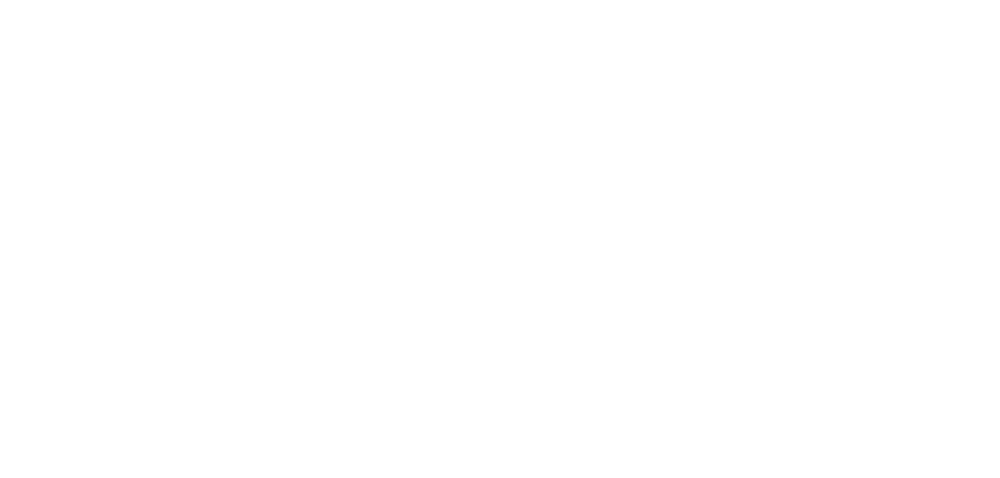

roi130_dff.png


<IPython.core.display.Javascript object>


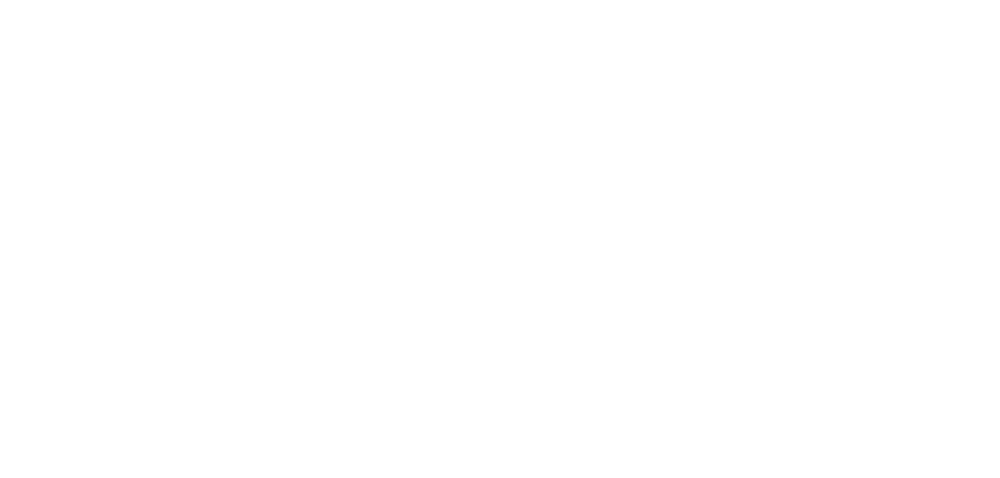

roi131_dff.png


<IPython.core.display.Javascript object>


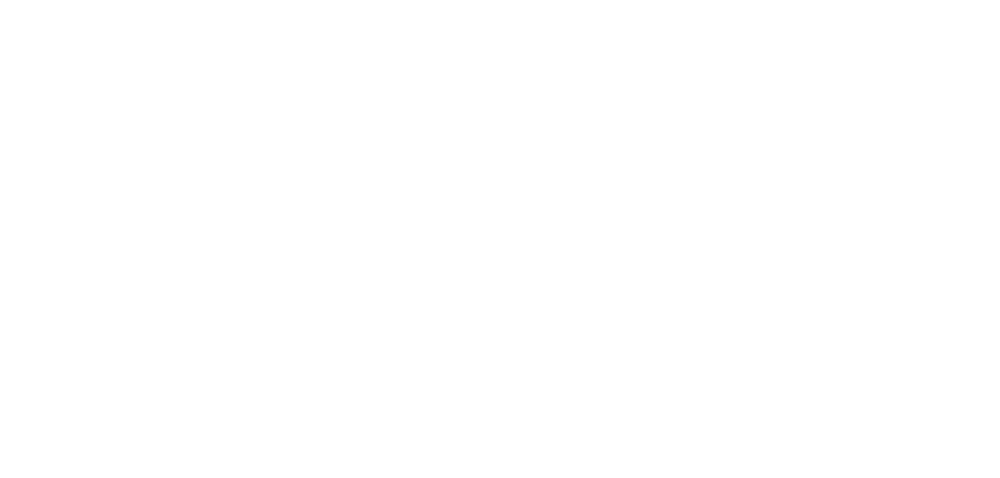

roi132_dff.png


<IPython.core.display.Javascript object>


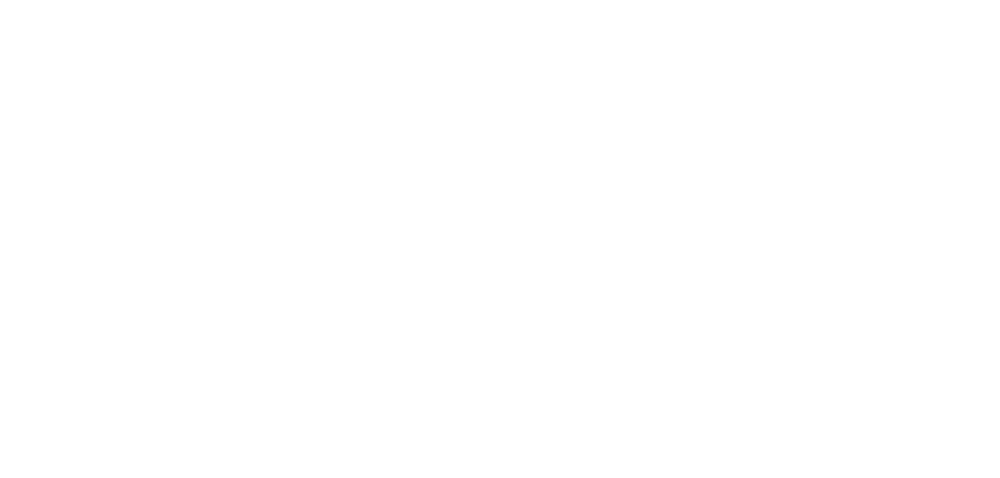

roi133_dff.png


<IPython.core.display.Javascript object>


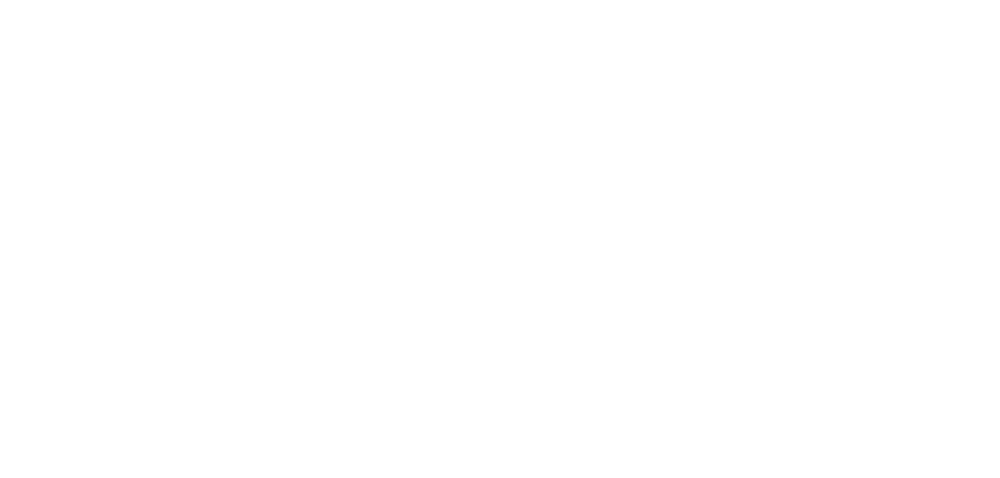

roi134_dff.png


<IPython.core.display.Javascript object>


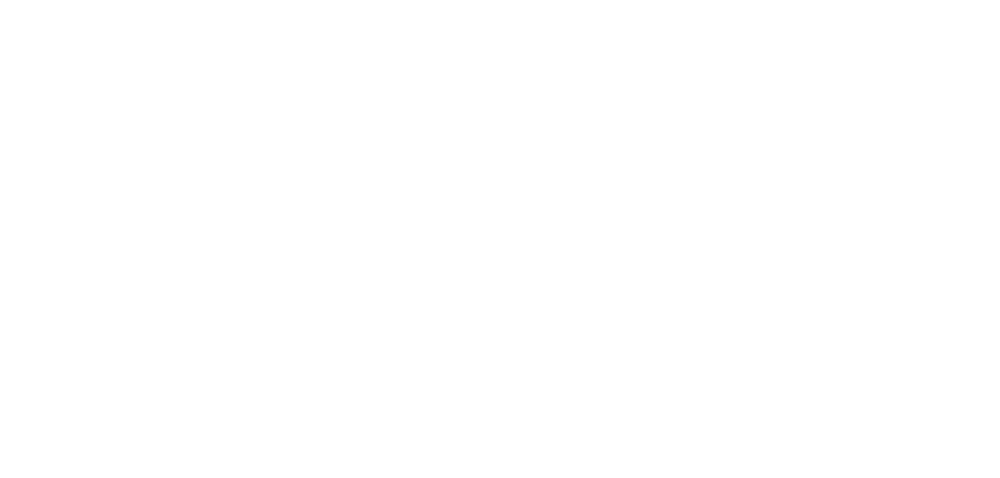

roi135_dff.png


<IPython.core.display.Javascript object>


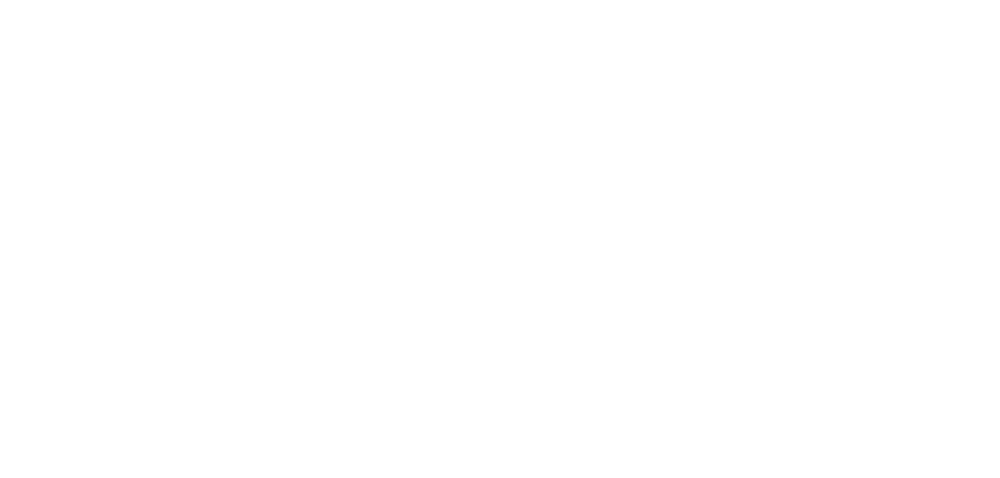

roi136_dff.png


<IPython.core.display.Javascript object>


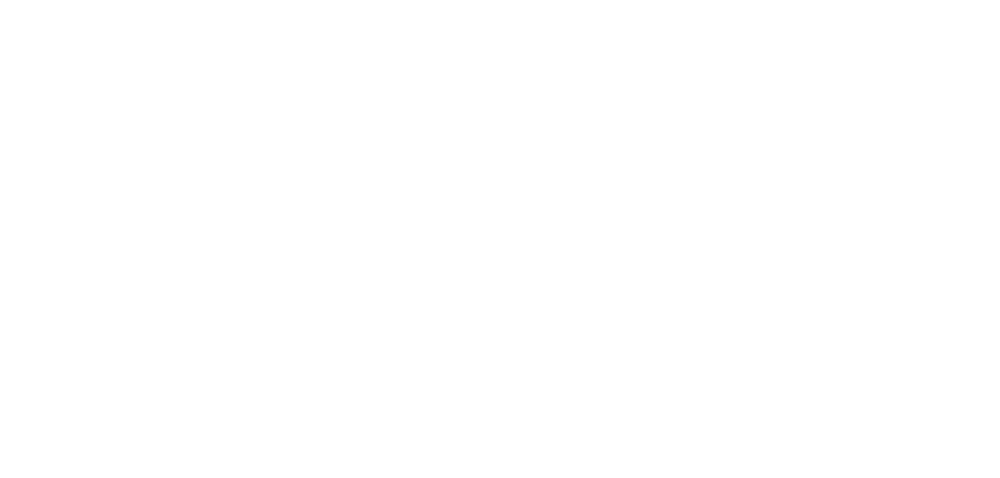

roi137_dff.png


<IPython.core.display.Javascript object>


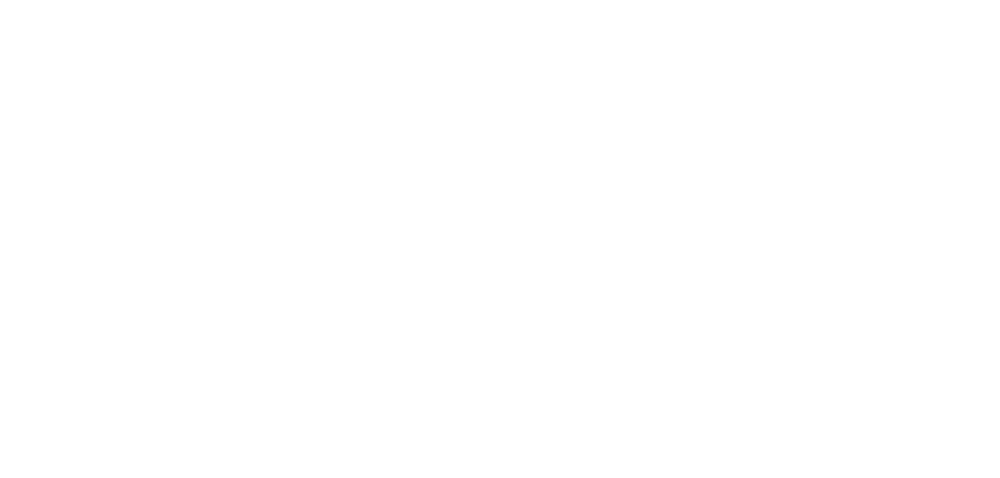

roi138_dff.png


<IPython.core.display.Javascript object>


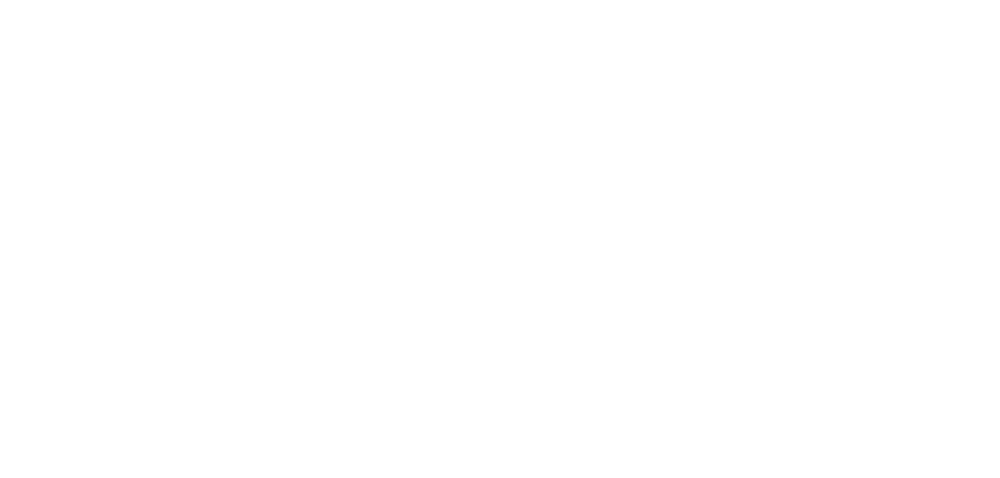

roi139_dff.png


<IPython.core.display.Javascript object>


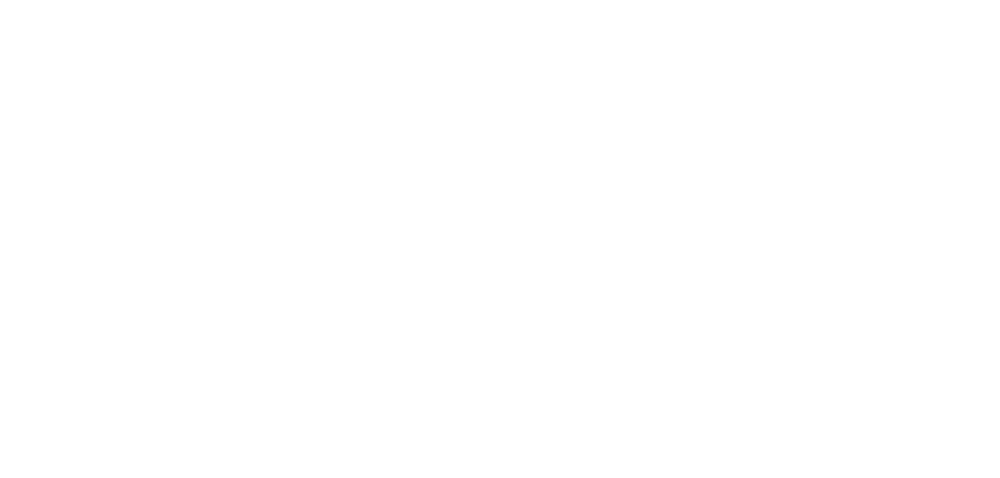

roi140_dff.png


<IPython.core.display.Javascript object>


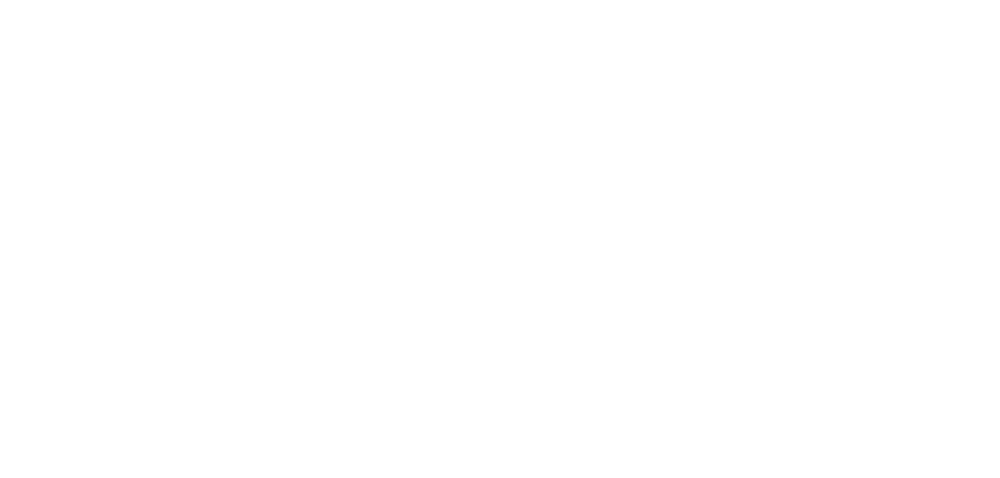

roi141_dff.png


<IPython.core.display.Javascript object>


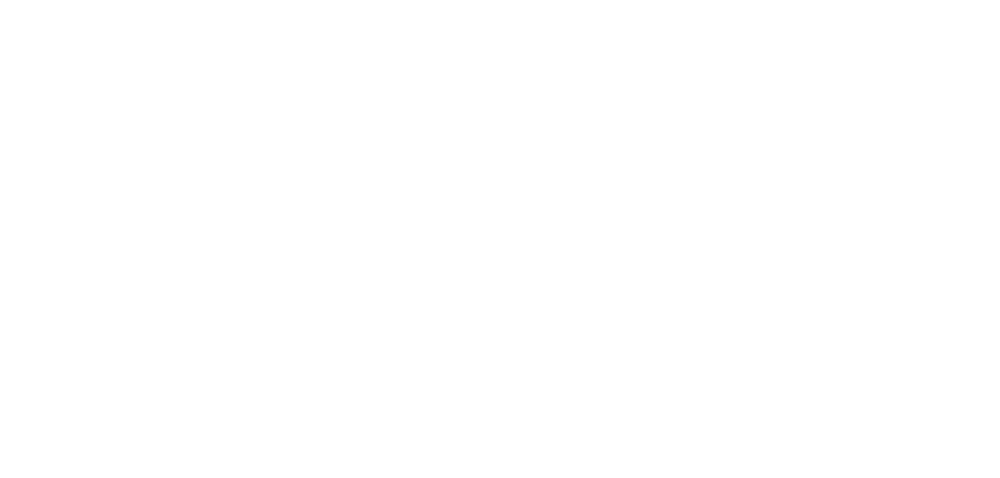

roi142_dff.png


<IPython.core.display.Javascript object>


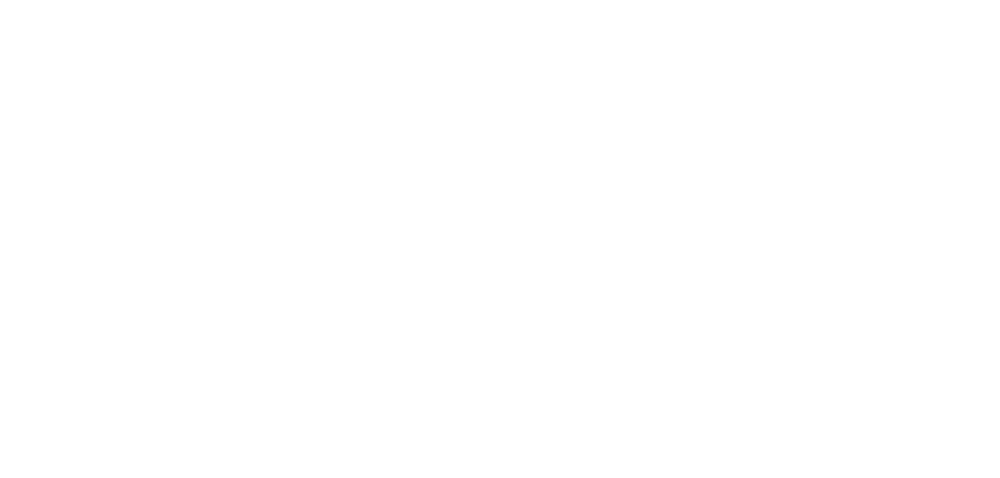

roi143_dff.png


<IPython.core.display.Javascript object>


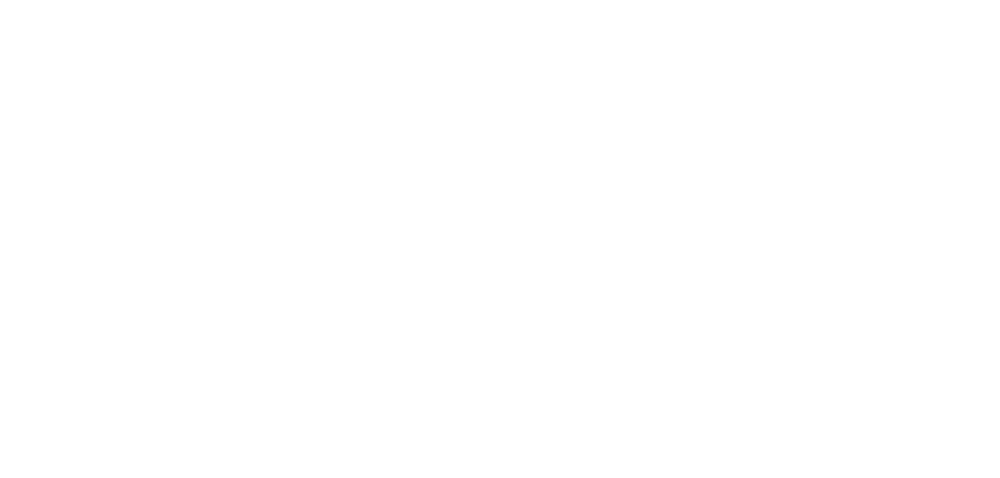

roi144_dff.png


<IPython.core.display.Javascript object>


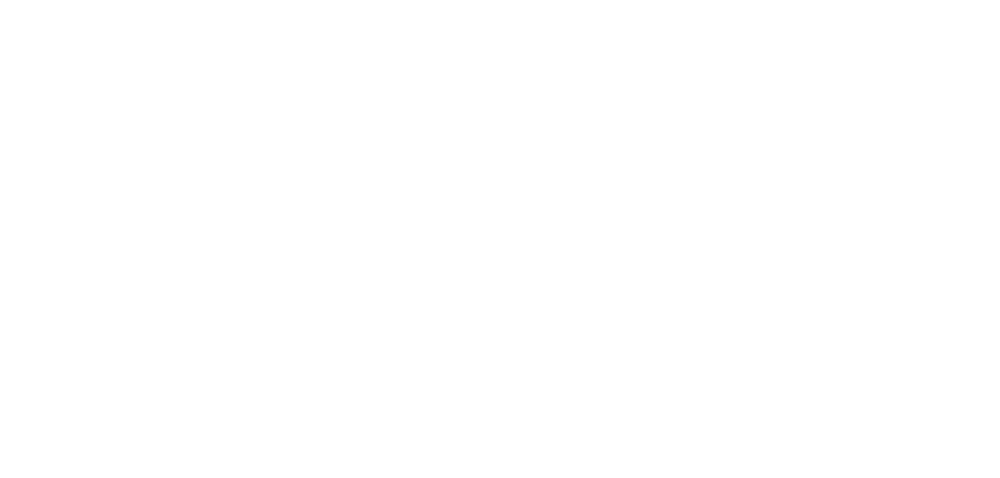

roi145_dff.png


<IPython.core.display.Javascript object>


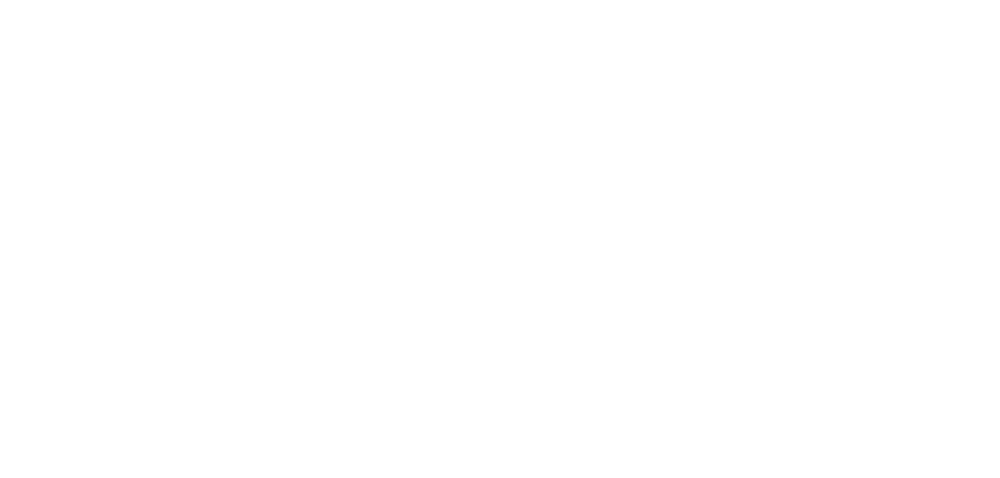

roi146_dff.png


<IPython.core.display.Javascript object>


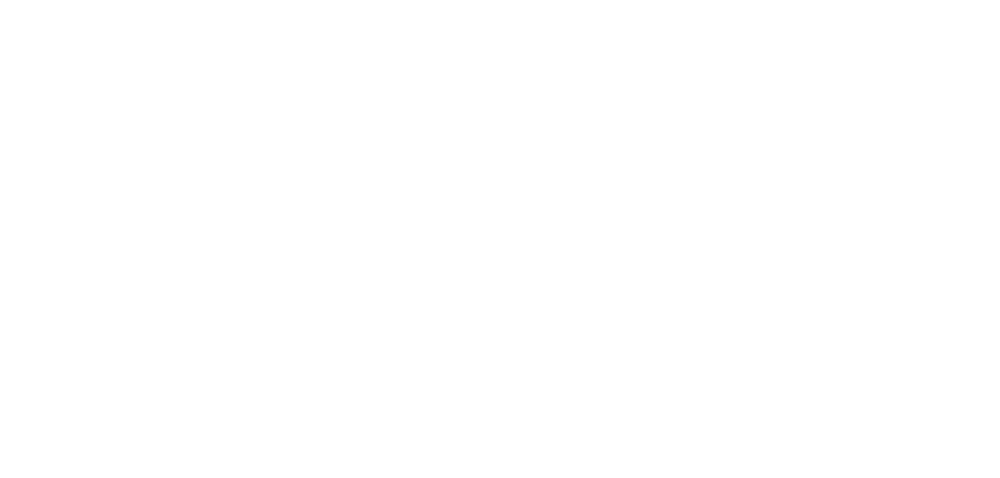

roi147_dff.png


<IPython.core.display.Javascript object>


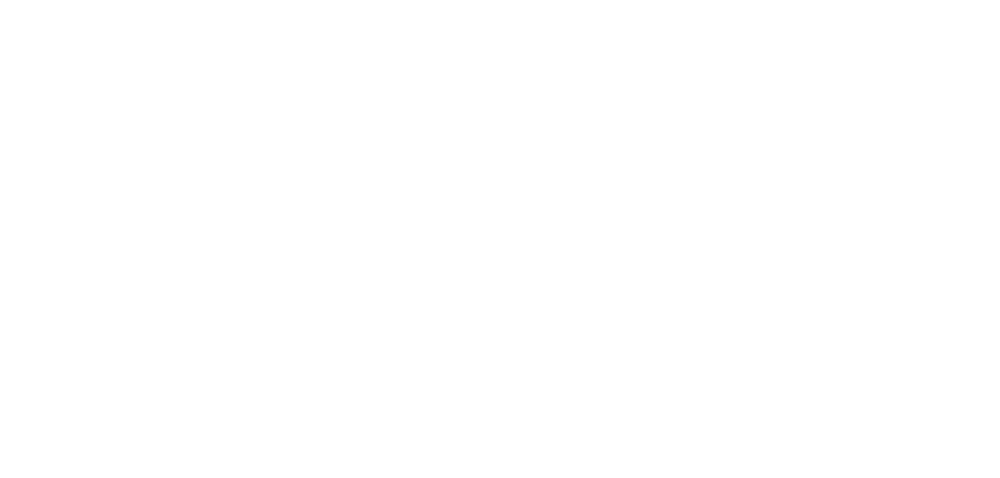

roi148_dff.png


<IPython.core.display.Javascript object>


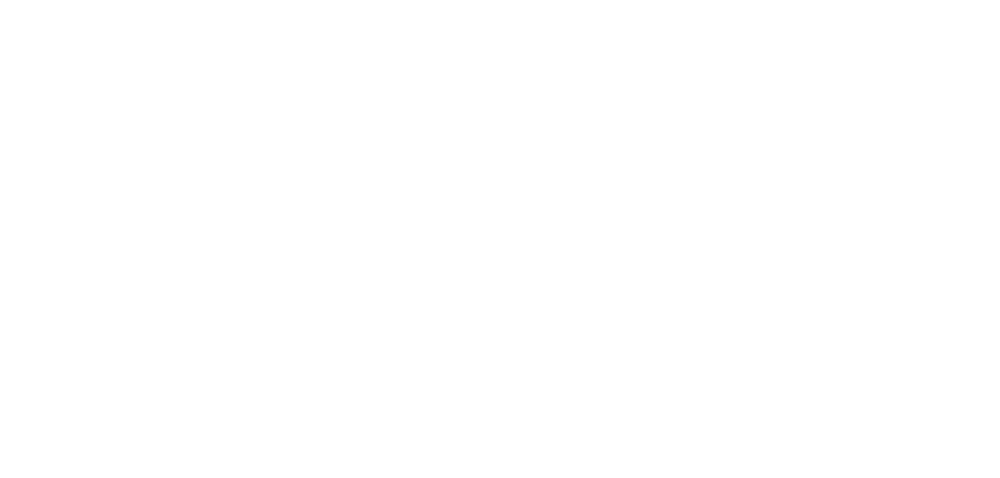

roi149_dff.png


<IPython.core.display.Javascript object>


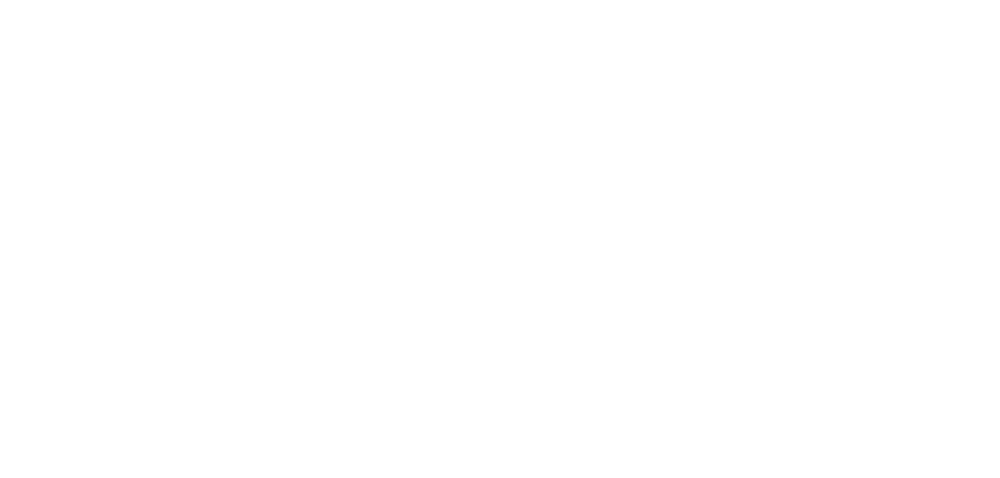

roi150_dff.png


<IPython.core.display.Javascript object>


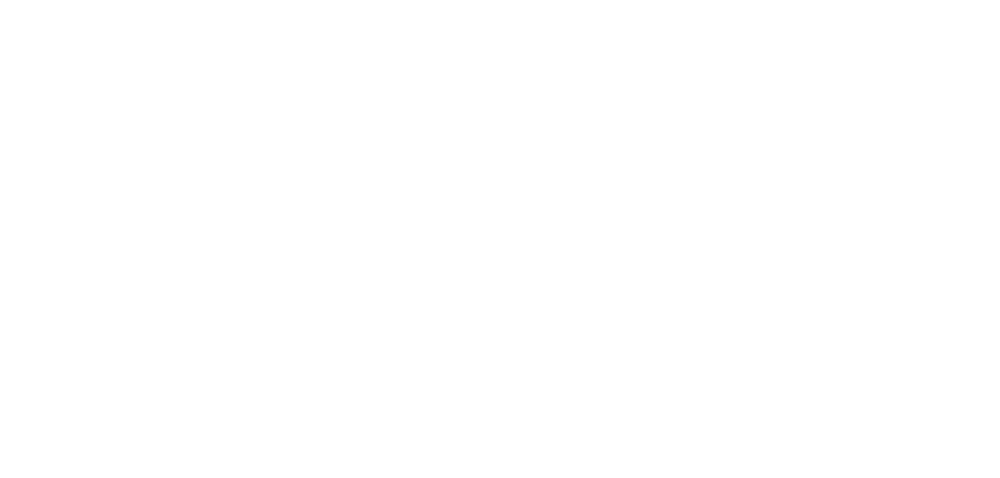

roi151_dff.png


<IPython.core.display.Javascript object>


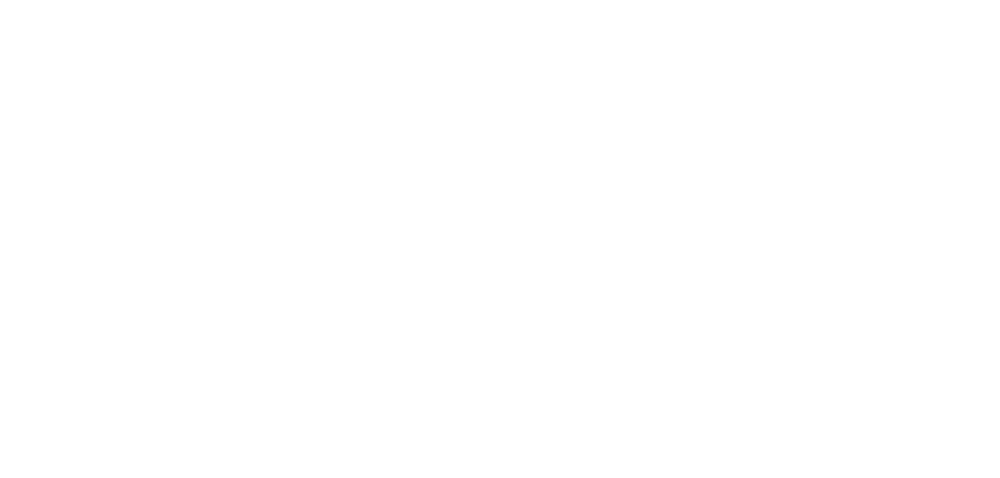

roi152_dff.png


<IPython.core.display.Javascript object>


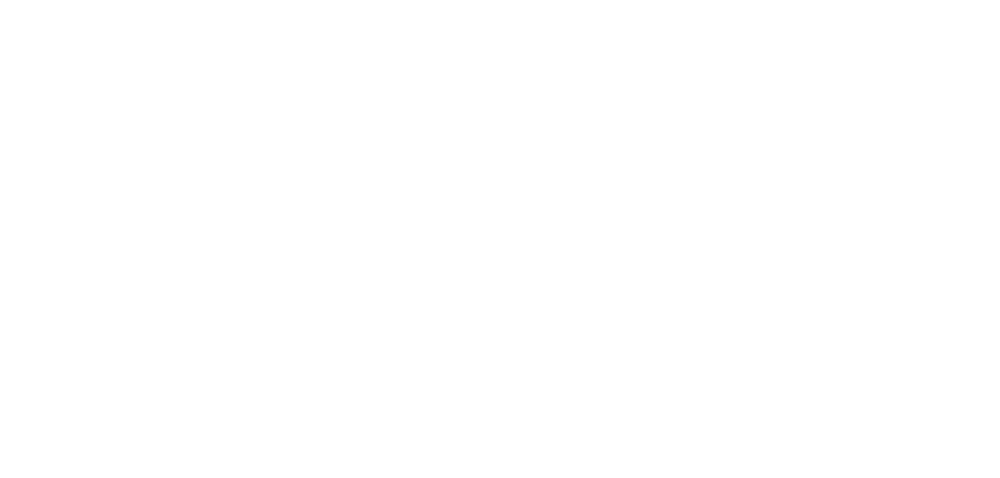

roi153_dff.png


<IPython.core.display.Javascript object>


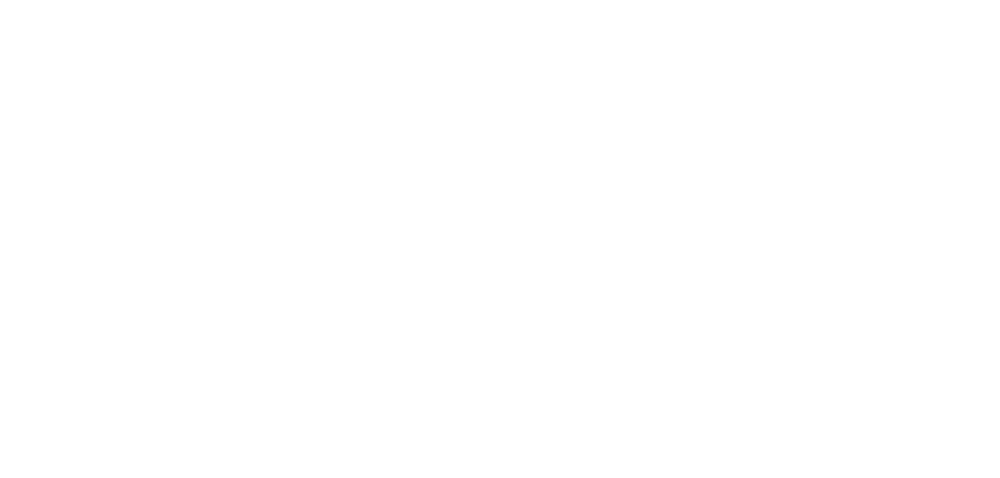

roi154_dff.png


<IPython.core.display.Javascript object>


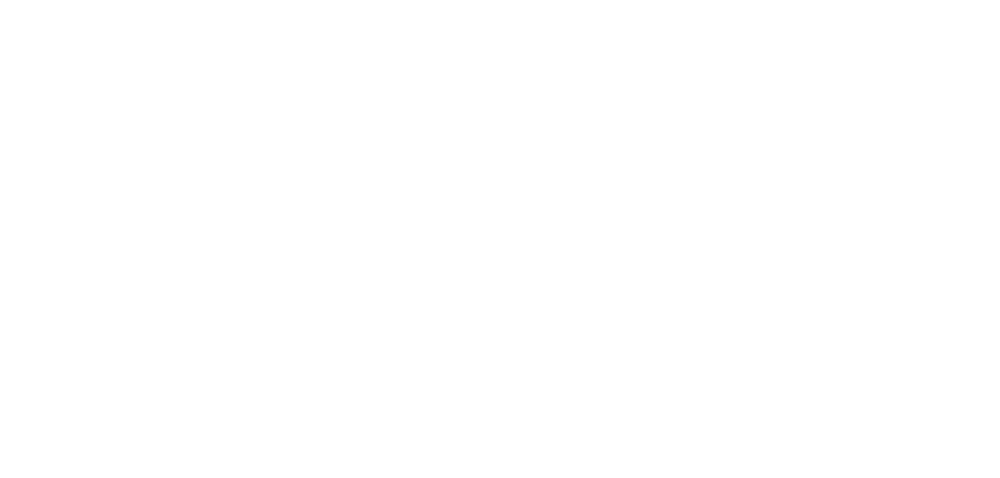

roi155_dff.png


<IPython.core.display.Javascript object>


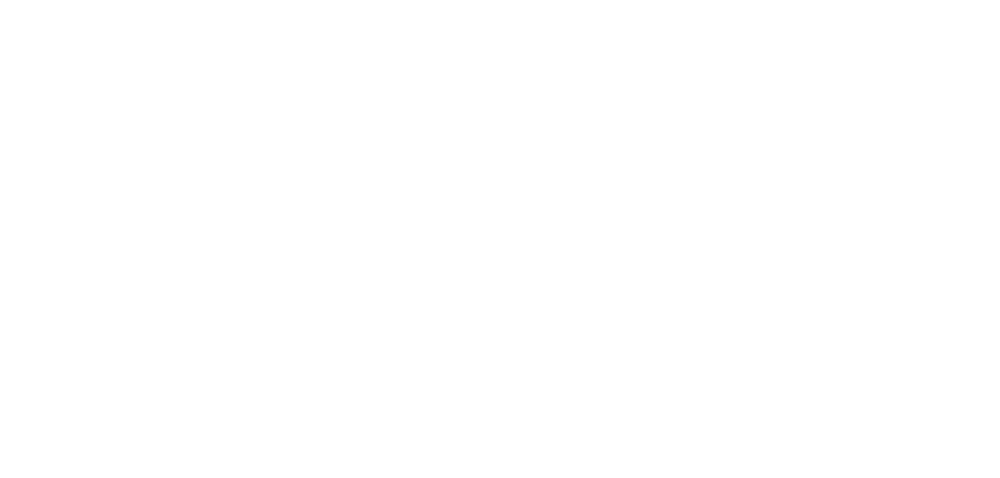

roi156_dff.png


<IPython.core.display.Javascript object>


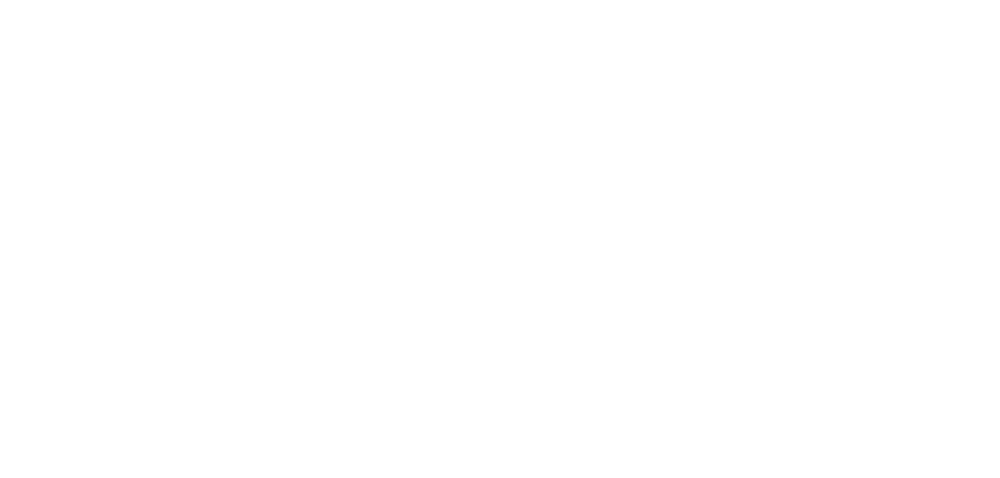

roi157_dff.png


<IPython.core.display.Javascript object>


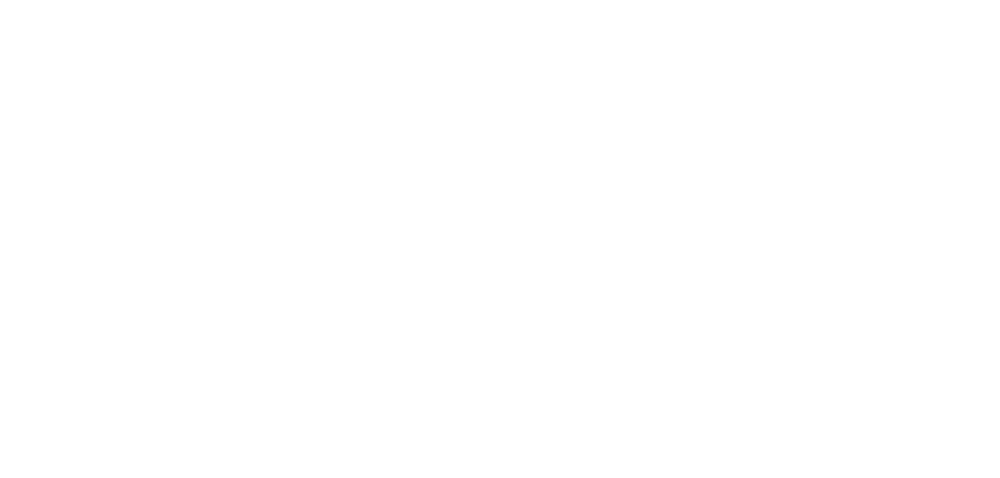

roi158_dff.png


<IPython.core.display.Javascript object>


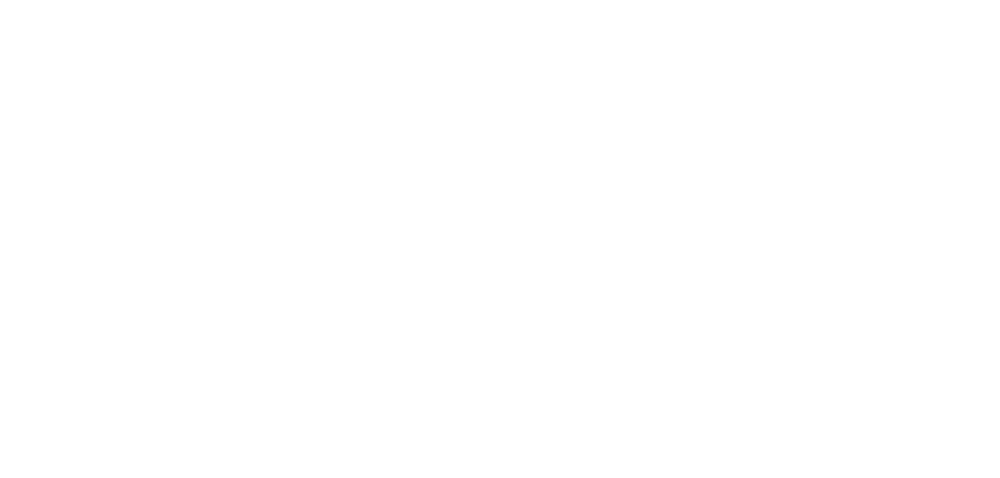

roi159_dff.png


<IPython.core.display.Javascript object>


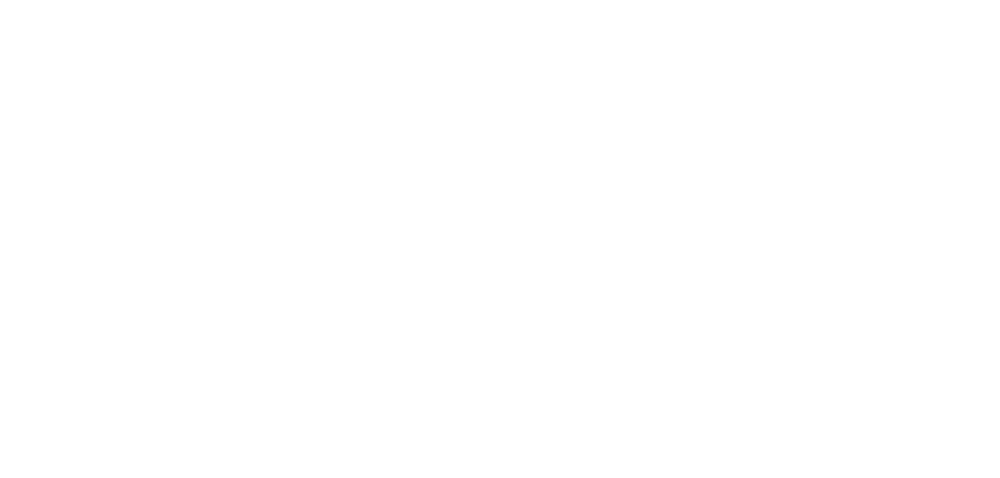

roi160_dff.png


<IPython.core.display.Javascript object>


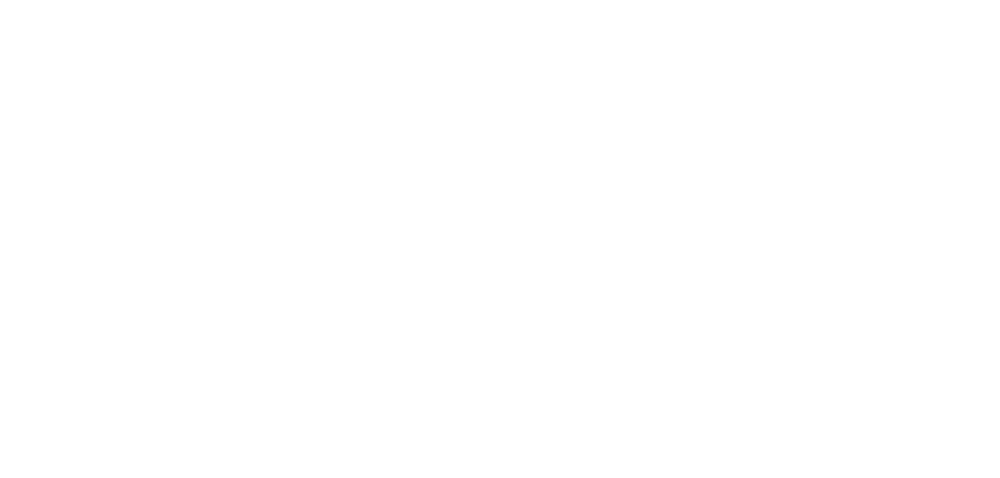

roi161_dff.png


<IPython.core.display.Javascript object>


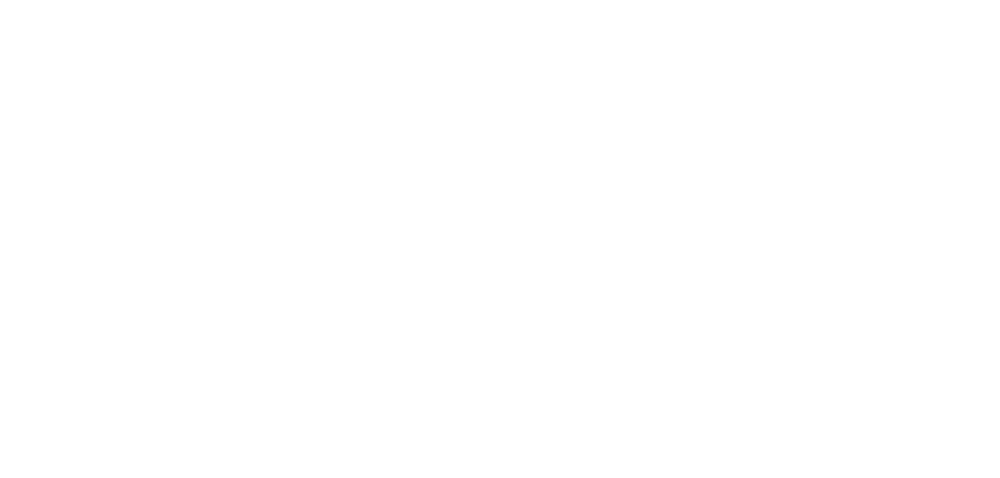

roi162_dff.png


<IPython.core.display.Javascript object>


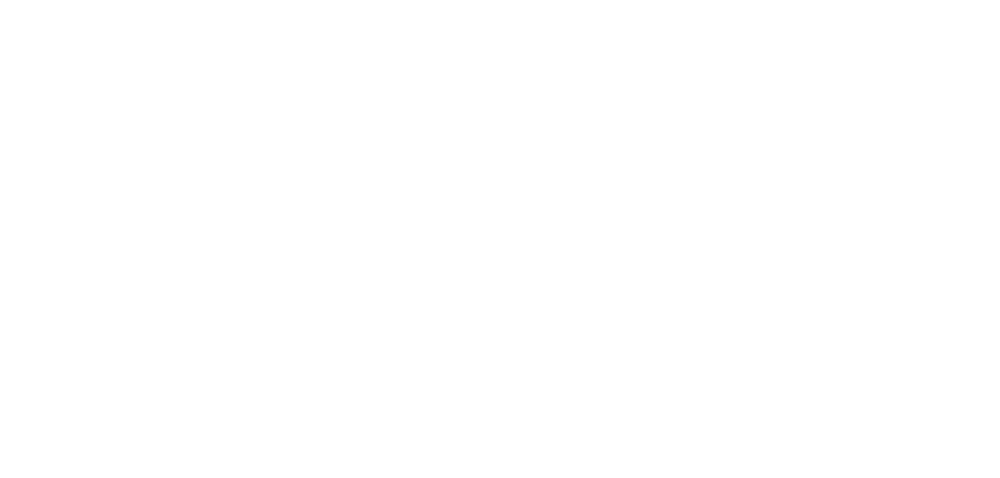

roi163_dff.png


<IPython.core.display.Javascript object>


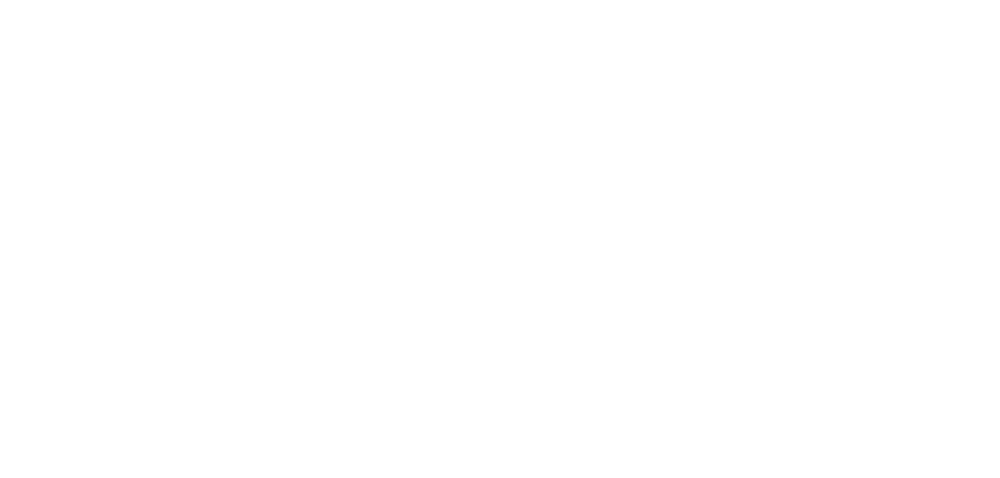

roi164_dff.png


<IPython.core.display.Javascript object>


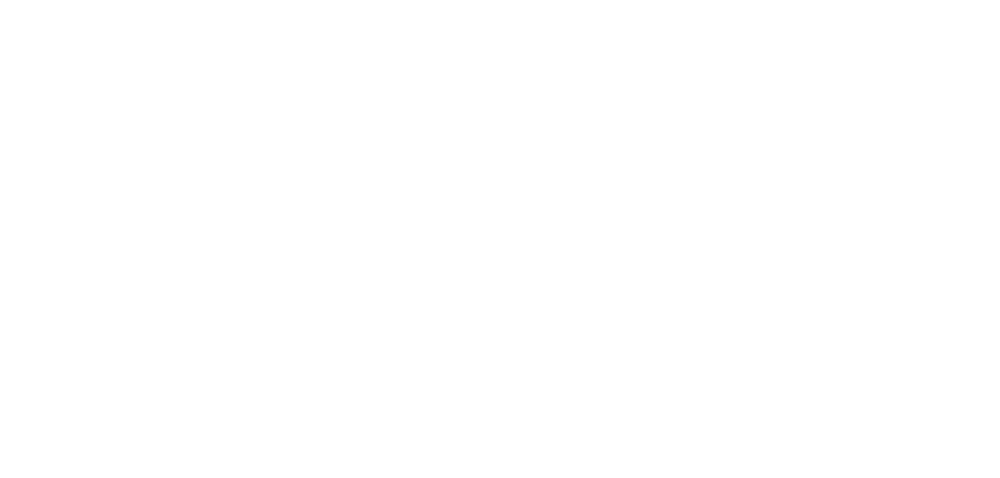

roi165_dff.png


<IPython.core.display.Javascript object>


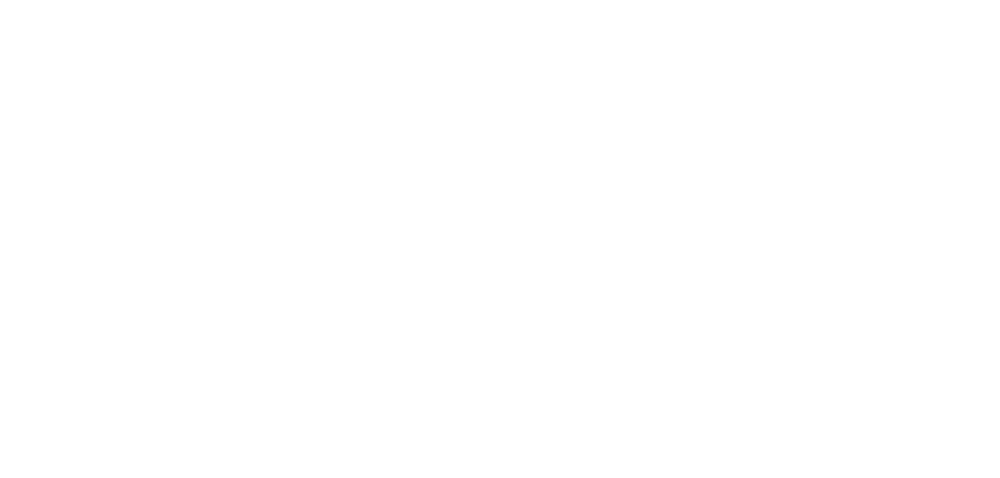

roi166_dff.png


<IPython.core.display.Javascript object>


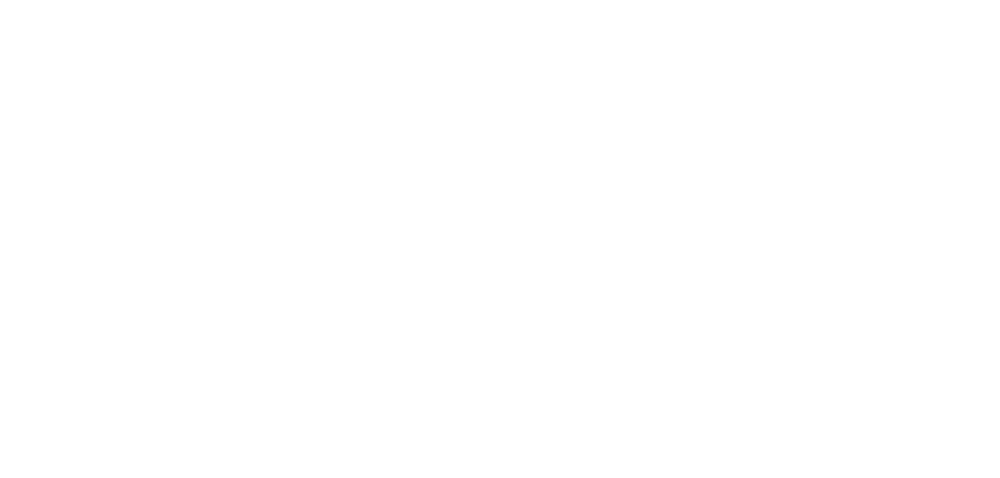

roi167_dff.png


<IPython.core.display.Javascript object>


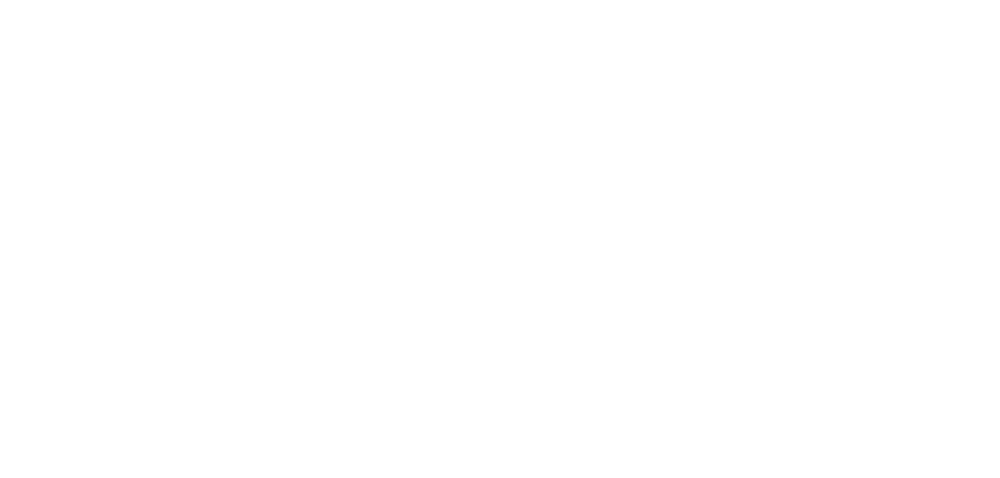

roi168_dff.png


<IPython.core.display.Javascript object>


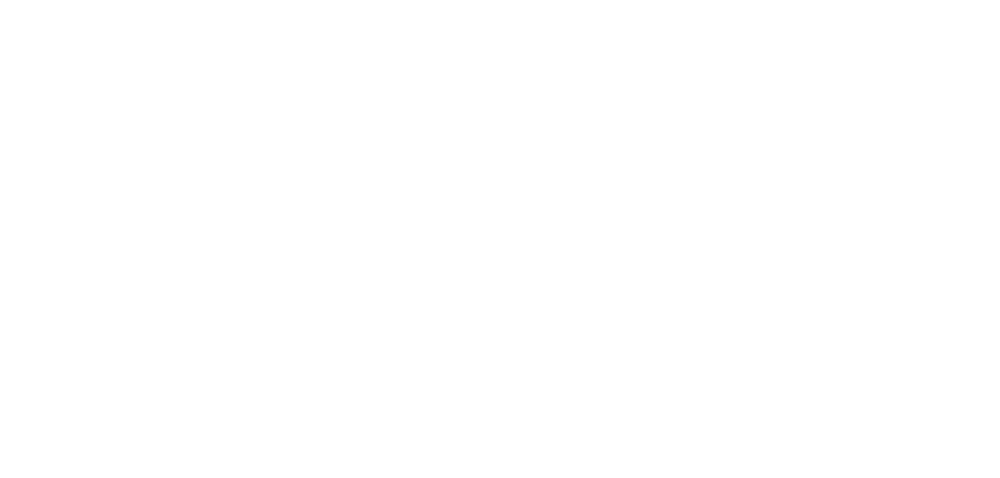

roi169_dff.png


<IPython.core.display.Javascript object>


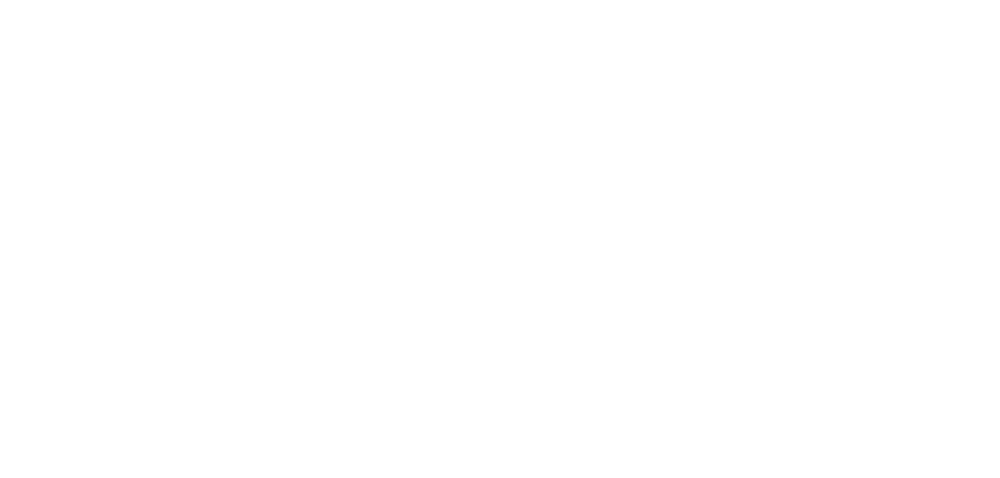

roi170_dff.png


<IPython.core.display.Javascript object>


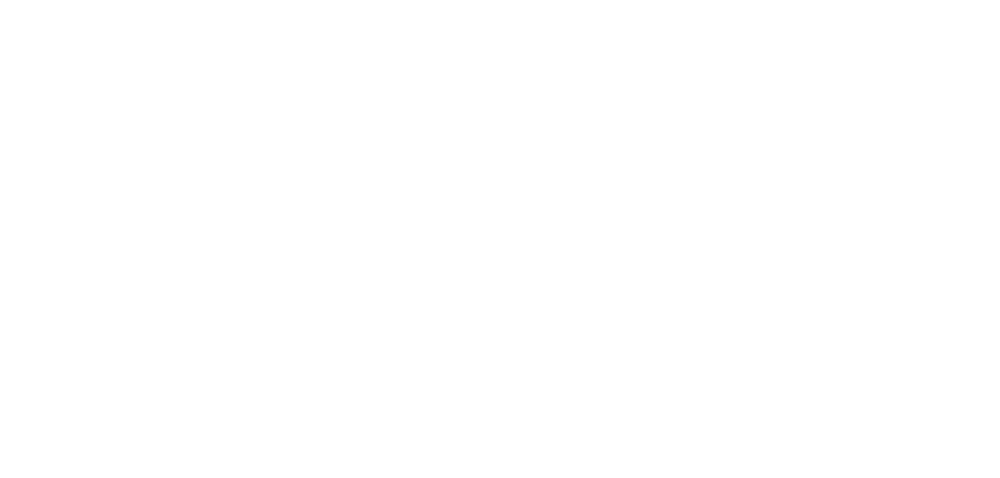

roi171_dff.png


<IPython.core.display.Javascript object>


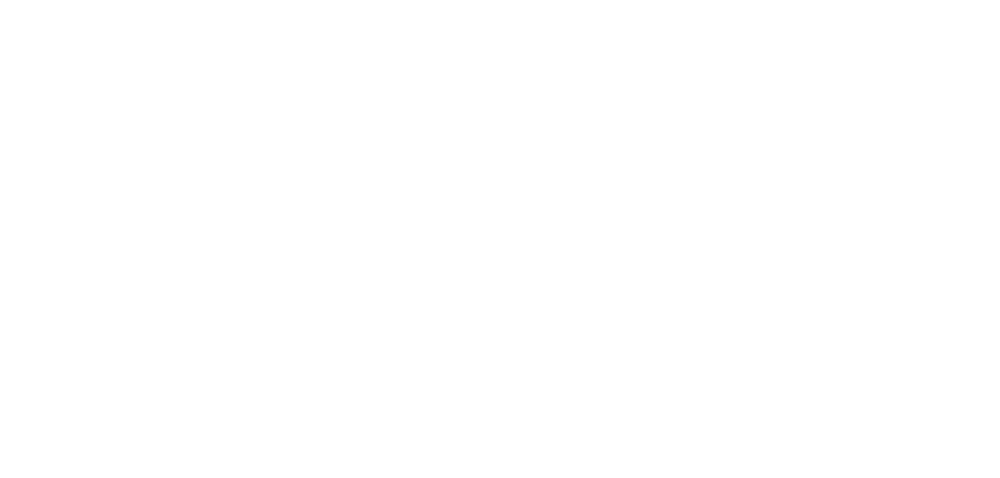

roi172_dff.png


<IPython.core.display.Javascript object>


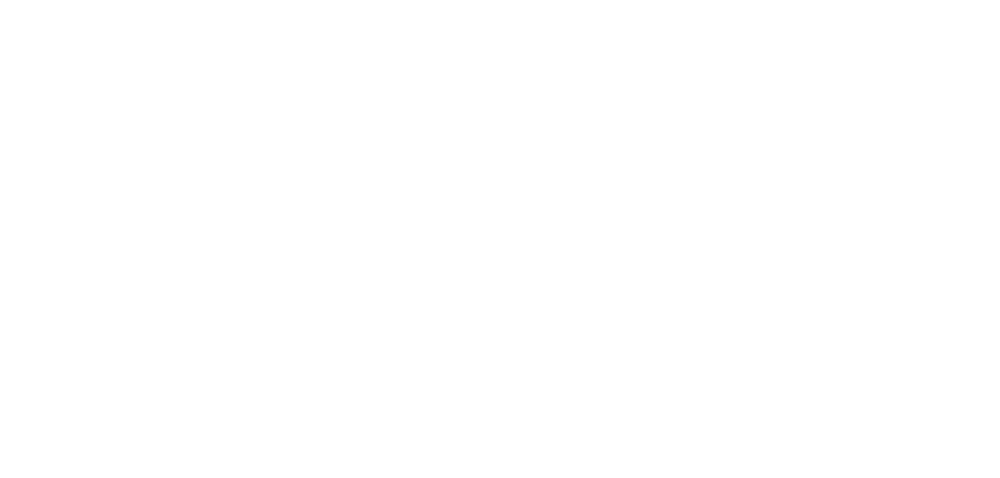

roi173_dff.png


<IPython.core.display.Javascript object>


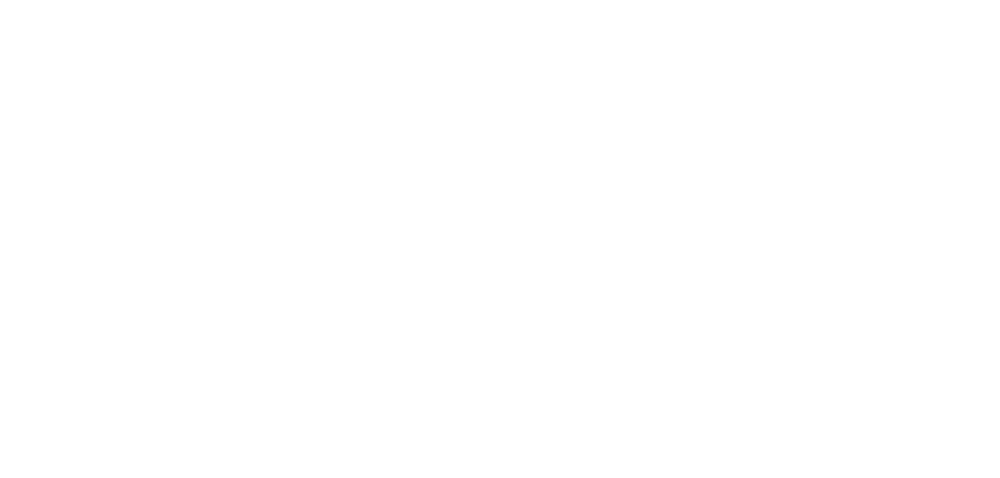

roi174_dff.png


<IPython.core.display.Javascript object>


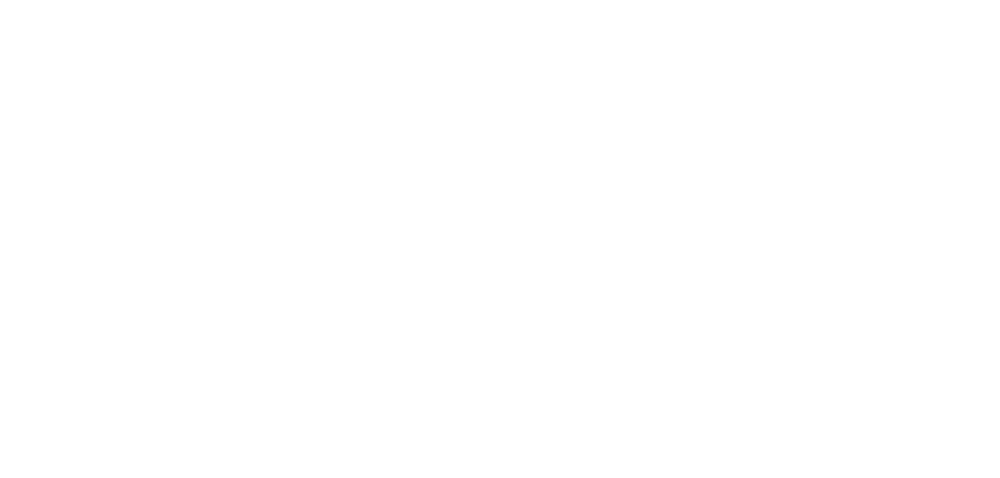

roi175_dff.png


<IPython.core.display.Javascript object>


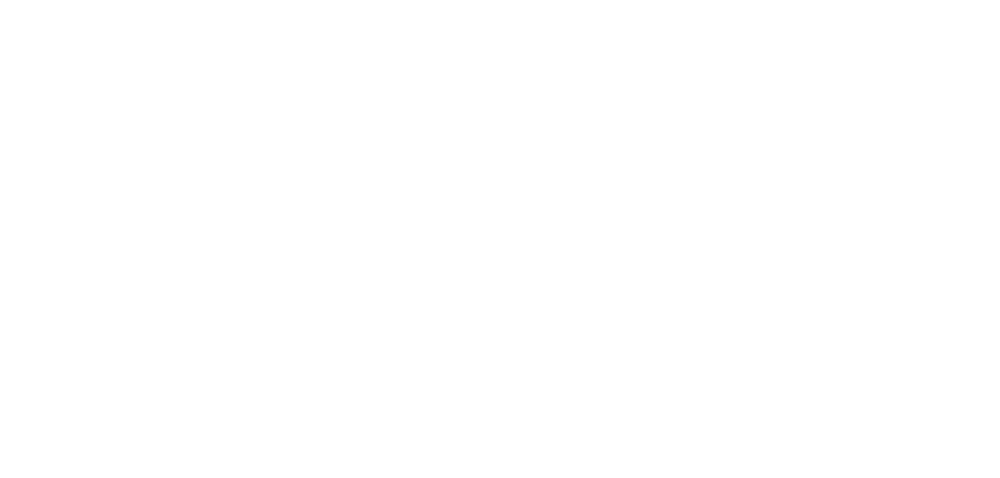

roi176_dff.png


<IPython.core.display.Javascript object>


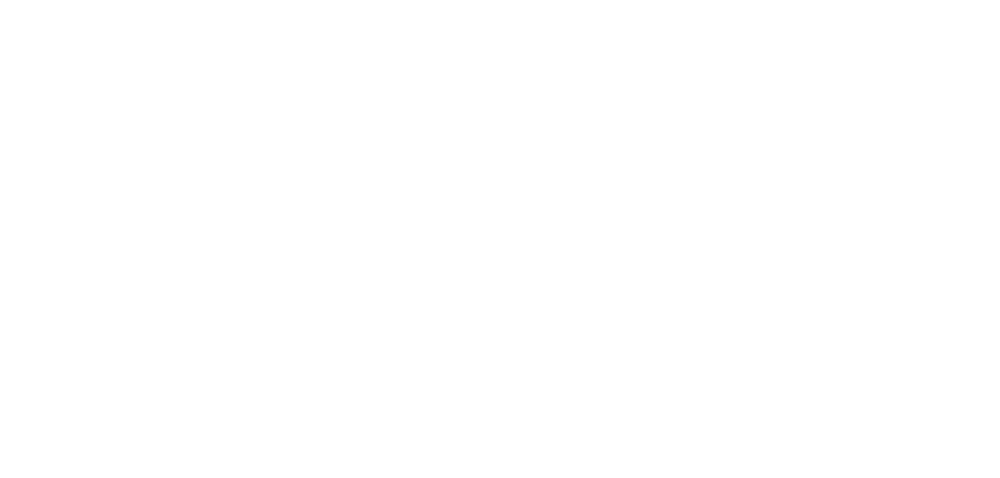

roi177_dff.png


<IPython.core.display.Javascript object>


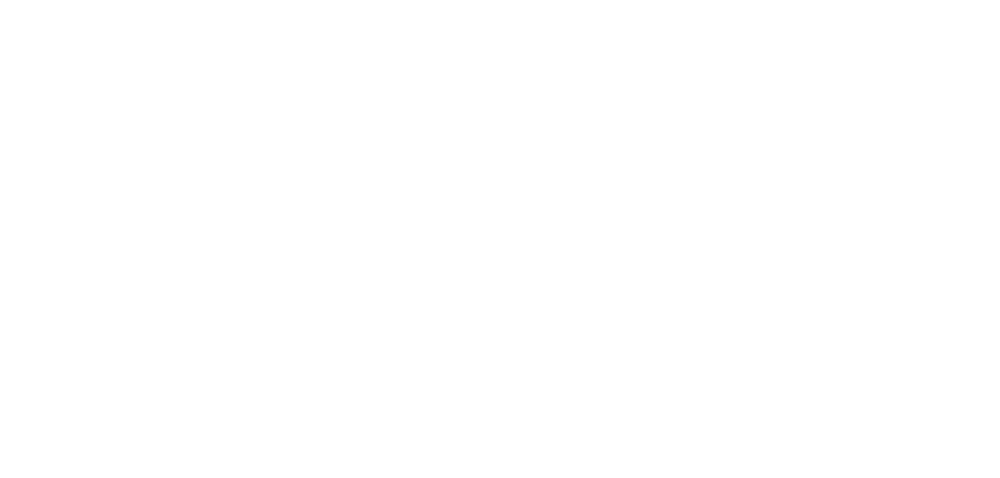

roi178_dff.png


<IPython.core.display.Javascript object>


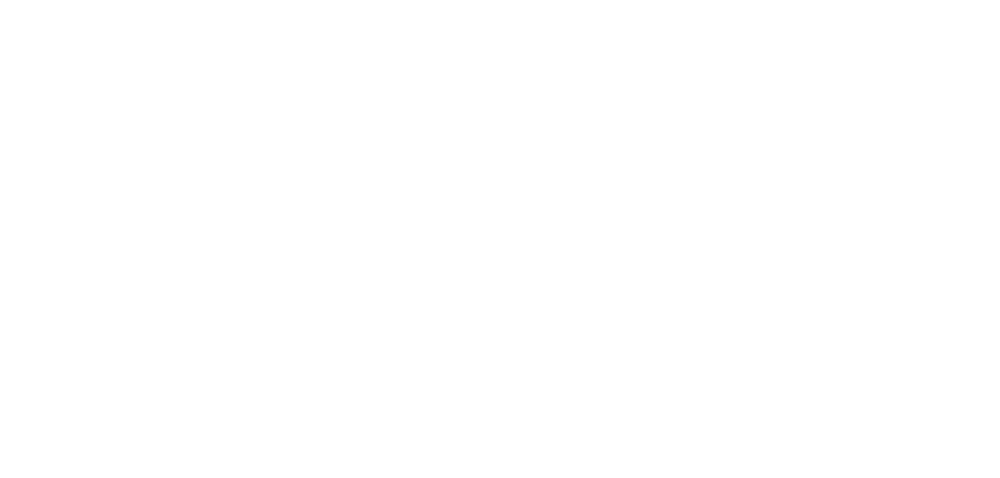

roi179_dff.png


<IPython.core.display.Javascript object>


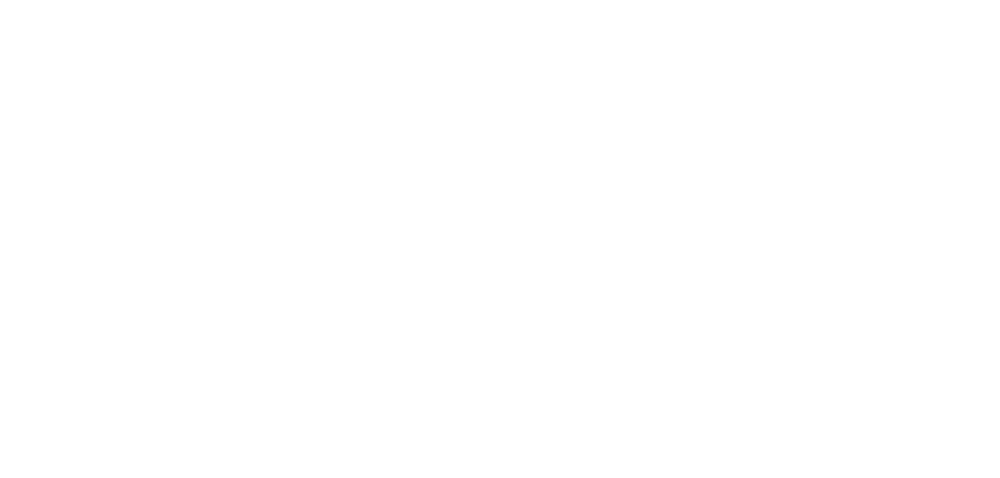

roi180_dff.png


<IPython.core.display.Javascript object>


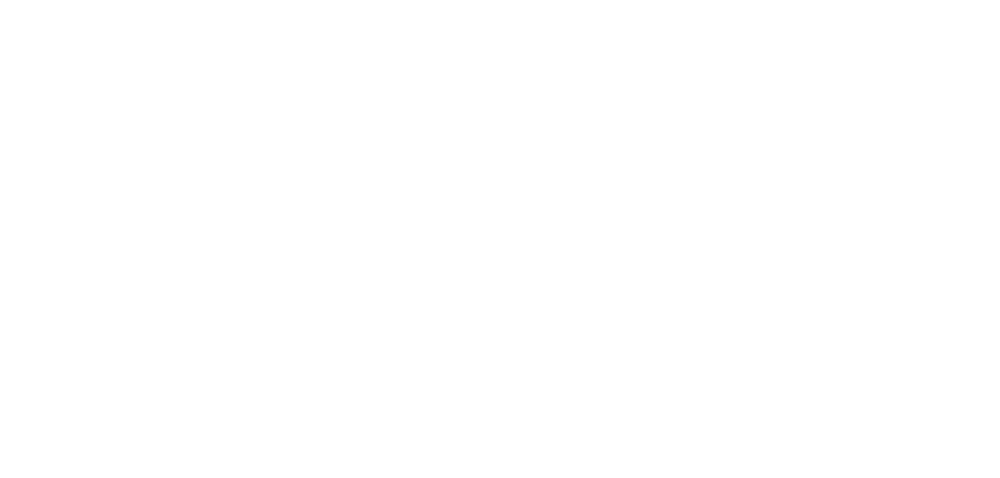

roi181_dff.png


<IPython.core.display.Javascript object>


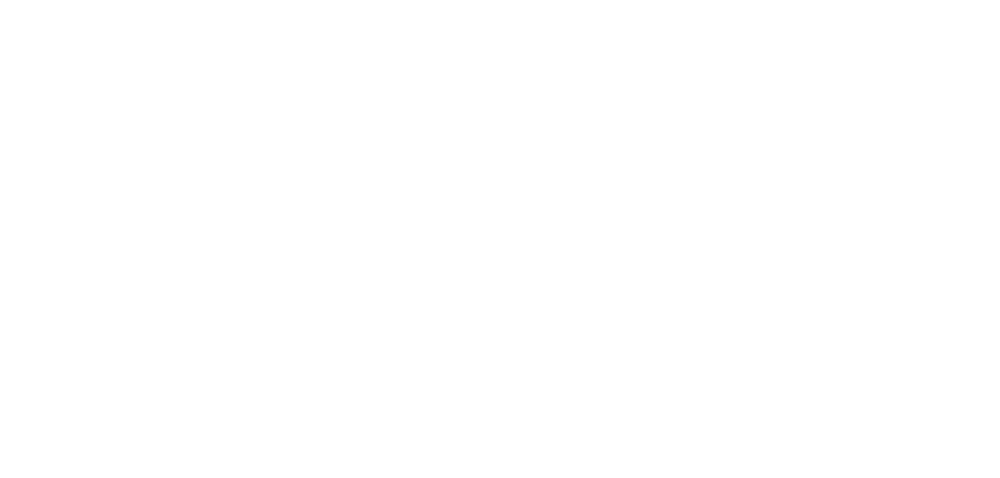

roi182_dff.png


<IPython.core.display.Javascript object>


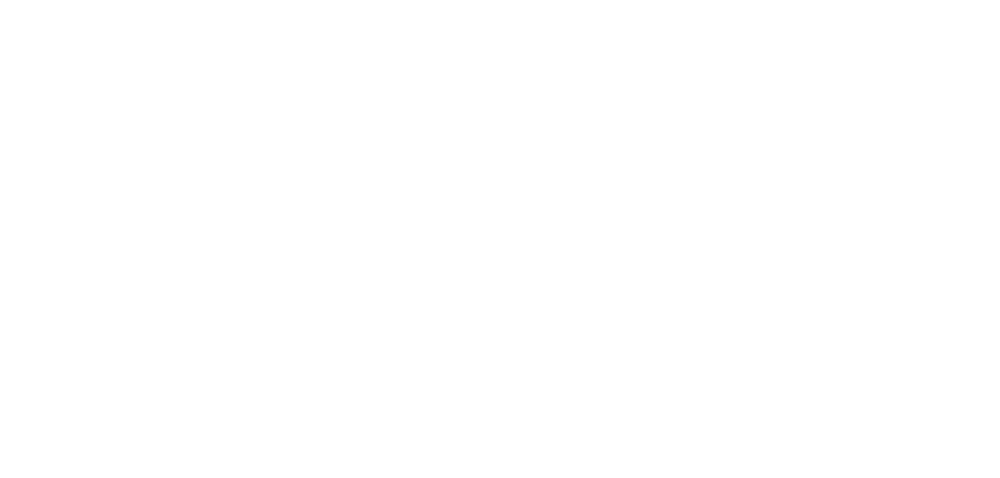

roi183_dff.png


<IPython.core.display.Javascript object>


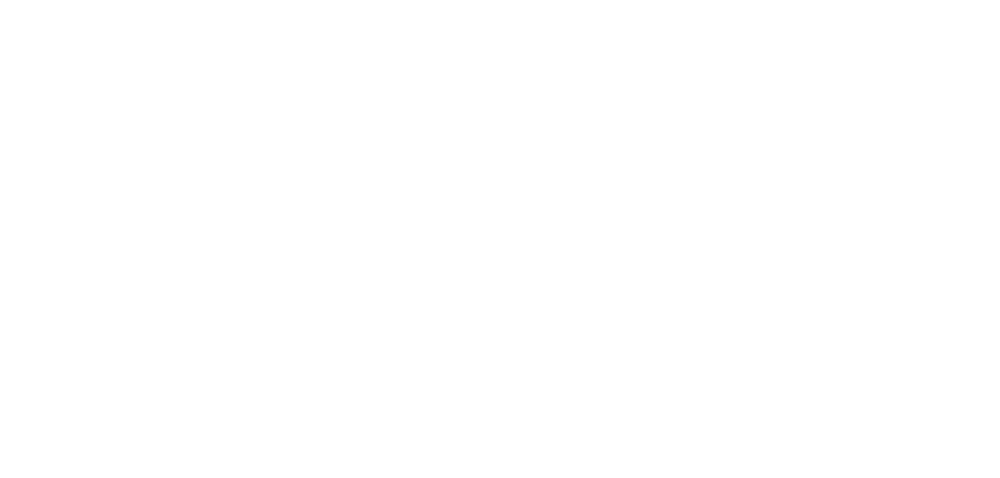

roi184_dff.png


<IPython.core.display.Javascript object>


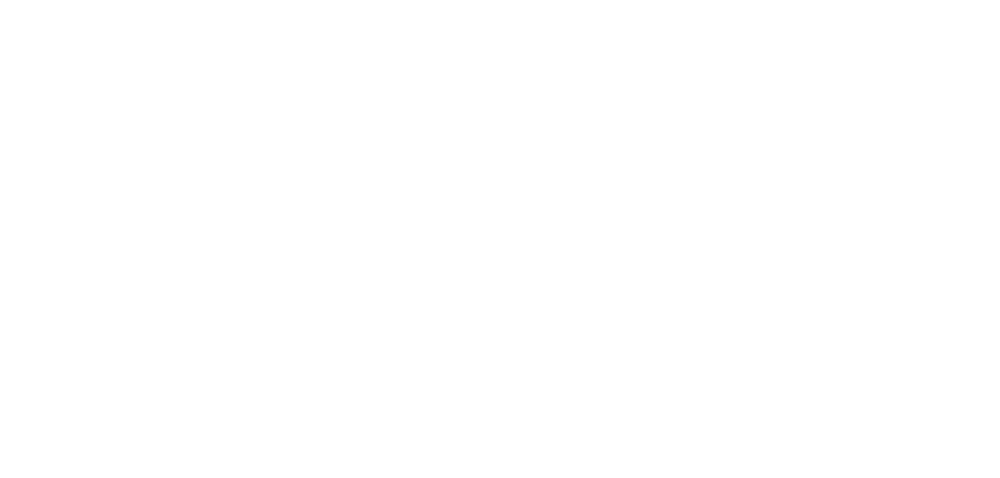

roi185_dff.png


<IPython.core.display.Javascript object>


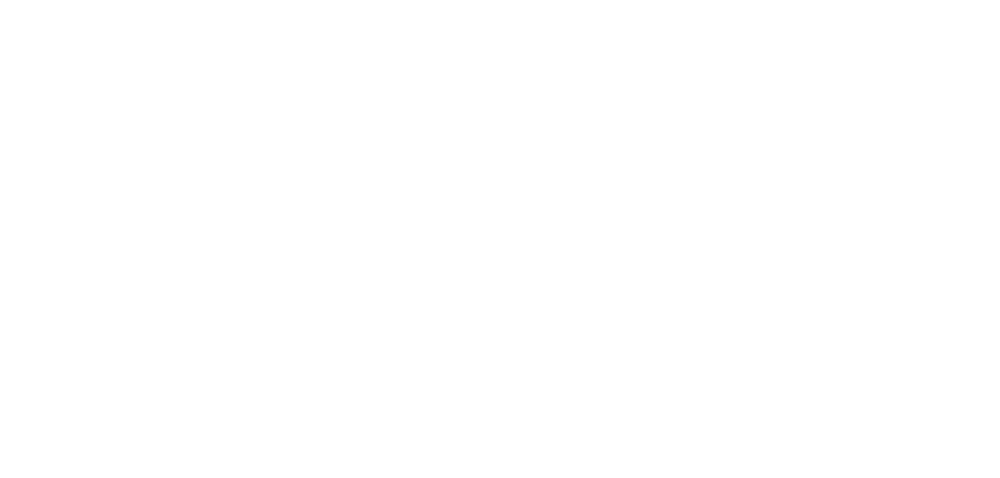

roi186_dff.png


<IPython.core.display.Javascript object>


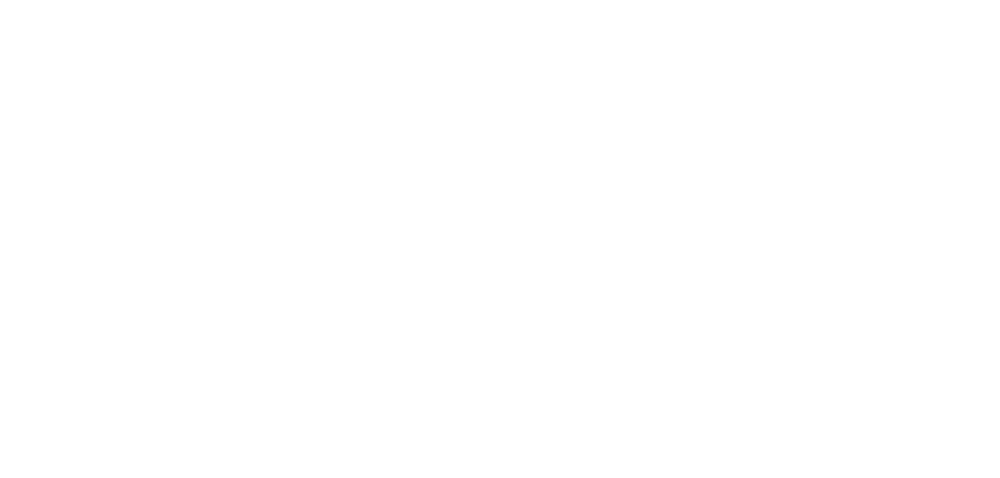

roi187_dff.png


<IPython.core.display.Javascript object>


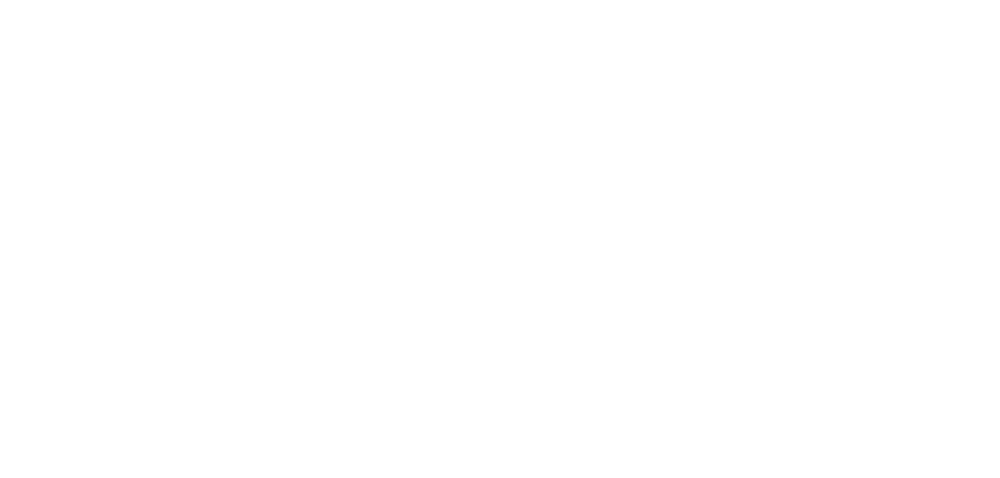

roi188_dff.png


<IPython.core.display.Javascript object>


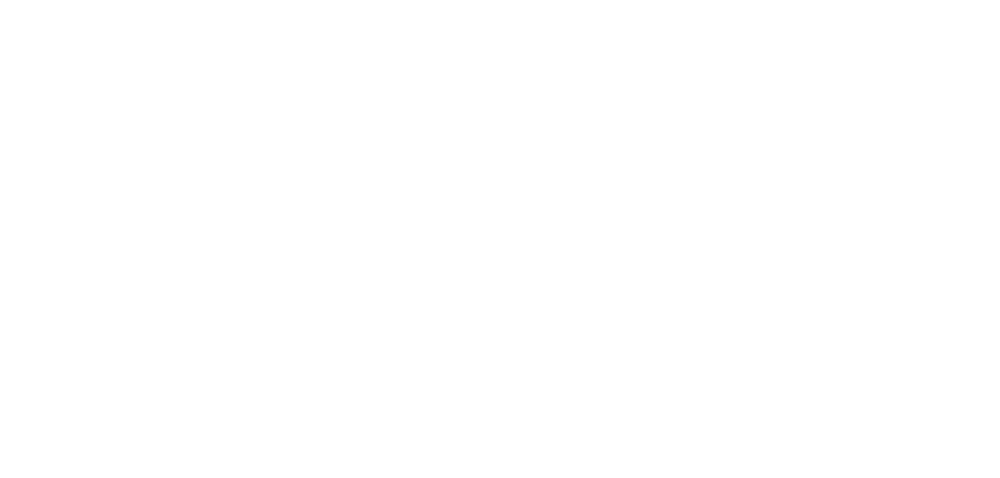

roi189_dff.png


<IPython.core.display.Javascript object>


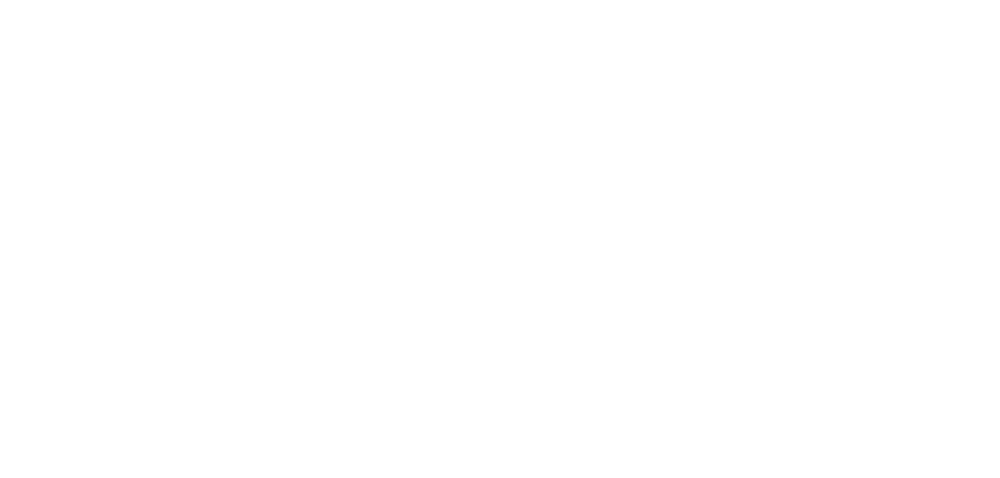

roi190_dff.png


<IPython.core.display.Javascript object>


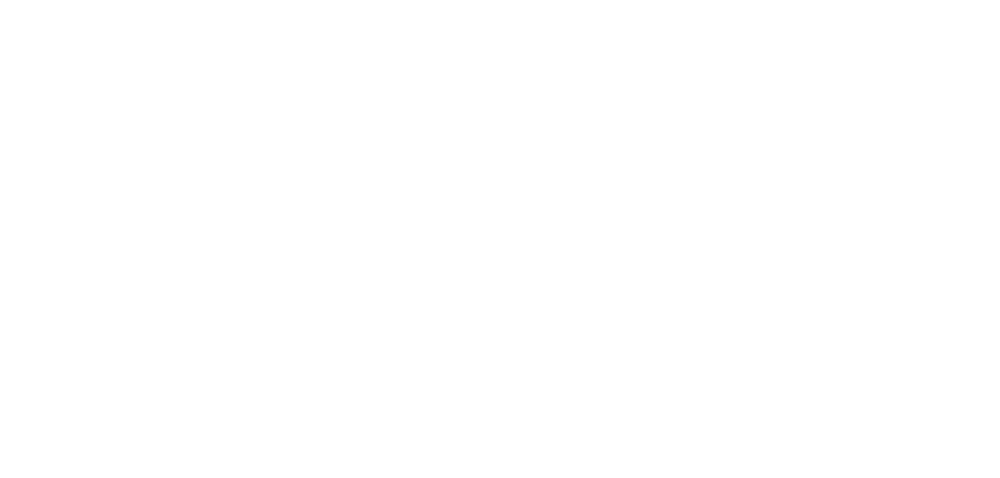

roi191_dff.png


<IPython.core.display.Javascript object>


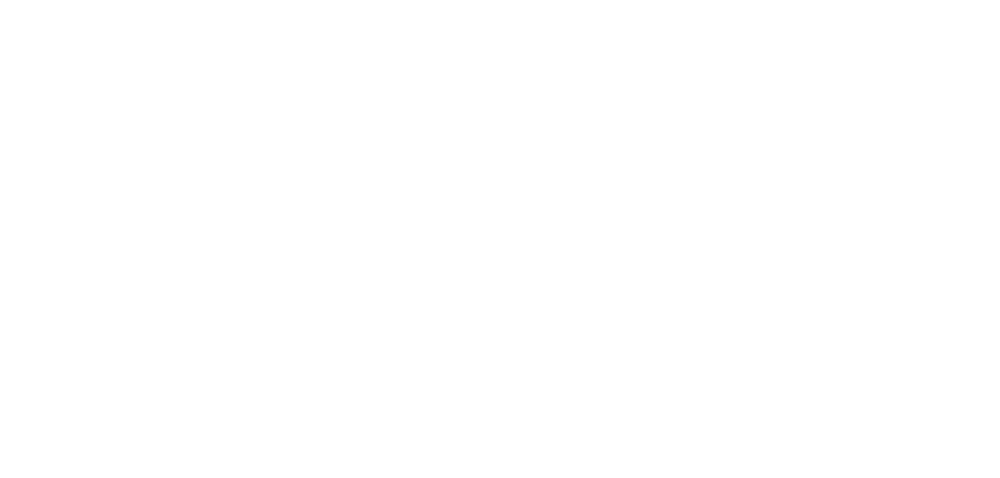

roi192_dff.png


<IPython.core.display.Javascript object>


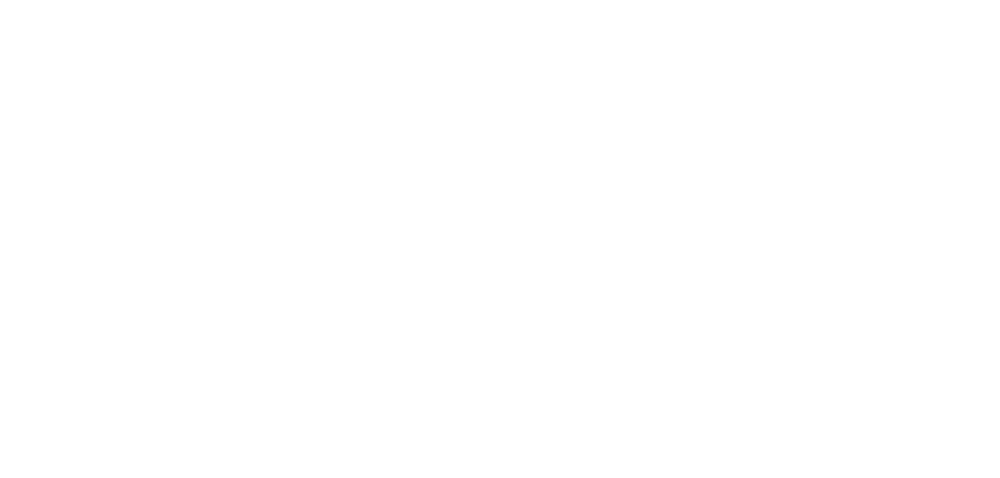

roi193_dff.png


<IPython.core.display.Javascript object>


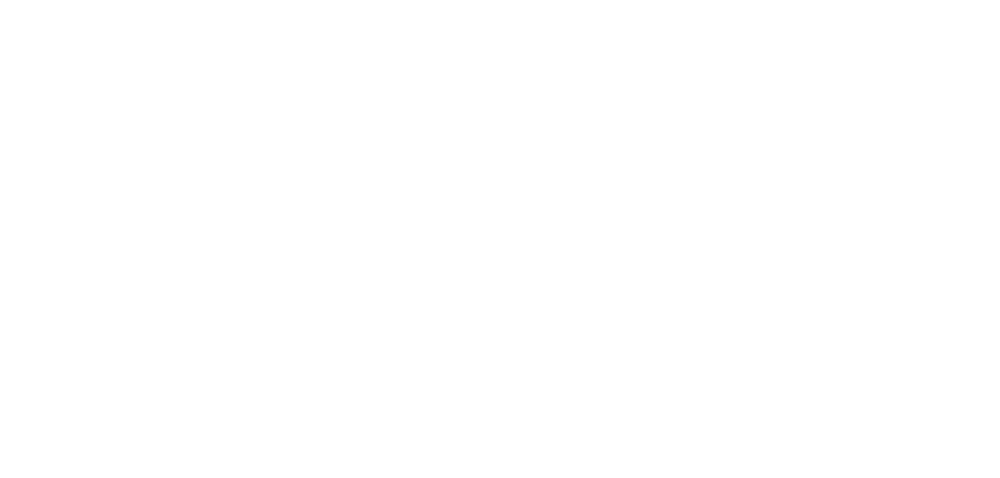

roi194_dff.png


<IPython.core.display.Javascript object>


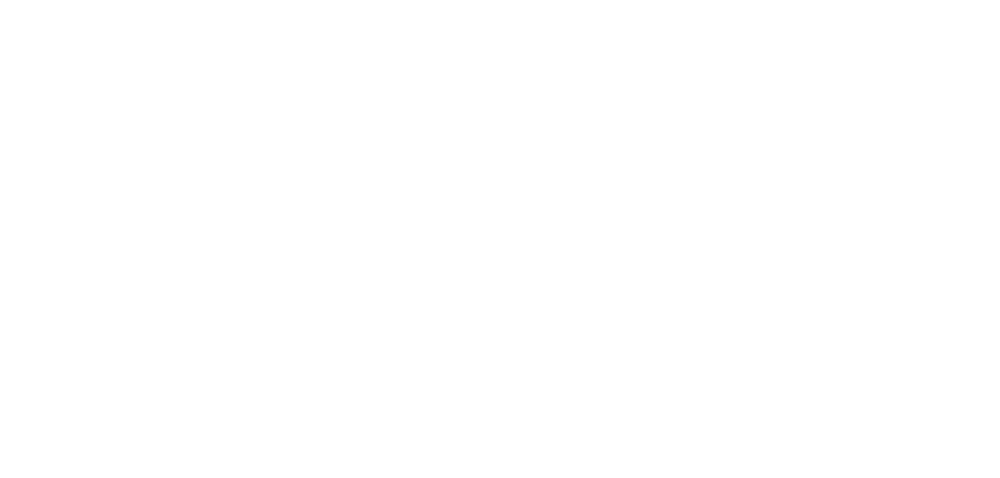

roi195_dff.png


<IPython.core.display.Javascript object>


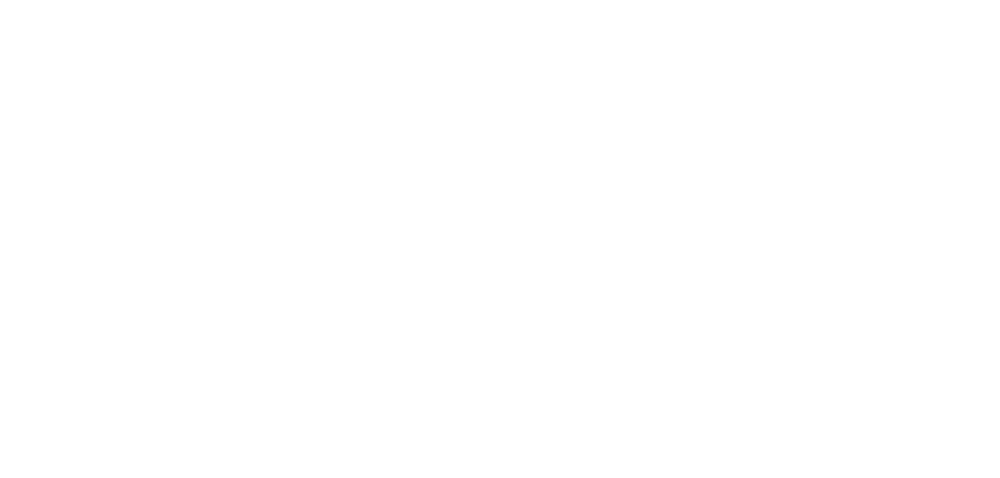

roi196_dff.png


<IPython.core.display.Javascript object>


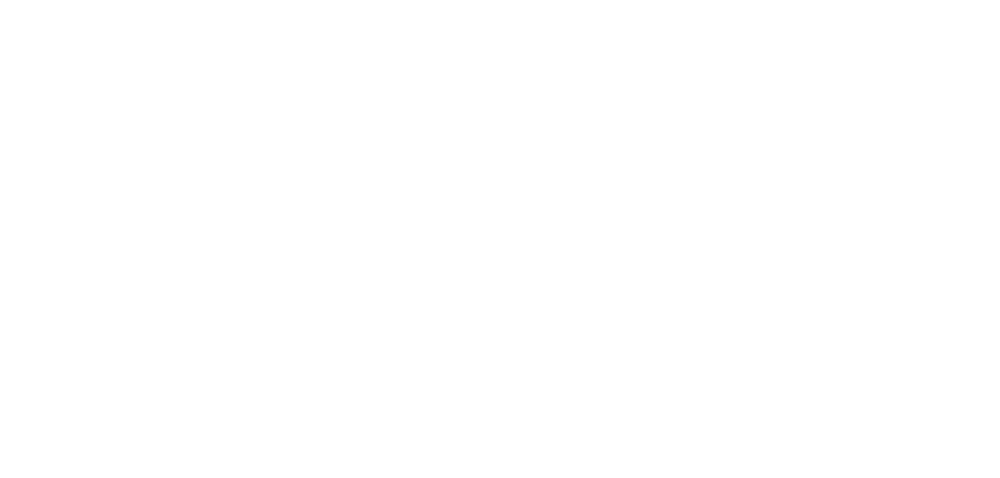

roi197_dff.png


<IPython.core.display.Javascript object>


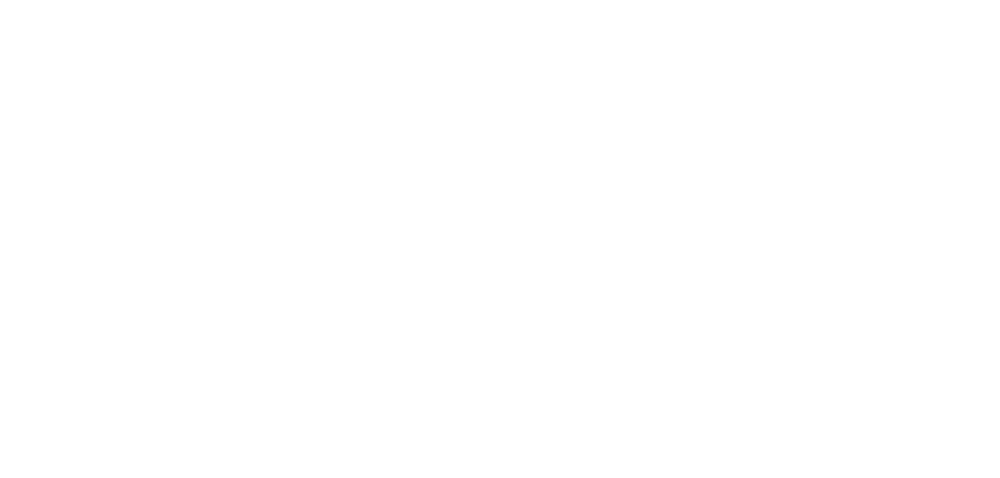

roi198_dff.png


<IPython.core.display.Javascript object>


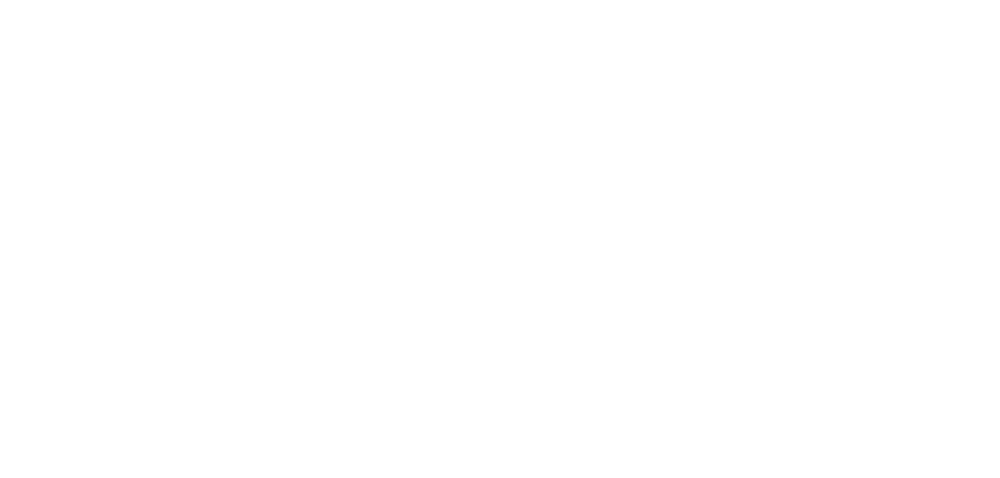

roi199_dff.png


<IPython.core.display.Javascript object>


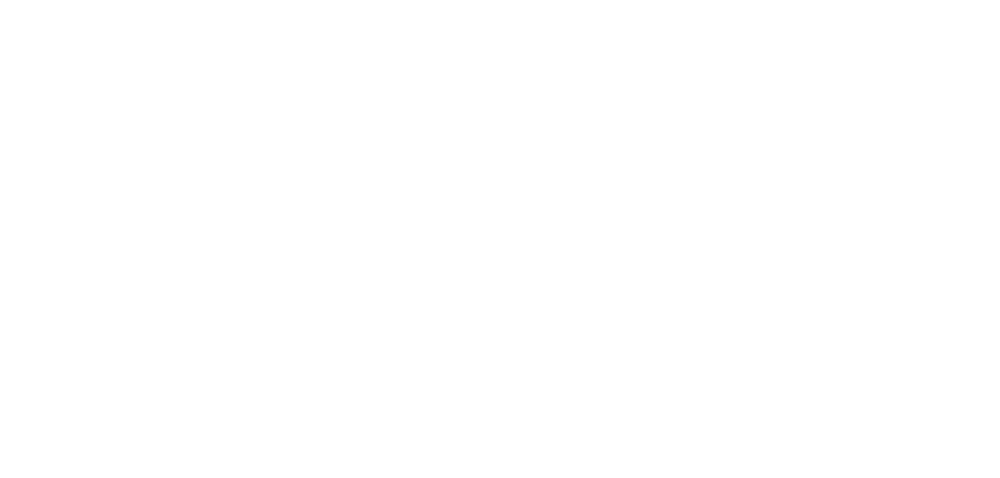

roi200_dff.png


<IPython.core.display.Javascript object>


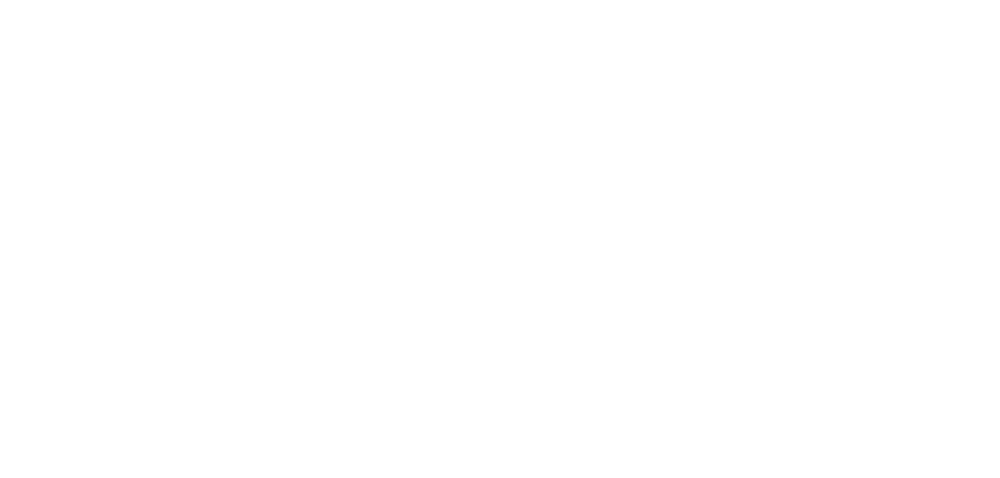

roi201_dff.png


<IPython.core.display.Javascript object>


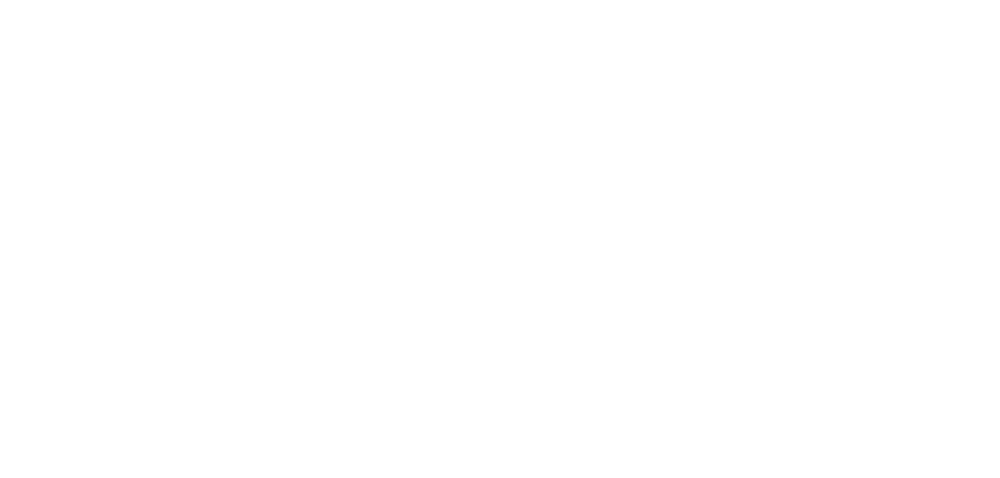

roi202_dff.png


<IPython.core.display.Javascript object>


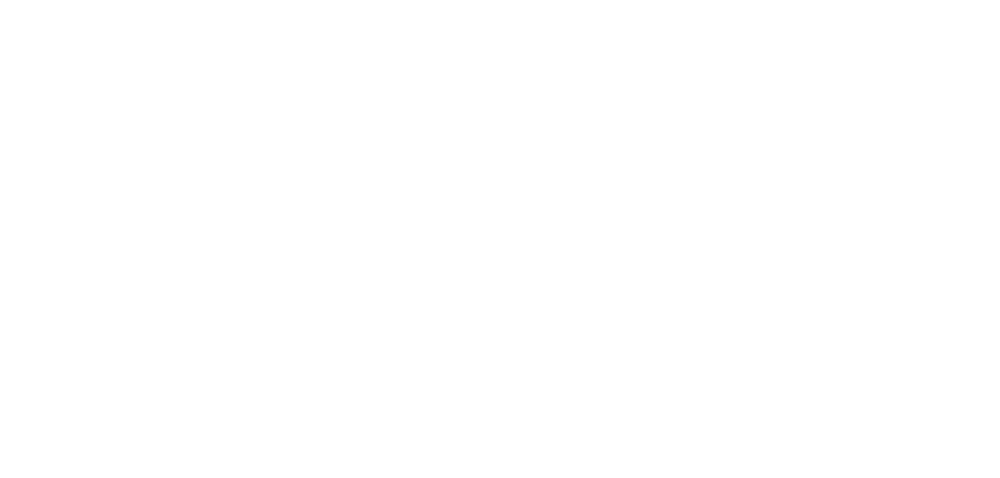

roi203_dff.png


<IPython.core.display.Javascript object>


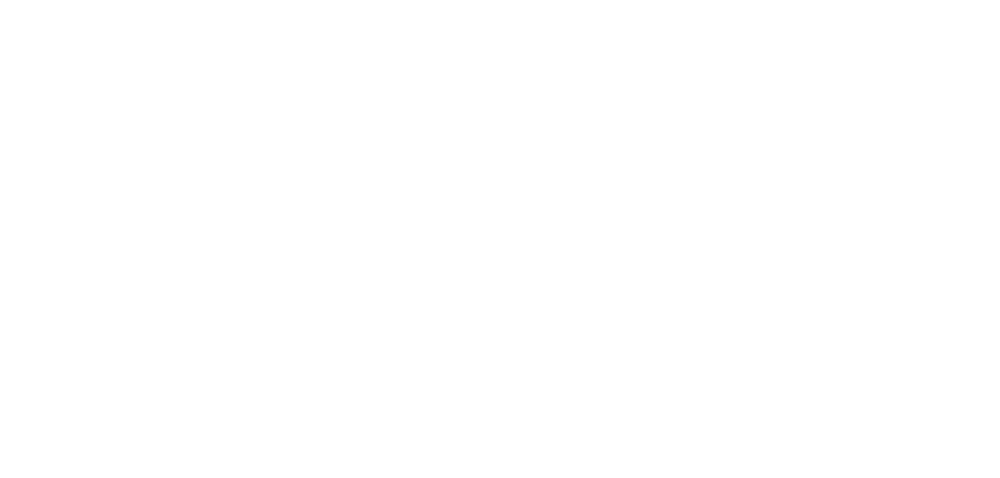

roi204_dff.png


<IPython.core.display.Javascript object>


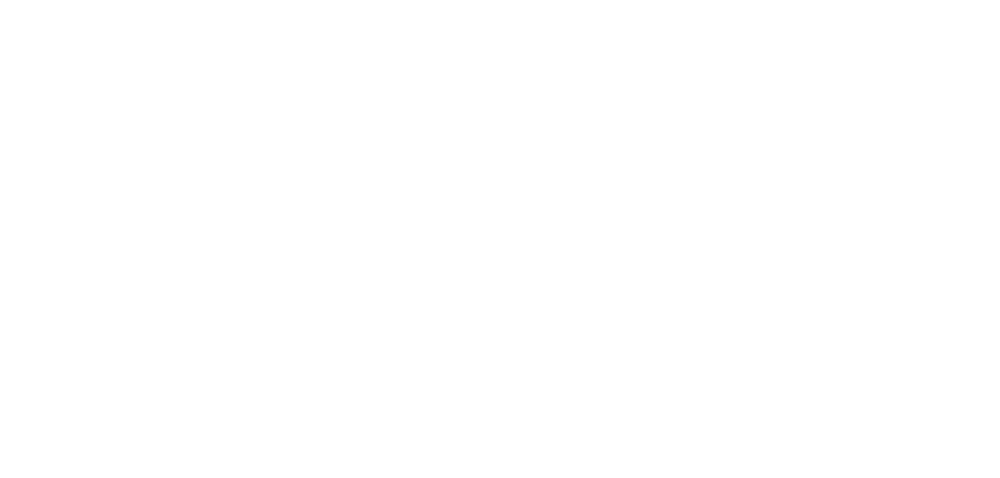

roi205_dff.png


<IPython.core.display.Javascript object>


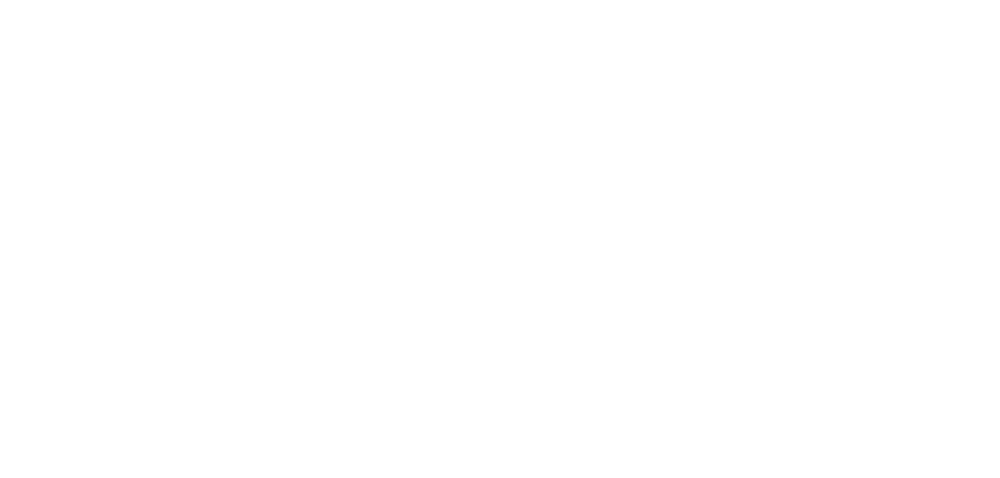

roi206_dff.png


<IPython.core.display.Javascript object>


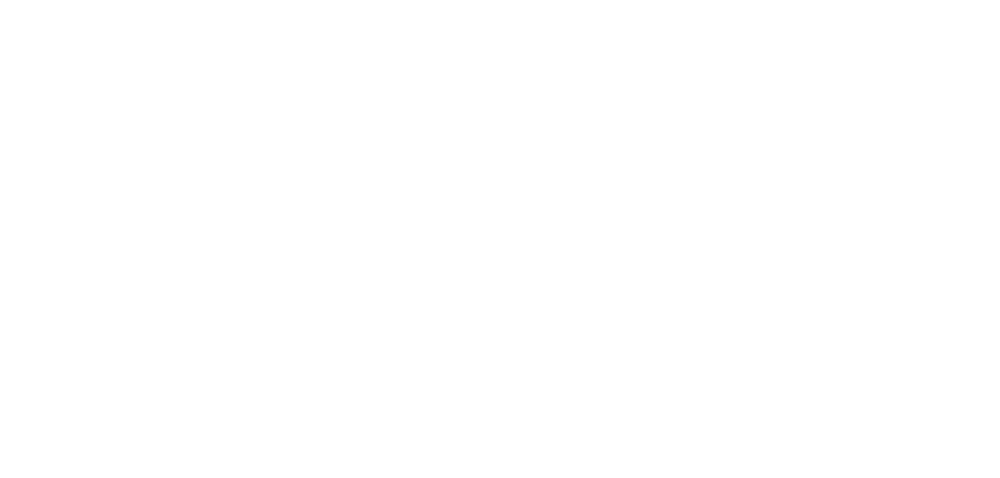

roi207_dff.png


<IPython.core.display.Javascript object>


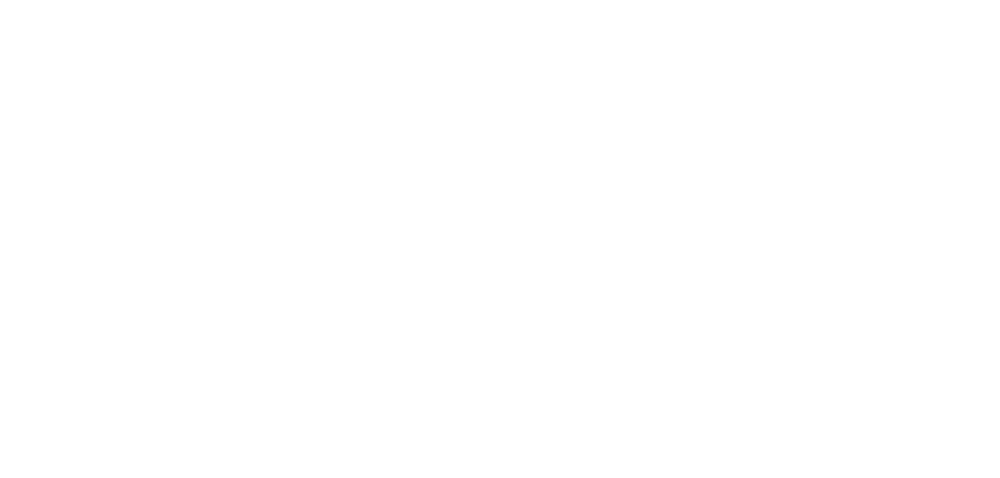

roi208_dff.png


<IPython.core.display.Javascript object>


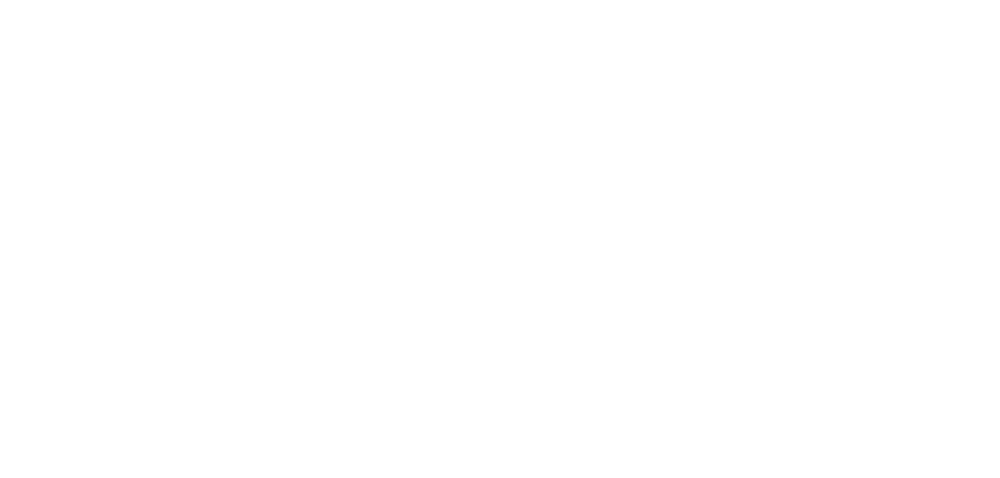

roi209_dff.png


<IPython.core.display.Javascript object>


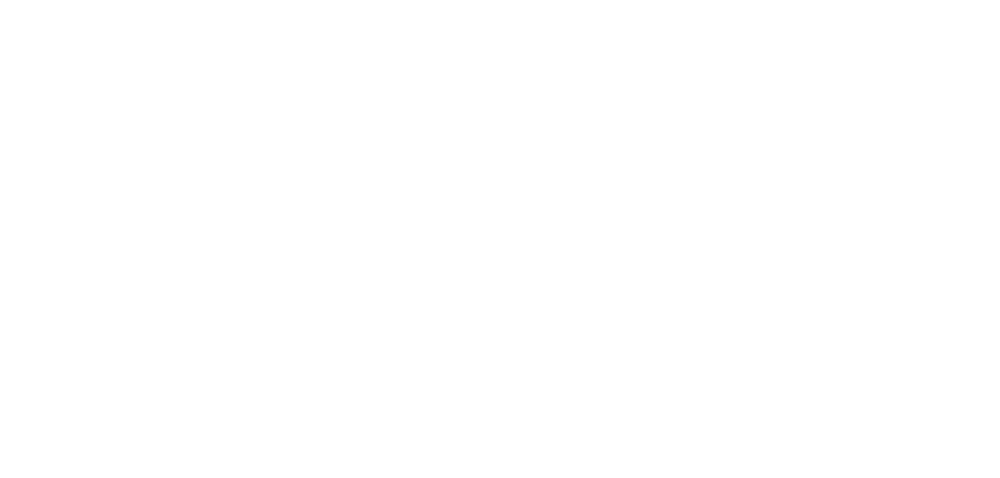

roi210_dff.png


<IPython.core.display.Javascript object>


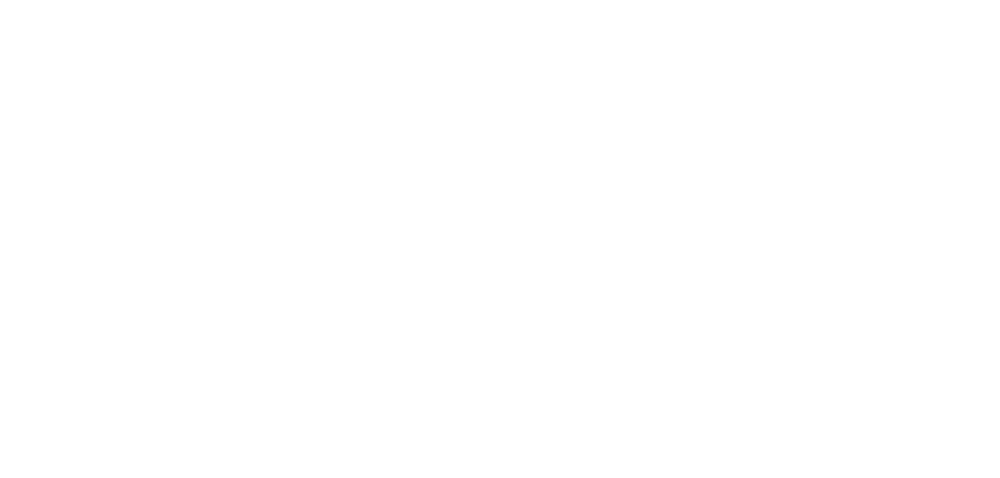

roi211_dff.png


<IPython.core.display.Javascript object>


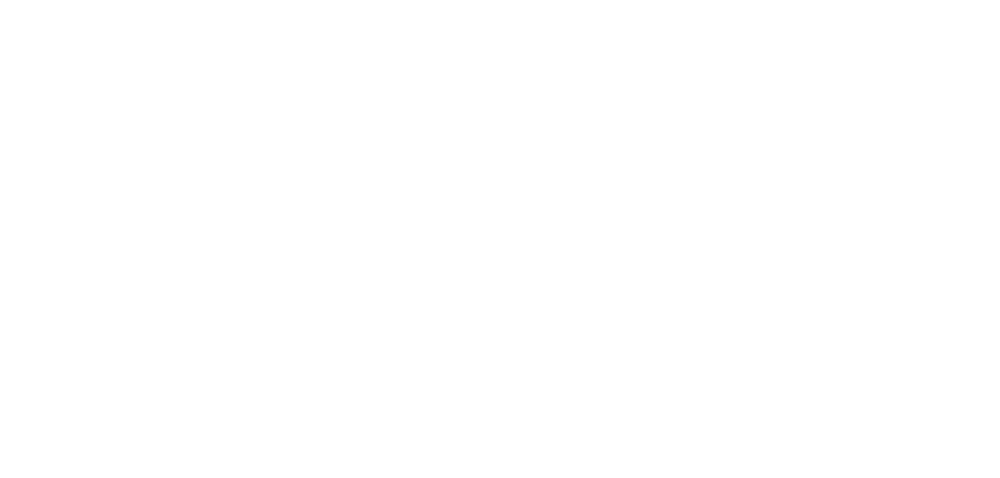

roi212_dff.png


<IPython.core.display.Javascript object>


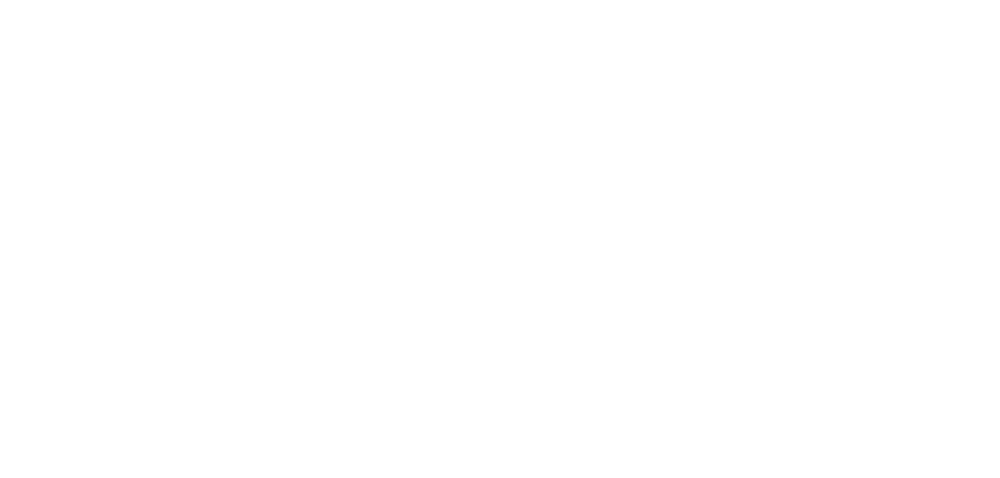

roi213_dff.png


<IPython.core.display.Javascript object>


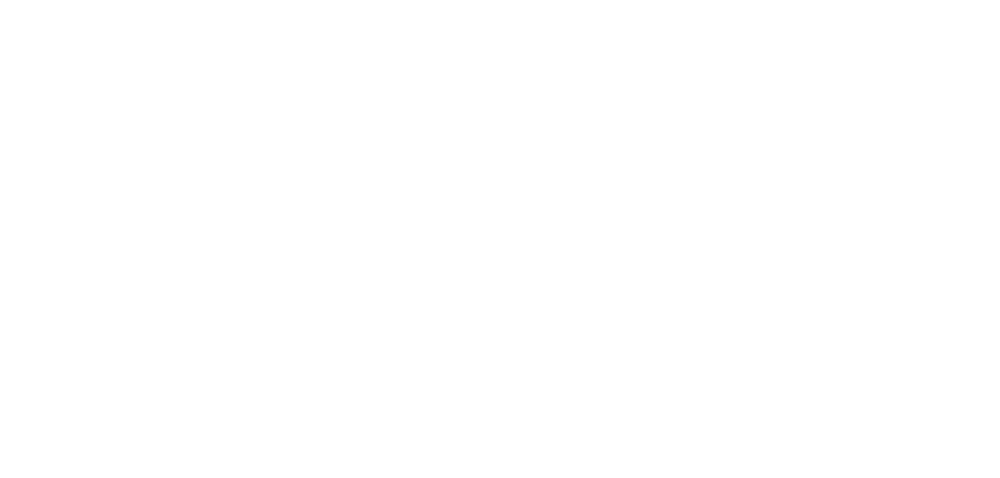

roi214_dff.png


<IPython.core.display.Javascript object>


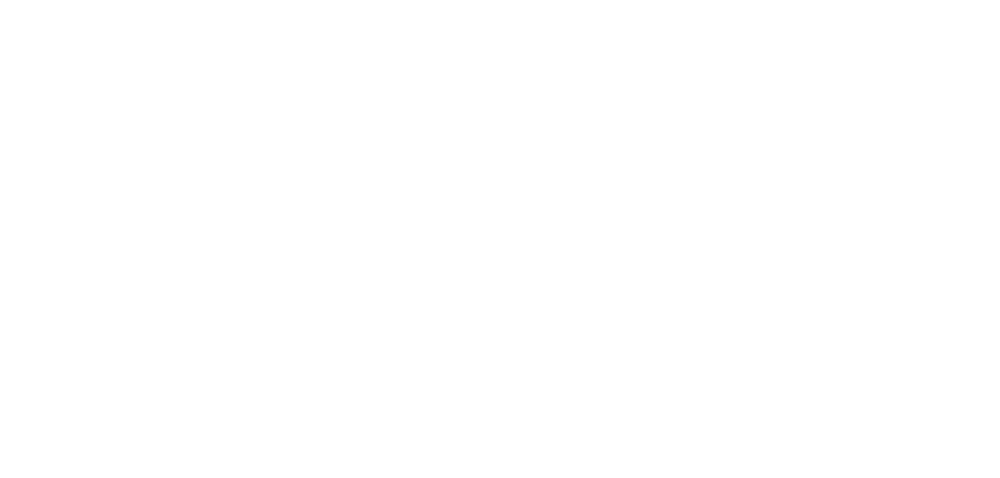

roi215_dff.png


<IPython.core.display.Javascript object>


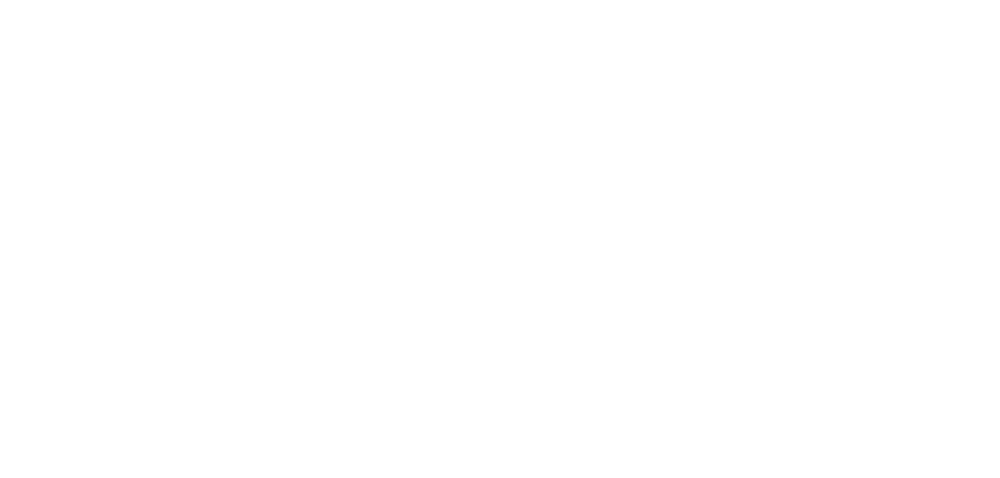

roi216_dff.png


<IPython.core.display.Javascript object>


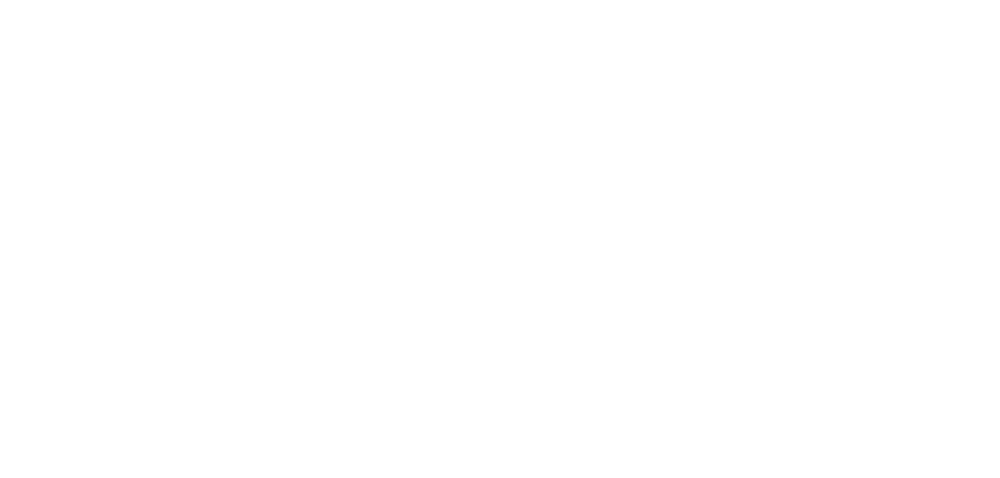

roi217_dff.png


<IPython.core.display.Javascript object>


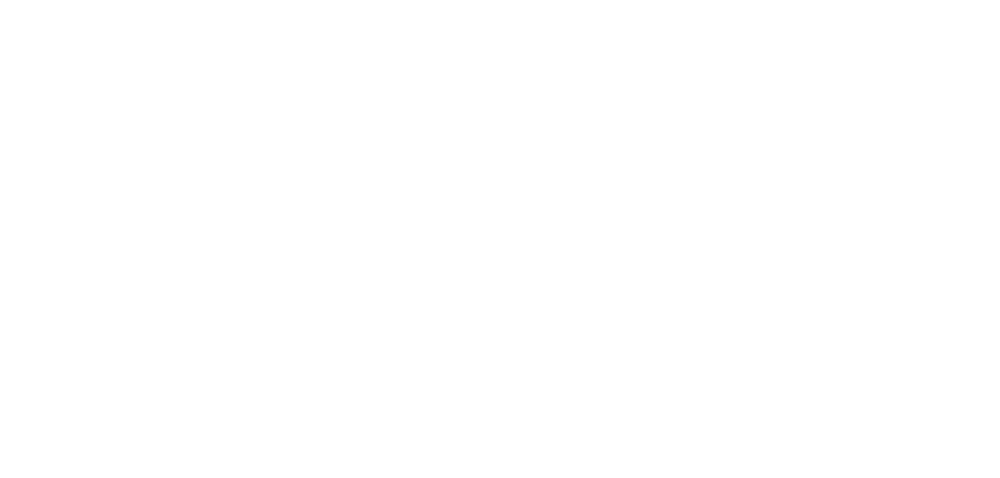

roi218_dff.png


<IPython.core.display.Javascript object>


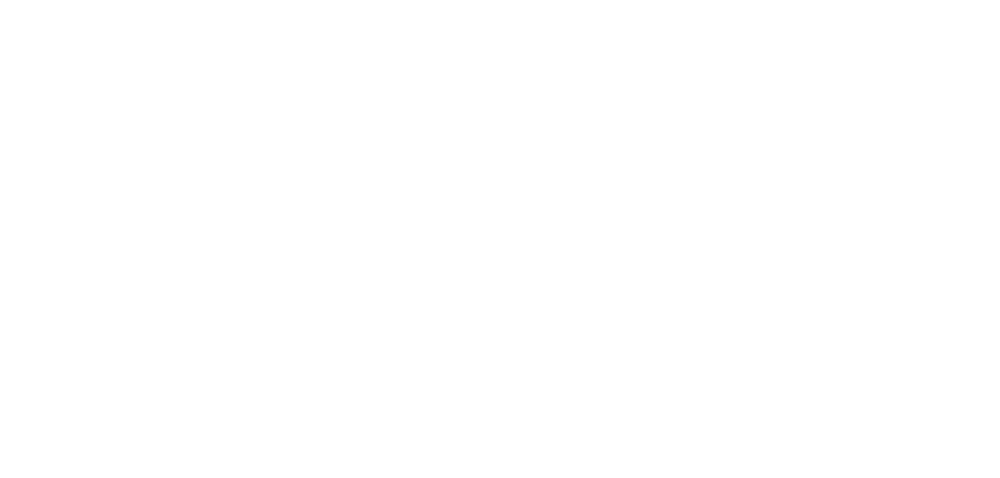

roi219_dff.png


<IPython.core.display.Javascript object>


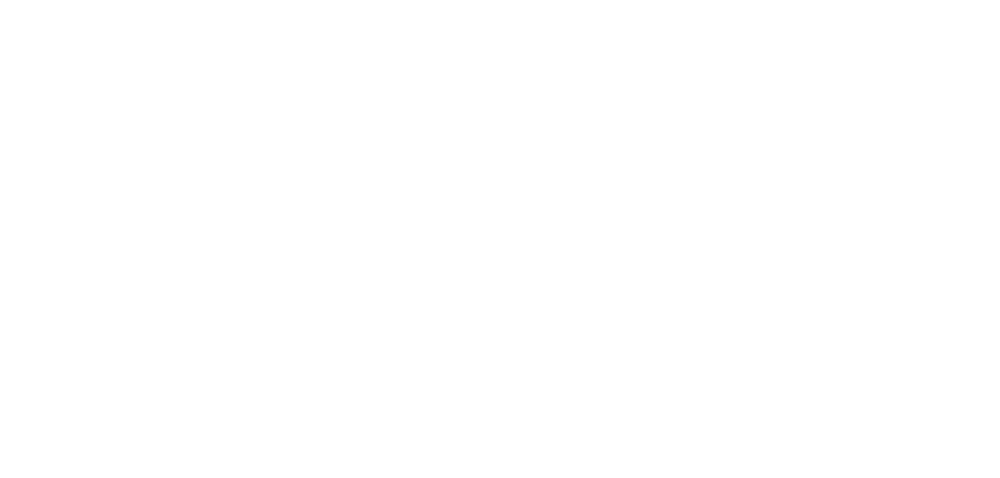

roi220_dff.png


<IPython.core.display.Javascript object>


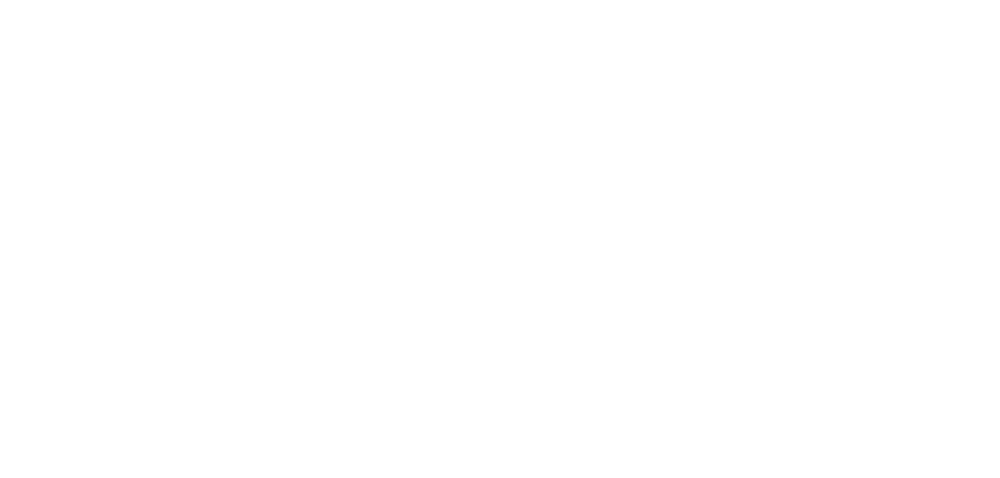

roi221_dff.png


<IPython.core.display.Javascript object>


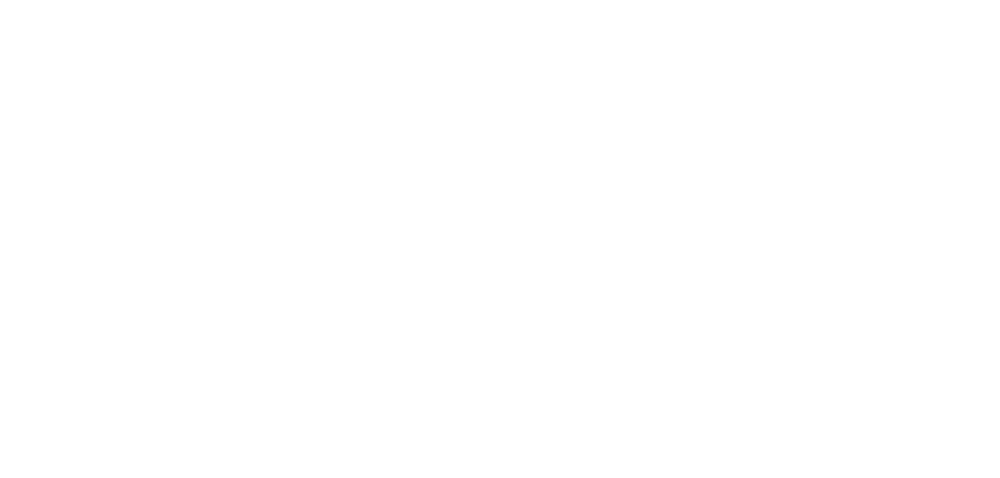

roi222_dff.png


<IPython.core.display.Javascript object>


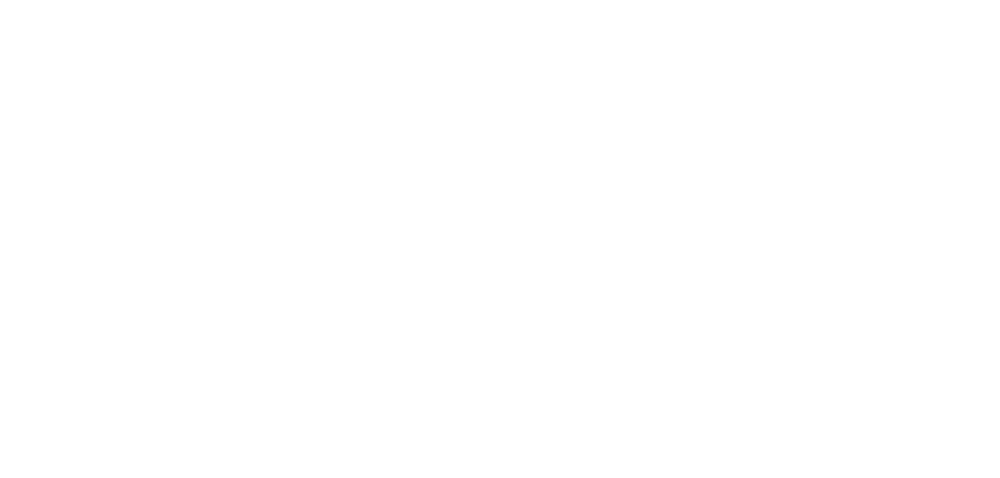

roi223_dff.png


<IPython.core.display.Javascript object>


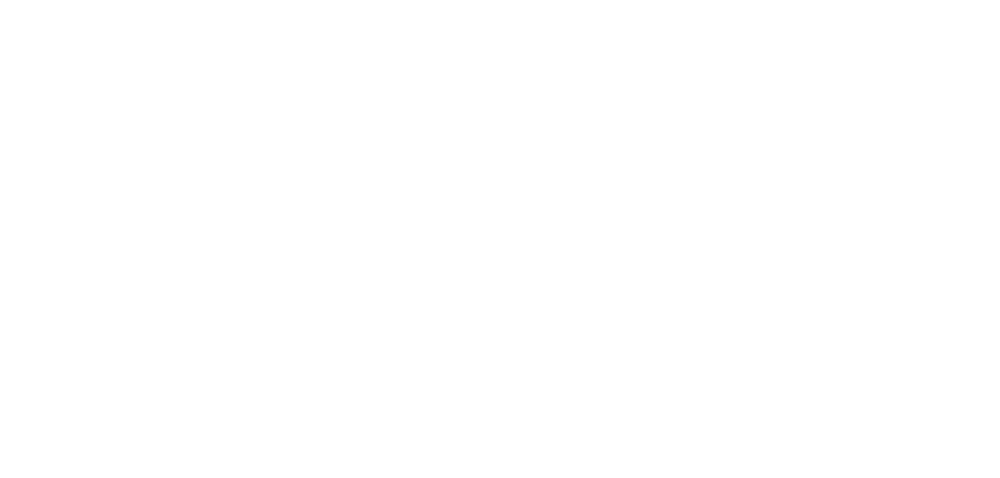

roi224_dff.png


<IPython.core.display.Javascript object>


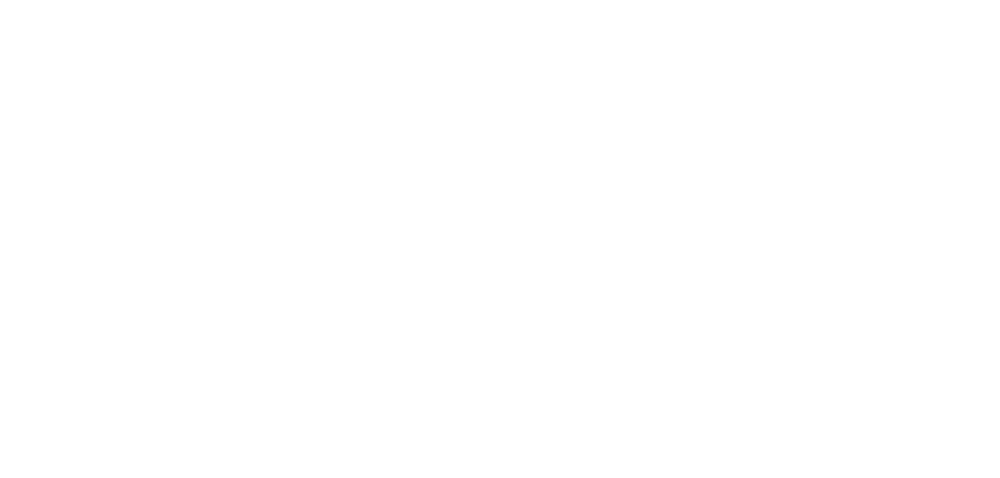

roi225_dff.png


<IPython.core.display.Javascript object>


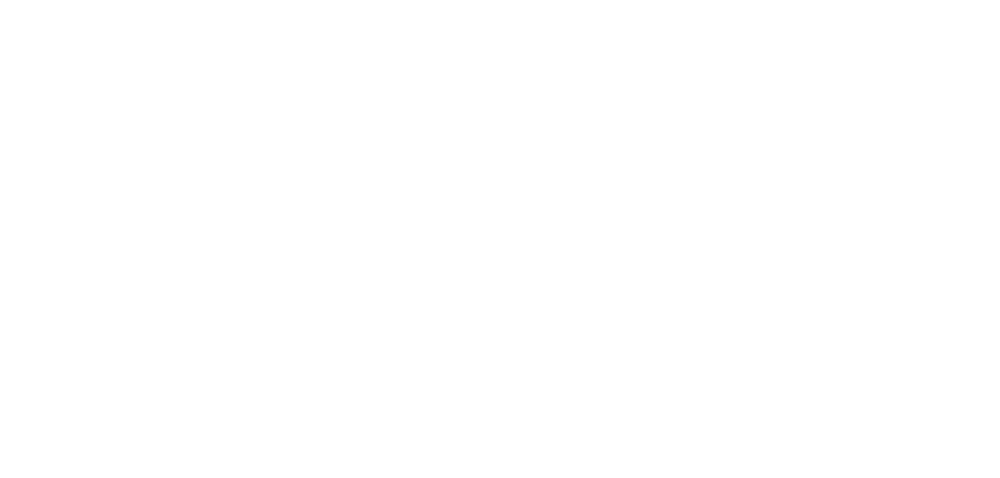

roi226_dff.png


<IPython.core.display.Javascript object>


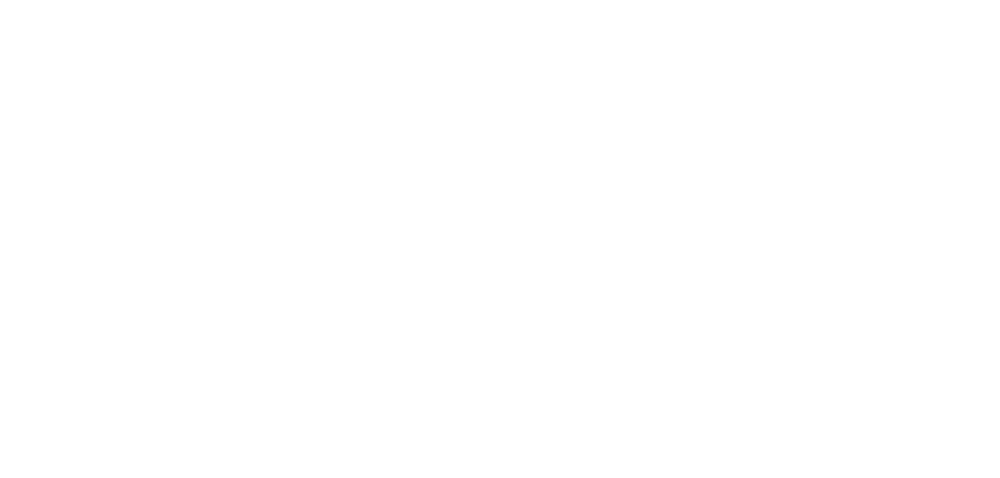

roi227_dff.png


<IPython.core.display.Javascript object>


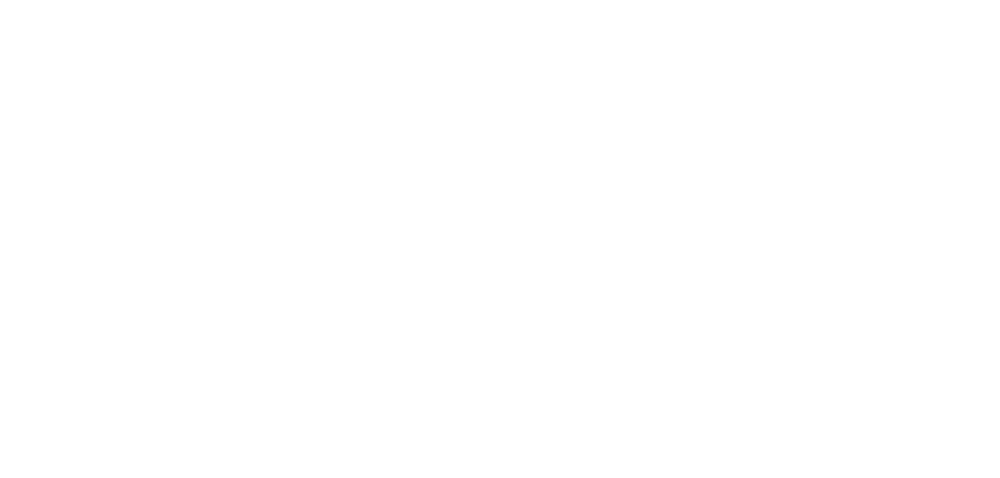

roi228_dff.png


<IPython.core.display.Javascript object>


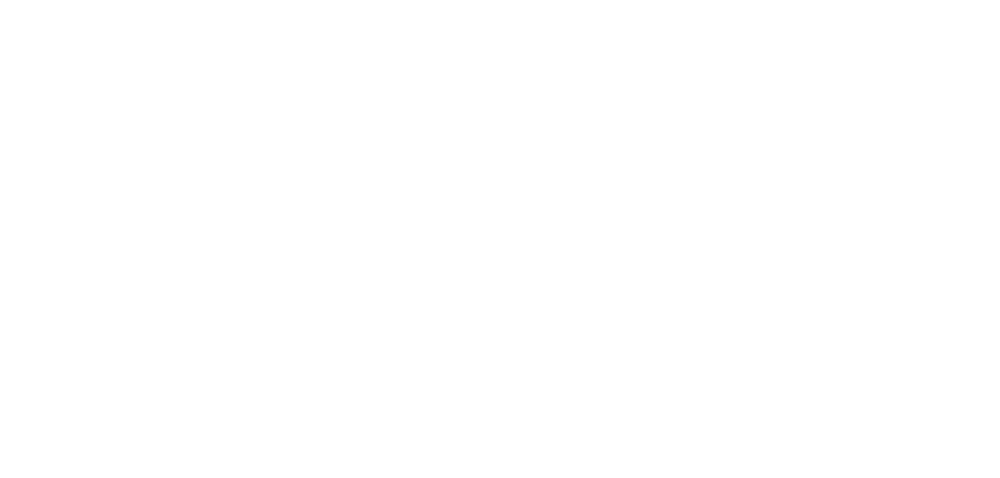

roi229_dff.png


<IPython.core.display.Javascript object>


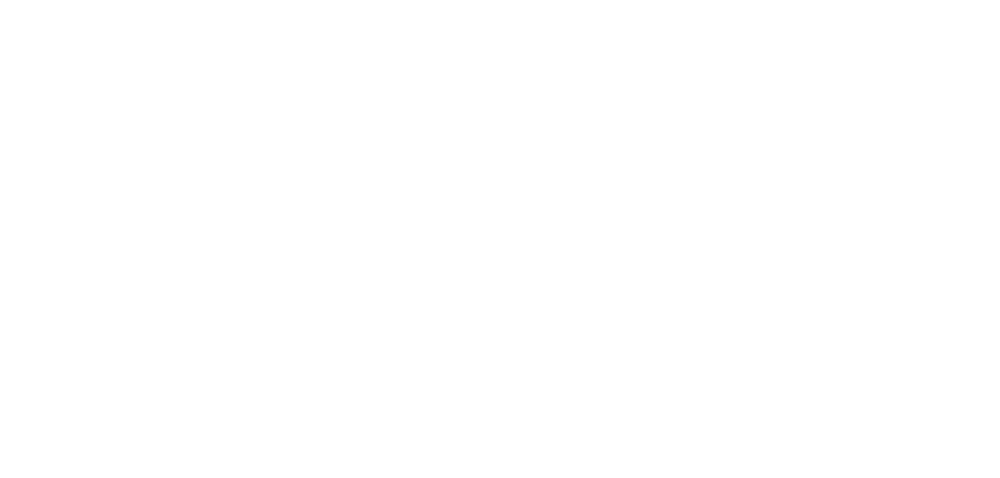

roi230_dff.png


<IPython.core.display.Javascript object>


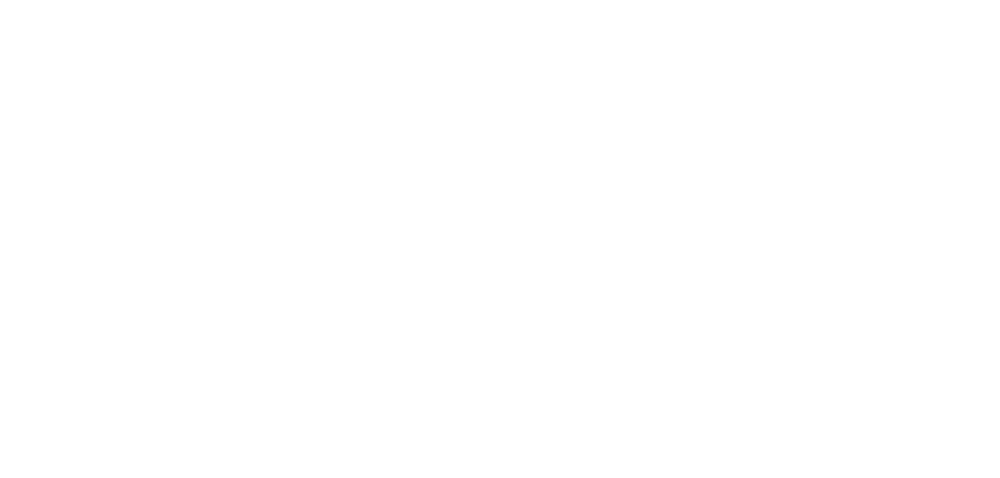

roi231_dff.png


<IPython.core.display.Javascript object>


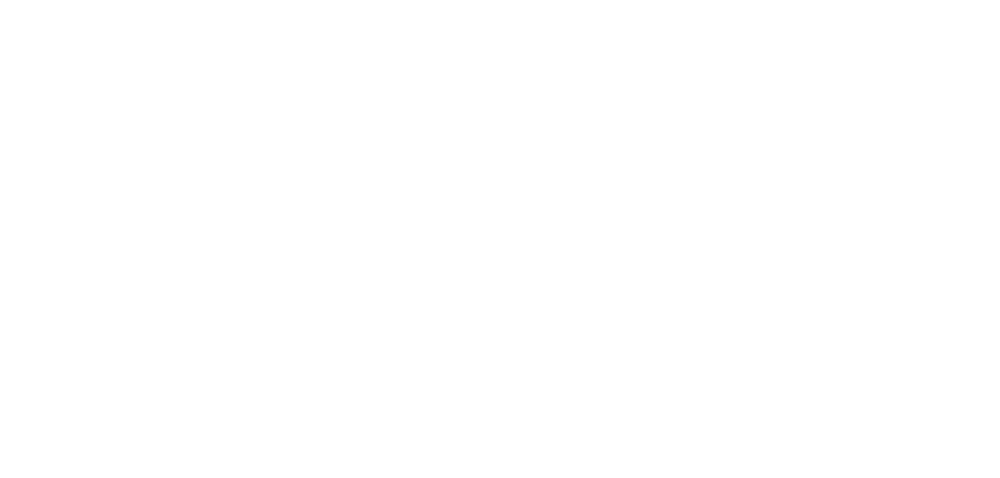

roi232_dff.png


<IPython.core.display.Javascript object>


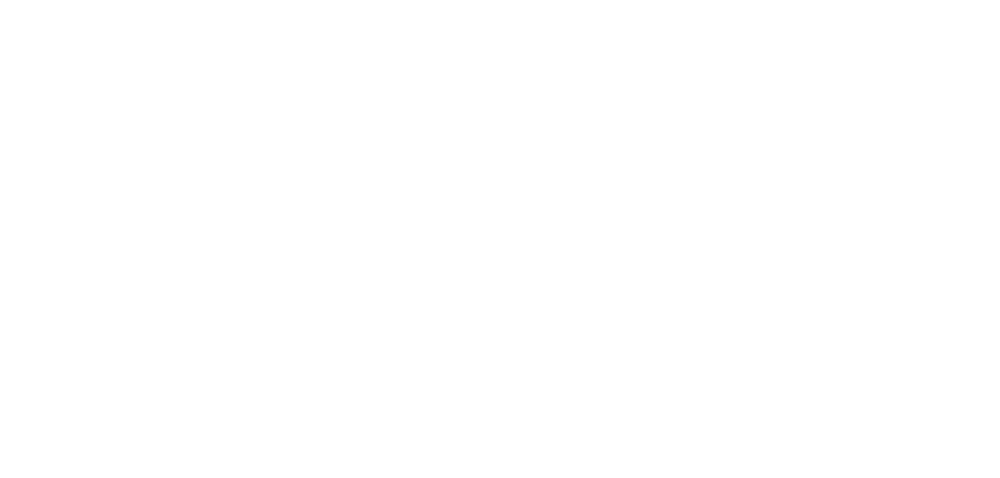

roi233_dff.png


<IPython.core.display.Javascript object>


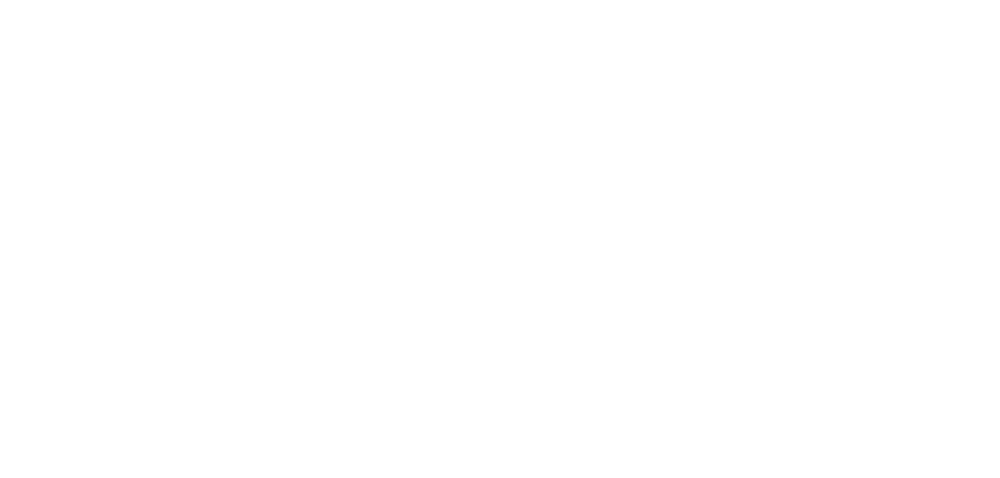

roi234_dff.png


<IPython.core.display.Javascript object>


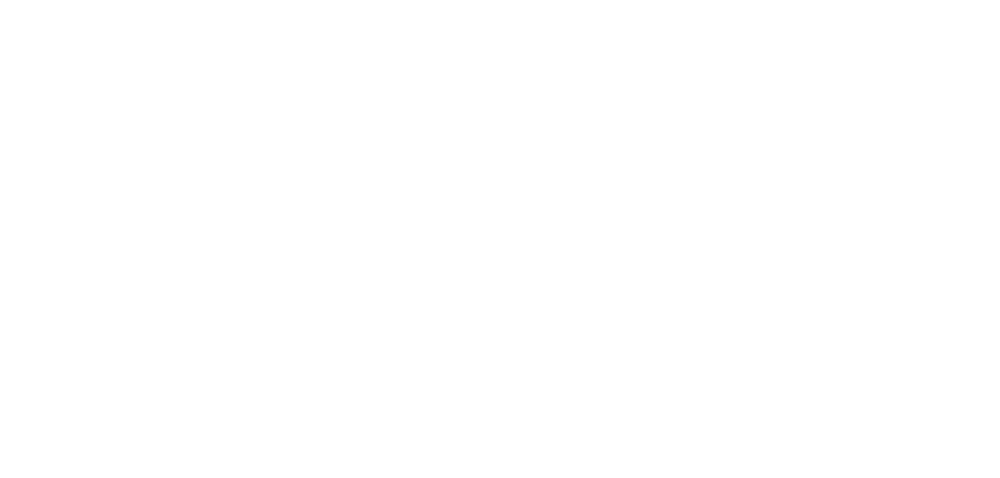

roi235_dff.png


<IPython.core.display.Javascript object>


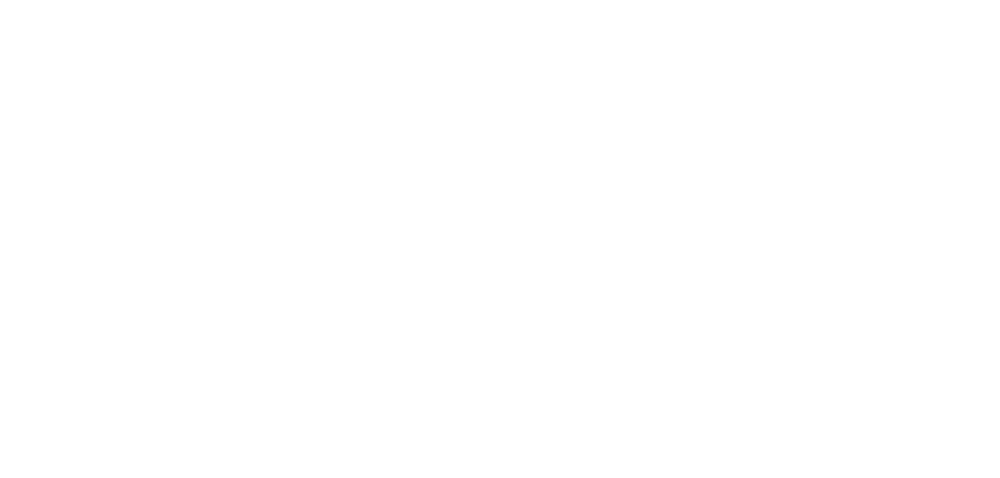

roi236_dff.png


<IPython.core.display.Javascript object>


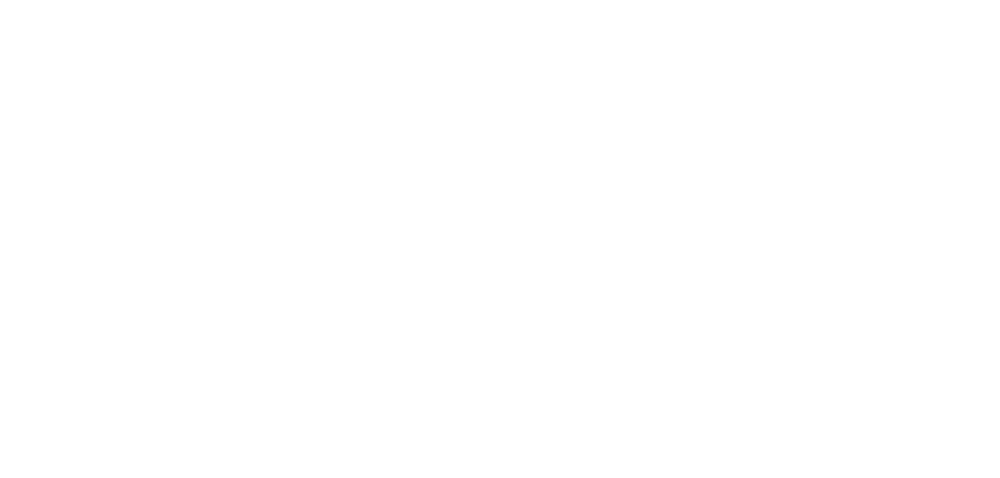

roi237_dff.png


<IPython.core.display.Javascript object>


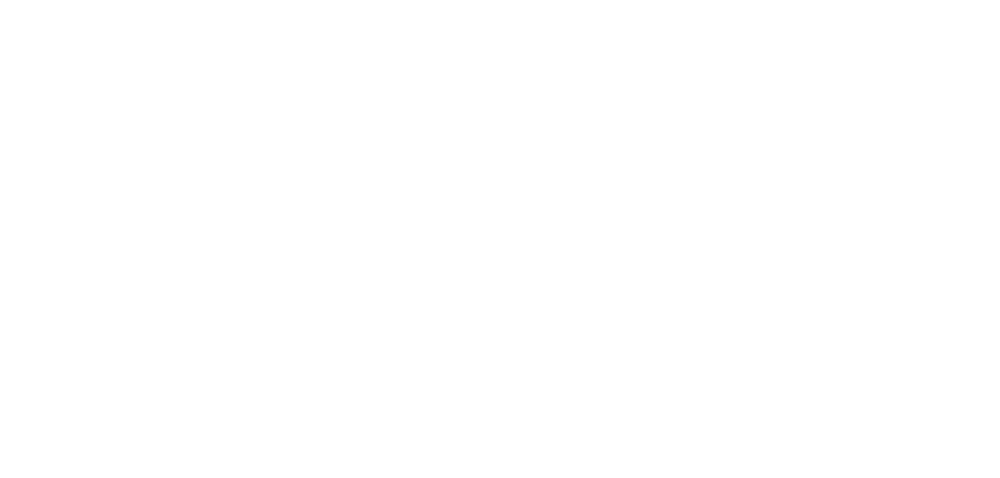

roi238_dff.png


<IPython.core.display.Javascript object>


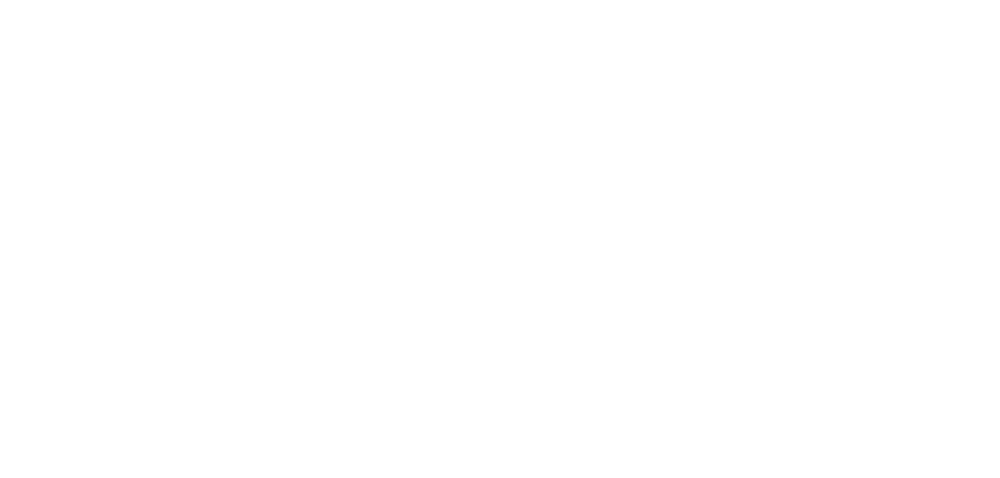

roi239_dff.png


<IPython.core.display.Javascript object>


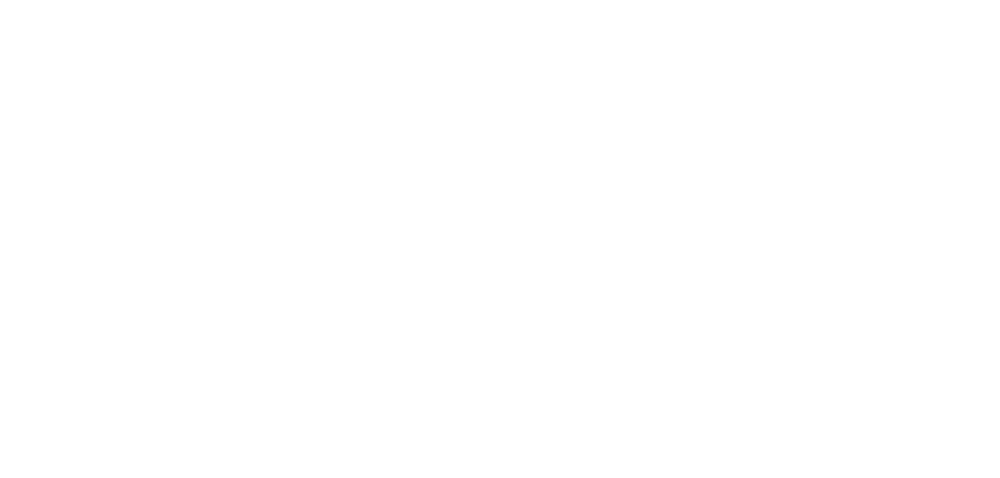

roi240_dff.png


<IPython.core.display.Javascript object>


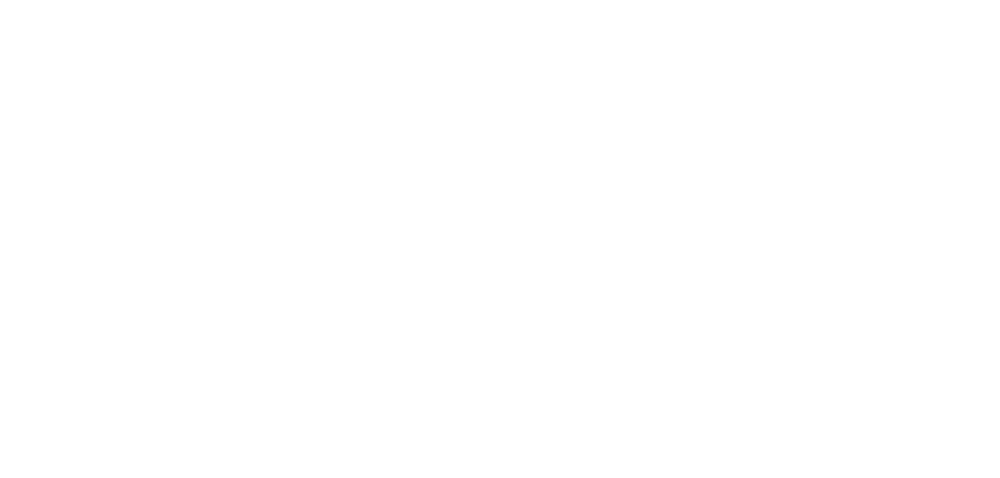

roi241_dff.png


<IPython.core.display.Javascript object>


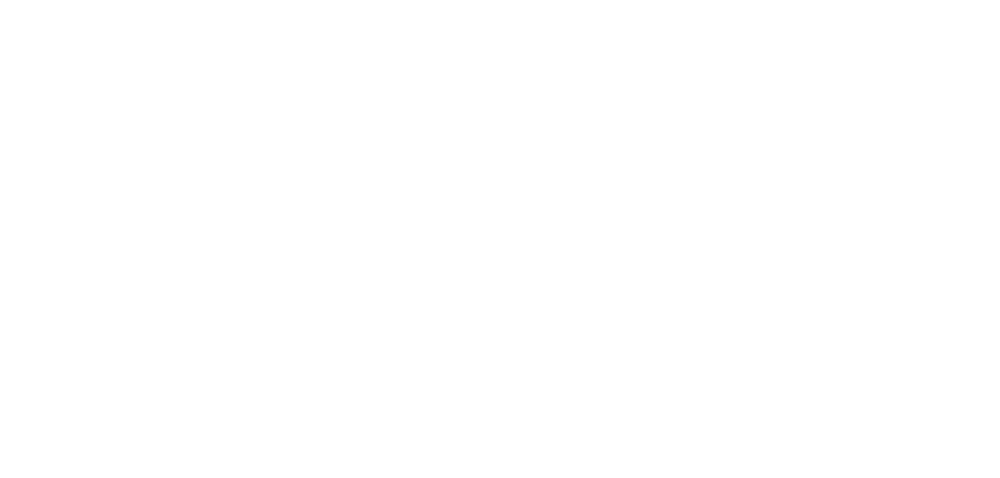

roi242_dff.png


<IPython.core.display.Javascript object>


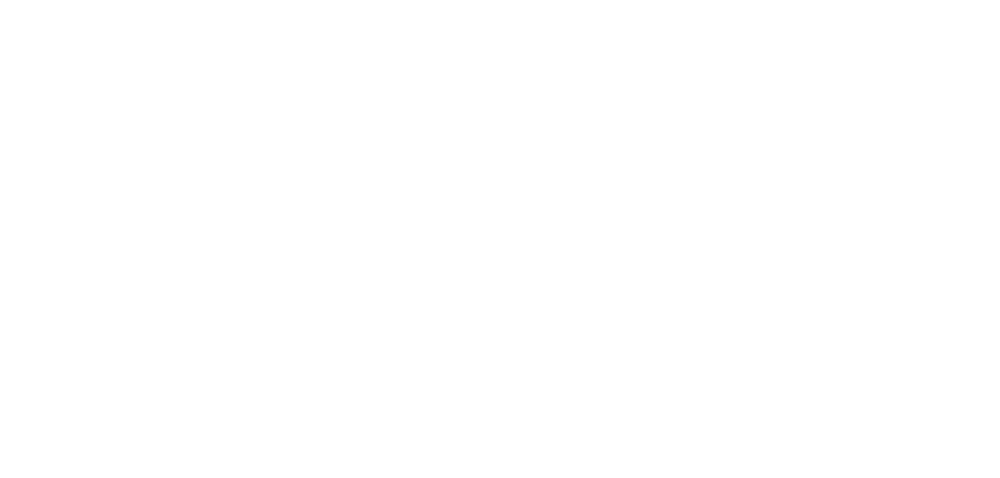

roi243_dff.png


<IPython.core.display.Javascript object>


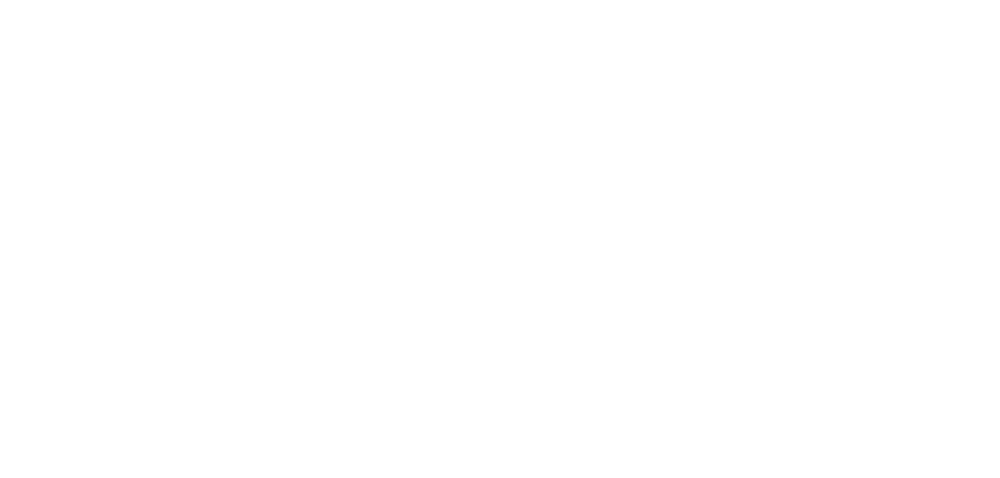

roi244_dff.png


<IPython.core.display.Javascript object>


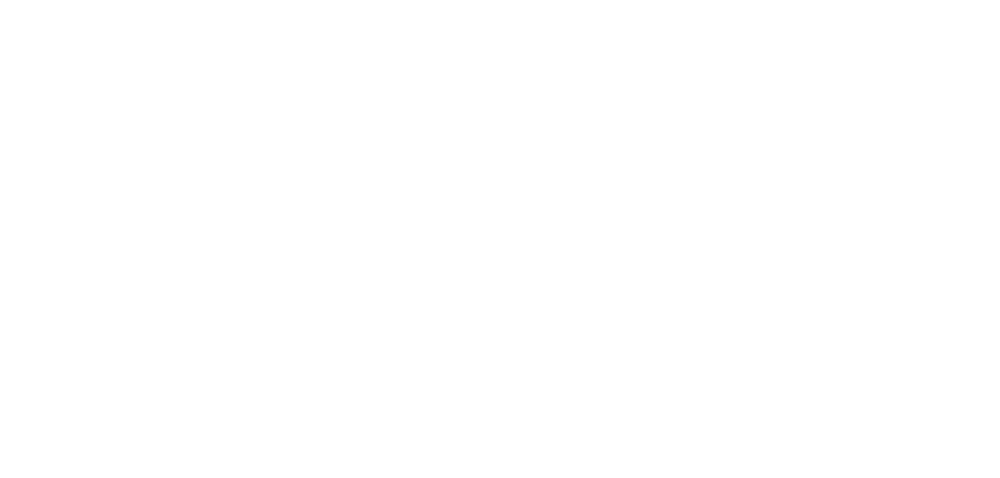

roi245_dff.png


<IPython.core.display.Javascript object>


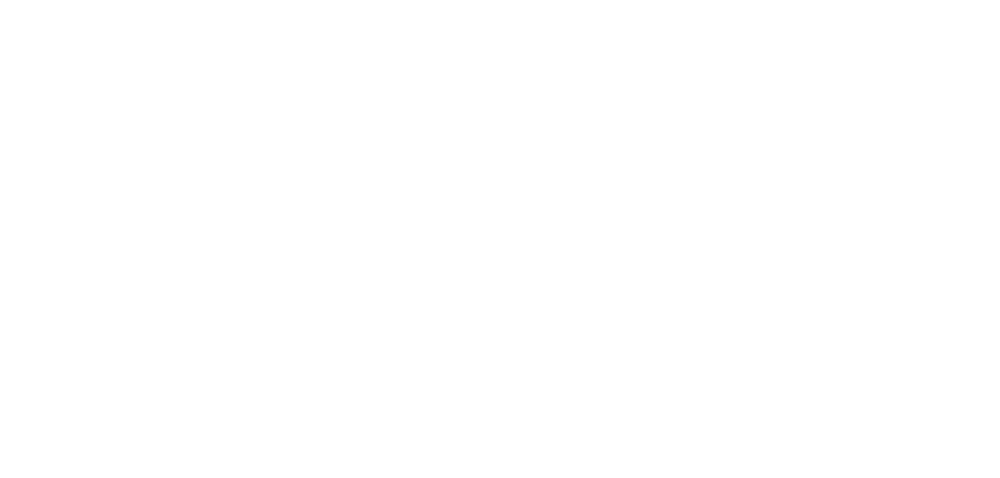

roi246_dff.png


<IPython.core.display.Javascript object>


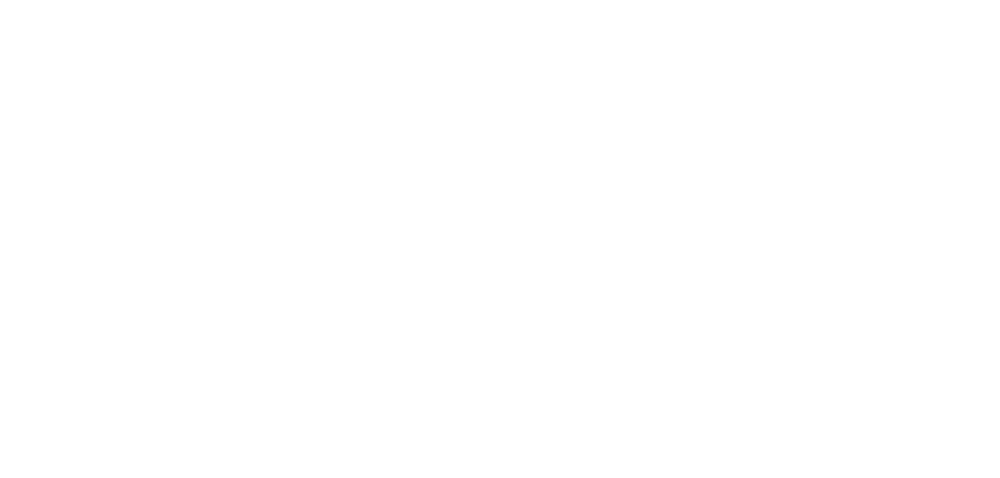

roi247_dff.png


<IPython.core.display.Javascript object>


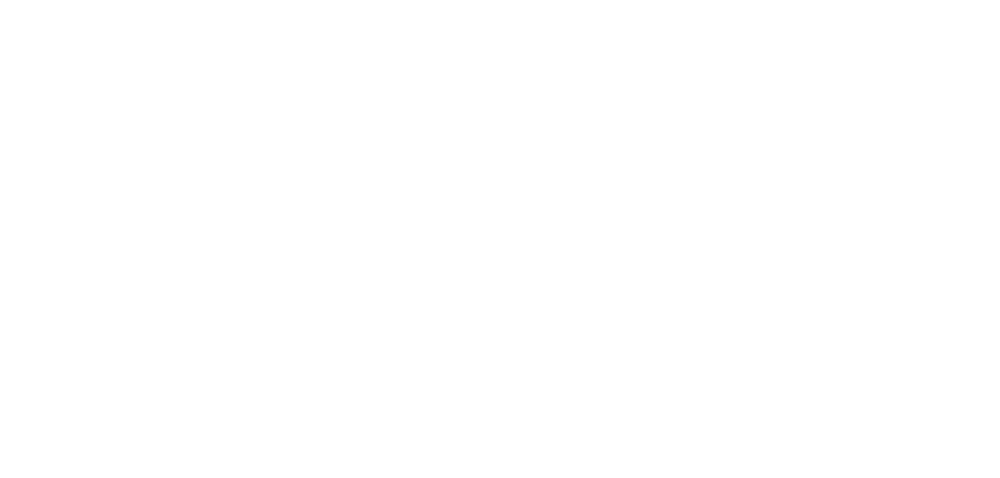

roi248_dff.png


<IPython.core.display.Javascript object>


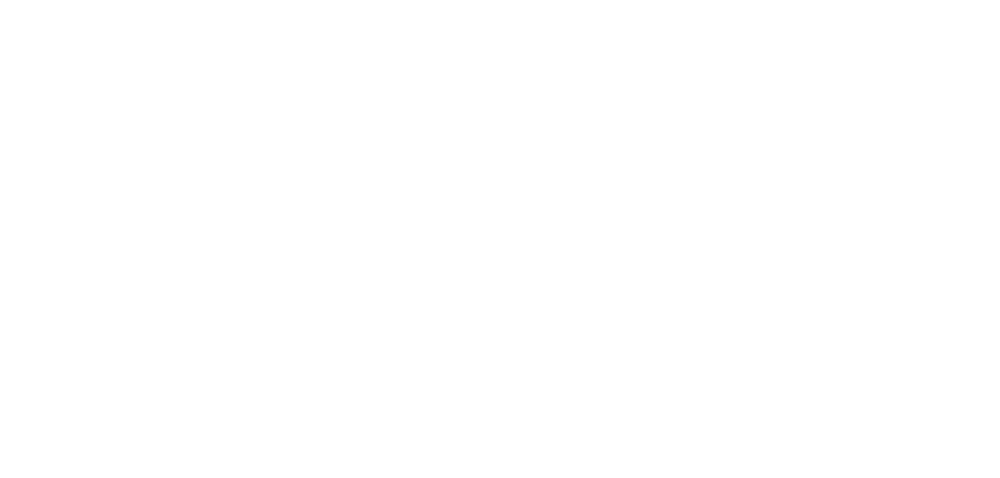

roi249_dff.png


<IPython.core.display.Javascript object>


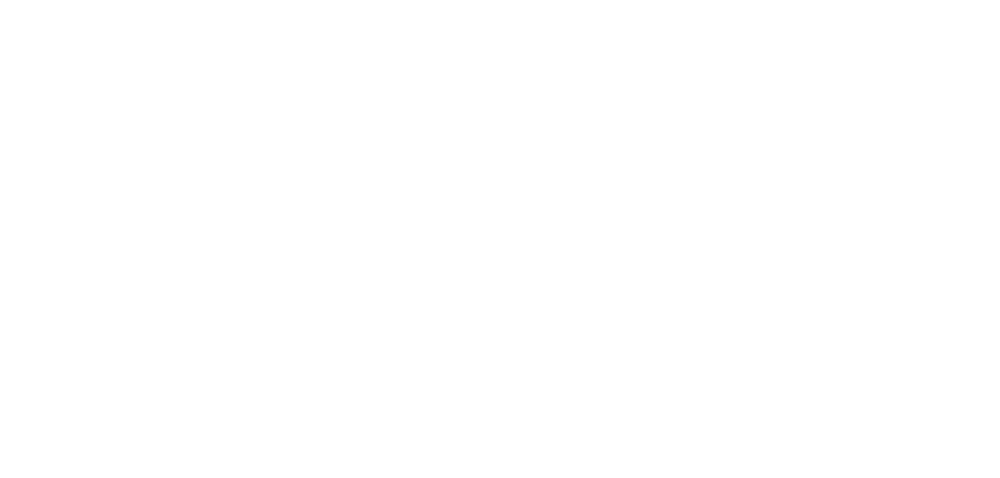

roi250_dff.png


<IPython.core.display.Javascript object>


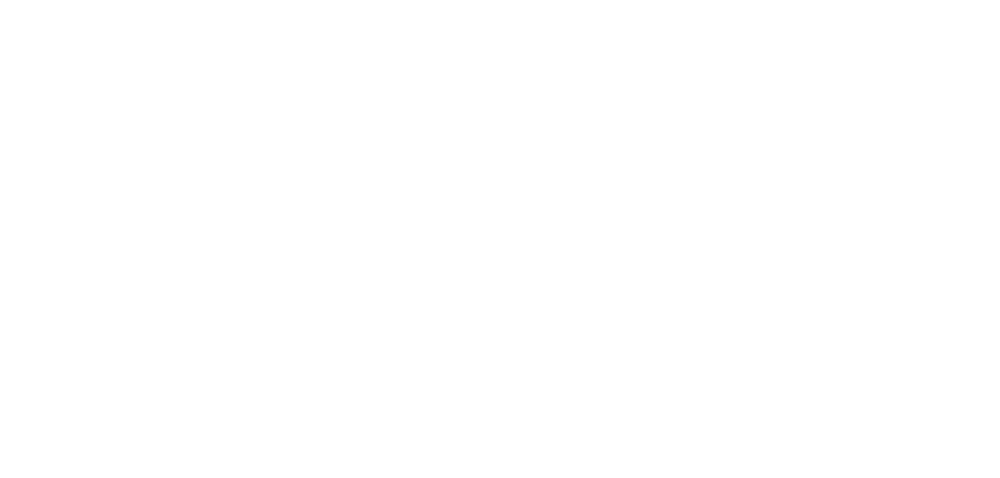

roi251_dff.png


<IPython.core.display.Javascript object>


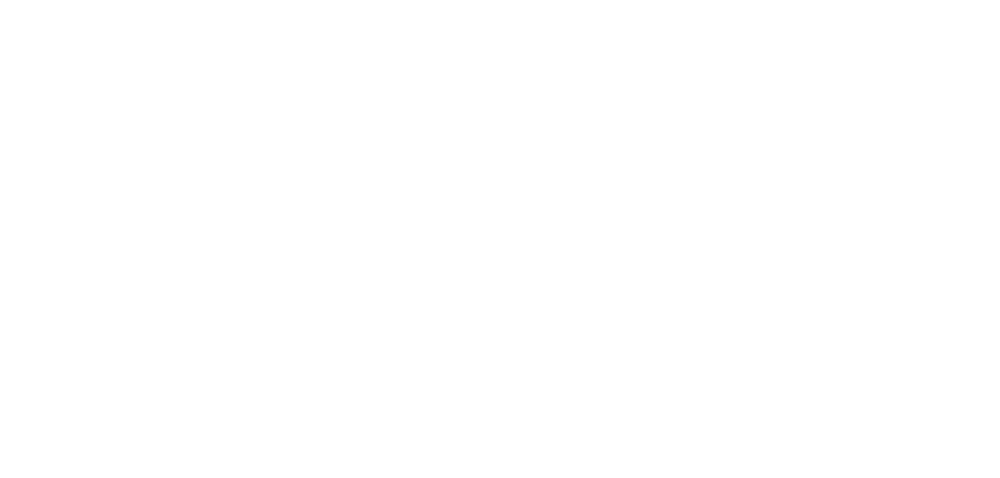

roi252_dff.png


<IPython.core.display.Javascript object>


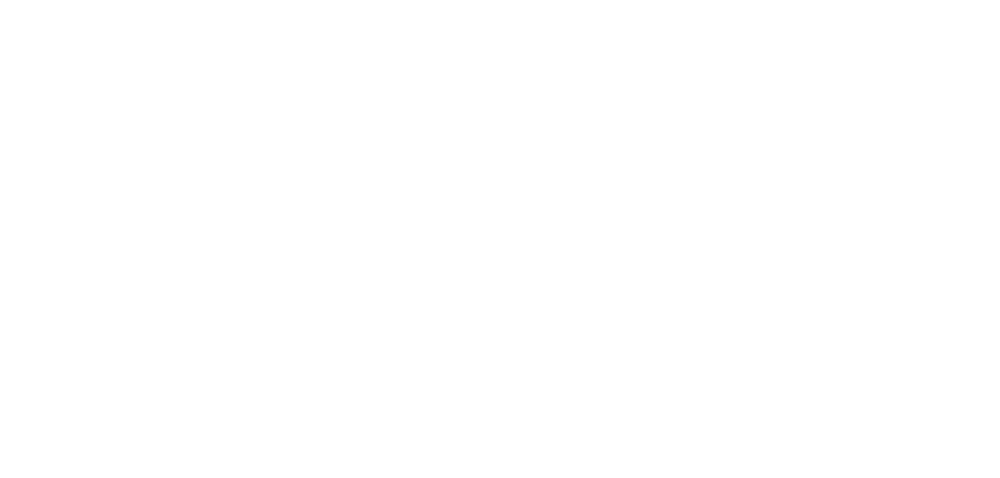

roi253_dff.png


<IPython.core.display.Javascript object>


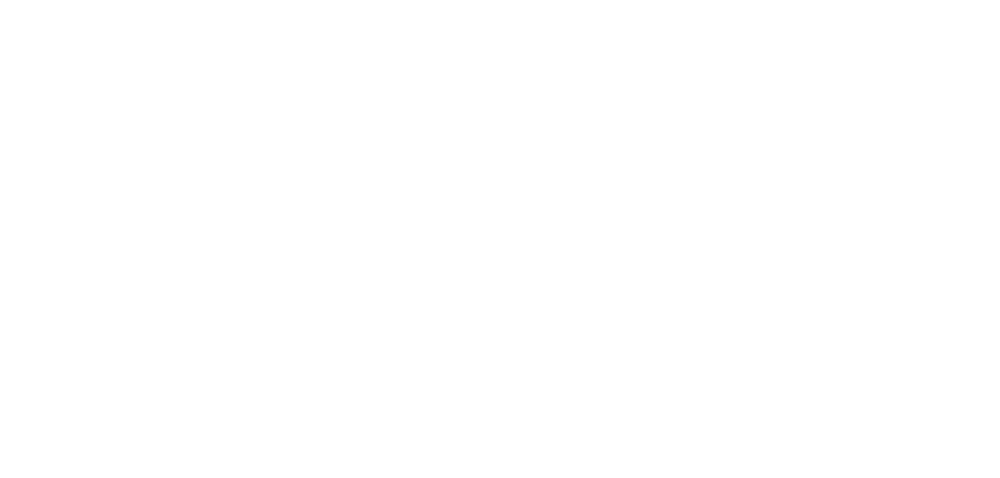

roi254_dff.png


<IPython.core.display.Javascript object>


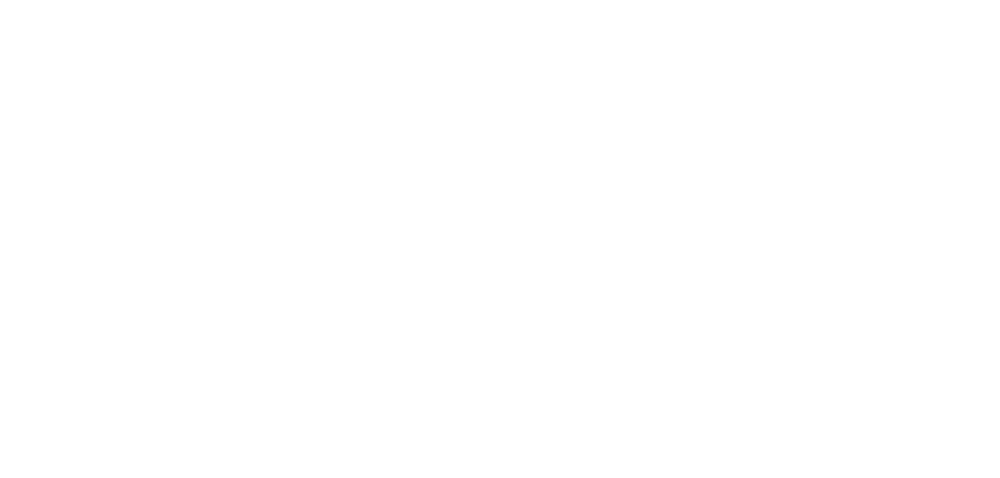

roi255_dff.png


<IPython.core.display.Javascript object>


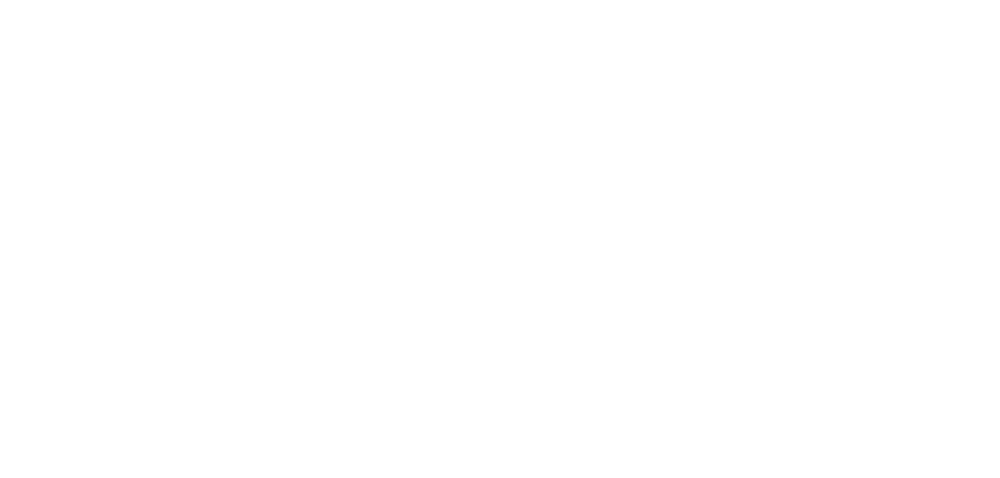

roi256_dff.png


<IPython.core.display.Javascript object>


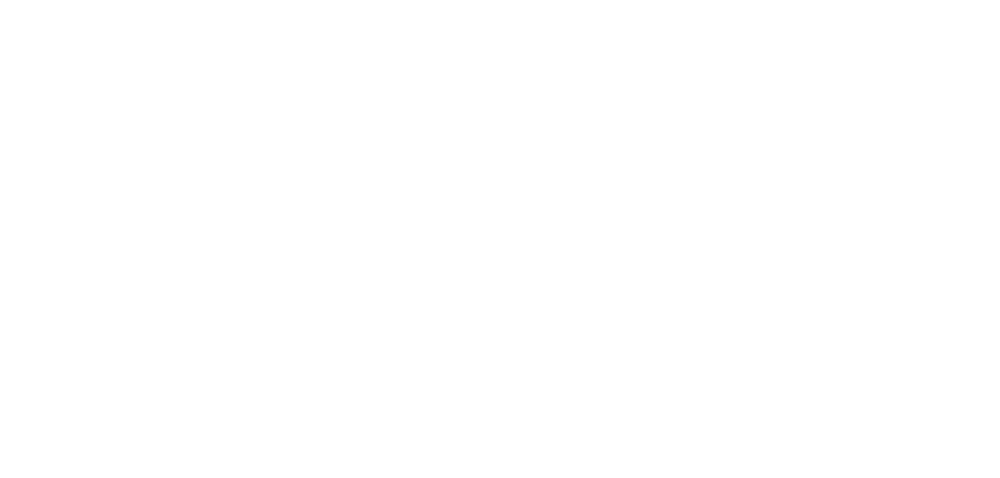

roi257_dff.png


<IPython.core.display.Javascript object>


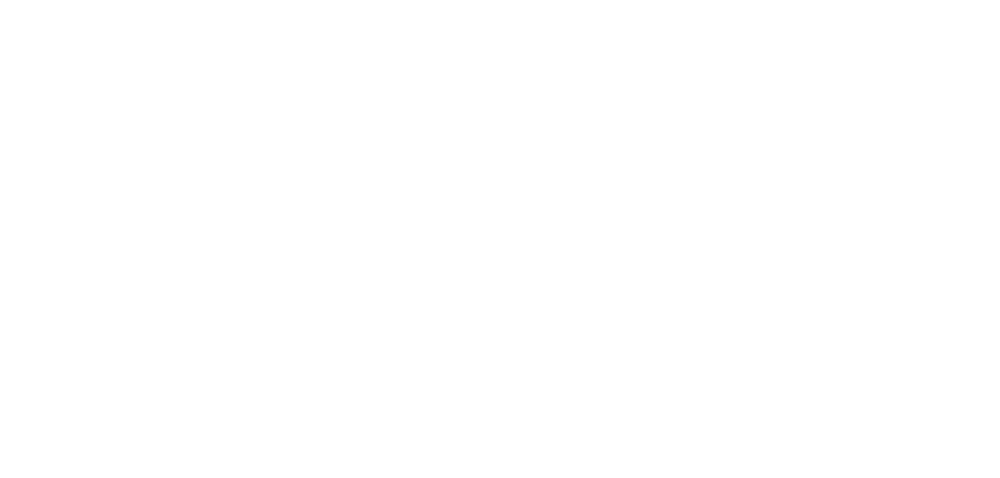

roi258_dff.png


<IPython.core.display.Javascript object>


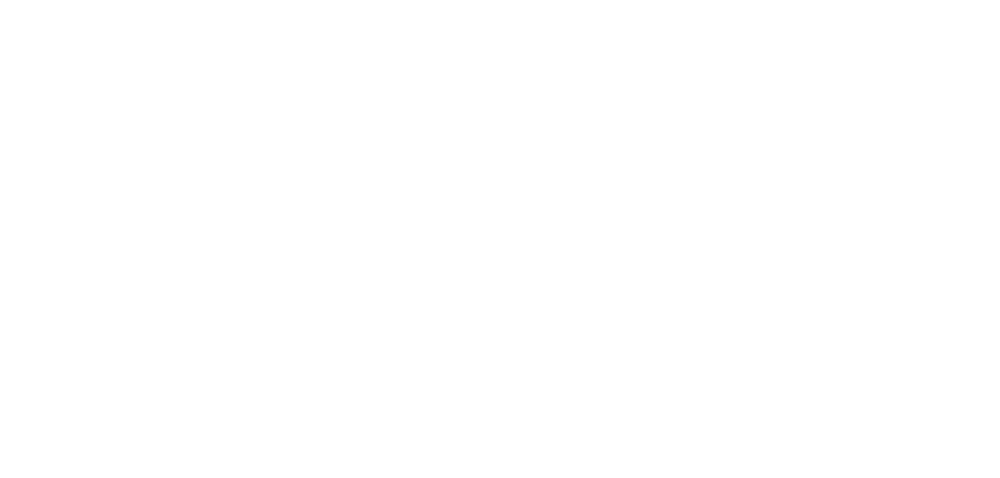

roi259_dff.png


<IPython.core.display.Javascript object>


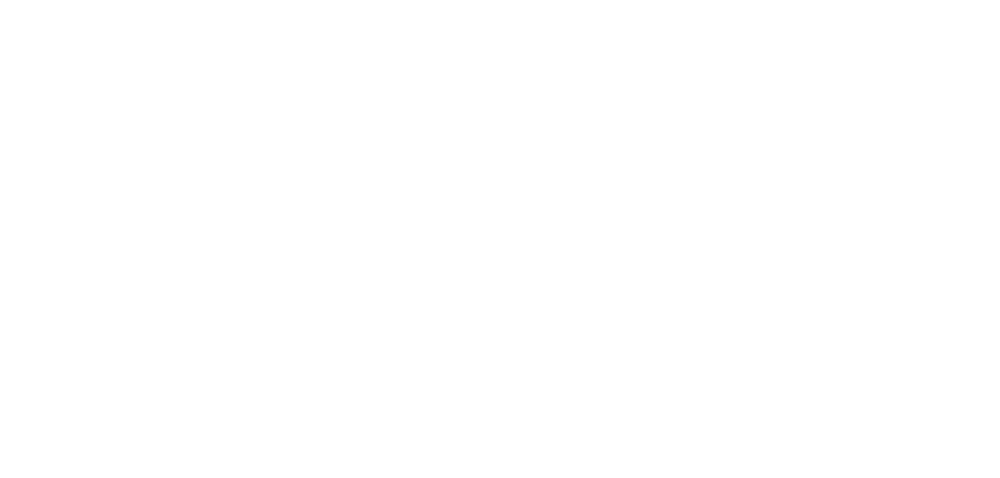

roi260_dff.png


In [164]:
for rid in range(nrois):
    trace_array = extracted_traces[rid, :].reshape(nfiles, nframes_per_file, order='C')
    all_frames = np.hstack(np.array([trace_array[fi, np.hstack(ixs.values.T)]\
                            for fi, ixs in sorted(frames_by_file.items(), key=lambda x: x[0])]))
    rdata = labels_c.copy()
    rdata['trace'] = all_frames #manual[rid]

    meandfs = []
    for k, g in rdata.groupby(['config']):
        mean_trace = g.groupby(['trial'])[ylabel].apply(np.array).mean(axis=0)
        mean_tsec = g.groupby(['trial'])['tsec'].apply(np.array).mean(axis=0)
        sem_trace = stats.sem(np.vstack(g.groupby(['trial'])[ylabel].apply(np.array)), axis=0)
        mdf = pd.DataFrame({'%s' % ylabel: mean_trace,
                            'tsec': mean_tsec,
                            'sem': sem_trace,
                            'fill_minus': mean_trace - sem_trace,
                            'fill_plus': mean_trace + sem_trace,
                            'config': [k for _ in range(len(mean_trace))]})
        for p in plot_params.values():
            mdf[p] = [round(sdf[p][cfg], 1) if isinstance(sdf[p][cfg], (float)) else sdf[p][cfg] for cfg in mdf['config']]
        meandfs.append(mdf)

    meandfs = pd.concat(meandfs, axis=0)

    # plot
    p = sns.FacetGrid(meandfs, col=plot_params['cols'], row=plot_params['rows'], 
                      hue=plot_params['hue'], size=2, legend_out=True, palette=palette)

    p = p.map(pl.fill_between, "tsec", "fill_minus", "fill_plus", alpha=0.5) 
    p = (p.map(pl.plot, "tsec", ylabel, lw=1, alpha=1).add_legend())  
    p = p.set_titles(col_template="{col_name}", size=5)      
    pl.subplots_adjust(wspace=0.8, hspace=0.8, top=0.8, bottom=0.1, left=0.1, right=0.9)

    
    start_val = 0.0
    end_val = mdf['tsec'][stim_on + int(round(nframes_on))]
    for ri in range(p.axes.shape[0]):
        for ci in range(p.axes.shape[1]):
            ymin, ymax = p.axes[ri, ci].get_ylim()
            p.axes[ri, ci].add_patch(patches.Rectangle((start_val, ymin), end_val, ymax, linewidth=0, fill=True, color='k', alpha=0.2))

    p.fig.suptitle('roi %i' % int(rid+1))
    figname = 'roi%i_%s.png' % (int(rid+1), trace_type)
    pl.savefig(os.path.join(psth_dir, figname))
    print(figname)
    pl.close()


In [66]:
psth_dir

'/n/coxfs01/2p-data/JC084/20190525/FOV1_zoom2p0x/combined_gratings_static/traces/traces001_e97cee_traces001_de9460_traces001_1f6b5f_traces001_70217b/figures/psth_caiman_dff_auto'

<IPython.core.display.Javascript object>


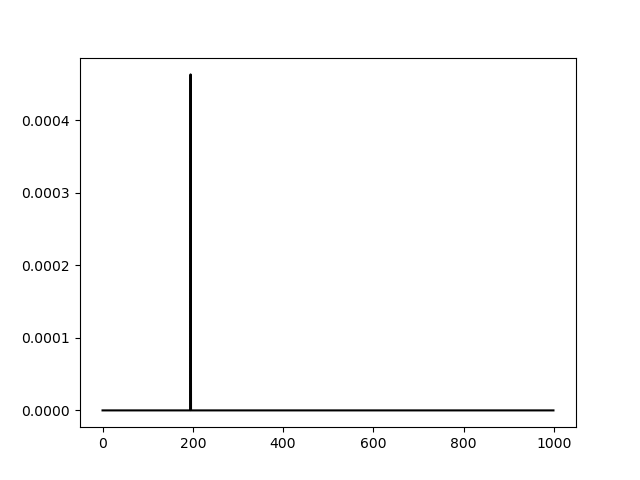

In [67]:
pl.figure()
pl.plot(cnm.estimates.S[11][0:1000], 'k')


#### Look at spatial components

In [16]:
glob.glob(os.path.join(results_dir, 'memmap', '*gratings-downsample-1_d*.mmap'))

['/n/coxfs01/2p-data/JC084/20190525/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190525-FOV1_zoom2p0x-gratings-downsample-1_d1_512_d2_512_d3_1_order_C_frames_147520_.mmap']

In [17]:
# Load memmap file
#fname_tots = glob.glob(os.path.join(results_dir, 'memmap', '%s_*.mmap' % prefix))
fname_tots = glob.glob(os.path.join(results_dir, 'memmap', '*gratings-downsample-1_d*.mmap'))[0]
print(fname_tots)


/n/coxfs01/2p-data/JC084/20190525/FOV1_zoom2p0x/caiman_results/gratings/memmap/JC084-20190525-FOV1_zoom2p0x-gratings-downsample-1_d1_512_d2_512_d3_1_order_C_frames_147520_.mmap


In [23]:
# Load images
Yr, dims, T = cm.load_memmap(fname_tots)
images = np.reshape(Yr.T, [T] + list(dims), order='F') 

In [33]:
start_t = time.time()

avg = images.mean(axis=0)
end_t = time.time() - start_t
print("%.2f s" % end_t)



3094.01 s


In [34]:
avg.shape

(512, 512)

<IPython.core.display.Javascript object>


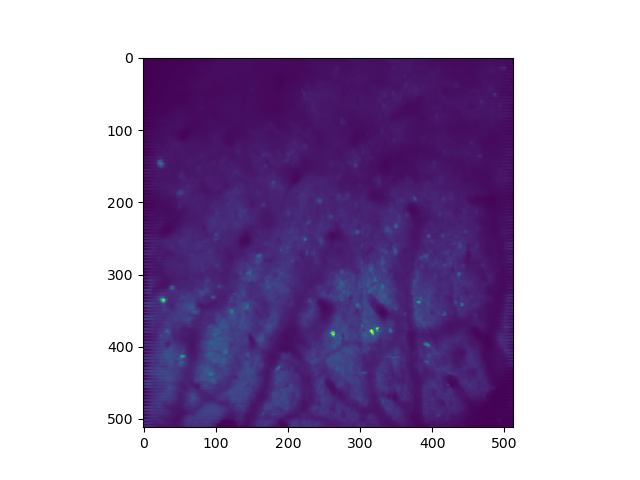

In [35]:
pl.figure()
pl.imshow(avg)

<IPython.core.display.Javascript object>


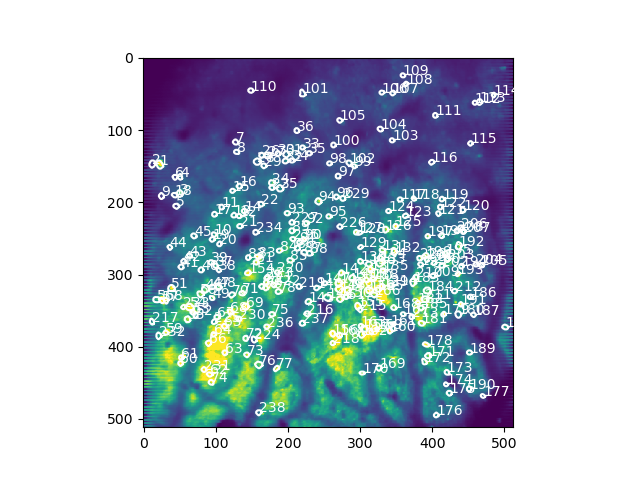

In [36]:
cnm.estimates.plot_contours(img=avg)

In [765]:
results_fpath

'/n/coxfs01/2p-data/JC084/20190522/FOV1_zoom2p0x/caiman_results/gratings/seed-cnm_seeded-gratings-downsample-1-mcorrected_results.hdf5'